#Loading the dataset

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [ ]:
!pip install ultralytics

In [ ]:
!pip install roboflow

In [ ]:
from roboflow import Roboflow
rf = Roboflow(api_key="")
project = rf.workspace("brad-dwyer").project("pothole-voxrl")
version = project.version(1)
dataset_yolov6 = version.download("mt-yolov6",location="yolov6-dataset")
dataset_yolov8 = version.download("yolov8",location="yolov8-dataset")
dataset_yolov11 = version.download("yolov11",location="yolov11-dataset")
dataset_yolov5 = version.download("yolov5-obb",location="yolov5-dataset")

loading Roboflow workspace...
loading Roboflow project...


In [ ]:
import os
from ultralytics import YOLO

## Loading Models

In [ ]:
model_v6 = YOLO('yolov6n.yaml')
model_v8 = YOLO('yolov8n.pt')
model_v5 = YOLO('yolov5n.pt')
model_v10 = YOLO('yolov10n.pt')
model_v11 = YOLO('yolo11n.pt')

PRO TIP 💡 Replace 'model=yolov5n.pt' with new 'model=yolov5nu.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.



## Dataset Exploration

In [ ]:
import os
import glob
import numpy as np
import matplotlib.pyplot as plt
import cv2
import pandas as pd

In [ ]:
train_img_dir = os.path.join(dataset_yolov8.location, "train", "images")
train_lbl_dir = os.path.join(dataset_yolov8.location, "train", "labels")

valid_img_dir = os.path.join(dataset_yolov8.location, "valid", "images")
valid_lbl_dir = os.path.join(dataset_yolov8.location, "valid", "labels")

test_img_dir  = os.path.join(dataset_yolov8.location, "test", "images")
test_lbl_dir  = os.path.join(dataset_yolov8.location, "test", "labels")

In [ ]:
def count_files_in_dir(directory, ext=".jpg"):
    return len(glob.glob(os.path.join(directory, f"*{ext}")))

In [ ]:
train_img_count = count_files_in_dir(train_img_dir, ext=".jpg")
valid_img_count = count_files_in_dir(valid_img_dir, ext=".jpg")
test_img_count  = count_files_in_dir(test_img_dir,  ext=".jpg")

In [ ]:
print("Image counts:")
print(f"  Train: {train_img_count}")
print(f"  Valid: {valid_img_count}")
print(f"  Test : {test_img_count}")

Image counts:
  Train: 465
  Valid: 133
  Test : 67


Image counts:
  Train: 465
  Valid: 133
  Test : 67


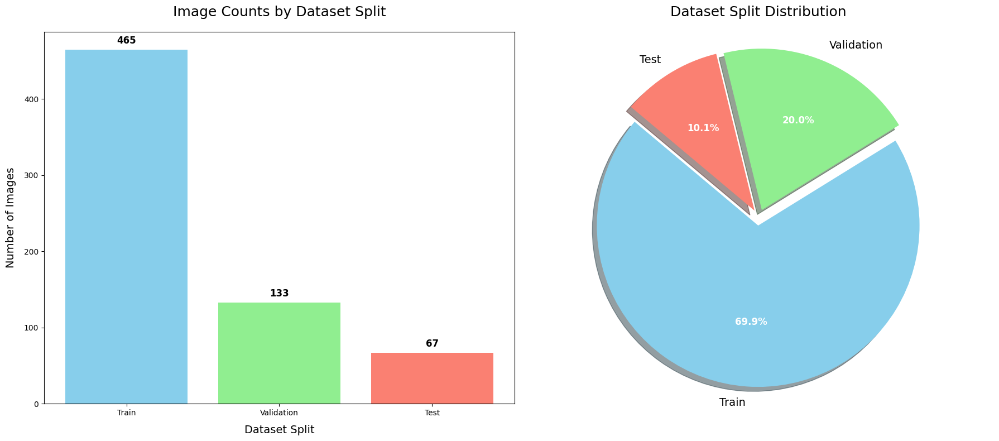

In [ ]:
print("Image counts:")
print(f"  Train: {train_img_count}")
print(f"  Valid: {valid_img_count}")
print(f"  Test : {test_img_count}")

categories = ['Train', 'Validation', 'Test']
counts = [train_img_count, valid_img_count, test_img_count]

total = sum(counts)
percentages = [(count / total) * 100 for count in counts]

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 8))


bars = ax1.bar(categories, counts, color=['skyblue', 'lightgreen', 'salmon'])

ax1.set_title('Image Counts by Dataset Split', fontsize=18, pad=20)
ax1.set_xlabel('Dataset Split', fontsize=14, labelpad=10)
ax1.set_ylabel('Number of Images', fontsize=14, labelpad=10)

for bar in bars:
    height = bar.get_height()
    ax1.annotate(f'{height}',
                xy=(bar.get_x() + bar.get_width() / 2, height),
                xytext=(0, 5),  # 5 points vertical offset
                textcoords="offset points",
                ha='center', va='bottom', fontsize=12, fontweight='bold')

ax1.axhline(0, color='grey', linewidth=0.8)

colors = ['skyblue', 'lightgreen', 'salmon']

wedges, texts, autotexts = ax2.pie(
    counts,
    labels=categories,
    autopct='%1.1f%%',
    startangle=140,
    colors=colors,
    explode=(0.05, 0.05, 0.05),
    shadow=True,
    textprops={'fontsize': 14}
)

ax2.axis('equal')

ax2.set_title('Dataset Split Distribution', fontsize=18, pad=20)

for autotext in autotexts:
    autotext.set_color('white')
    autotext.set_fontsize(12)
    autotext.set_fontweight('bold')
plt.tight_layout()
plt.show()


In [ ]:
# Each label file in YOLO format typically has lines like:
# <class_id> <x_center> <y_center> <width> <height>
# All coordinates are normalized between 0 and 1.

bbox_counts = []        # number of bounding boxes per image
bbox_widths = []        # store all bounding box widths
bbox_heights = []       # store all bounding box heights

label_files = glob.glob(os.path.join(train_lbl_dir, "*.txt"))

for lbl_path in label_files:
    with open(lbl_path, "r") as f:
        lines = f.readlines()
        bbox_counts.append(len(lines))
        for line in lines:
            parts = line.strip().split()
            if len(parts) == 5:
                # YOLO format: class_id, x_center, y_center, width, height
                _, _, _, w, h = parts
                w = float(w)
                h = float(h)
                bbox_widths.append(w)
                bbox_heights.append(h)

print("\nBounding Box Stats (Train Set):")
print(f"  Total label files: {len(label_files)}")
print(f"  Total bounding boxes: {sum(bbox_counts)}")
print(f"  Avg bounding boxes per image: {np.mean(bbox_counts):.2f}")
print(f"  Min bounding boxes in any image: {np.min(bbox_counts)}")
print(f"  Max bounding boxes in any image: {np.max(bbox_counts)}")


Bounding Box Stats (Train Set):
  Total label files: 465
  Total bounding boxes: 1256
  Avg bounding boxes per image: 2.70
  Min bounding boxes in any image: 1
  Max bounding boxes in any image: 19


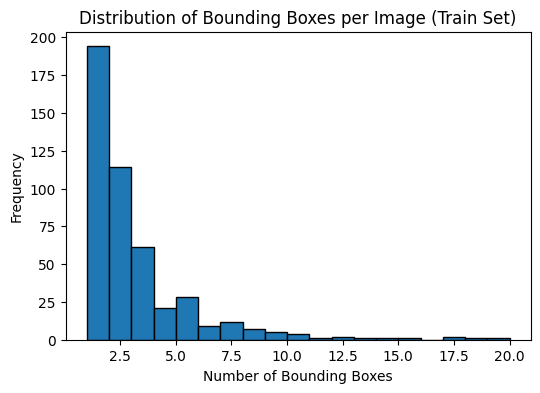

In [ ]:
# Distribution of bounding boxes per image
plt.figure(figsize=(6,4))
plt.hist(bbox_counts, bins=range(1, max(bbox_counts)+2), edgecolor='black')
plt.title("Distribution of Bounding Boxes per Image (Train Set)")
plt.xlabel("Number of Bounding Boxes")
plt.ylabel("Frequency")
plt.show()

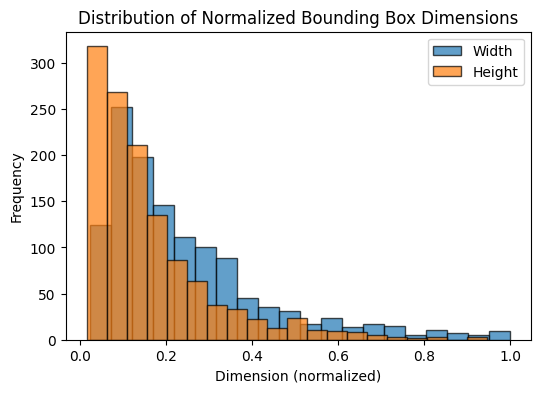

In [ ]:
# Distribution of bounding box sizes (width or height)
plt.figure(figsize=(6,4))
plt.hist(bbox_widths, bins=20, alpha=0.7, label="Width", edgecolor='black')
plt.hist(bbox_heights, bins=20, alpha=0.7, label="Height", edgecolor='black')
plt.title("Distribution of Normalized Bounding Box Dimensions")
plt.xlabel("Dimension (normalized)")
plt.ylabel("Frequency")
plt.legend()
plt.show()

In [ ]:
def visualize_one_image(image_file):
    """Show image with bounding box annotations."""
    # Derive corresponding label file name
    base_name = os.path.splitext(os.path.basename(image_file))[0]
    label_file = os.path.join(train_lbl_dir, base_name + ".txt")

    # Load the image
    image = cv2.imread(image_file)
    if image is None:
        print(f"Failed to read {image_file}")
        return

    # Convert BGR -> RGB for matplotlib
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    height, width, _ = image.shape

    # Read annotations and draw bounding boxes
    if os.path.exists(label_file):
        with open(label_file, "r") as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) == 5:
                    class_id, x_center, y_center, w, h = parts
                    class_id = int(class_id)
                    x_center, y_center, w, h = map(float, [x_center, y_center, w, h])

                    # Convert normalized coords back to pixel coords
                    x_center_abs = x_center * width
                    y_center_abs = y_center * height
                    w_abs = w * width
                    h_abs = h * height

                    # YOLO gives center-based coords, so convert to top-left
                    x1 = int(x_center_abs - w_abs/2)
                    y1 = int(y_center_abs - h_abs/2)
                    x2 = int(x_center_abs + w_abs/2)
                    y2 = int(y_center_abs + h_abs/2)

                    # Draw rectangle
                    color = (255, 0, 0)  # Blue in BGR
                    thickness = 2
                    cv2.rectangle(image_rgb, (x1, y1), (x2, y2), color, thickness)
                    cv2.putText(image_rgb, f"Class {class_id}", (x1, y1 - 5),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)
    else:
        print(f"No label file found for {image_file}")

    # Display image with bounding boxes
    plt.figure(figsize=(8,6))
    plt.imshow(image_rgb)
    plt.axis('off')
    plt.title("Annotated Image Example")
    plt.show()


Showing one annotated image: /content/yolov8-dataset/train/images/img-479_jpg.rf.68af46ff65675c6673f7ab2b3ffffef5.jpg


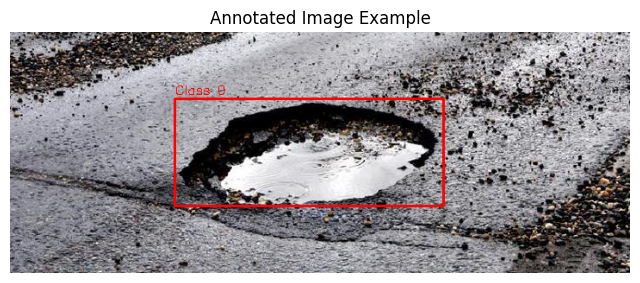

In [ ]:
# Try visualizing one random image from the train set
train_images = glob.glob(os.path.join(train_img_dir, "*.jpg"))
if train_images:
    import random
    sample_image = random.choice(train_images)
    print(f"\nShowing one annotated image: {sample_image}")
    visualize_one_image(sample_image)
else:
    print("No images found in the train directory!")

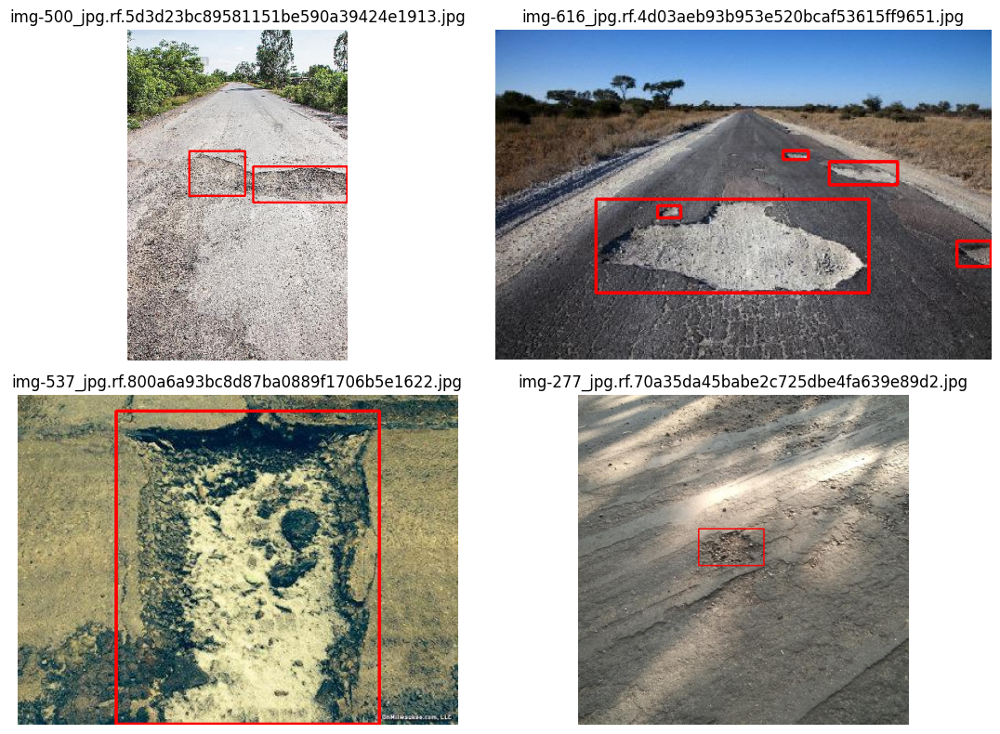

In [ ]:
import random

def visualize_images_in_grid(image_dir, label_dir, grid_size=(2, 2)):
    """
    Displays a grid of images with YOLO bounding box annotations.
    grid_size: (rows, cols) in the plot
    """
    all_images = glob.glob(os.path.join(image_dir, "*.jpg"))
    num_images = grid_size[0] * grid_size[1]

    # Pick random images from the folder
    random_images = random.sample(all_images, min(len(all_images), num_images))

    fig, axes = plt.subplots(nrows=grid_size[0], ncols=grid_size[1], figsize=(12, 8))
    axes = axes.flatten()  # flatten in case there's more than 1 row

    for ax, img_path in zip(axes, random_images):
        # Load image
        image_bgr = cv2.imread(img_path)
        image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
        h, w, _ = image_rgb.shape

        # Read label file
        base_name = os.path.splitext(os.path.basename(img_path))[0]
        lbl_path = os.path.join(label_dir, base_name + ".txt")

        if os.path.exists(lbl_path):
            with open(lbl_path, "r") as f:
                lines = f.readlines()
                for line in lines:
                    parts = line.strip().split()
                    if len(parts) == 5:
                        class_id, x_center, y_center, bw, bh = parts
                        class_id = int(class_id)
                        x_center, y_center, bw, bh = map(float, [x_center, y_center, bw, bh])

                        # Convert from normalized to pixel coords
                        x_center_abs = x_center * w
                        y_center_abs = y_center * h
                        bw_abs = bw * w
                        bh_abs = bh * h

                        x1 = int(x_center_abs - bw_abs/2)
                        y1 = int(y_center_abs - bh_abs/2)
                        x2 = int(x_center_abs + bw_abs/2)
                        y2 = int(y_center_abs + bh_abs/2)

                        cv2.rectangle(image_rgb, (x1, y1), (x2, y2), (255,0,0), 2)

        ax.imshow(image_rgb)
        ax.axis("off")
        ax.set_title(f"{os.path.basename(img_path)}")

    plt.tight_layout()
    plt.show()

visualize_images_in_grid(train_img_dir, train_lbl_dir, grid_size=(2, 2))

Train Set:
             width       height
count  1256.000000  1256.000000
mean      0.245503     0.162042
std       0.190617     0.146087
min       0.022500     0.015556
25%       0.106639     0.060947
50%       0.186111     0.116667
75%       0.319073     0.206138
max       0.998124     0.946667

Validation Set:
            width      height
count  330.000000  330.000000
mean     0.256950    0.169976
std      0.212144    0.166317
min      0.020833    0.004167
25%      0.099828    0.055348
50%      0.186806    0.117083
75%      0.345410    0.203877
max      0.997778    0.840000

Test Set:
            width      height
count  154.000000  154.000000
mean     0.285266    0.193614
std      0.224021    0.179595
min      0.000000    0.003333
25%      0.136737    0.078125
50%      0.220978    0.133333
75%      0.353909    0.239583
max      0.998148    0.883333


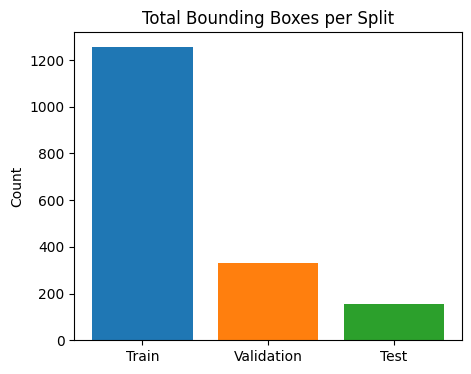

In [ ]:
import pandas as pd

def get_bbox_info(label_dir):
    bbox_info = []
    label_files = glob.glob(os.path.join(label_dir, "*.txt"))

    for lbl_path in label_files:
        with open(lbl_path, "r") as f:
            lines = f.readlines()
            for line in lines:
                parts = line.strip().split()
                if len(parts) == 5:
                    class_id, x_center, y_center, w, h = parts
                    bbox_info.append({
                        "class_id": int(class_id),
                        "x_center": float(x_center),
                        "y_center": float(y_center),
                        "width": float(w),
                        "height": float(h)
                    })
    return pd.DataFrame(bbox_info)

df_train = get_bbox_info(train_lbl_dir)
df_valid = get_bbox_info(valid_lbl_dir)
df_test  = get_bbox_info(test_lbl_dir)

# Let's compare average bounding box width, height, and area across splits
print("Train Set:")
print(df_train[["width","height"]].describe())

print("\nValidation Set:")
print(df_valid[["width","height"]].describe())

print("\nTest Set:")
print(df_test[["width","height"]].describe())

# Quick bar chart for total bounding boxes in each set
plt.figure(figsize=(5,4))
bbox_counts = [len(df_train), len(df_valid), len(df_test)]
plt.bar(["Train", "Validation", "Test"], bbox_counts, color=["#1f77b4", "#ff7f0e", "#2ca02c"])
plt.title("Total Bounding Boxes per Split")
plt.ylabel("Count")
plt.show()

## Comparing Models

### Comparing without augmentation

In [ ]:
epochs = 50
batch_size = 16
imgsz = 640

#### YOLOv5

In [ ]:
model_v5.train(data=os.path.join(dataset_yolov8.location, 'data.yaml'), epochs=epochs, batch=batch_size,name='yolov5n_ft1',imgsz=imgsz)

Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov5n.pt, data=/content/yolov8-dataset/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov5n_ft1, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=Tru

train: Scanning /content/yolov8-dataset/train/labels.cache... 465 images, 0 backgrounds, 0 corrupt: 100%|██████████| 465/465 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/yolov8-dataset/valid/labels.cache... 133 images, 0 backgrounds, 0 corrupt: 100%|██████████| 133/133 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov5n_ft1/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 69 weight(decay=0.0), 76 weight(decay=0.0005), 75 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov5n_ft1
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      1.95G      2.052      3.192       1.89          1        640: 100%|██████████| 30/30 [00:09<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.53it/s]

                   all        133        330    0.00469      0.567     0.0369     0.0157



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      2.11G      1.797      2.339      1.619         10        640: 100%|██████████| 30/30 [00:11<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.39it/s]

                   all        133        330      0.327      0.145      0.139     0.0478



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50       2.1G      1.777      2.147       1.59          2        640: 100%|██████████| 30/30 [00:11<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.43it/s]

                   all        133        330      0.164      0.173      0.108     0.0368



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50       2.1G      1.788      2.055      1.613          4        640: 100%|██████████| 30/30 [00:08<00:00,  3.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.81it/s]

                   all        133        330      0.332      0.276      0.222     0.0846



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.11G      1.705      1.857      1.543          9        640: 100%|██████████| 30/30 [00:11<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.26it/s]

                   all        133        330      0.386      0.442      0.347      0.157



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50       2.1G      1.729      1.867      1.574          5        640: 100%|██████████| 30/30 [00:14<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.10it/s]

                   all        133        330      0.432      0.309      0.303      0.134



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50       2.1G      1.676       1.75      1.502          4        640: 100%|██████████| 30/30 [00:14<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.92it/s]

                   all        133        330      0.506      0.479      0.472      0.232



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.08G      1.615      1.638      1.479          4        640: 100%|██████████| 30/30 [00:14<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.99it/s]

                   all        133        330      0.481       0.43      0.435      0.216



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50       2.1G      1.607      1.617      1.472          2        640: 100%|██████████| 30/30 [00:10<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.38it/s]

                   all        133        330      0.606      0.494      0.532      0.251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.12G       1.61      1.654      1.467          2        640: 100%|██████████| 30/30 [00:10<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.98it/s]

                   all        133        330      0.509      0.403       0.43      0.218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.15G      1.596      1.654      1.483          1        640: 100%|██████████| 30/30 [00:09<00:00,  3.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.28it/s]

                   all        133        330      0.553      0.476      0.501      0.258



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.08G      1.547       1.52      1.406          5        640: 100%|██████████| 30/30 [00:12<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.43it/s]

                   all        133        330       0.66      0.488      0.532      0.251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50       2.1G      1.535      1.488        1.4          3        640: 100%|██████████| 30/30 [00:09<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.12it/s]

                   all        133        330      0.572      0.506       0.54      0.276



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.16G      1.508      1.448        1.4          3        640: 100%|██████████| 30/30 [00:08<00:00,  3.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.23it/s]

                   all        133        330      0.716      0.485      0.596      0.309



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.13G      1.521      1.425      1.395         13        640: 100%|██████████| 30/30 [00:11<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.10it/s]

                   all        133        330      0.633      0.594      0.629      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.13G      1.473      1.356      1.354         10        640: 100%|██████████| 30/30 [00:10<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.38it/s]

                   all        133        330      0.713      0.615      0.682      0.367



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50       2.1G      1.443      1.362      1.345          5        640: 100%|██████████| 30/30 [00:07<00:00,  3.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.67it/s]


                   all        133        330      0.733       0.57      0.646       0.36

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.16G      1.465      1.418      1.386          1        640: 100%|██████████| 30/30 [00:11<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.51it/s]

                   all        133        330      0.688      0.545      0.619       0.35



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50       2.1G      1.448      1.341      1.352          6        640: 100%|██████████| 30/30 [00:10<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.39it/s]

                   all        133        330      0.697      0.628      0.673       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.16G      1.414      1.291      1.334          3        640: 100%|██████████| 30/30 [00:07<00:00,  3.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.86it/s]

                   all        133        330      0.724      0.564      0.658      0.359



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      2.15G      1.386      1.298       1.34          3        640: 100%|██████████| 30/30 [00:11<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.57it/s]

                   all        133        330      0.608      0.558      0.606       0.33



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.16G      1.369      1.269      1.296          2        640: 100%|██████████| 30/30 [00:10<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.20it/s]

                   all        133        330      0.696      0.603      0.696      0.382



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.16G      1.375      1.254      1.282          7        640: 100%|██████████| 30/30 [00:07<00:00,  3.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.72it/s]

                   all        133        330       0.74      0.628      0.703      0.391



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.03G      1.409      1.272      1.312          6        640: 100%|██████████| 30/30 [00:11<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.86it/s]

                   all        133        330      0.662      0.627      0.699       0.39



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.16G      1.349      1.188      1.281          6        640: 100%|██████████| 30/30 [00:11<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.66it/s]

                   all        133        330      0.694      0.603      0.652      0.379



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50       2.1G      1.411      1.241      1.332          3        640: 100%|██████████| 30/30 [00:07<00:00,  3.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.89it/s]


                   all        133        330       0.75      0.664      0.722      0.411

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      2.11G      1.334      1.195      1.292          2        640: 100%|██████████| 30/30 [00:10<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.17it/s]

                   all        133        330      0.726      0.636      0.716      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.15G      1.349      1.171      1.295          2        640: 100%|██████████| 30/30 [00:10<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.19it/s]


                   all        133        330      0.742      0.612      0.699      0.421

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.17G      1.246      1.305        1.2          0        640: 100%|██████████| 30/30 [00:07<00:00,  3.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.14it/s]

                   all        133        330      0.788      0.585      0.705      0.421



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50       2.1G      1.289      1.131      1.232          1        640: 100%|██████████| 30/30 [00:10<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.23it/s]

                   all        133        330      0.732      0.621      0.687      0.402



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50       2.1G      1.322      1.186      1.307          2        640: 100%|██████████| 30/30 [00:10<00:00,  2.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.40it/s]

                   all        133        330      0.802      0.591       0.72      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      2.16G      1.316      1.118      1.249          2        640: 100%|██████████| 30/30 [00:07<00:00,  3.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.39it/s]

                   all        133        330      0.721      0.656      0.733      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.16G       1.31      1.116      1.255         17        640: 100%|██████████| 30/30 [00:10<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.04it/s]

                   all        133        330      0.762      0.618      0.727      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      2.16G      1.269      1.095      1.234         13        640: 100%|██████████| 30/30 [00:10<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.05it/s]

                   all        133        330      0.823      0.624      0.753      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      2.11G      1.247      1.089      1.233          3        640: 100%|██████████| 30/30 [00:07<00:00,  3.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.51it/s]

                   all        133        330       0.87      0.618      0.768      0.462



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.15G      1.261      1.115      1.235          1        640: 100%|██████████| 30/30 [00:10<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.34it/s]

                   all        133        330       0.77      0.648      0.744      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50       2.1G      1.268      1.049      1.236          4        640: 100%|██████████| 30/30 [00:10<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.45it/s]

                   all        133        330      0.718      0.655      0.722      0.437



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50       2.1G      1.186     0.9973      1.191          2        640: 100%|██████████| 30/30 [00:07<00:00,  3.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.16it/s]

                   all        133        330      0.746      0.682      0.742      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      2.15G      1.246      1.023      1.242          2        640: 100%|██████████| 30/30 [00:10<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.81it/s]

                   all        133        330      0.759      0.624       0.74      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50       2.1G      1.223      1.033      1.214          2        640: 100%|██████████| 30/30 [00:09<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.28it/s]

                   all        133        330      0.748      0.674       0.74      0.451


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      2.33G      1.153      1.046      1.178          2        640: 100%|██████████| 30/30 [00:09<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.62it/s]

                   all        133        330       0.78       0.63      0.722      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      2.16G      1.151          1      1.202          1        640: 100%|██████████| 30/30 [00:09<00:00,  3.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.21it/s]

                   all        133        330      0.739      0.679      0.755      0.462



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      2.06G      1.123     0.9717      1.157          3        640: 100%|██████████| 30/30 [00:10<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.21it/s]

                   all        133        330      0.758      0.682      0.756       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      2.16G      1.227      0.937      1.311          1        640: 100%|██████████| 30/30 [00:07<00:00,  3.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.49it/s]

                   all        133        330       0.76      0.697      0.763      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50       2.1G      1.091     0.8644       1.13          1        640: 100%|██████████| 30/30 [00:09<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.20it/s]

                   all        133        330      0.802      0.658      0.764      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      2.15G      1.132     0.8951      1.148          4        640: 100%|██████████| 30/30 [00:10<00:00,  2.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.83it/s]

                   all        133        330      0.822      0.655      0.768      0.483



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      2.11G      1.081     0.8491      1.132          1        640: 100%|██████████| 30/30 [00:07<00:00,  4.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.48it/s]

                   all        133        330       0.81      0.686      0.776      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      2.13G      1.153     0.9169      1.187          3        640: 100%|██████████| 30/30 [00:10<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.81it/s]

                   all        133        330      0.842      0.646      0.766      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      2.15G      1.097     0.8663      1.128          5        640: 100%|██████████| 30/30 [00:09<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.26it/s]

                   all        133        330      0.831      0.661      0.773      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50       2.1G      1.071     0.8366       1.12          1        640: 100%|██████████| 30/30 [00:07<00:00,  3.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.43it/s]

                   all        133        330      0.837      0.669      0.773      0.495



50 epochs completed in 0.178 hours.
Optimizer stripped from runs/detect/yolov5n_ft1/weights/last.pt, 5.3MB
Optimizer stripped from runs/detect/yolov5n_ft1/weights/best.pt, 5.3MB

Validating runs/detect/yolov5n_ft1/weights/best.pt...
Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv5n summary (fused): 193 layers, 2,503,139 parameters, 0 gradients, 7.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.36it/s]


                   all        133        330       0.81      0.688      0.776      0.497
Speed: 0.3ms preprocess, 3.2ms inference, 0.0ms loss, 6.2ms postprocess per image
Results saved to runs/detect/yolov5n_ft1


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7b080e454580>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

Results (VAL) (performance metrics evaluated on the validation dataset after each epoch )

In [ ]:
from IPython.display import display, Image

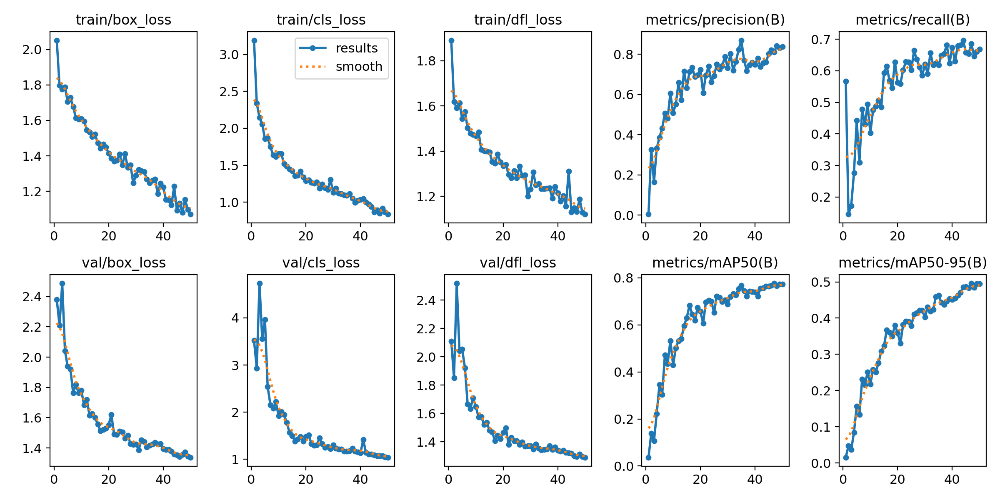

In [ ]:
Image(filename=f'/content/runs/detect/yolov5n_ft1/results.png', width=600)

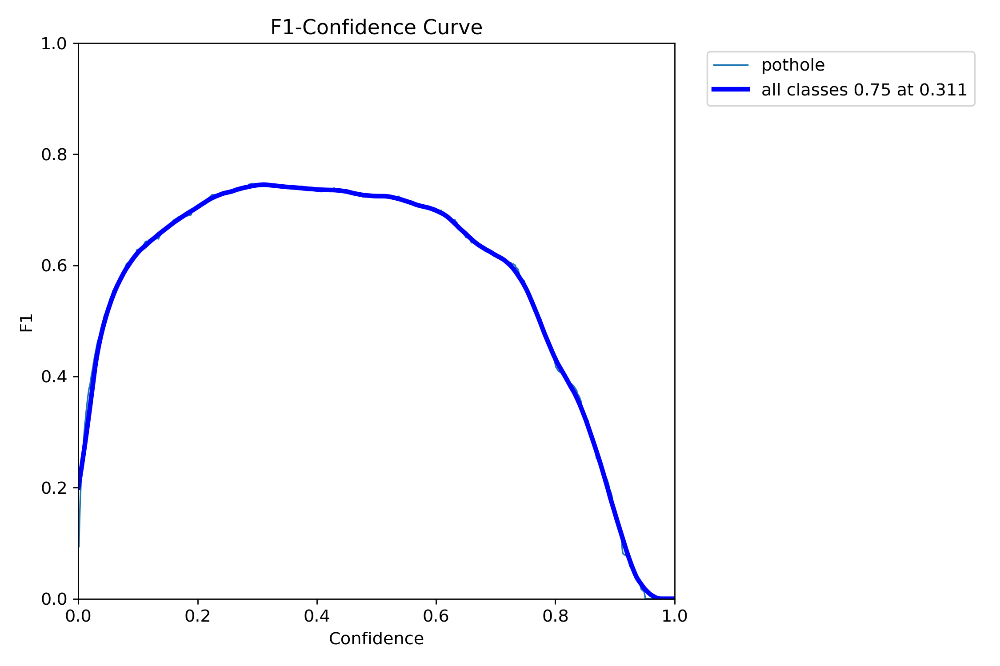

In [ ]:
Image(filename=f'/content/runs/detect/yolov5n_ft1/F1_curve.png', width=600)

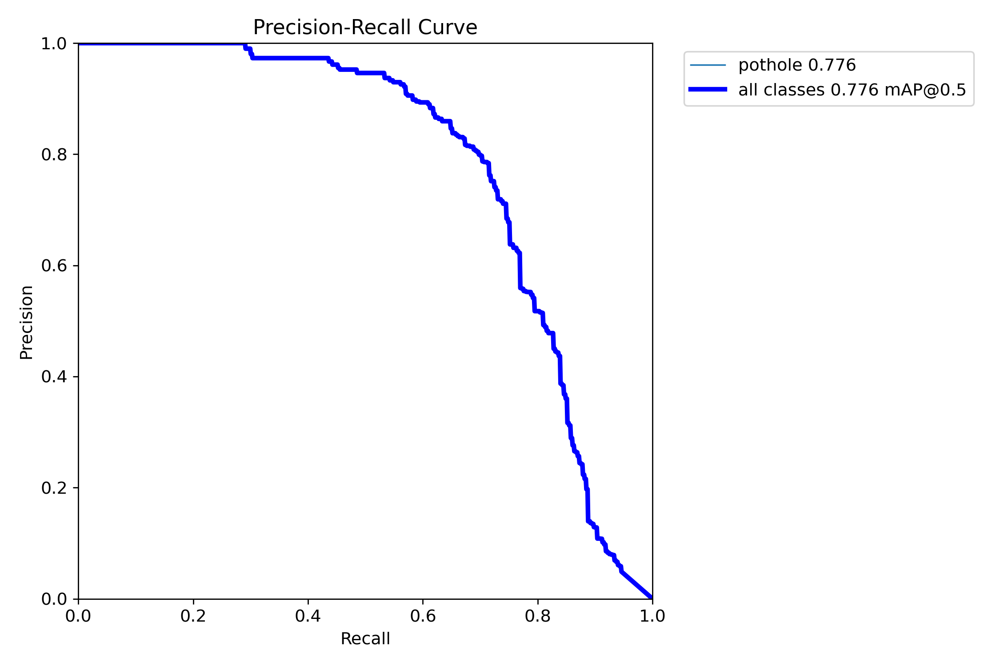

In [ ]:
Image(filename=f'/content/runs/detect/yolov5n_ft1/PR_curve.png', width=600)

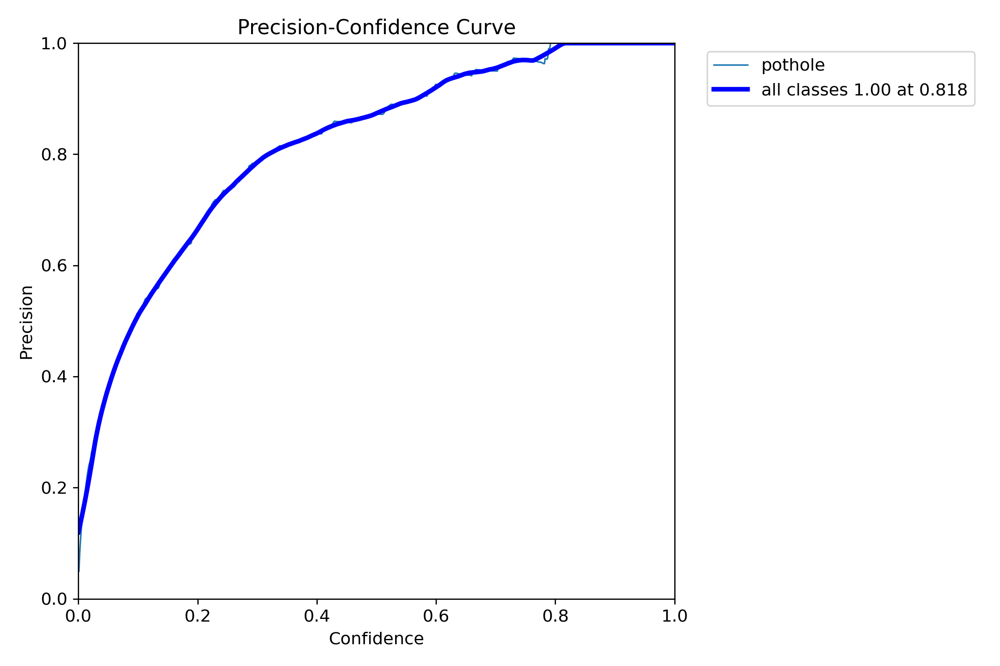

In [ ]:
Image(filename=f'/content/runs/detect/yolov5n_ft1/P_curve.png', width=600)

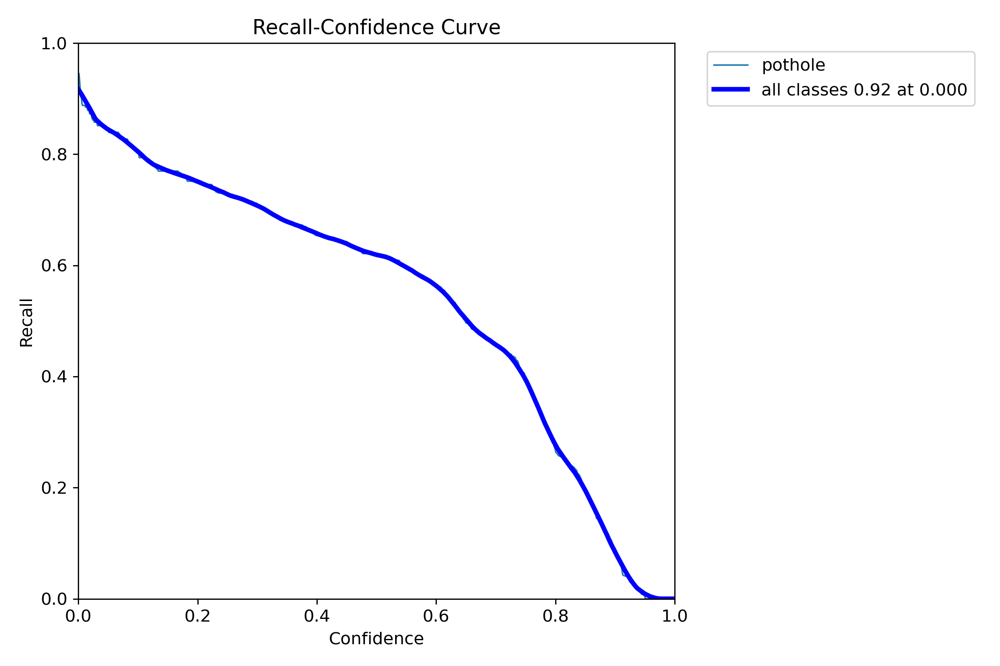

In [ ]:
Image(filename=f'/content/runs/detect/yolov5n_ft1/R_curve.png', width=600)

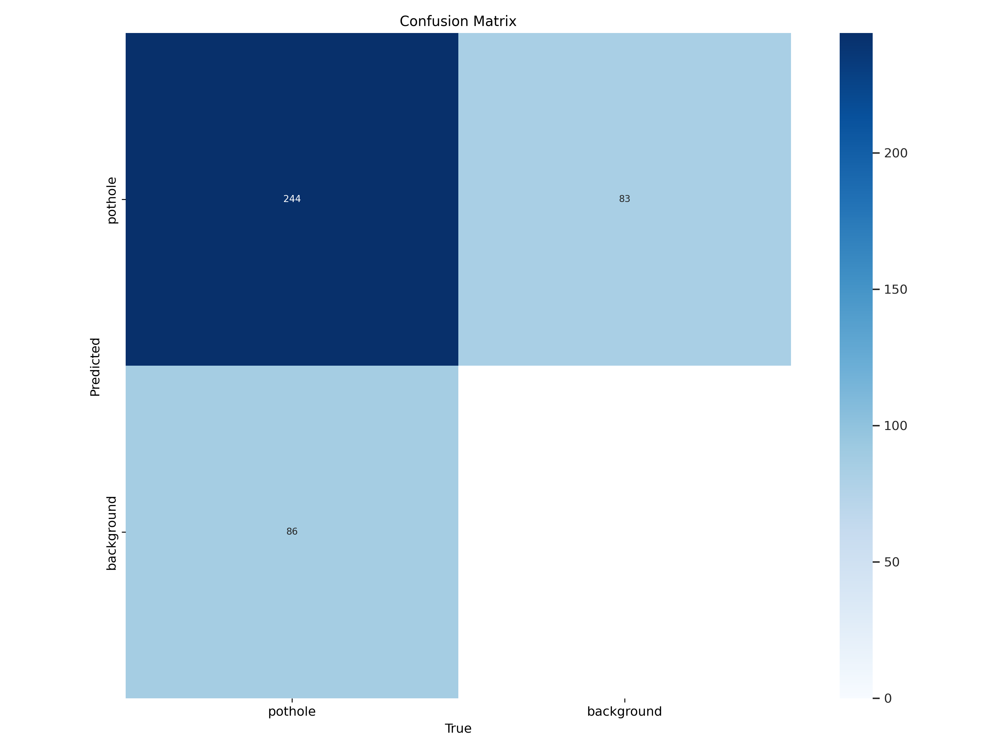

In [ ]:
Image(filename=f'/content/runs/detect/yolov5n_ft1/confusion_matrix.png', width=600)

In [ ]:
metrics_v5 = '/content/runs/detect/yolov5n_ft1/results.csv'

In [ ]:
results_v5 = model_v5.val(name='test_yolov5n_ft1',split='test')

Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)


val: Scanning /content/yolov8-dataset/test/labels... 67 images, 0 backgrounds, 0 corrupt: 100%|██████████| 67/67 [00:00<00:00, 509.85it/s]

val: New cache created: /content/yolov8-dataset/test/labels.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.47it/s]


                   all         67        154      0.803      0.714      0.789      0.505
Speed: 0.4ms preprocess, 12.3ms inference, 0.0ms loss, 12.9ms postprocess per image
Results saved to runs/detect/test_yolov5n_ft1


Results (Test)

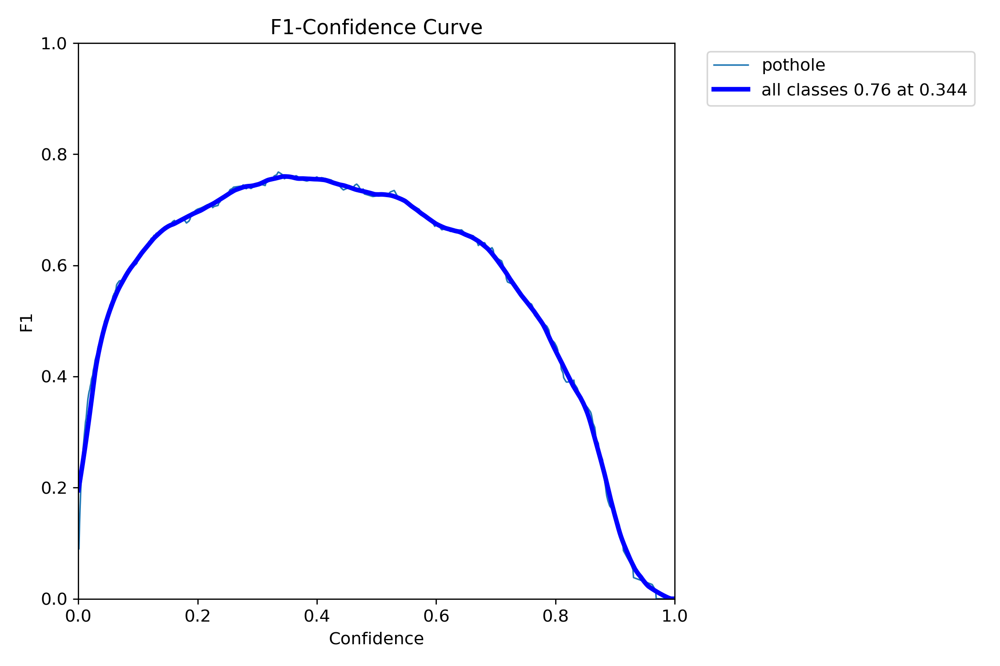

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov5n_ft1/F1_curve.png', width=600)

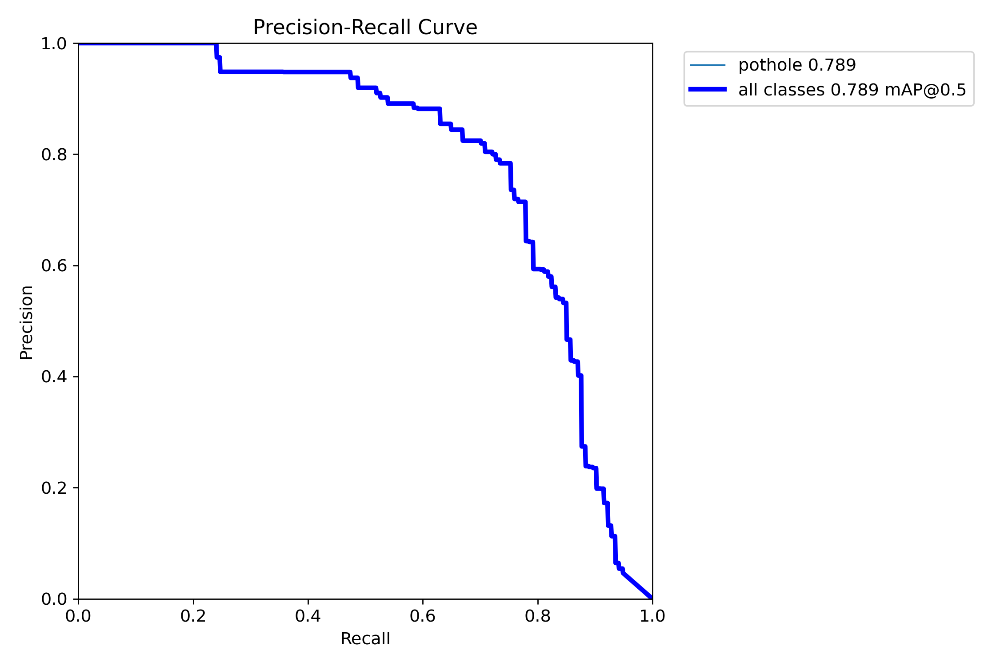

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov5n_ft1/PR_curve.png', width=600)

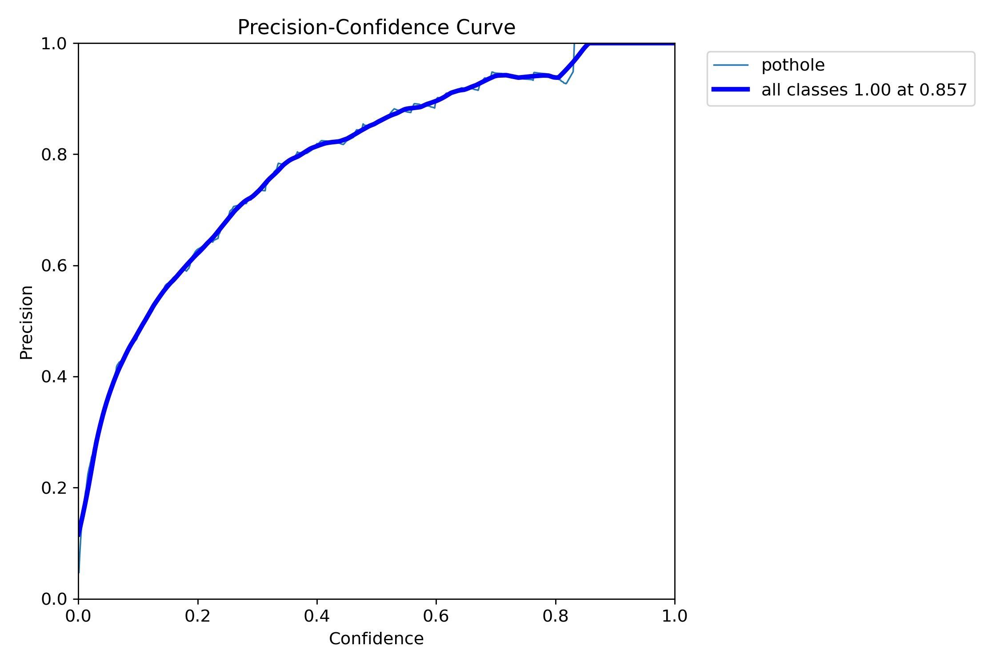

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov5n_ft1/P_curve.png', width=600)

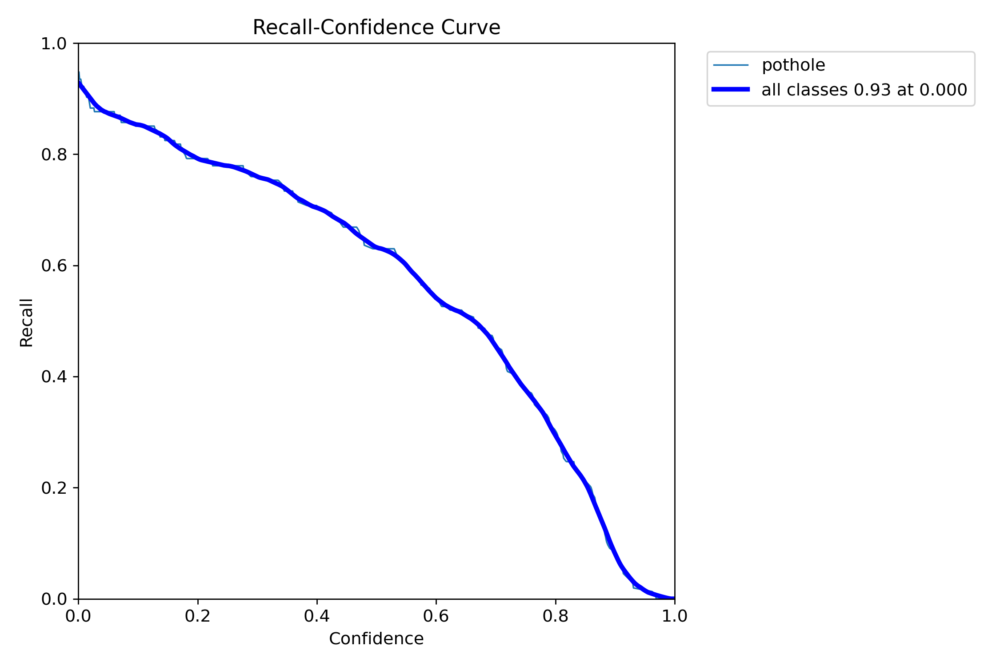

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov5n_ft1/R_curve.png', width=600)

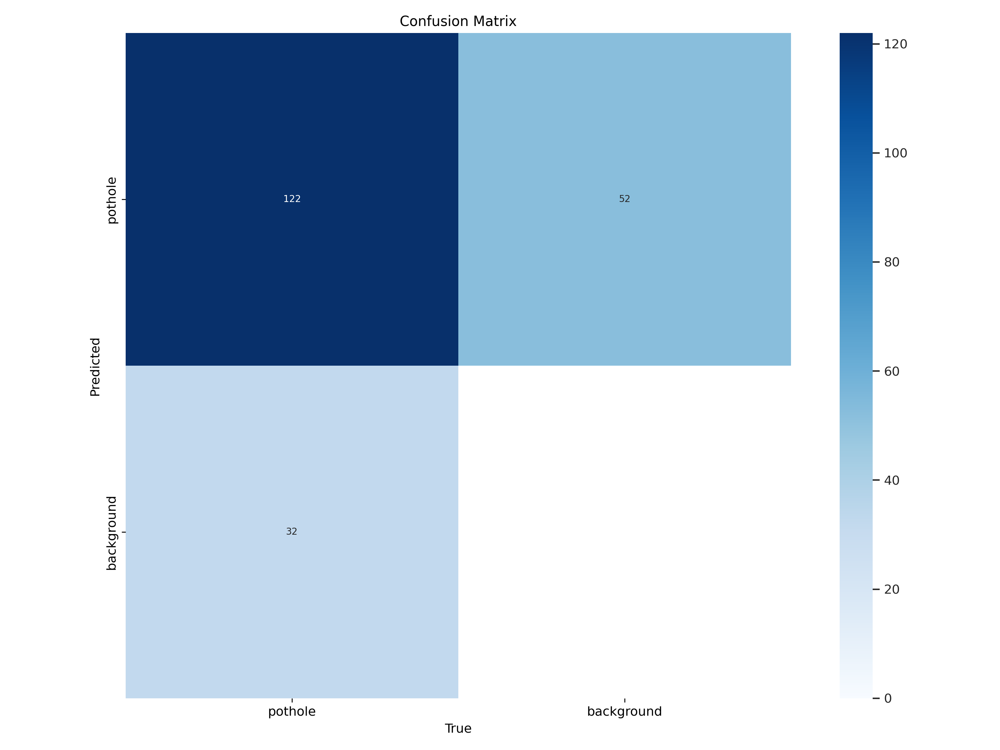

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov5n_ft1/confusion_matrix.png', width=600)

In [ ]:
model_v5.export(format='tflite')

Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.00GHz)

PyTorch: starting from 'runs/detect/yolov5n_ft1/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (5.0 MB)

TensorFlow SavedModel: starting export with tensorflow 2.17.1...

ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.45...
ONNX: export success ✅ 1.1s, saved as 'runs/detect/yolov5n_ft1/weights/best.onnx' (9.9 MB)
TensorFlow SavedModel: starting TFLite export with onnx2tf 1.26.3...
TensorFlow SavedModel: export success ✅ 27.9s, saved as 'runs/detect/yolov5n_ft1/weights/best_saved_model' (25.2 MB)

TensorFlow Lite: starting export with tensorflow 2.17.1...
TensorFlow Lite: export success ✅ 0.0s, saved as 'runs/detect/yolov5n_ft1/weights/best_saved_model/best_float32.tflite' (9.8 MB)

Export complete (28.2s)
Results saved to /content/runs/detect/yolov5n_ft1/weights
Predict:         yolo predict task=detect model=runs/detect/yolov5n_

'runs/detect/yolov5n_ft1/weights/best_saved_model/best_float32.tflite'

#### YOLOv6

In [ ]:
print("Training YOLOv6...")
model_v6.train(data=os.path.join(dataset_yolov6.location, 'data.yaml'),name='yolov6n_ft1', epochs=epochs, batch=batch_size, imgsz=imgsz)

Training YOLOv6...
Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov6n.yaml, data=/content/yolov6-dataset/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov6n_ft12, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labe

train: Scanning /content/yolov6-dataset/labels/train... 465 images, 0 backgrounds, 0 corrupt: 100%|██████████| 465/465 [00:00<00:00, 623.45it/s]

train: New cache created: /content/yolov6-dataset/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/yolov6-dataset/labels/valid... 133 images, 0 backgrounds, 0 corrupt: 100%|██████████| 133/133 [00:00<00:00, 492.10it/s]

val: New cache created: /content/yolov6-dataset/labels/valid.cache


Plotting labels to runs/detect/yolov6n_ft12/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 53 weight(decay=0.0), 62 weight(decay=0.0005), 61 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov6n_ft12
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50       1.8G      3.774      3.912       4.21          1        640: 100%|██████████| 30/30 [00:14<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.54it/s]

                   all        133        330    0.00193      0.218    0.00184   0.000515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      1.68G      3.522      3.565      3.864         10        640: 100%|██████████| 30/30 [00:07<00:00,  3.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.19it/s]

                   all        133        330      0.002      0.224    0.00225   0.000586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      1.67G      3.064      3.353      3.399          2        640: 100%|██████████| 30/30 [00:13<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.09it/s]

                   all        133        330    0.00323       0.13    0.00246   0.000713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      1.67G      2.882      3.259      3.155          4        640: 100%|██████████| 30/30 [00:07<00:00,  3.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.20it/s]


                   all        133        330     0.0511     0.0545     0.0116    0.00329

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      1.68G      2.752      3.065      2.942          9        640: 100%|██████████| 30/30 [00:11<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.04it/s]


                   all        133        330     0.0283      0.109      0.019    0.00515

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      1.66G      2.697      3.076      2.858          5        640: 100%|██████████| 30/30 [00:09<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.36it/s]

                   all        133        330     0.0522     0.0485     0.0185     0.0075



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      1.65G      2.582       2.94      2.721          4        640: 100%|██████████| 30/30 [00:10<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.16it/s]

                   all        133        330    0.00425      0.103    0.00339    0.00116



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      1.66G      2.578      2.855      2.649          4        640: 100%|██████████| 30/30 [00:09<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.94it/s]


                   all        133        330      0.119      0.215     0.0821     0.0272

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      1.65G       2.52      2.834      2.618          2        640: 100%|██████████| 30/30 [00:09<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.27it/s]

                   all        133        330        0.2      0.188      0.115     0.0508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      1.65G      2.463      2.741      2.519          2        640: 100%|██████████| 30/30 [00:11<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.16it/s]

                   all        133        330      0.159      0.197      0.098     0.0394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      1.67G      2.392      2.701       2.51          1        640: 100%|██████████| 30/30 [00:09<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.04it/s]

                   all        133        330       0.17      0.121     0.0695     0.0237



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      1.66G      2.317      2.604      2.415          5        640: 100%|██████████| 30/30 [00:11<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.30it/s]


                   all        133        330       0.23      0.282      0.169     0.0629

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      1.67G      2.243      2.516      2.362          3        640: 100%|██████████| 30/30 [00:07<00:00,  3.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.30it/s]

                   all        133        330      0.279      0.233      0.183     0.0724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      1.67G      2.228      2.483      2.339          3        640: 100%|██████████| 30/30 [00:12<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.47it/s]

                   all        133        330      0.158      0.285      0.139     0.0577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      1.65G      2.148      2.346      2.236         13        640: 100%|██████████| 30/30 [00:07<00:00,  4.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.61it/s]

                   all        133        330      0.324      0.291      0.248      0.103



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      1.66G      2.069      2.252      2.174         10        640: 100%|██████████| 30/30 [00:12<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.97it/s]

                   all        133        330      0.309      0.252       0.22     0.0895



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      1.66G      2.065      2.243      2.183          5        640: 100%|██████████| 30/30 [00:07<00:00,  3.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.30it/s]


                   all        133        330      0.427      0.318        0.3      0.137

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      1.67G      2.015      2.198      2.137          1        640: 100%|██████████| 30/30 [00:11<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.20it/s]

                   all        133        330      0.396      0.315      0.297      0.138



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      1.67G      2.029      2.123      2.119          6        640: 100%|██████████| 30/30 [00:08<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.09it/s]


                   all        133        330      0.425      0.339      0.334      0.144

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      1.69G      1.952      2.056      2.069          3        640: 100%|██████████| 30/30 [00:10<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.72it/s]

                   all        133        330      0.502      0.364      0.378      0.179



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      1.66G      1.946       2.09      2.081          3        640: 100%|██████████| 30/30 [00:10<00:00,  2.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.14it/s]

                   all        133        330      0.432      0.385      0.344       0.16



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      1.63G      1.891      2.008      2.004          2        640: 100%|██████████| 30/30 [00:09<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.89it/s]


                   all        133        330      0.359      0.376      0.331       0.15

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      1.67G      1.866      1.903      1.957          7        640: 100%|██████████| 30/30 [00:10<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.19it/s]


                   all        133        330      0.471      0.388       0.39      0.177

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      1.61G      1.882      1.983       1.98          6        640: 100%|██████████| 30/30 [00:08<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.14it/s]

                   all        133        330      0.446      0.376      0.358      0.181



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      1.66G      1.815      1.854      1.922          6        640: 100%|██████████| 30/30 [00:12<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.09it/s]


                   all        133        330      0.556      0.398      0.419      0.215

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      1.67G      1.895      1.927      1.988          3        640: 100%|██████████| 30/30 [00:07<00:00,  3.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.47it/s]

                   all        133        330      0.482        0.4      0.419      0.204



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      1.64G      1.828      1.956      1.973          2        640: 100%|██████████| 30/30 [00:12<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.91it/s]


                   all        133        330      0.512      0.427      0.449      0.225

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      1.67G      1.802       1.85      1.918          2        640: 100%|██████████| 30/30 [00:08<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.62it/s]

                   all        133        330      0.542      0.436      0.453      0.233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      1.64G      1.728      1.966      1.804          0        640: 100%|██████████| 30/30 [00:14<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.11it/s]

                   all        133        330      0.488      0.427      0.459       0.23



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      1.66G      1.759      1.847      1.864          1        640: 100%|██████████| 30/30 [00:12<00:00,  2.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.67it/s]

                   all        133        330      0.579      0.391      0.427      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      1.66G      1.808      1.833       1.95          2        640: 100%|██████████| 30/30 [00:07<00:00,  4.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.33it/s]

                   all        133        330      0.624      0.436      0.503      0.258



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      1.64G      1.783      1.777      1.865          2        640: 100%|██████████| 30/30 [00:13<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.44it/s]

                   all        133        330      0.525      0.389      0.393      0.178



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      1.68G      1.747      1.748      1.846         17        640: 100%|██████████| 30/30 [00:07<00:00,  4.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.34it/s]


                   all        133        330      0.647       0.47      0.552      0.273

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      1.68G       1.72      1.715      1.843         13        640: 100%|██████████| 30/30 [00:12<00:00,  2.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.96it/s]

                   all        133        330      0.658       0.47      0.565      0.293



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      1.67G      1.696      1.729      1.816          3        640: 100%|██████████| 30/30 [00:07<00:00,  3.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.33it/s]


                   all        133        330      0.696      0.412      0.527      0.272

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      1.62G      1.715      1.747      1.819          1        640: 100%|██████████| 30/30 [00:10<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.22it/s]


                   all        133        330      0.559      0.464      0.519      0.252

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      1.66G      1.702      1.665       1.79          4        640: 100%|██████████| 30/30 [00:09<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.11it/s]


                   all        133        330       0.65      0.473      0.568        0.3

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      1.62G       1.65      1.635      1.748          2        640: 100%|██████████| 30/30 [00:10<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.29it/s]

                   all        133        330      0.621      0.533       0.59      0.298



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      1.65G      1.664      1.666      1.784          2        640: 100%|██████████| 30/30 [00:11<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.10it/s]

                   all        133        330      0.605      0.527      0.571      0.302



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      1.67G      1.659      1.647      1.769          2        640: 100%|██████████| 30/30 [00:08<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.85it/s]

                   all        133        330      0.656      0.468      0.555      0.294


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      1.67G      1.561      1.679      1.741          2        640: 100%|██████████| 30/30 [00:15<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.23it/s]

                   all        133        330      0.645      0.464      0.544      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      1.63G       1.53      1.636      1.727          1        640: 100%|██████████| 30/30 [00:07<00:00,  4.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.22it/s]

                   all        133        330      0.601      0.527      0.574      0.303



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      1.63G      1.527      1.572      1.689          3        640: 100%|██████████| 30/30 [00:12<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.87it/s]


                   all        133        330       0.71      0.491      0.601      0.321

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      1.67G      1.612      1.619      1.786          1        640: 100%|██████████| 30/30 [00:08<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.49it/s]

                   all        133        330      0.645      0.536      0.596      0.324



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      1.67G      1.463      1.487      1.655          1        640: 100%|██████████| 30/30 [00:11<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.20it/s]

                   all        133        330      0.693      0.491      0.616      0.326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      1.67G       1.51      1.494      1.653          4        640: 100%|██████████| 30/30 [00:08<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.73it/s]

                   all        133        330       0.66      0.515      0.607      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      1.68G      1.502        1.5      1.685          1        640: 100%|██████████| 30/30 [00:11<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.57it/s]

                   all        133        330      0.665      0.547      0.622      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      1.65G      1.475      1.513      1.665          3        640: 100%|██████████| 30/30 [00:08<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.31it/s]

                   all        133        330      0.724      0.515       0.63      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      1.66G      1.451       1.42      1.621          5        640: 100%|██████████| 30/30 [00:09<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.74it/s]


                   all        133        330      0.715      0.524      0.628      0.346

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      1.67G      1.471      1.445      1.653          1        640: 100%|██████████| 30/30 [00:09<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.32it/s]


                   all        133        330      0.729      0.524      0.636      0.349

50 epochs completed in 0.189 hours.
Optimizer stripped from runs/detect/yolov6n_ft12/weights/last.pt, 8.7MB
Optimizer stripped from runs/detect/yolov6n_ft12/weights/best.pt, 8.7MB

Validating runs/detect/yolov6n_ft12/weights/best.pt...
Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv6n summary (fused): 142 layers, 4,233,843 parameters, 0 gradients, 11.8 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.50it/s]


                   all        133        330       0.73      0.523      0.636      0.348
Speed: 0.2ms preprocess, 3.3ms inference, 0.0ms loss, 5.4ms postprocess per image
Results saved to runs/detect/yolov6n_ft12


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7b0744198400>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

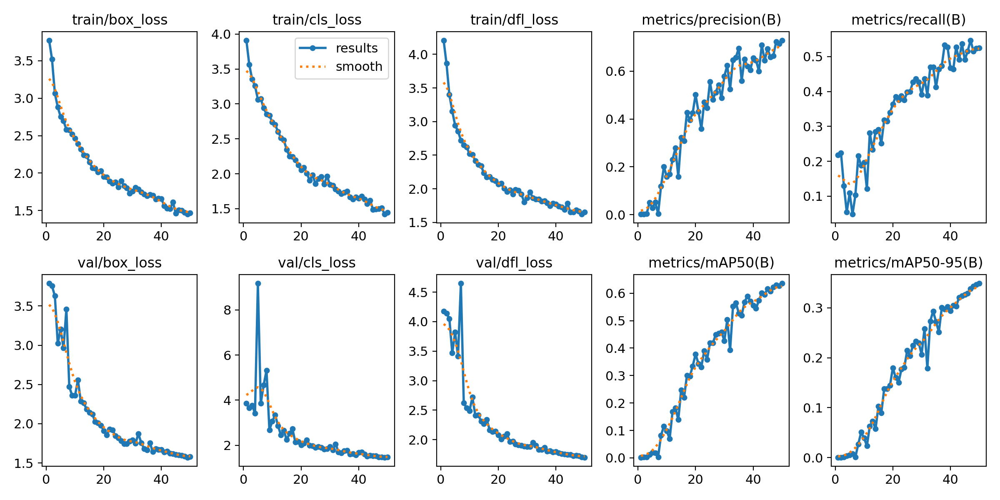

In [ ]:
Image(filename=f'/content/runs/detect/yolov6n_ft12/results.png', width=600)

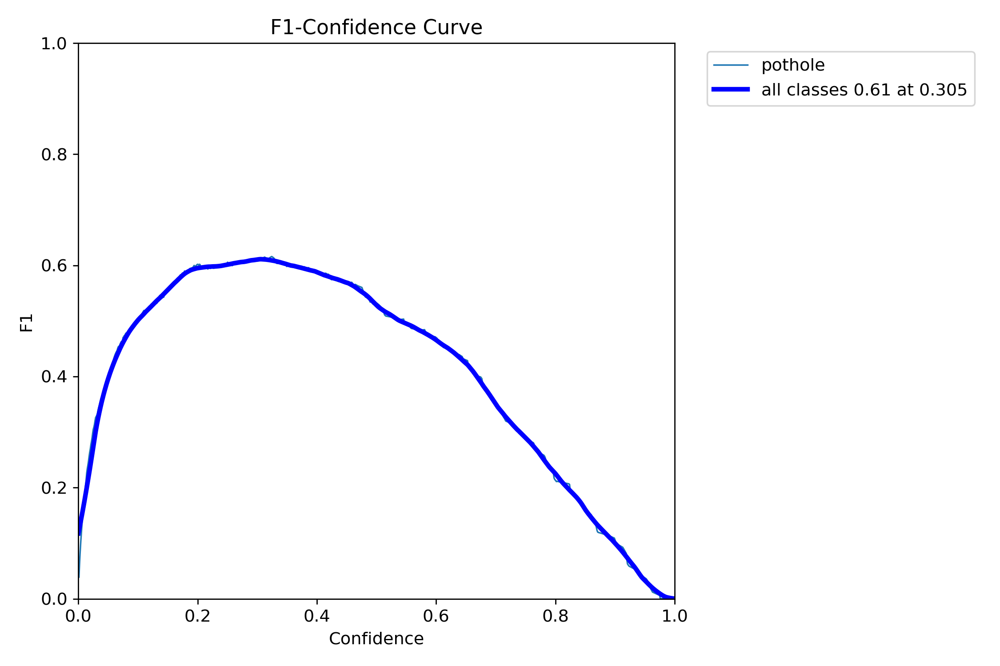

In [ ]:
Image(filename=f'/content/runs/detect/yolov6n_ft12/F1_curve.png', width=600)

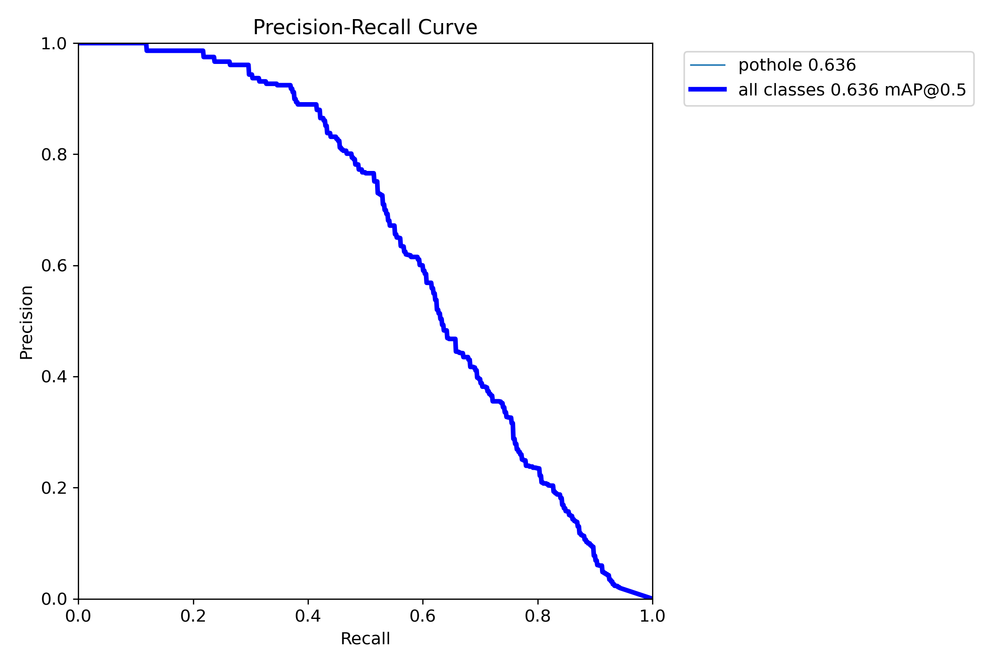

In [ ]:
Image(filename=f'/content/runs/detect/yolov6n_ft12/PR_curve.png', width=600)

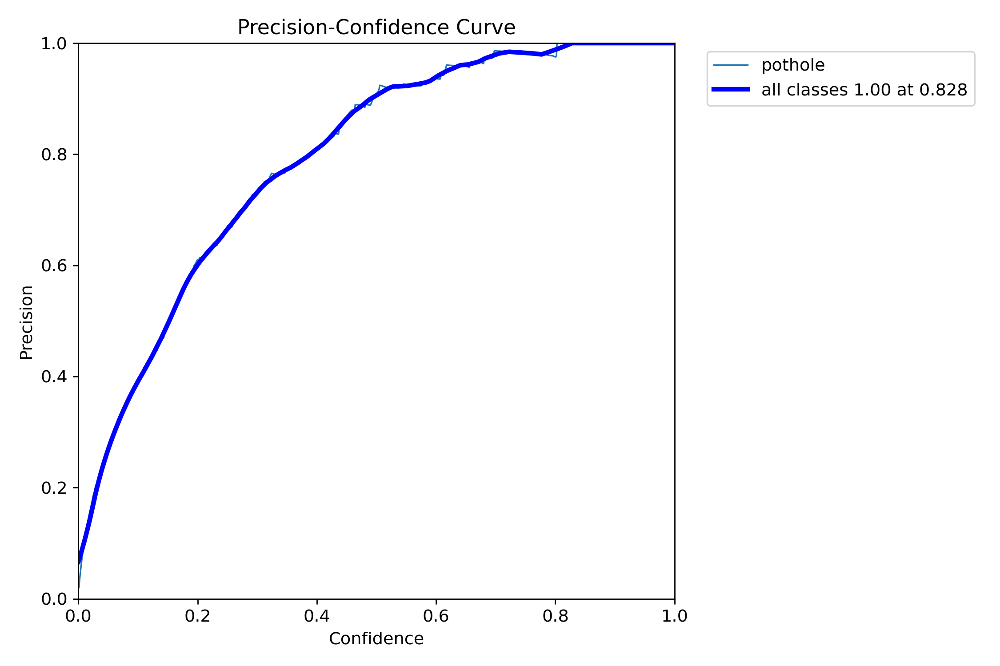

In [ ]:
Image(filename=f'/content/runs/detect/yolov6n_ft12/P_curve.png', width=600)

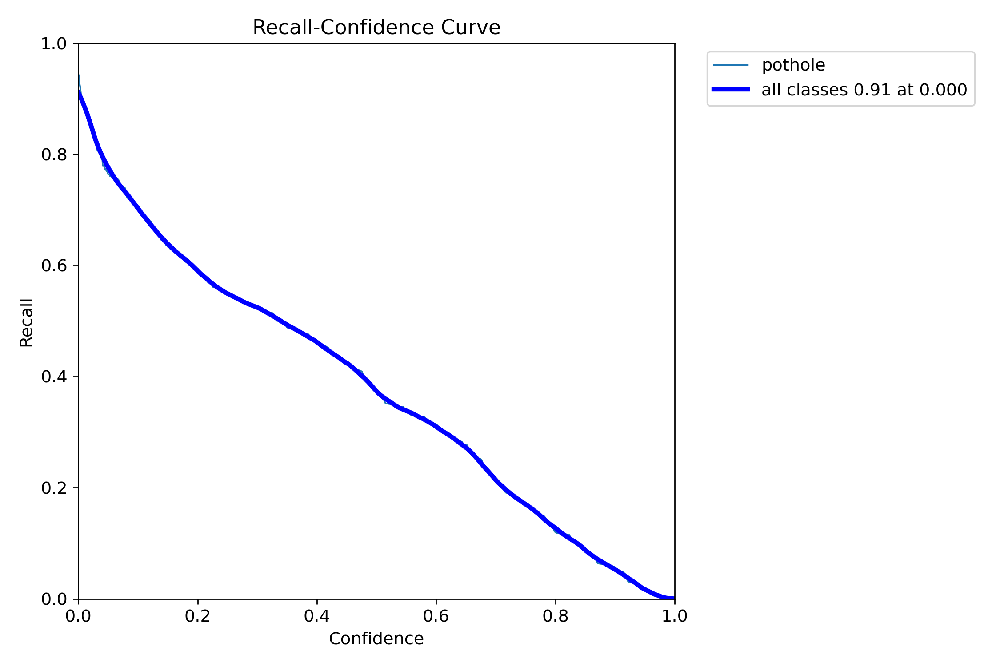

In [ ]:
Image(filename=f'/content/runs/detect/yolov6n_ft12/R_curve.png', width=600)

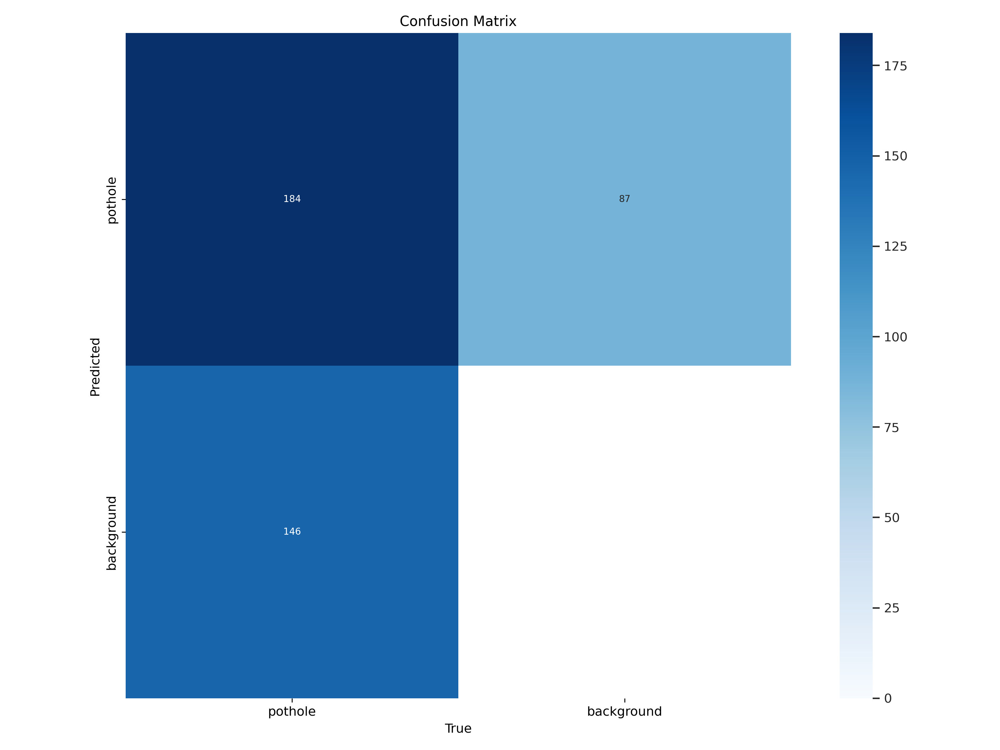

In [ ]:
Image(filename=f'/content/runs/detect/yolov6n_ft12/confusion_matrix.png', width=600)

In [ ]:
metrics_v6 = '/content/runs/detect/yolov6n_ft12/results.csv'

In [ ]:
results_v6 = model_v6.val(name='test_yolov6n_ft1',split='test')

Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv6n summary (fused): 142 layers, 4,233,843 parameters, 0 gradients, 11.8 GFLOPs


val: Scanning /content/yolov6-dataset/labels/test... 67 images, 0 backgrounds, 0 corrupt: 100%|██████████| 67/67 [00:00<00:00, 418.32it/s]

val: New cache created: /content/yolov6-dataset/labels/test.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.01it/s]


                   all         67        154      0.558      0.589      0.604      0.322
Speed: 0.5ms preprocess, 12.2ms inference, 0.0ms loss, 4.5ms postprocess per image
Results saved to runs/detect/test_yolov6n_ft1


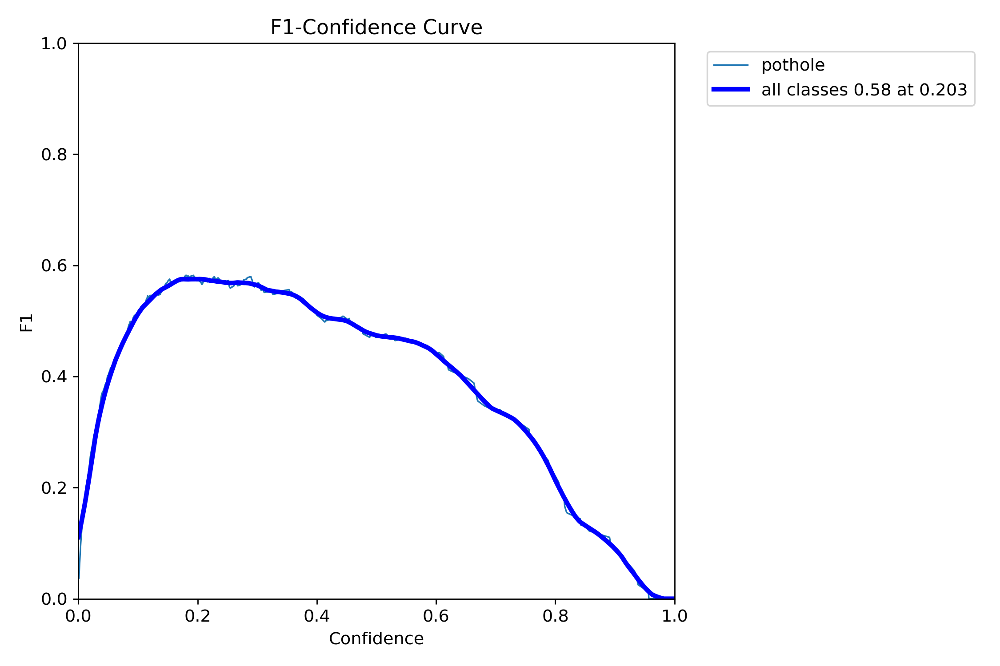

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov6n_ft1/F1_curve.png', width=600)

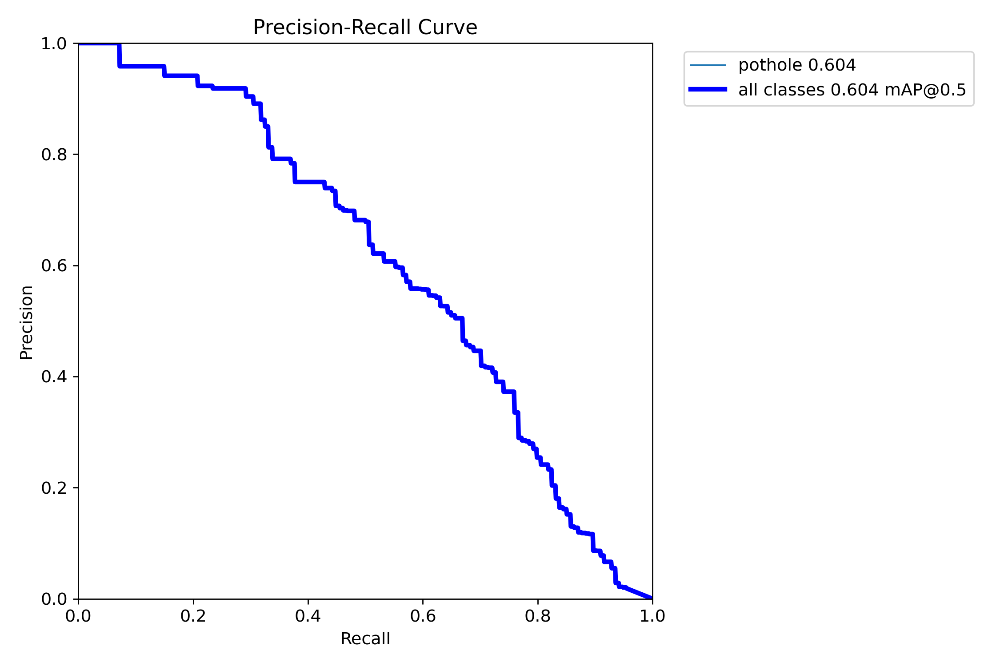

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov6n_ft1/PR_curve.png', width=600)

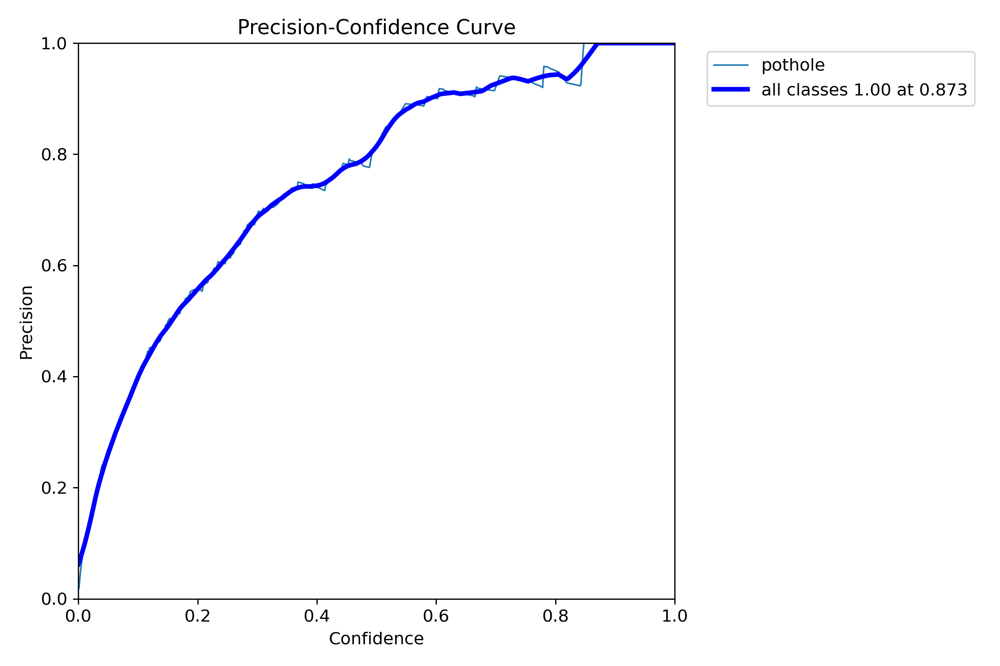

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov6n_ft1/P_curve.png', width=600)

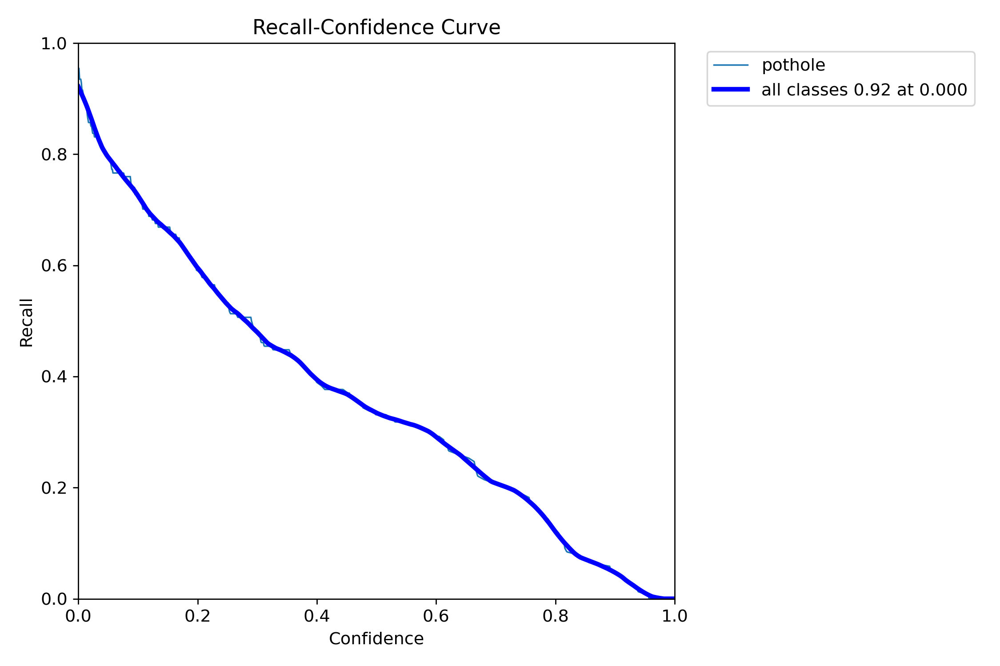

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov6n_ft1/R_curve.png', width=600)

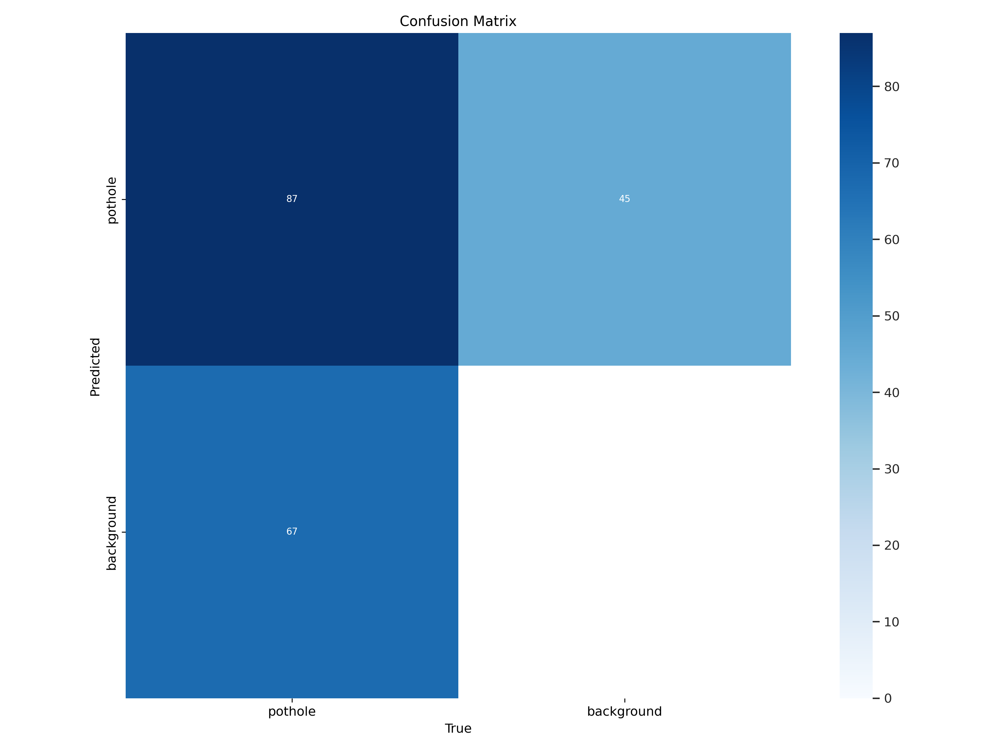

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov6n_ft1/confusion_matrix.png', width=600)

In [ ]:
model_v6.export(format='tflite')

Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.00GHz)
YOLOv6n summary (fused): 142 layers, 4,233,843 parameters, 0 gradients, 11.8 GFLOPs

PyTorch: starting from '/content/runs/detect/yolov6n_ft12/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (8.3 MB)
requirements: Ultralytics requirement ['onnxruntime'] not found, attempting AutoUpdate...
Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.3/13.3 MB 218.5 MB/s eta 0:00:00

requirements: AutoUpdate success ✅ 5.5s, installed 1 package: ['onnxruntime']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect


TensorFlow SavedModel: starting export with tensorflow 2.17.1...

ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.45...
ONNX: export success ✅ 1.2s, saved as '/content/runs/detect/yolov6n_ft12/weights/best.onnx' (16.4 MB)
TensorFlow SavedModel

'/content/runs/detect/yolov6n_ft12/weights/best_saved_model/best_float32.tflite'

#### YOLOv8

In [ ]:
print("Training YOLOv8...")
model_v8.train(data=os.path.join(dataset_yolov8.location, 'data.yaml'),name="yolov8n_ft1", epochs=epochs, batch=batch_size, imgsz=imgsz,device=0)

Training YOLOv8...
Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/yolov8-dataset/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=yolov8n_ft1, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=Tru

100%|██████████| 755k/755k [00:00<00:00, 142MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

train: Scanning /content/yolov8-dataset/train/labels... 465 images, 0 backgrounds, 0 corrupt: 100%|██████████| 465/465 [00:00<00:00, 1169.70it/s]


train: New cache created: /content/yolov8-dataset/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


A new version of Albumentations is available: 1.4.24 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
val: Scanning /content/yolov8-dataset/valid/labels... 133 images, 0 backgrounds, 0 corrupt: 100%|██████████| 133/133 [00:00<00:00, 918.50it/s]

val: New cache created: /content/yolov8-dataset/valid/labels.cache


Plotting labels to runs/detect/yolov8n_ft1/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolov8n_ft1
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50       1.9G      1.886      3.032      1.744          2        640: 100%|██████████| 30/30 [00:06<00:00,  4.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.41it/s]

                   all        133        330    0.00426      0.515     0.0105    0.00427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      1.87G      1.715      2.254      1.553          2        640: 100%|██████████| 30/30 [00:04<00:00,  7.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.75it/s]

                   all        133        330      0.571     0.0364      0.057      0.022



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      1.87G      1.725      1.996      1.551          6        640: 100%|██████████| 30/30 [00:04<00:00,  7.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.94it/s]

                   all        133        330      0.258        0.2      0.147       0.06



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      1.81G      1.666      1.915      1.521          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.23it/s]

                   all        133        330      0.211      0.194     0.0853     0.0311



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50       1.9G      1.681      1.922      1.532          7        640: 100%|██████████| 30/30 [00:04<00:00,  7.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.79it/s]

                   all        133        330      0.361      0.238      0.206     0.0862



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50       1.9G      1.637      1.783      1.508          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.98it/s]

                   all        133        330      0.341      0.279       0.23     0.0945



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      1.89G      1.688      1.825      1.584          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.19it/s]

                   all        133        330      0.435      0.336       0.33      0.162



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      1.93G        1.6      1.629      1.463          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.30it/s]

                   all        133        330      0.467      0.364      0.382      0.179



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50       1.9G      1.595      1.611      1.492          2        640: 100%|██████████| 30/30 [00:04<00:00,  7.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.85it/s]

                   all        133        330      0.532      0.513      0.497      0.244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      1.89G      1.521      1.504      1.428          6        640: 100%|██████████| 30/30 [00:04<00:00,  7.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.94it/s]

                   all        133        330      0.608      0.494      0.552      0.288



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      1.89G      1.505      1.473      1.391          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.21it/s]

                   all        133        330      0.534      0.469      0.475      0.252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50       1.9G      1.507      1.439      1.378          7        640: 100%|██████████| 30/30 [00:04<00:00,  7.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.91it/s]

                   all        133        330      0.596      0.568      0.595      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      1.89G       1.53      1.508       1.42          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.97it/s]

                   all        133        330        0.7      0.497      0.599      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      1.94G       1.48      1.396      1.391          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.13it/s]

                   all        133        330      0.505      0.461      0.448      0.232



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      1.89G      1.456      1.341       1.36          4        640: 100%|██████████| 30/30 [00:04<00:00,  7.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.24it/s]

                   all        133        330      0.751      0.527      0.648      0.352



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      1.91G      1.398        1.3      1.333          2        640: 100%|██████████| 30/30 [00:04<00:00,  7.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.93it/s]

                   all        133        330      0.608      0.584      0.596      0.326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      1.89G       1.46      1.301       1.37          6        640: 100%|██████████| 30/30 [00:04<00:00,  7.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.21it/s]

                   all        133        330      0.693      0.579      0.652      0.367



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50       1.9G      1.403      1.302      1.353          4        640: 100%|██████████| 30/30 [00:04<00:00,  7.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.96it/s]

                   all        133        330      0.683        0.6      0.668      0.363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      1.87G      1.389      1.249      1.325         20        640: 100%|██████████| 30/30 [00:04<00:00,  7.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.17it/s]

                   all        133        330      0.713      0.561      0.645      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      1.91G      1.336      1.215      1.294          2        640: 100%|██████████| 30/30 [00:04<00:00,  7.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.18it/s]

                   all        133        330      0.734       0.57      0.688        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      1.89G       1.39      1.248      1.334          2        640: 100%|██████████| 30/30 [00:04<00:00,  7.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.57it/s]

                   all        133        330      0.689       0.63      0.688      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      1.91G       1.38      1.226      1.337         15        640: 100%|██████████| 30/30 [00:04<00:00,  7.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.32it/s]

                   all        133        330      0.743      0.606      0.709      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      1.87G      1.381      1.305      1.336          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.20it/s]

                   all        133        330      0.722      0.627      0.726      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      1.87G      1.327      1.167      1.295          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.00it/s]

                   all        133        330      0.752      0.663      0.733      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      1.89G      1.275      1.129      1.247          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.27it/s]

                   all        133        330       0.75      0.588      0.692      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      1.87G      1.289      1.156      1.265          6        640: 100%|██████████| 30/30 [00:04<00:00,  7.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.08it/s]

                   all        133        330      0.758      0.579      0.704      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      1.89G      1.311      1.141      1.282         10        640: 100%|██████████| 30/30 [00:04<00:00,  7.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.28it/s]

                   all        133        330      0.673      0.636      0.707      0.425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50       1.9G      1.272      1.094      1.264         10        640: 100%|██████████| 30/30 [00:04<00:00,  7.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.29it/s]

                   all        133        330      0.766      0.648      0.734      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      1.89G      1.259      1.092      1.238          4        640: 100%|██████████| 30/30 [00:04<00:00,  7.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.74it/s]

                   all        133        330      0.738       0.63      0.737      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      1.89G      1.242      1.105      1.235          2        640: 100%|██████████| 30/30 [00:04<00:00,  7.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.38it/s]

                   all        133        330      0.734      0.642      0.711      0.418



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      1.94G      1.227      1.004      1.212          5        640: 100%|██████████| 30/30 [00:04<00:00,  7.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.56it/s]

                   all        133        330      0.705      0.651      0.702      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      1.89G      1.261      1.014      1.241          2        640: 100%|██████████| 30/30 [00:04<00:00,  7.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.26it/s]

                   all        133        330      0.746      0.633      0.717      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      1.89G      1.211      1.033      1.202          4        640: 100%|██████████| 30/30 [00:04<00:00,  7.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.19it/s]

                   all        133        330      0.817      0.633      0.738      0.437



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50       1.9G      1.252      1.014      1.223         12        640: 100%|██████████| 30/30 [00:04<00:00,  7.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.33it/s]

                   all        133        330      0.814       0.63      0.749      0.443



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      1.89G      1.219     0.9856      1.232          4        640: 100%|██████████| 30/30 [00:04<00:00,  7.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.04it/s]

                   all        133        330      0.808      0.679      0.774      0.468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      1.89G      1.194      0.984      1.208          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.37it/s]

                   all        133        330      0.796      0.675      0.758       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      1.89G      1.212     0.9933      1.212          5        640: 100%|██████████| 30/30 [00:04<00:00,  7.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.95it/s]

                   all        133        330      0.734      0.628      0.718      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      1.92G      1.141     0.9577      1.167          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.21it/s]

                   all        133        330      0.839      0.647      0.767      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      1.89G      1.157     0.9238      1.185          6        640: 100%|██████████| 30/30 [00:04<00:00,  7.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.88it/s]

                   all        133        330      0.773      0.645      0.763      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50       1.9G      1.179      1.003        1.2          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.78it/s]

                   all        133        330      0.803      0.658      0.772      0.484


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50       1.9G      1.106     0.9793      1.121          2        640: 100%|██████████| 30/30 [00:05<00:00,  5.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.04it/s]

                   all        133        330      0.773      0.667      0.758      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50       1.9G      1.103     0.8911      1.171          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.09it/s]

                   all        133        330      0.806      0.685      0.777      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      1.85G      1.087     0.8728      1.139          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.07it/s]

                   all        133        330      0.811      0.691      0.783      0.474



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50       1.9G      1.097     0.8878      1.182          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.26it/s]

                   all        133        330      0.816      0.688      0.788      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      1.89G      1.035     0.8143      1.106          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.81it/s]

                   all        133        330       0.82       0.67      0.775      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      1.87G      1.071     0.7954      1.132          4        640: 100%|██████████| 30/30 [00:04<00:00,  7.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.19it/s]

                   all        133        330       0.75      0.712      0.784      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50       1.9G      1.066     0.8025      1.123          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.18it/s]

                   all        133        330      0.811      0.691      0.794       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      1.87G      1.073     0.7896      1.166          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.72it/s]

                   all        133        330      0.819        0.7      0.794      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      1.89G      1.007      0.759      1.093          5        640: 100%|██████████| 30/30 [00:04<00:00,  7.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.05it/s]

                   all        133        330      0.793      0.709      0.786      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      1.87G     0.9835     0.7294      1.085          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.11it/s]

                   all        133        330      0.787      0.697      0.794      0.498



50 epochs completed in 0.078 hours.
Optimizer stripped from runs/detect/yolov8n_ft1/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/yolov8n_ft1/weights/best.pt, 6.2MB

Validating runs/detect/yolov8n_ft1/weights/best.pt...
Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.30it/s]


                   all        133        330      0.787      0.697      0.794      0.497
Speed: 0.2ms preprocess, 3.8ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to runs/detect/yolov8n_ft1


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7a84cc78b160>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

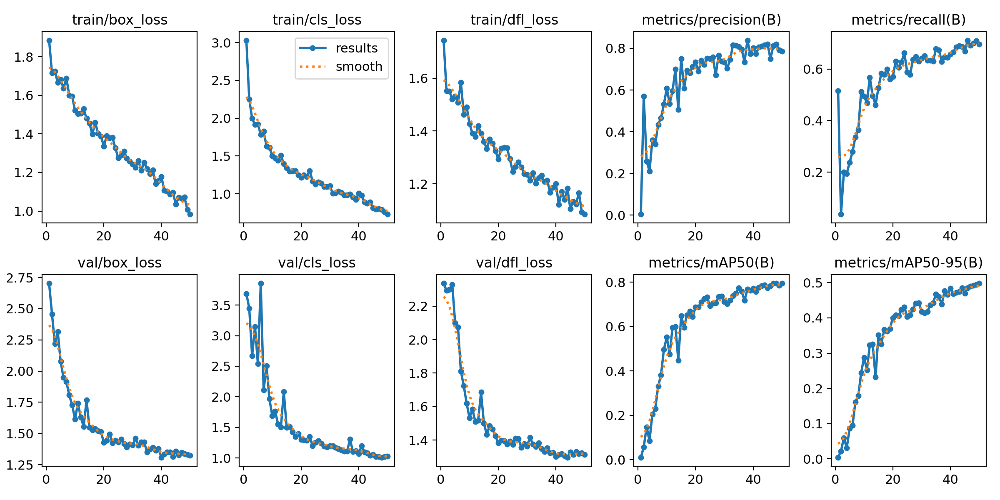

In [ ]:
Image(filename=f'/content/runs/detect/yolov8n_ft1/results.png', width=600)

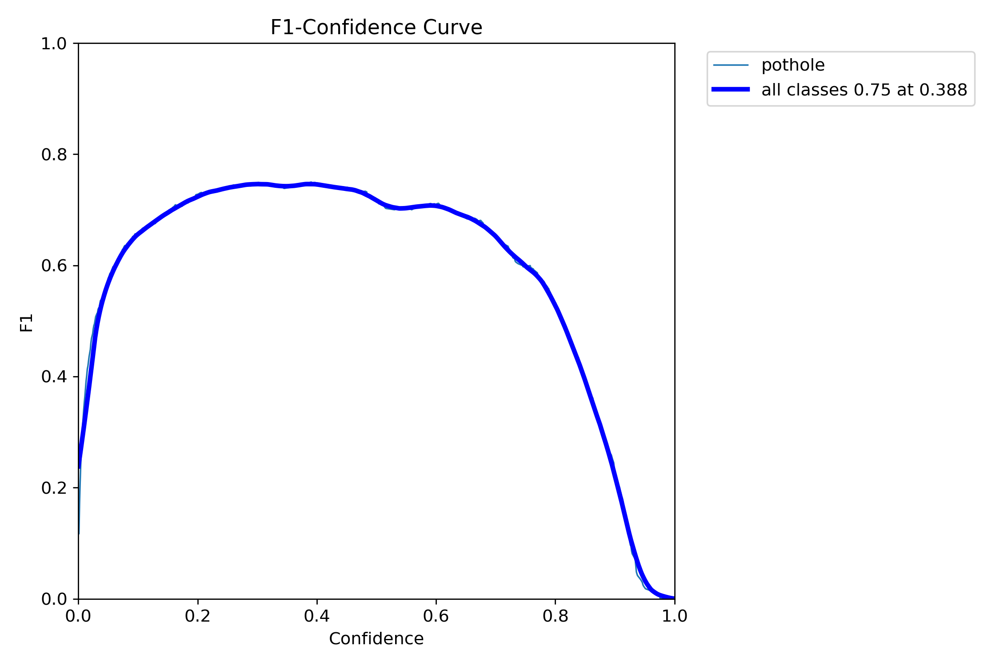

In [ ]:
Image(filename=f'/content/runs/detect/yolov8n_ft1/F1_curve.png', width=600)

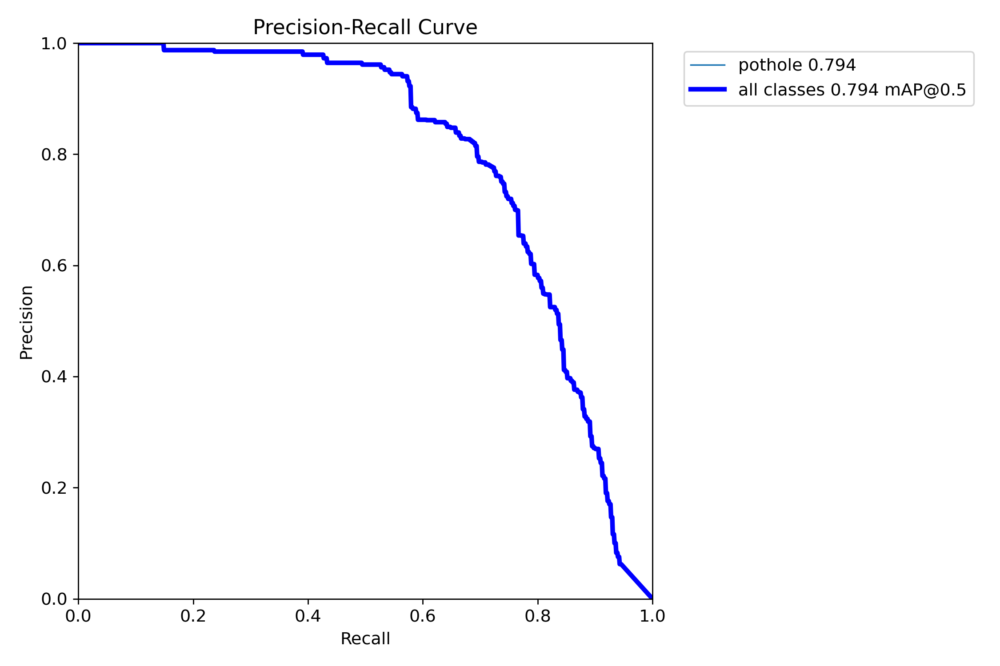

In [ ]:
Image(filename=f'/content/runs/detect/yolov8n_ft1/PR_curve.png', width=600)

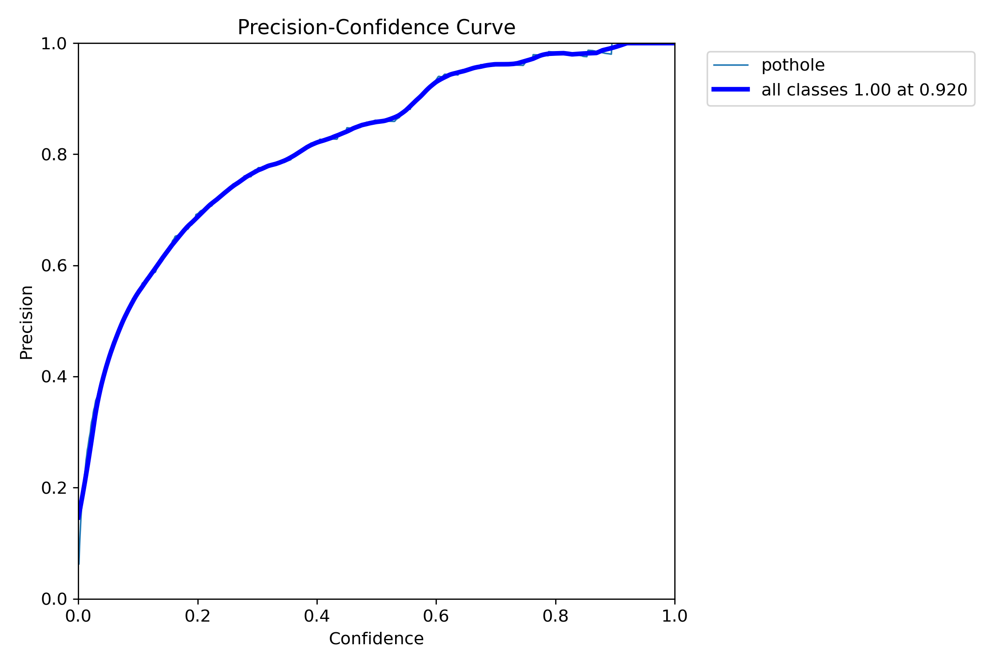

In [ ]:
Image(filename=f'/content/runs/detect/yolov8n_ft1/P_curve.png', width=600)

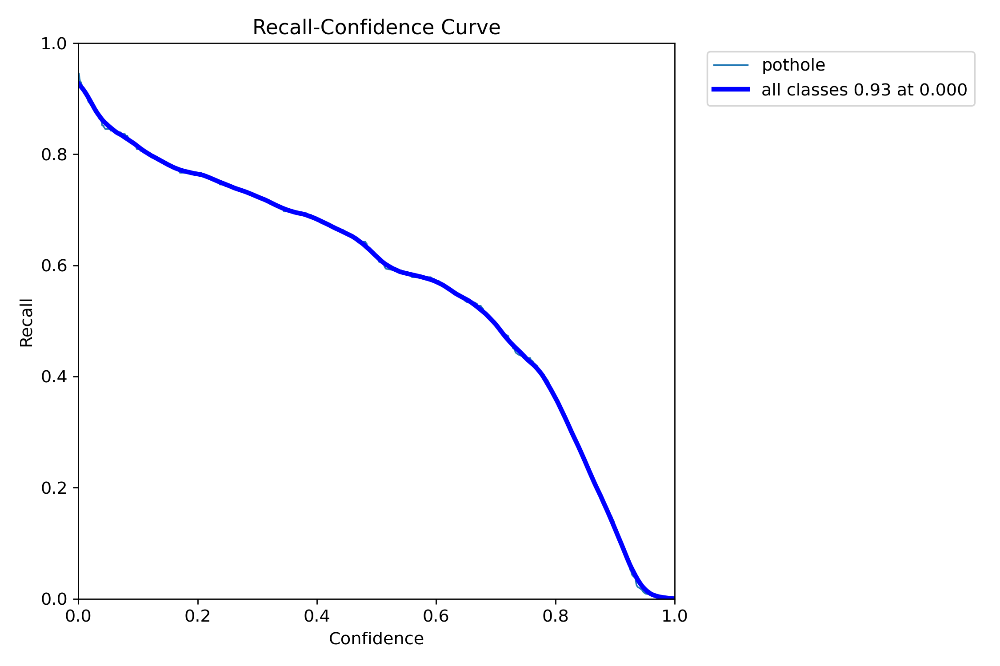

In [ ]:
Image(filename=f'/content/runs/detect/yolov8n_ft1/R_curve.png', width=600)

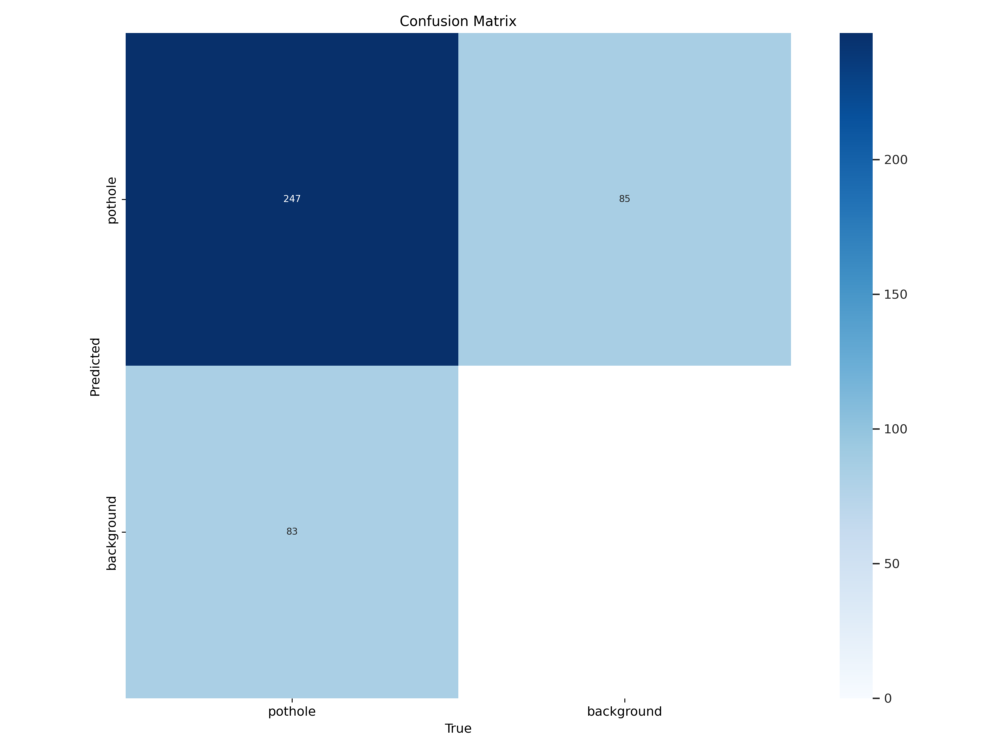

In [ ]:
Image(filename=f'/content/runs/detect/yolov8n_ft1/confusion_matrix.png', width=600)

In [ ]:
metrics_v8 = '/content/runs/detect/yolov8n_ft1/results.csv'

In [ ]:
results_v8 = model_v8.val(name="test_yolov8n_ft1",split='test')

Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/yolov8-dataset/test/labels... 67 images, 0 backgrounds, 0 corrupt: 100%|██████████| 67/67 [00:00<00:00, 1128.50it/s]

val: New cache created: /content/yolov8-dataset/test/labels.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.84it/s]


                   all         67        154      0.793      0.721      0.787      0.493
Speed: 0.2ms preprocess, 10.4ms inference, 0.0ms loss, 4.8ms postprocess per image
Results saved to runs/detect/test_yolov8n_ft1


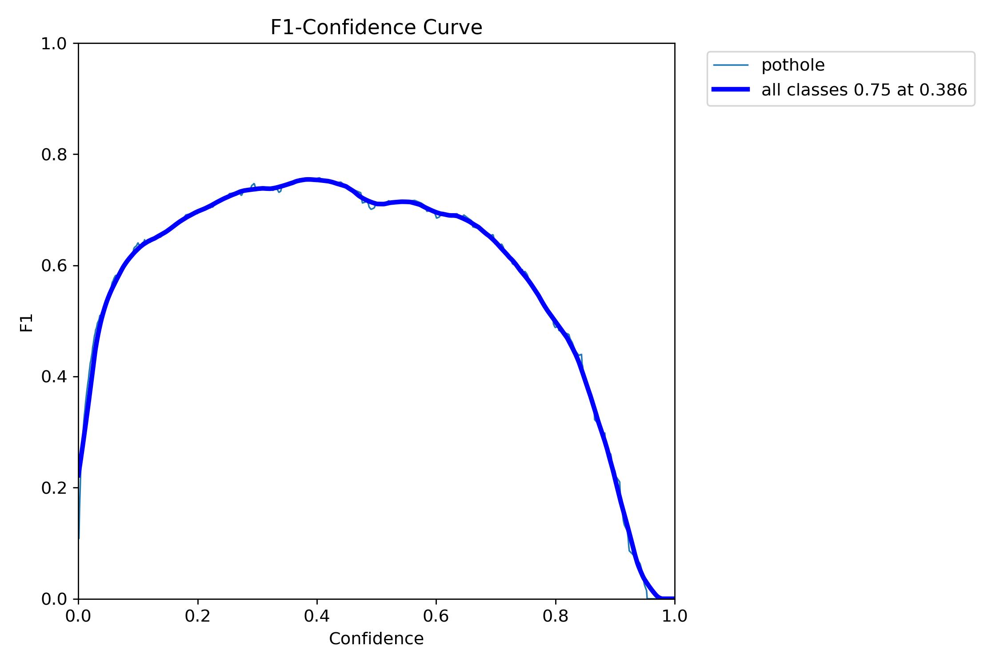

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov8n_ft1/F1_curve.png', width=600)

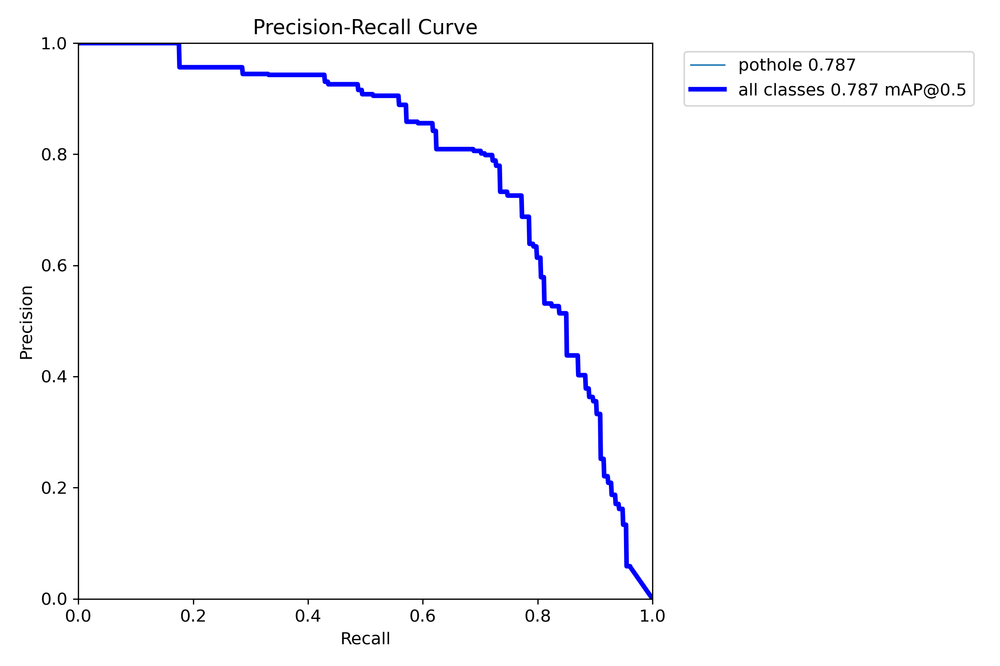

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov8n_ft1/PR_curve.png', width=600)

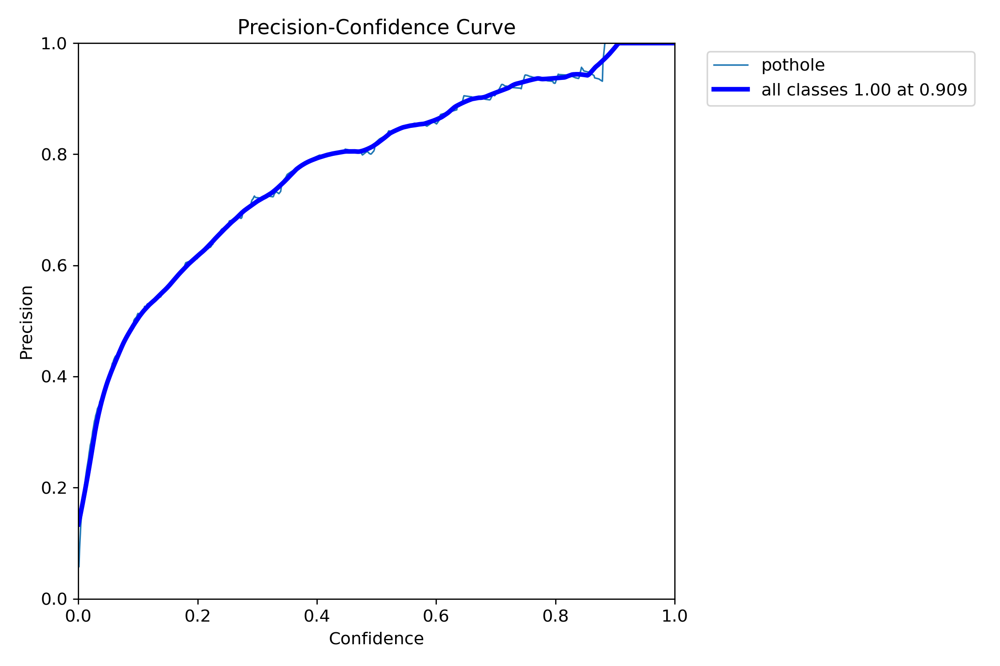

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov8n_ft1/P_curve.png', width=600)

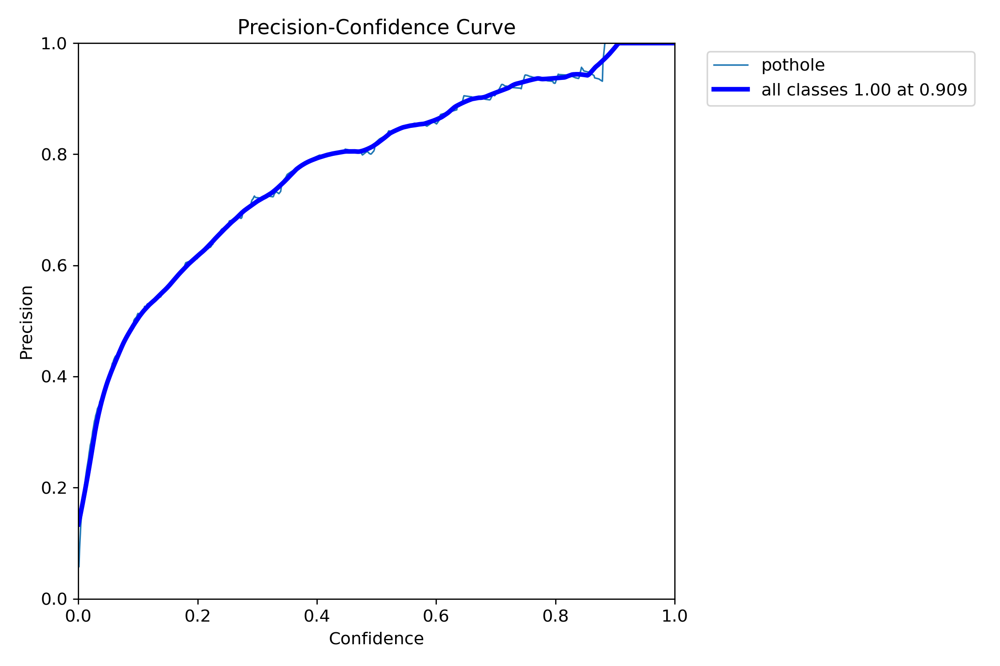

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov8n_ft1/P_curve.png', width=600)

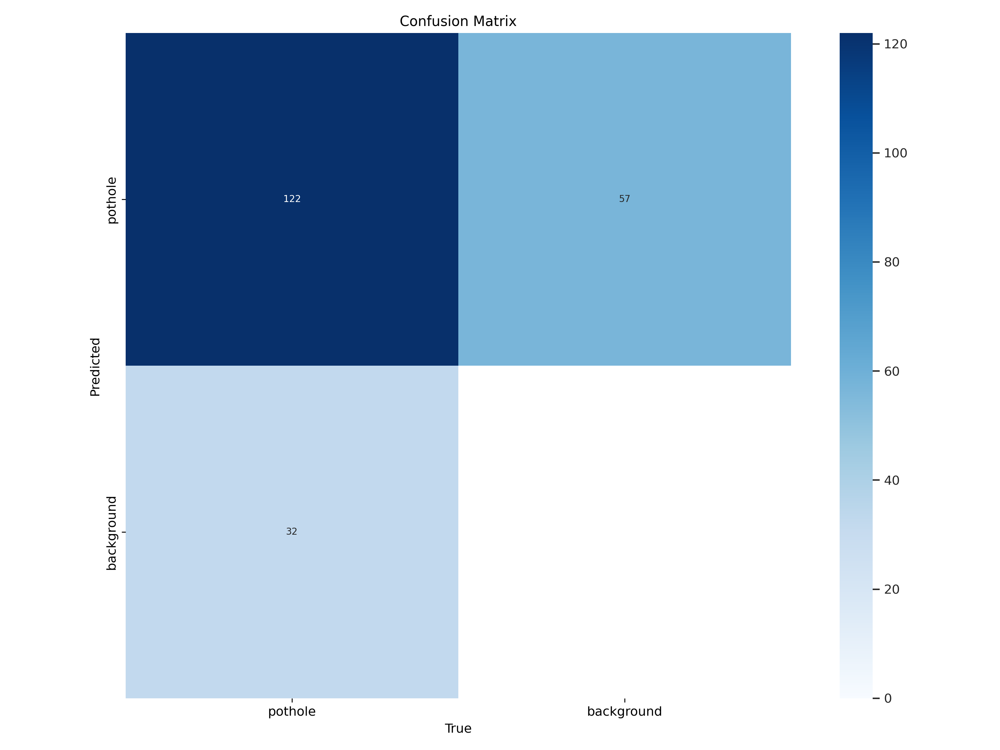

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov8n_ft1/confusion_matrix.png', width=600)

In [ ]:
model_v8.export(format='tflite')

Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.00GHz)

PyTorch: starting from 'runs/detect/yolov8n_ft1/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (5.9 MB)
requirements: Ultralytics requirements ['sng4onnx>=1.0.1', 'onnx_graphsurgeon>=0.3.26', 'onnx>=1.12.0', 'onnx2tf>1.17.5,<=1.26.3', 'onnxslim>=0.1.31', 'tflite_support', 'onnxruntime-gpu'] not found, attempting AutoUpdate...
Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 146.6/146.6 kB 91.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.4/56.4 kB 240.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.0/16.0 MB 179.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 445.6/445.6 kB 289.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 142.6/142.6 kB 348.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.8/60.8 MB 204.1 MB/s et

100%|██████████| 1.11M/1.11M [00:00<00:00, 115MB/s]
Unzipping calibration_image_sample_data_20x128x128x3_float32.npy.zip to /content/calibration_image_sample_data_20x128x128x3_float32.npy...: 100%|██████████| 1/1 [00:00<00:00, 49.92file/s]


ONNX: starting export with onnx 1.17.0 opset 19...


ONNX: slimming with onnxslim 0.1.45...
ONNX: export success ✅ 1.0s, saved as 'runs/detect/yolov8n_ft1/weights/best.onnx' (11.8 MB)
TensorFlow SavedModel: starting TFLite export with onnx2tf 1.26.3...
TensorFlow SavedModel: export success ✅ 78.5s, saved as 'runs/detect/yolov8n_ft1/weights/best_saved_model' (30.0 MB)

TensorFlow Lite: starting export with tensorflow 2.17.1...
TensorFlow Lite: export success ✅ 0.0s, saved as 'runs/detect/yolov8n_ft1/weights/best_saved_model/best_float32.tflite' (11.7 MB)

Export complete (80.0s)
Results saved to /content/runs/detect/yolov8n_ft1/weights
Predict:         yolo predict task=detect model=runs/detect/yolov8n_ft1/weights/best_saved_model/best_float32.tflite imgsz=640  
Validate:        yolo val task=detect model=runs/detect/yolov8n_ft1/weights/best_saved_model/best_float32.tflite imgsz=640 data=/content/yolov8-dataset/data.yaml  
Visualize:       https://netron.app


'runs/detect/yolov8n_ft1/weights/best_saved_model/best_float32.tflite'

#### YOLOv10

In [ ]:
print("Training YOLOv10...")
model_v10.train(data=os.path.join(dataset_yolov8.location, 'data.yaml'), epochs=epochs, batch=batch_size,name='yolov10n_ft1',imgsz=imgsz)

Training YOLOv10...
Ultralytics 8.3.58 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov10n.pt, data=/content/yolov8-dataset/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov10n_ft1, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labe

100%|██████████| 755k/755k [00:00<00:00, 76.4MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1      9856  ultralytics.nn.modules.block.SCDown          [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1     36096  ultralytics

train: Scanning /content/yolov8-dataset/train/labels... 465 images, 0 backgrounds, 0 corrupt: 100%|██████████| 465/465 [00:00<00:00, 1178.00it/s]

train: New cache created: /content/yolov8-dataset/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


A new version of Albumentations is available: 1.4.24 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
val: Scanning /content/yolov8-dataset/valid/labels... 133 images, 0 backgrounds, 0 corrupt: 100%|██████████| 133/133 [00:00<00:00, 837.79it/s]

val: New cache created: /content/yolov8-dataset/valid/labels.cache


Plotting labels to runs/detect/yolov10n_ft1/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 95 weight(decay=0.0), 108 weight(decay=0.0005), 107 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolov10n_ft1
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.41G      3.752      8.314      3.439          2        640: 100%|██████████| 30/30 [00:07<00:00,  3.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.43it/s]

                   all        133        330    0.00203      0.245     0.0114    0.00445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      2.49G      3.508      6.395      3.112          2        640: 100%|██████████| 30/30 [00:05<00:00,  5.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.48it/s]

                   all        133        330     0.0015      0.182    0.00187   0.000588



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.49G      3.468      5.401      3.068          6        640: 100%|██████████| 30/30 [00:05<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.67it/s]

                   all        133        330    0.00301      0.364     0.0029   0.000857



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.47G      3.481       4.96      3.011          3        640: 100%|██████████| 30/30 [00:05<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.43it/s]

                   all        133        330     0.0947     0.0364     0.0187    0.00501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.51G      3.537      4.741      3.117          7        640: 100%|██████████| 30/30 [00:05<00:00,  5.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.63it/s]

                   all        133        330       0.24     0.0394     0.0311     0.0133



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.51G      3.264      4.375      2.954          1        640: 100%|██████████| 30/30 [00:05<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.19it/s]

                   all        133        330        0.3      0.274       0.21        0.1



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50       2.5G      3.395      4.276      3.089          1        640: 100%|██████████| 30/30 [00:05<00:00,  5.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.43it/s]

                   all        133        330      0.445      0.203      0.195     0.0949



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.47G      3.338      3.967      2.952          3        640: 100%|██████████| 30/30 [00:05<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.26it/s]

                   all        133        330      0.402      0.397      0.362      0.172



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.43G       3.25      3.832      2.963          2        640: 100%|██████████| 30/30 [00:05<00:00,  5.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.44it/s]

                   all        133        330      0.443      0.352      0.334      0.168



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.42G      3.191      3.568      2.842          6        640: 100%|██████████| 30/30 [00:05<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.39it/s]

                   all        133        330      0.386      0.325      0.313      0.162



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.42G       3.13      3.489      2.809          3        640: 100%|██████████| 30/30 [00:05<00:00,  5.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.52it/s]

                   all        133        330       0.48      0.455      0.428      0.211



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.44G      3.207       3.43      2.829          7        640: 100%|██████████| 30/30 [00:05<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  60%|██████    | 3/5 [00:00<00:00,  5.36it/s]

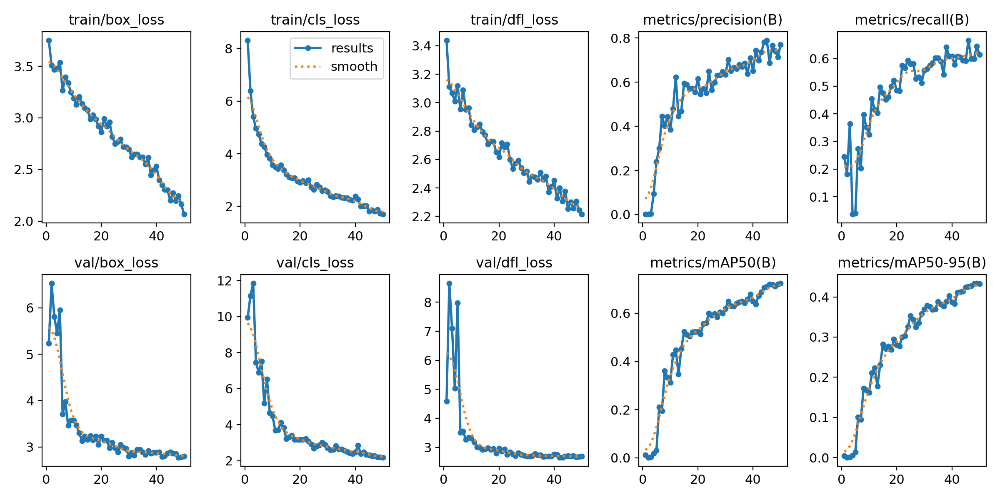

In [ ]:
Image(filename=f'/content/runs/detect/yolov10n_ft1/results.png', width=600)

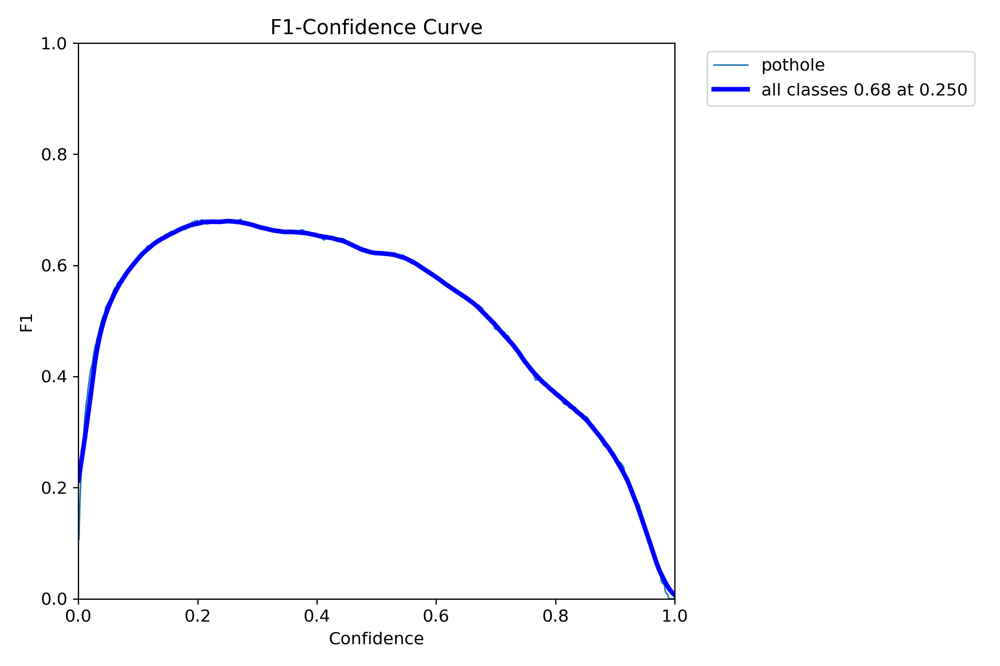

In [ ]:
Image(filename=f'/content/runs/detect/yolov10n_ft1/F1_curve.png', width=600)

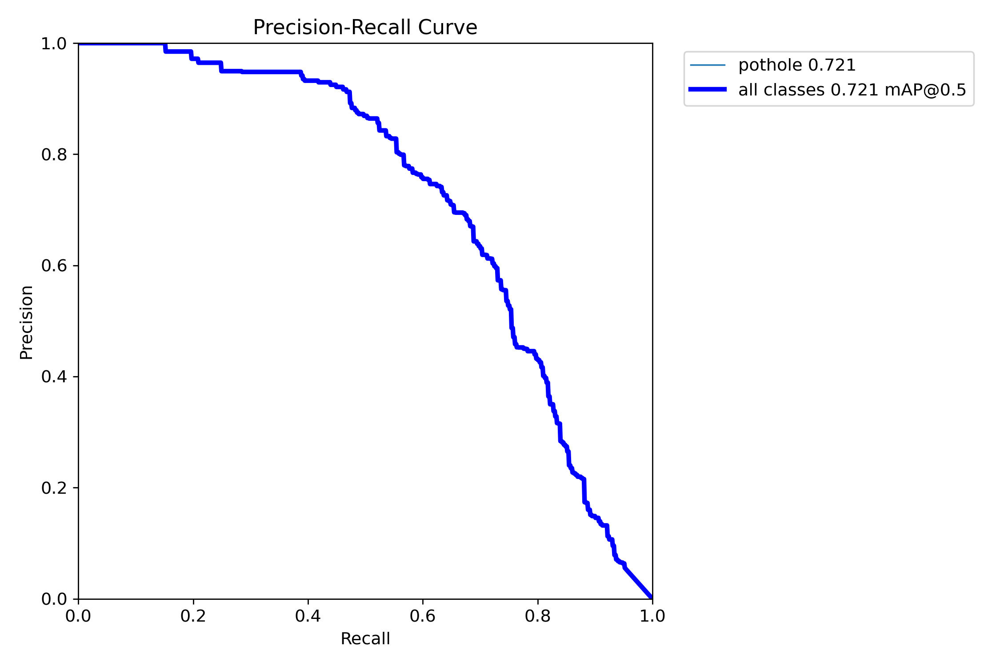

In [ ]:
Image(filename=f'/content/runs/detect/yolov10n_ft1/PR_curve.png', width=600)

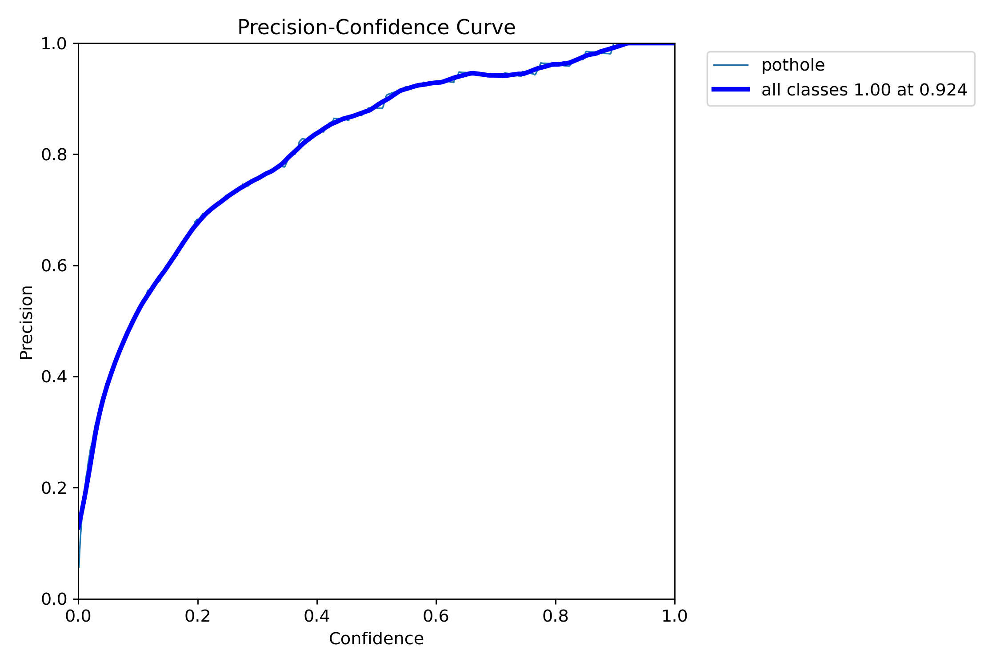

In [ ]:
Image(filename=f'/content/runs/detect/yolov10n_ft1/P_curve.png', width=600)

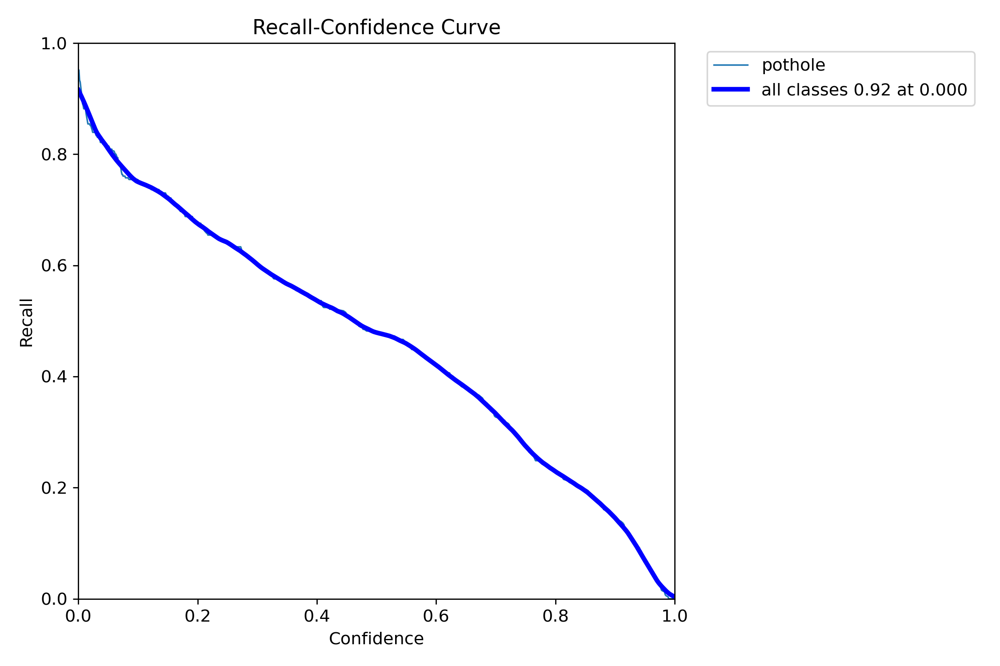

In [ ]:
Image(filename=f'/content/runs/detect/yolov10n_ft1/R_curve.png', width=600)

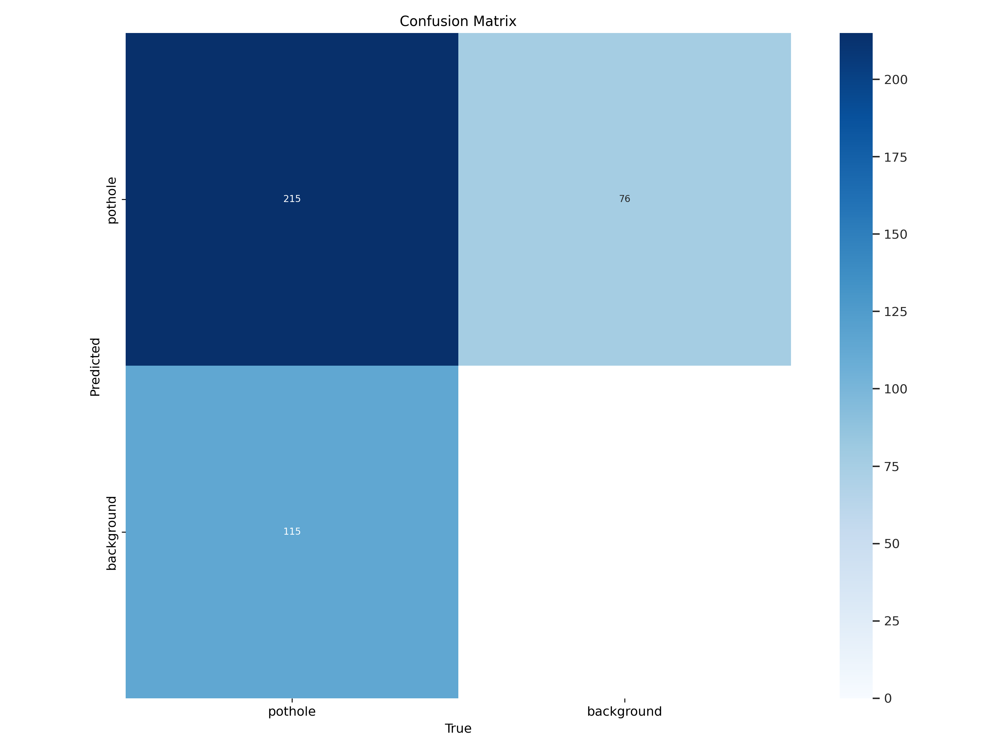

In [ ]:
Image(filename=f'/content/runs/detect/yolov10n_ft1/confusion_matrix.png', width=600)

In [ ]:
metrics_v10 = '/content/runs/detect/yolov10n_ft1/results.csv'

In [ ]:
results_v10 = model_v10.val(name="test_yolov10n_ft1",split='test')

Ultralytics 8.3.58 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv10n summary (fused): 285 layers, 2,694,806 parameters, 0 gradients, 8.2 GFLOPs


val: Scanning /content/yolov8-dataset/test/labels... 67 images, 0 backgrounds, 0 corrupt: 100%|██████████| 67/67 [00:00<00:00, 1088.89it/s]

val: New cache created: /content/yolov8-dataset/test/labels.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.24it/s]


                   all         67        154      0.674       0.63      0.694      0.431
Speed: 0.2ms preprocess, 10.5ms inference, 0.0ms loss, 0.4ms postprocess per image
Results saved to runs/detect/test_yolov10n_ft1


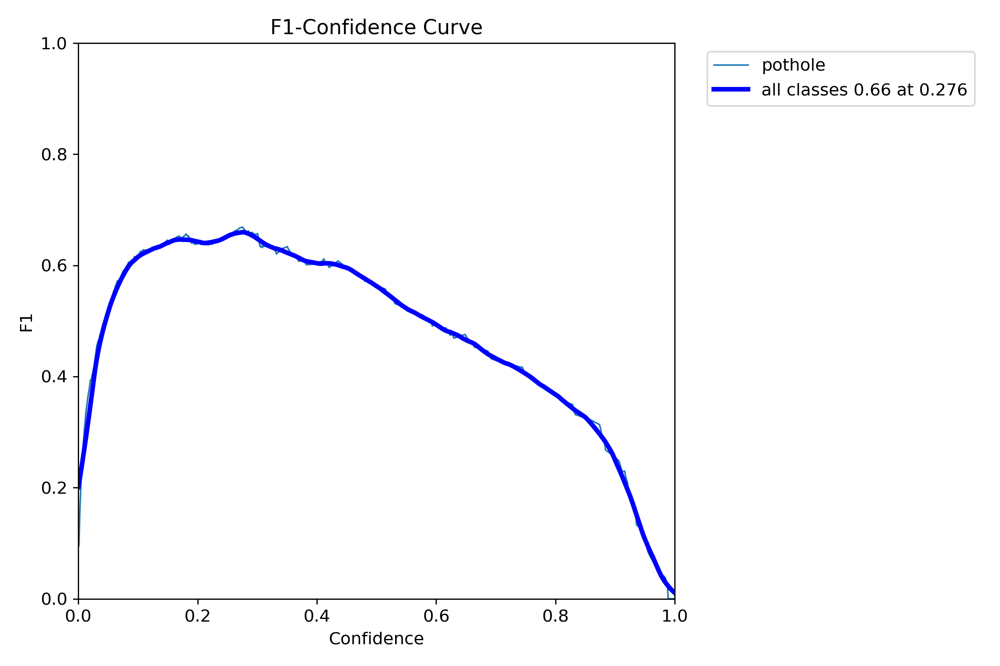

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov10n_ft1/F1_curve.png', width=600)

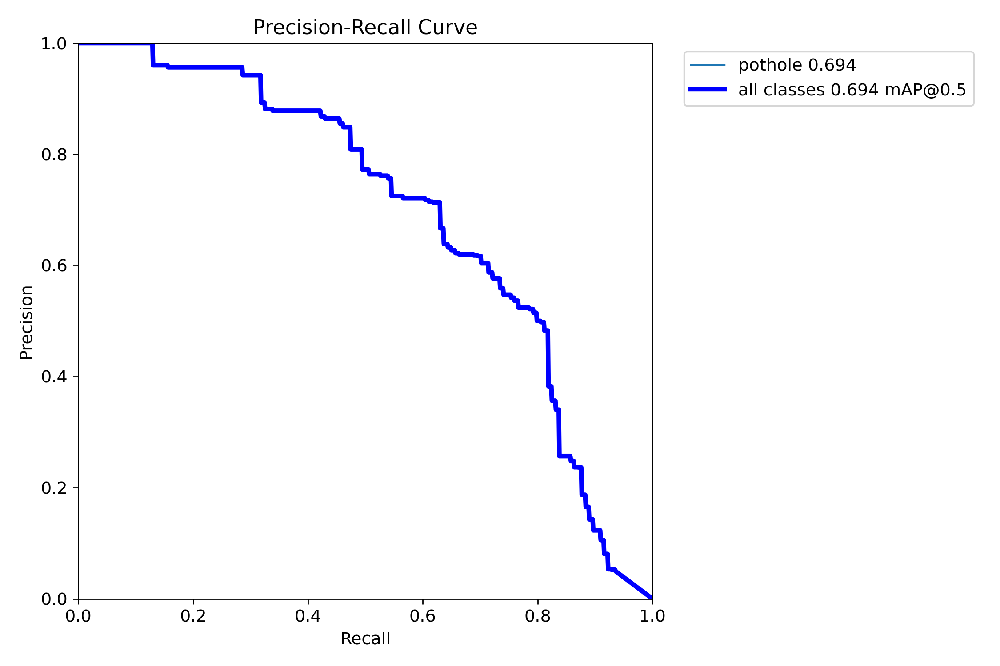

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov10n_ft1/PR_curve.png', width=600)

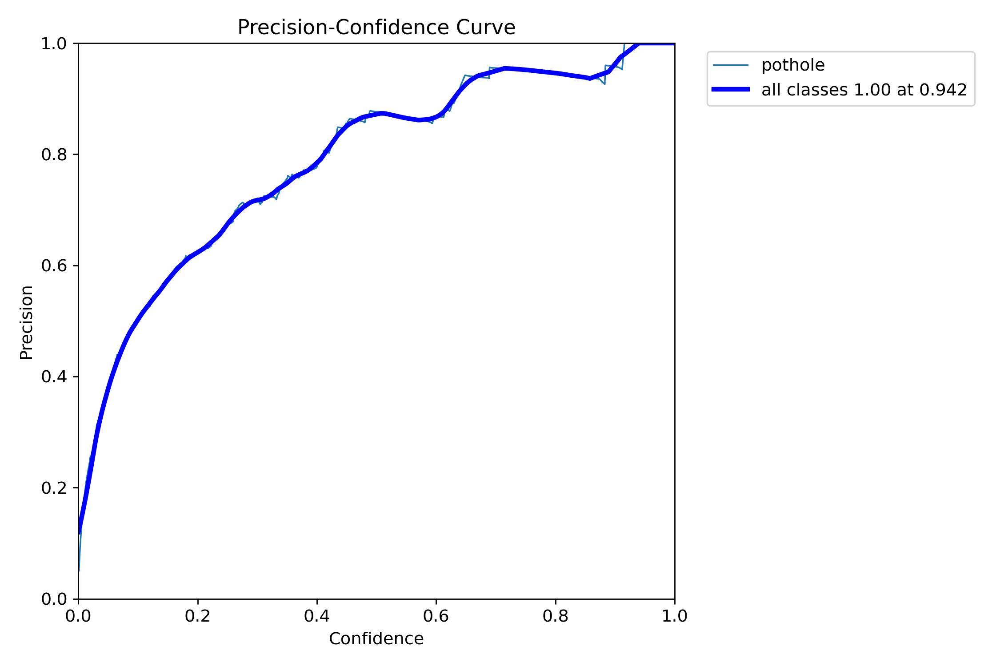

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov10n_ft1/P_curve.png', width=600)

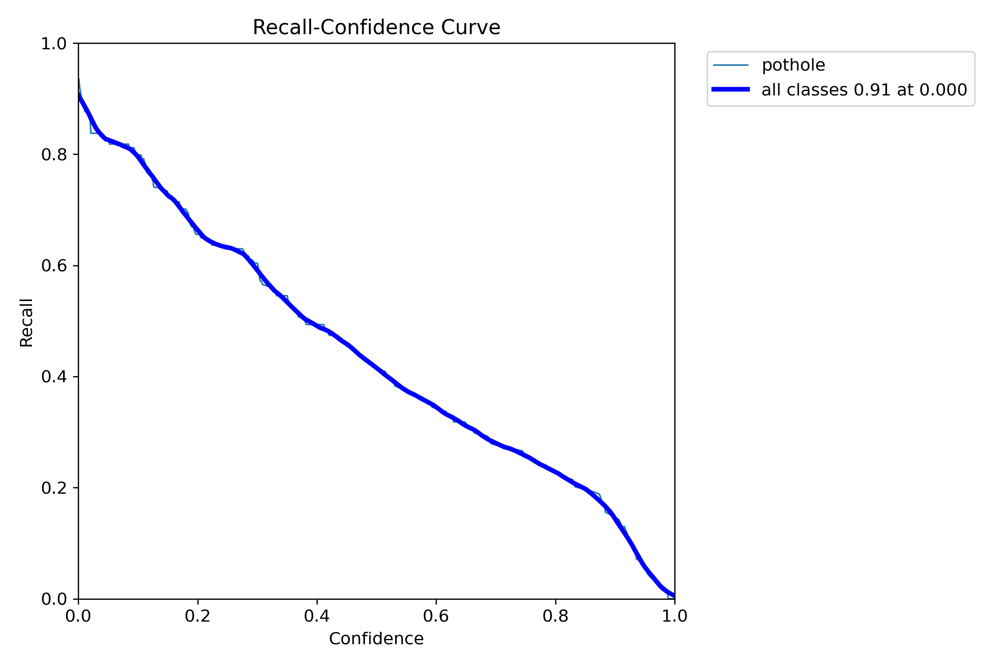

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov10n_ft1/R_curve.png', width=600)

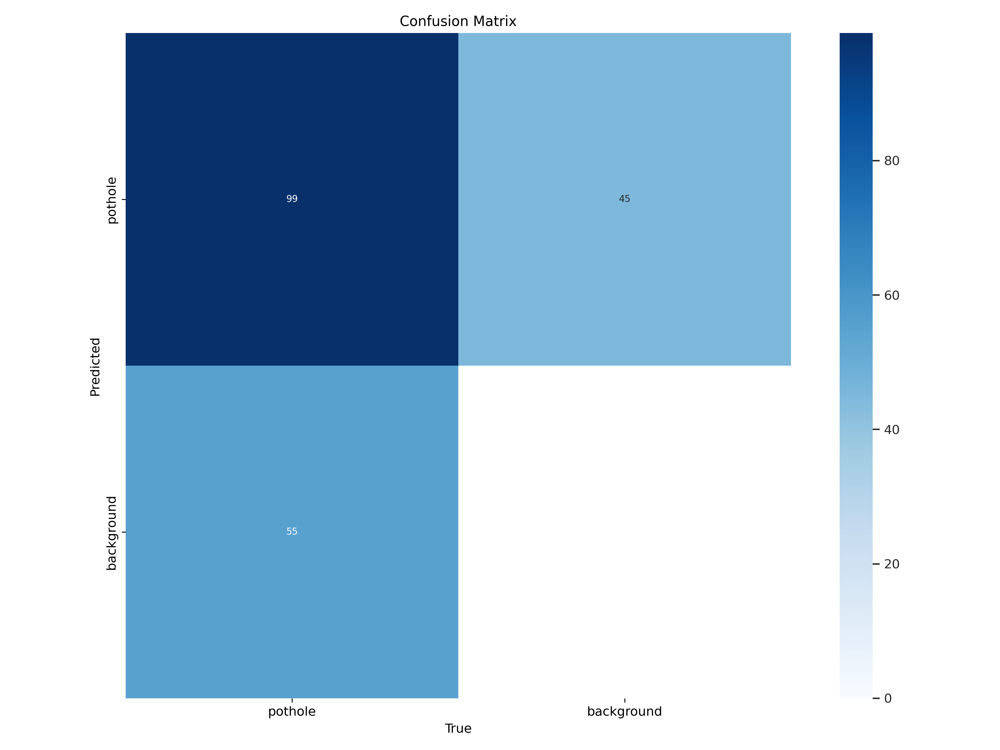

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov10n_ft1/confusion_matrix.png', width=600)

In [ ]:
model_v10.export(format='tflite')

Ultralytics 8.3.58 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.00GHz)

PyTorch: starting from 'runs/detect/yolov10n_ft1/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 300, 6) (5.5 MB)
requirements: Ultralytics requirements ['sng4onnx>=1.0.1', 'onnx_graphsurgeon>=0.3.26', 'onnx>=1.12.0', 'onnx2tf>1.17.5,<=1.26.3', 'onnxslim>=0.1.31', 'tflite_support', 'onnxruntime-gpu'] not found, attempting AutoUpdate...
Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 146.6/146.6 kB 38.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.4/56.4 kB 258.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.0/16.0 MB 329.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 445.6/445.6 kB 349.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 142.6/142.6 kB 337.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.8/60.8 MB 358.8 MB/s et

100%|██████████| 1.11M/1.11M [00:00<00:00, 128MB/s]
Unzipping calibration_image_sample_data_20x128x128x3_float32.npy.zip to /content/calibration_image_sample_data_20x128x128x3_float32.npy...: 100%|██████████| 1/1 [00:00<00:00, 49.29file/s]


ONNX: starting export with onnx 1.17.0 opset 19...


ONNX: slimming with onnxslim 0.1.46...
ONNX: export success ✅ 1.9s, saved as 'runs/detect/yolov10n_ft1/weights/best.onnx' (9.0 MB)
TensorFlow SavedModel: starting TFLite export with onnx2tf 1.26.3...
TensorFlow SavedModel: export success ✅ 70.1s, saved as 'runs/detect/yolov10n_ft1/weights/best_saved_model' (23.6 MB)

TensorFlow Lite: starting export with tensorflow 2.17.1...
TensorFlow Lite: export success ✅ 0.0s, saved as 'runs/detect/yolov10n_ft1/weights/best_saved_model/best_float32.tflite' (9.0 MB)

Export complete (71.6s)
Results saved to /content/runs/detect/yolov10n_ft1/weights
Predict:         yolo predict task=detect model=runs/detect/yolov10n_ft1/weights/best_saved_model/best_float32.tflite imgsz=640  
Validate:        yolo val task=detect model=runs/detect/yolov10n_ft1/weights/best_saved_model/best_float32.tflite imgsz=640 data=/content/yolov8-dataset/data.yaml  
Visualize:       https://netron.app


'runs/detect/yolov10n_ft1/weights/best_saved_model/best_float32.tflite'

#### YOLOv11

In [ ]:
print("Training YOLOv11...")
model_v11.train(data=os.path.join(dataset_yolov11.location, 'data.yaml'),name="yolov11n_ft1", epochs=epochs, batch=batch_size, imgsz=imgsz)

Training YOLOv11...
Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/yolov11-dataset/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov11n_ft1, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labe

train: Scanning /content/yolov11-dataset/train/labels... 465 images, 0 backgrounds, 0 corrupt: 100%|██████████| 465/465 [00:00<00:00, 1185.98it/s]

train: New cache created: /content/yolov11-dataset/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/yolov11-dataset/valid/labels... 133 images, 0 backgrounds, 0 corrupt: 100%|██████████| 133/133 [00:00<00:00, 1038.65it/s]

val: New cache created: /content/yolov11-dataset/valid/labels.cache


Plotting labels to runs/detect/yolov11n_ft1/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolov11n_ft1
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.02G      1.951      3.276       1.81          2        640: 100%|██████████| 30/30 [00:05<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.98it/s]

                   all        133        330    0.00296      0.358    0.00362   0.000869



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      1.97G       1.78      2.476      1.592          2        640: 100%|██████████| 30/30 [00:04<00:00,  6.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.66it/s]

                   all        133        330      0.115      0.148     0.0592     0.0228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      1.97G      1.766      2.196      1.587          6        640: 100%|██████████| 30/30 [00:04<00:00,  6.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.61it/s]

                   all        133        330     0.0252     0.0364    0.00719    0.00195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50         2G      1.733       2.02      1.562          3        640: 100%|██████████| 30/30 [00:04<00:00,  6.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.83it/s]

                   all        133        330     0.0171      0.261     0.0139    0.00456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.05G      1.753      1.998      1.565          7        640: 100%|██████████| 30/30 [00:04<00:00,  6.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.23it/s]

                   all        133        330      0.214      0.294      0.176     0.0761



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      1.99G       1.73       1.91      1.557          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.24it/s]

                   all        133        330      0.223      0.158     0.0986      0.037



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      2.05G      1.775      1.893      1.663          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.73it/s]

                   all        133        330      0.484      0.336      0.318       0.15



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.06G      1.629       1.74      1.499          3        640: 100%|██████████| 30/30 [00:04<00:00,  6.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.65it/s]

                   all        133        330      0.505      0.327      0.337      0.163



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50         2G      1.619      1.677      1.503          2        640: 100%|██████████| 30/30 [00:04<00:00,  6.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.93it/s]

                   all        133        330      0.427      0.442      0.401       0.19



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      1.98G      1.574      1.552      1.451          6        640: 100%|██████████| 30/30 [00:04<00:00,  6.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.85it/s]

                   all        133        330      0.509      0.569      0.524      0.271



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      1.99G      1.571      1.551      1.444          3        640: 100%|██████████| 30/30 [00:04<00:00,  6.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.69it/s]

                   all        133        330      0.543      0.536       0.54      0.262



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      1.99G       1.56      1.494      1.422          7        640: 100%|██████████| 30/30 [00:04<00:00,  6.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.84it/s]

                   all        133        330      0.725      0.487      0.571      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.05G      1.537      1.583      1.444          3        640: 100%|██████████| 30/30 [00:04<00:00,  6.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.03it/s]

                   all        133        330      0.577      0.524      0.567      0.286



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      1.98G      1.476      1.466      1.398          3        640: 100%|██████████| 30/30 [00:04<00:00,  6.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.89it/s]

                   all        133        330       0.71      0.515        0.6      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.05G      1.484      1.431      1.382          4        640: 100%|██████████| 30/30 [00:04<00:00,  6.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.59it/s]

                   all        133        330       0.66      0.497      0.571      0.292



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50         2G      1.442      1.397      1.357          2        640: 100%|██████████| 30/30 [00:04<00:00,  6.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.84it/s]

                   all        133        330      0.677      0.553      0.607      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      1.99G       1.47      1.395      1.365          6        640: 100%|██████████| 30/30 [00:04<00:00,  6.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.67it/s]

                   all        133        330      0.635       0.58       0.64      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      1.98G      1.442      1.358       1.36          4        640: 100%|██████████| 30/30 [00:04<00:00,  6.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.42it/s]

                   all        133        330      0.604      0.561      0.591      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.04G      1.418      1.295      1.336         20        640: 100%|██████████| 30/30 [00:04<00:00,  6.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.99it/s]

                   all        133        330      0.641      0.615      0.664       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50         2G      1.367      1.267      1.312          2        640: 100%|██████████| 30/30 [00:04<00:00,  6.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.56it/s]

                   all        133        330       0.67      0.633      0.658      0.363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      1.99G      1.433      1.302      1.378          2        640: 100%|██████████| 30/30 [00:04<00:00,  6.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.42it/s]

                   all        133        330      0.757      0.557      0.633      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50         2G      1.433       1.31      1.358         15        640: 100%|██████████| 30/30 [00:04<00:00,  6.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.97it/s]

                   all        133        330      0.676      0.633      0.681      0.373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.03G      1.389      1.304      1.337          3        640: 100%|██████████| 30/30 [00:04<00:00,  6.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.97it/s]

                   all        133        330      0.722      0.627      0.692      0.401



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      1.98G      1.386      1.227      1.325          3        640: 100%|██████████| 30/30 [00:04<00:00,  6.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.42it/s]

                   all        133        330      0.679      0.622      0.662      0.366



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      1.99G      1.343      1.201      1.295          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.66it/s]

                   all        133        330      0.714      0.645        0.7      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      1.96G      1.344      1.225      1.296          6        640: 100%|██████████| 30/30 [00:04<00:00,  6.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.57it/s]

                   all        133        330      0.772      0.615      0.706        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      1.99G      1.347      1.214      1.297         10        640: 100%|██████████| 30/30 [00:04<00:00,  6.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.59it/s]

                   all        133        330      0.755      0.603      0.704      0.412



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      1.99G      1.308      1.162      1.276         10        640: 100%|██████████| 30/30 [00:04<00:00,  6.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.25it/s]

                   all        133        330      0.706      0.618      0.686      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      1.99G      1.293       1.13      1.259          4        640: 100%|██████████| 30/30 [00:04<00:00,  6.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.99it/s]

                   all        133        330      0.791      0.652      0.731      0.436



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.05G      1.294      1.167      1.269          2        640: 100%|██████████| 30/30 [00:04<00:00,  6.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.83it/s]

                   all        133        330      0.752      0.623      0.716      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      2.03G      1.276       1.07      1.236          5        640: 100%|██████████| 30/30 [00:04<00:00,  6.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.18it/s]

                   all        133        330      0.726      0.626      0.706      0.398



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      2.04G      1.287      1.076      1.254          2        640: 100%|██████████| 30/30 [00:04<00:00,  6.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.93it/s]

                   all        133        330       0.77      0.606      0.732      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      1.98G      1.275      1.113       1.24          4        640: 100%|██████████| 30/30 [00:04<00:00,  6.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.78it/s]

                   all        133        330      0.738      0.645      0.725      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      1.99G      1.272      1.091      1.237         12        640: 100%|██████████| 30/30 [00:04<00:00,  6.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.66it/s]

                   all        133        330      0.735      0.656      0.738      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      1.99G      1.257      1.073      1.251          4        640: 100%|██████████| 30/30 [00:04<00:00,  6.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.91it/s]

                   all        133        330      0.753      0.655       0.75      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.05G      1.244      1.036      1.242          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.81it/s]

                   all        133        330      0.798      0.636      0.746      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      1.99G       1.25      1.058      1.238          5        640: 100%|██████████| 30/30 [00:04<00:00,  6.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.58it/s]

                   all        133        330      0.719      0.629      0.715      0.425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.01G      1.187      1.024      1.189          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.65it/s]

                   all        133        330      0.761      0.637      0.737      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      1.99G      1.207      1.016      1.215          6        640: 100%|██████████| 30/30 [00:04<00:00,  6.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.86it/s]

                   all        133        330      0.771      0.667       0.76      0.468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      2.01G      1.238      1.033      1.245          3        640: 100%|██████████| 30/30 [00:04<00:00,  6.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.73it/s]

                   all        133        330       0.79      0.645      0.759      0.462


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50         2G      1.176      1.067      1.168          2        640: 100%|██████████| 30/30 [00:05<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.17it/s]

                   all        133        330      0.728      0.658      0.731      0.437



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      1.99G      1.169      1.013       1.24          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.83it/s]

                   all        133        330      0.781      0.627      0.747       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      1.96G      1.136     0.9362      1.176          3        640: 100%|██████████| 30/30 [00:04<00:00,  6.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.59it/s]

                   all        133        330      0.774      0.648      0.743      0.451



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      1.99G      1.156     0.9517      1.218          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.74it/s]

                   all        133        330      0.794      0.666      0.771       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      1.99G      1.086     0.9039      1.142          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.94it/s]

                   all        133        330      0.794      0.664      0.772      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      1.98G      1.088     0.8637      1.151          4        640: 100%|██████████| 30/30 [00:04<00:00,  6.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.59it/s]

                   all        133        330      0.838      0.639      0.789       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50         2G      1.112     0.8914      1.161          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.53it/s]

                   all        133        330      0.799      0.674      0.791      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      1.98G      1.105     0.8656      1.159          3        640: 100%|██████████| 30/30 [00:04<00:00,  6.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.90it/s]

                   all        133        330      0.743      0.712      0.792       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      1.99G      1.056     0.8254      1.132          5        640: 100%|██████████| 30/30 [00:04<00:00,  6.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.90it/s]

                   all        133        330      0.802      0.676      0.785      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      1.98G      1.027     0.7998      1.123          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.61it/s]

                   all        133        330       0.83      0.667      0.792      0.493



50 epochs completed in 0.087 hours.
Optimizer stripped from runs/detect/yolov11n_ft1/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov11n_ft1/weights/best.pt, 5.5MB

Validating runs/detect/yolov11n_ft1/weights/best.pt...
Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11n summary (fused): 238 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.51it/s]


                   all        133        330      0.804      0.673      0.792      0.494
Speed: 0.2ms preprocess, 4.0ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to runs/detect/yolov11n_ft1


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7a8334c1ceb0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

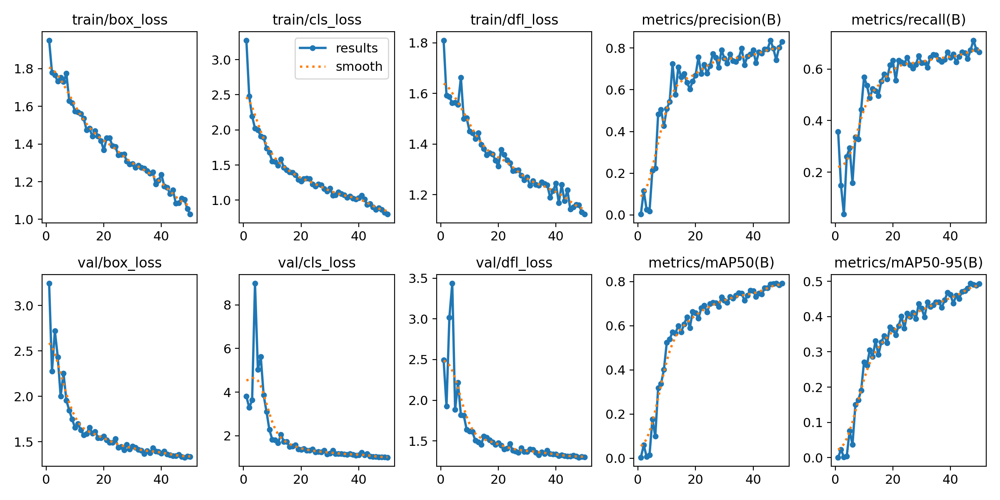

In [ ]:
Image(filename=f'/content/runs/detect/yolov11n_ft1/results.png', width=600)

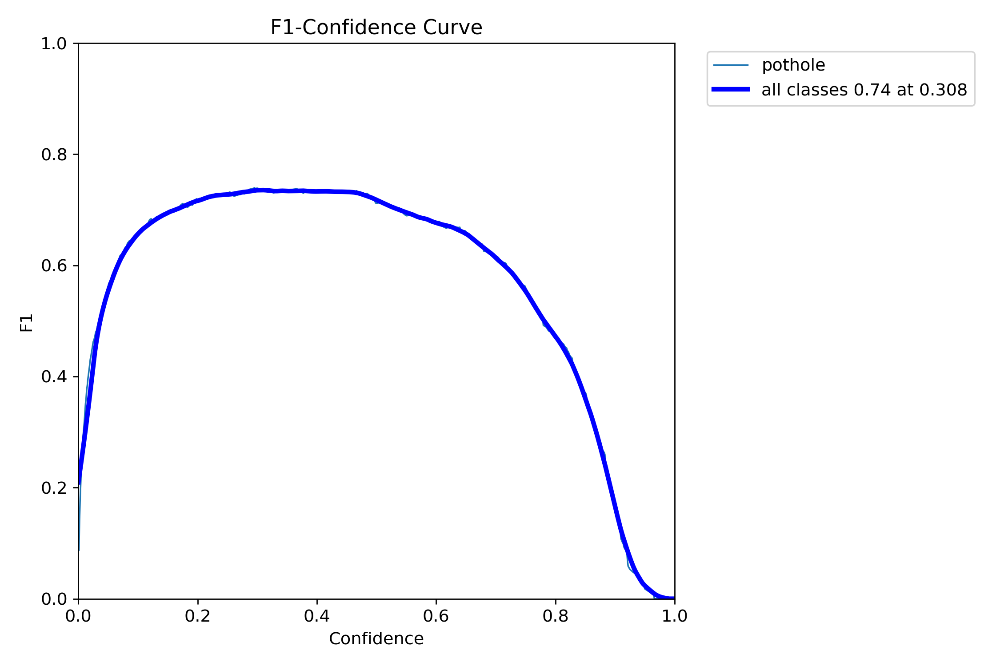

In [ ]:
Image(filename=f'/content/runs/detect/yolov11n_ft1/F1_curve.png', width=600)

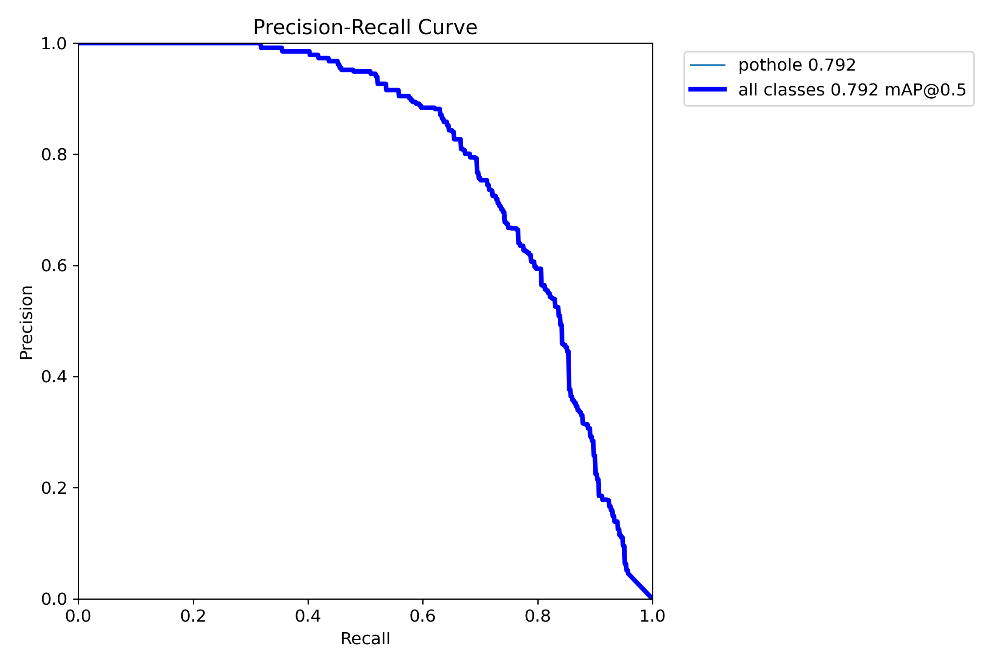

In [ ]:
Image(filename=f'/content/runs/detect/yolov11n_ft1/PR_curve.png', width=600)

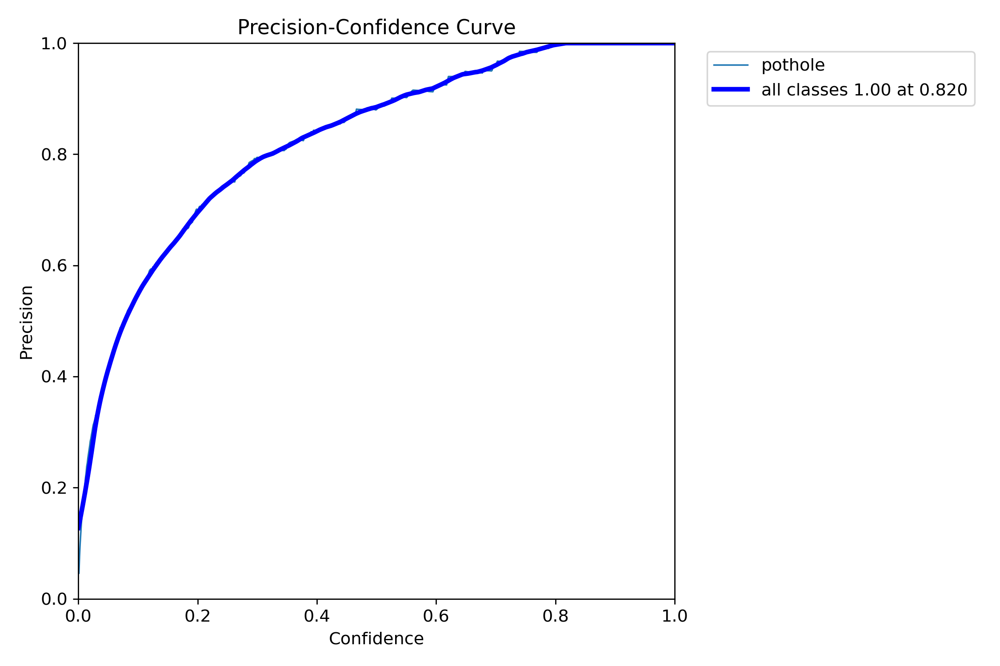

In [ ]:
Image(filename=f'/content/runs/detect/yolov11n_ft1/P_curve.png', width=600)

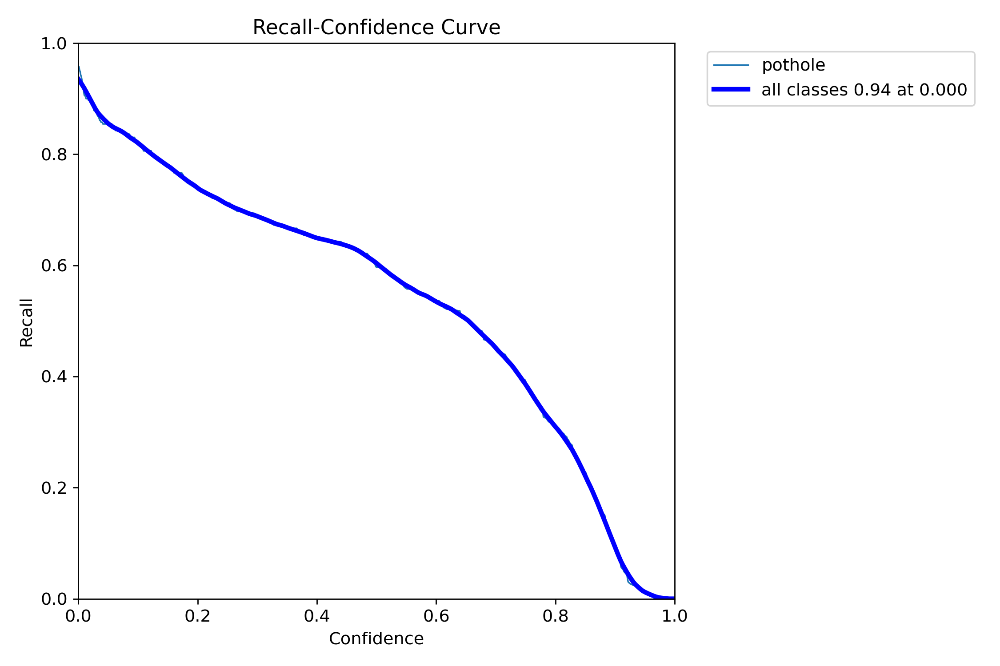

In [ ]:
Image(filename=f'/content/runs/detect/yolov11n_ft1/R_curve.png', width=600)

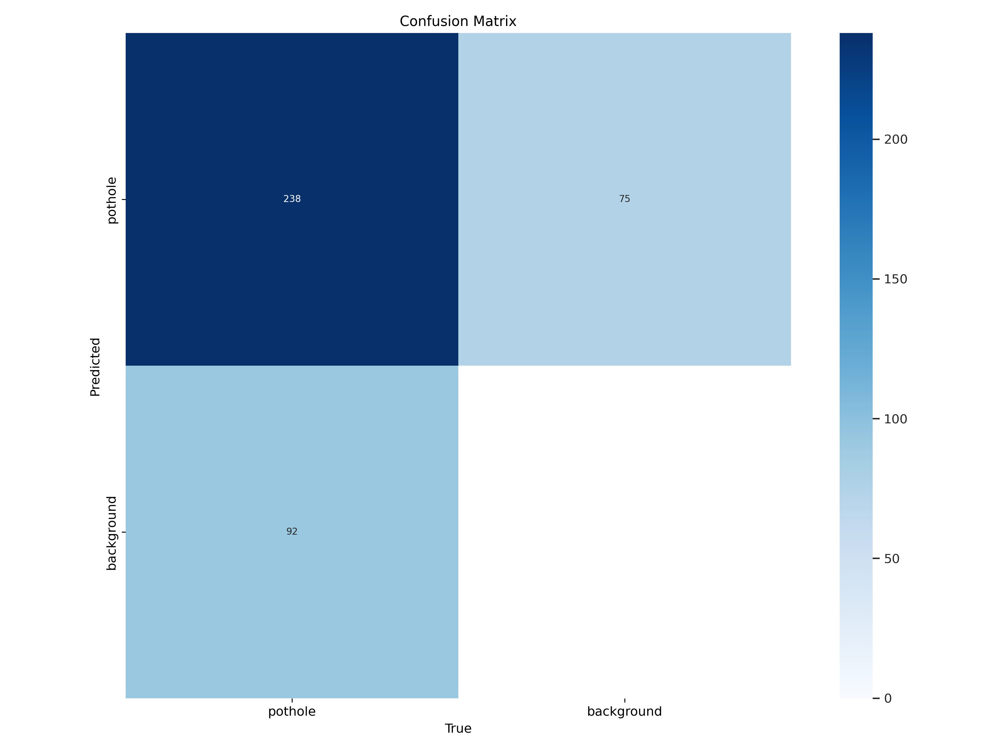

In [ ]:
Image(filename=f'/content/runs/detect/yolov11n_ft1/confusion_matrix.png', width=600)

In [ ]:
metrics_v11 = '/content/runs/detect/yolov11n_ft1/results.csv'

In [ ]:
results_v11 = model_v11.val(name="test_yolov11n_ft1",split='test')

Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11n summary (fused): 238 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/yolov11-dataset/test/labels... 67 images, 0 backgrounds, 0 corrupt: 100%|██████████| 67/67 [00:00<00:00, 1198.29it/s]

val: New cache created: /content/yolov11-dataset/test/labels.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.10it/s]


                   all         67        154      0.807      0.727       0.79      0.489
Speed: 0.2ms preprocess, 10.8ms inference, 0.0ms loss, 1.7ms postprocess per image
Results saved to runs/detect/test_yolov11n_ft1


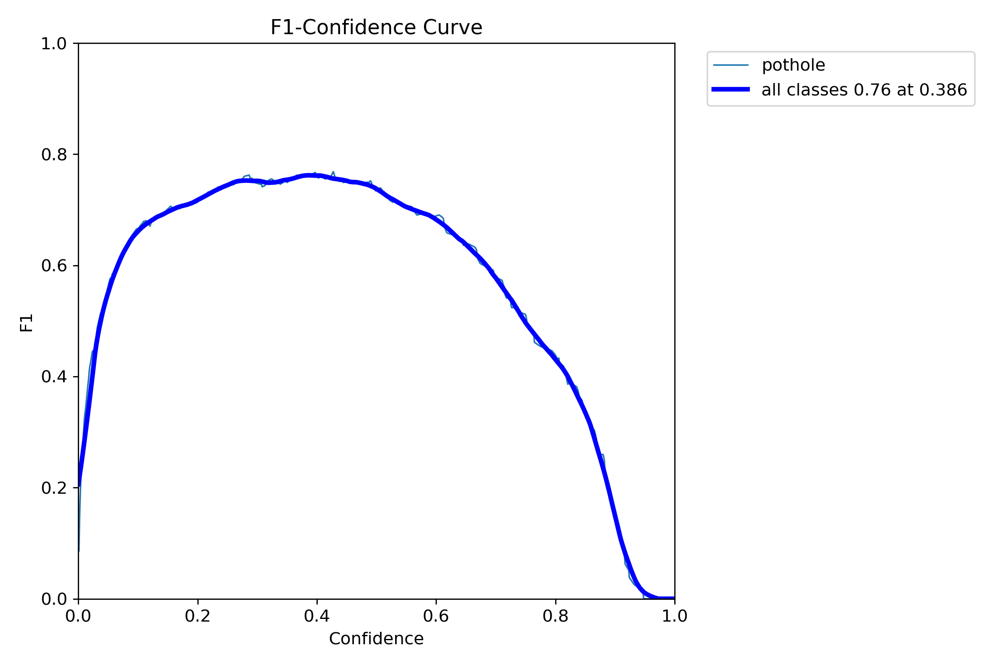

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov11n_ft1/F1_curve.png', width=600)

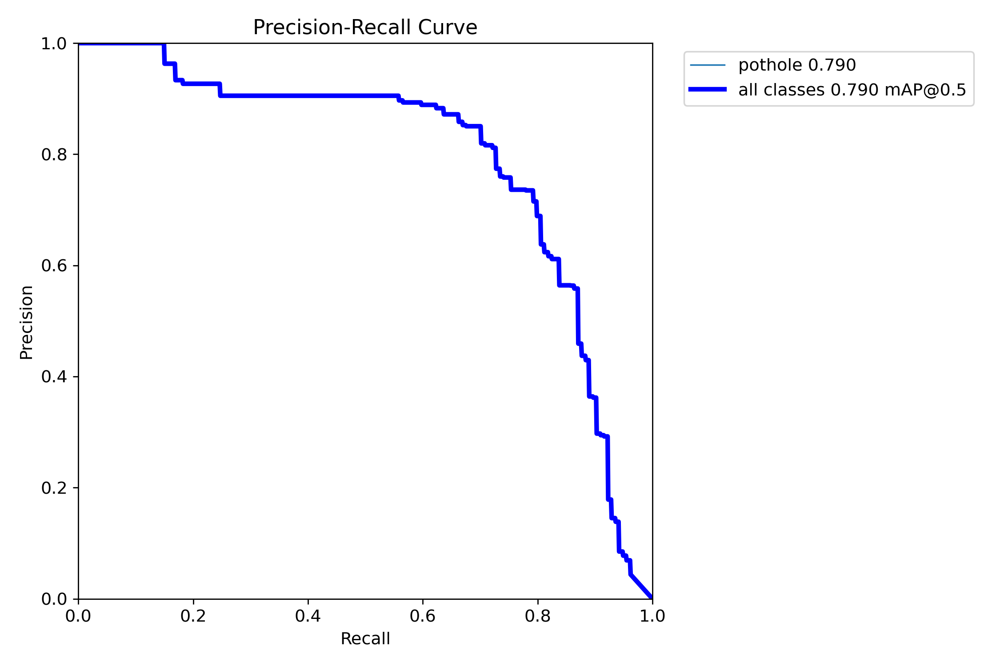

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov11n_ft1/PR_curve.png', width=600)

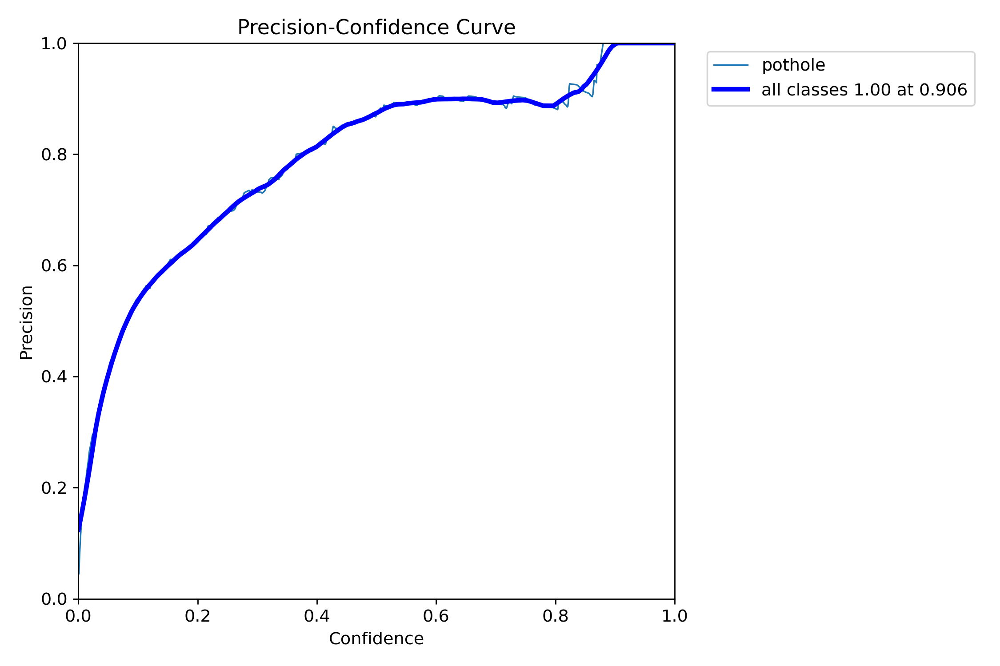

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov11n_ft1/P_curve.png', width=600)

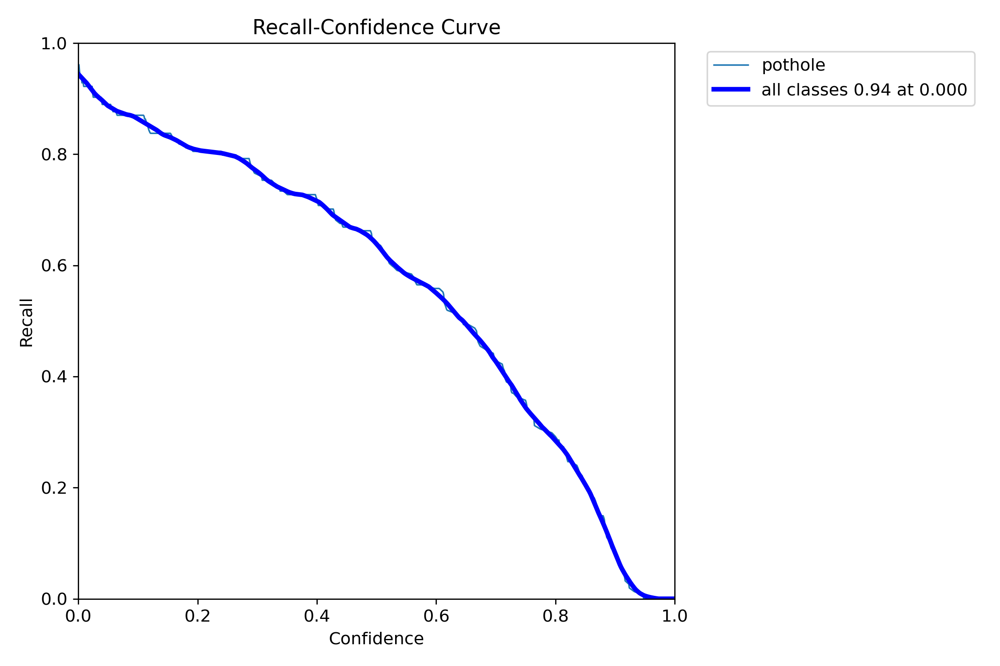

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov11n_ft1/R_curve.png', width=600)

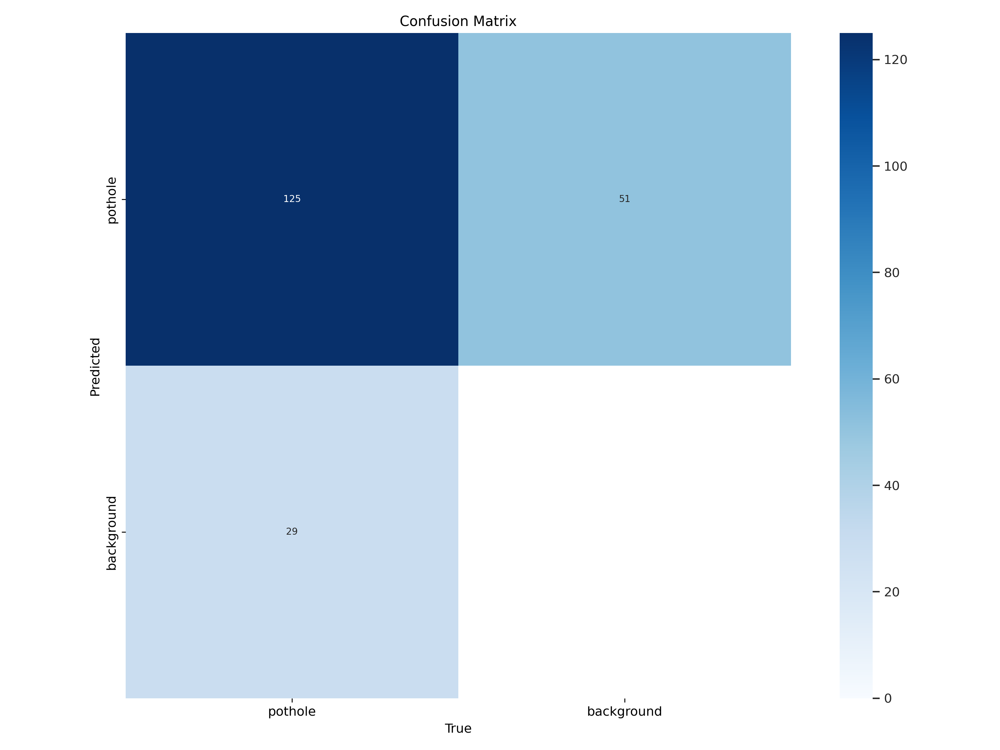

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov11n_ft1/confusion_matrix.png', width=600)

In [ ]:
model_v11.export(format='tflite')

Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.00GHz)

PyTorch: starting from 'runs/detect/yolov11n_ft1/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (5.2 MB)

TensorFlow SavedModel: starting export with tensorflow 2.17.1...

ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.45...
ONNX: export success ✅ 1.5s, saved as 'runs/detect/yolov11n_ft1/weights/best.onnx' (10.2 MB)
TensorFlow SavedModel: starting TFLite export with onnx2tf 1.26.3...
TensorFlow SavedModel: export success ✅ 29.5s, saved as 'runs/detect/yolov11n_ft1/weights/best_saved_model' (26.5 MB)

TensorFlow Lite: starting export with tensorflow 2.17.1...
TensorFlow Lite: export success ✅ 0.0s, saved as 'runs/detect/yolov11n_ft1/weights/best_saved_model/best_float32.tflite' (10.1 MB)

Export complete (30.4s)
Results saved to /content/runs/detect/yolov11n_ft1/weights
Predict:         yolo predict task=detect model=runs/detect/y

'runs/detect/yolov11n_ft1/weights/best_saved_model/best_float32.tflite'

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

In [ ]:
df_5 = pd.read_csv("/content/metrics/results_5.csv")
df_6 = pd.read_csv("/content/metrics/results_6.csv")
df_8 = pd.read_csv("/content/metrics/results_8.csv")
df_10 = pd.read_csv("/content/metrics/results_10.csv")
df_11 = pd.read_csv("/content/metrics/results_11.csv")

**Comparison of YOLO Model Performance Based on mAP@0.5:0.95 Over Epochs**

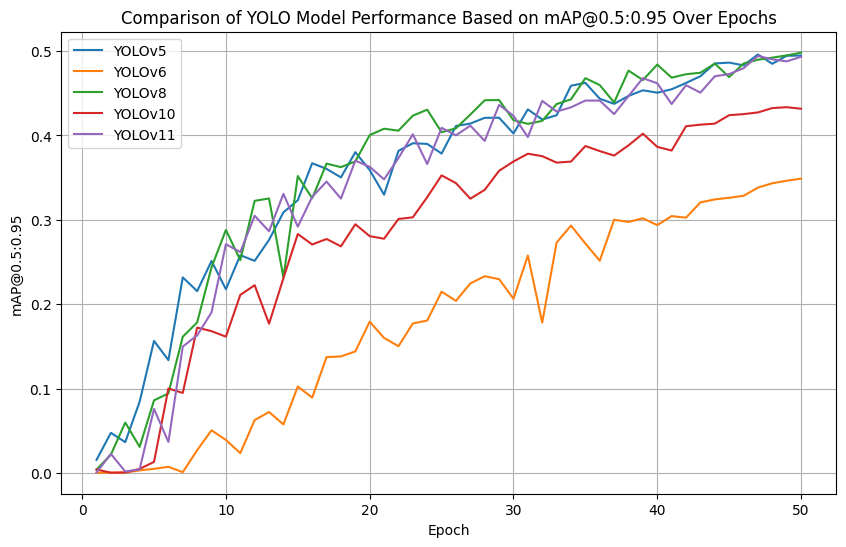

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_5['epoch'], df_5['metrics/mAP50-95(B)'], label='YOLOv5')
plt.plot(df_6['epoch'], df_6['metrics/mAP50-95(B)'], label='YOLOv6')
plt.plot(df_8['epoch'], df_8['metrics/mAP50-95(B)'], label='YOLOv8')
plt.plot(df_10['epoch'], df_10['metrics/mAP50-95(B)'], label='YOLOv10')
plt.plot(df_11['epoch'], df_11['metrics/mAP50-95(B)'], label='YOLOv11')
plt.xlabel('Epoch')
plt.ylabel('mAP@0.5:0.95')
plt.title('Comparison of YOLO Model Performance Based on mAP@0.5:0.95 Over Epochs')
plt.legend()
plt.grid(True)
plt.show()

**Precision Comparison**

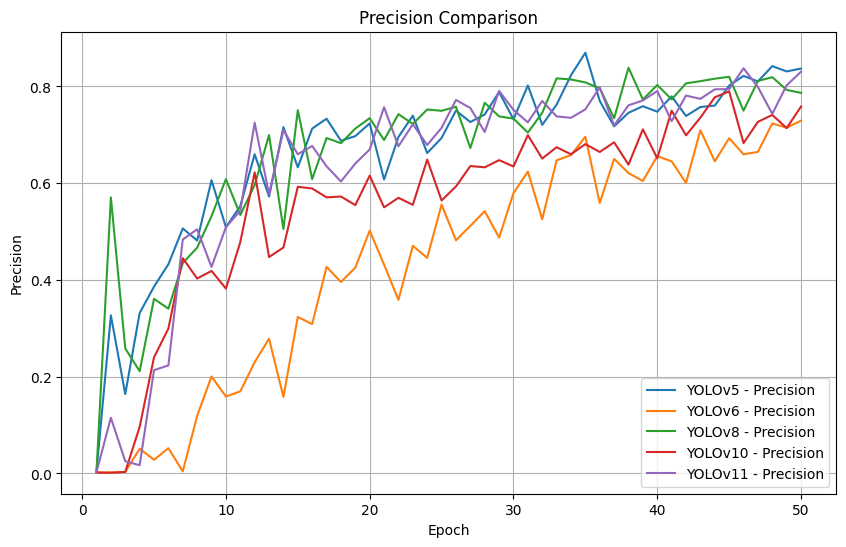

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_5['epoch'], df_5['metrics/precision(B)'], label='YOLOv5 - Precision')
plt.plot(df_6['epoch'], df_6['metrics/precision(B)'], label='YOLOv6 - Precision')
plt.plot(df_8['epoch'], df_8['metrics/precision(B)'], label='YOLOv8 - Precision')
plt.plot(df_10['epoch'], df_10['metrics/precision(B)'], label='YOLOv10 - Precision')
plt.plot(df_11['epoch'], df_11['metrics/precision(B)'], label='YOLOv11 - Precision')
plt.xlabel('Epoch')
plt.ylabel('Precision')
plt.title('Precision Comparison')
plt.legend()
plt.grid(True)
plt.show()

**Recall Comparison**

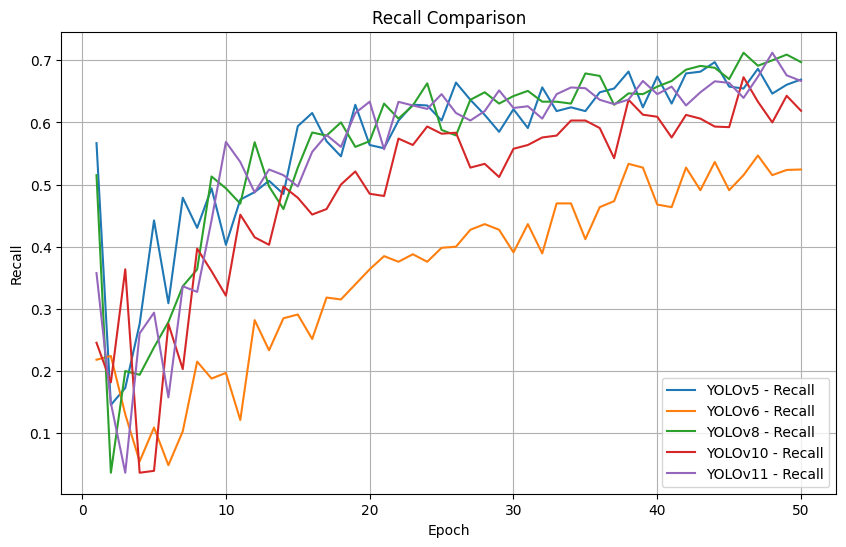

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_5['epoch'], df_5['metrics/recall(B)'], label='YOLOv5 - Recall')
plt.plot(df_6['epoch'], df_6['metrics/recall(B)'], label='YOLOv6 - Recall')
plt.plot(df_8['epoch'], df_8['metrics/recall(B)'], label='YOLOv8 - Recall')
plt.plot(df_10['epoch'], df_10['metrics/recall(B)'], label='YOLOv10 - Recall')
plt.plot(df_11['epoch'], df_11['metrics/recall(B)'], label='YOLOv11 - Recall')
plt.xlabel('Epoch')
plt.ylabel('Recall')
plt.title('Recall Comparison')
plt.legend()
plt.grid(True)
plt.show()

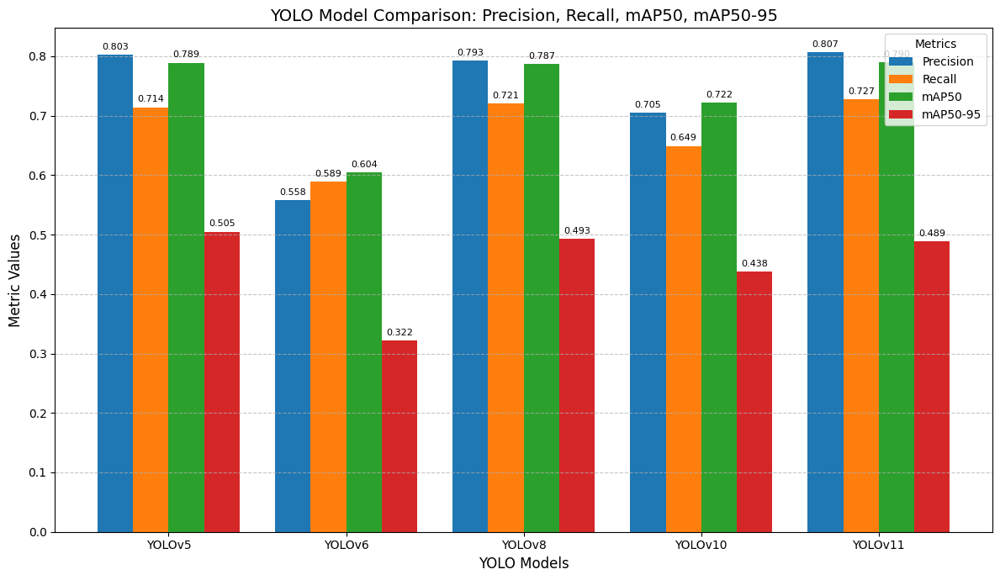

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# --------------------------------------------------------------------
# 1) Grouped Bar Chart
# --------------------------------------------------------------------

# Updated list of models including YOLOv10n
models = ["YOLOv5", "YOLOv6", "YOLOv8", "YOLOv10", "YOLOv11"]

# Updated metrics for each model
# Replace these values with the actual metrics from your evaluations
precision = [0.803, 0.558, 0.793, 0.705, 0.807]    # Precision (P)
recall =    [0.714, 0.589, 0.721, 0.649, 0.727]    # Recall (R)
map50 =     [0.789, 0.604, 0.787, 0.722, 0.790]    # mAP50
map50_95 =  [0.505, 0.322, 0.493, 0.438, 0.489]    # mAP50-0.95

x = np.arange(len(models))  # the label locations
width = 0.2                 # the width of the bars

fig, ax = plt.subplots(figsize=(12, 7))

# Plot bars with adjusted positions to accommodate more models
b1 = ax.bar(x - 1.5*width, precision, width, label='Precision', color='#1f77b4')
b2 = ax.bar(x - 0.5*width, recall,    width, label='Recall', color='#ff7f0e')
b3 = ax.bar(x + 0.5*width, map50,     width, label='mAP50', color='#2ca02c')
b4 = ax.bar(x + 1.5*width, map50_95,  width, label='mAP50-95', color='#d62728')

# Add labels, title, and custom x-axis tick labels
ax.set_xlabel('YOLO Models', fontsize=12)
ax.set_ylabel('Metric Values', fontsize=12)
ax.set_title('YOLO Model Comparison: Precision, Recall, mAP50, mAP50-95', fontsize=14)
ax.set_xticks(x)
ax.set_xticklabels(models, fontsize=10)
ax.legend(title='Metrics')
ax.grid(True, axis='y', linestyle='--', alpha=0.7)

# Annotate bars with their values
for bars in [b1, b2, b3, b4]:
    for bar in bars:
        height = bar.get_height()
        ax.annotate(f'{height:.3f}',
                    xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 3),  # Offset text position
                    textcoords="offset points",
                    ha='center', va='bottom', fontsize=8)

plt.tight_layout()
plt.show()

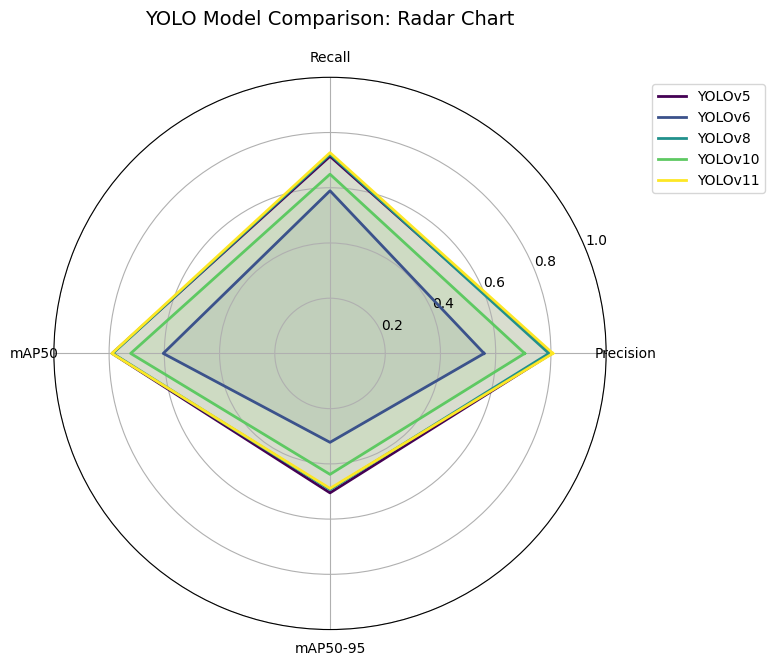

In [ ]:
# --------------------------------------------------------------------
# 2) Radar Chart (Alternative Visualization)
# --------------------------------------------------------------------

# Prepare data for each model in the same order
model_metrics = [
    [precision[0], recall[0], map50[0], map50_95[0]],  # YOLOv5
    [precision[1], recall[1], map50[1], map50_95[1]],  # YOLOv6
    [precision[2], recall[2], map50[2], map50_95[2]],  # YOLOv8
    [precision[3], recall[3], map50[3], map50_95[3]],  # YOLOv10n
    [precision[4], recall[4], map50[4], map50_95[4]],  # YOLOv11
]

# Radar labels
metrics_labels = ["Precision", "Recall", "mAP50", "mAP50-95"]
num_vars = len(metrics_labels)

# Angles for each metric axis (in radians)
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
angles += angles[:1]  # Complete the loop

# Plot
fig = plt.figure(figsize=(8, 8))
ax = plt.subplot(111, polar=True)

# Define color palette
colors = plt.cm.viridis(np.linspace(0, 1, len(models)))

for idx, (metrics, color, model) in enumerate(zip(model_metrics, colors, models)):
    # Repeat the first metric to close the radar chart
    stats = metrics + [metrics[0]]
    ax.plot(angles, stats, label=model, linewidth=2, color=color)
    ax.fill(angles, stats, alpha=0.1, color=color)

# Fix the location of the metric labels (around the circle)
ax.set_thetagrids(np.degrees(angles[:-1]), metrics_labels)

# Set range for radial axis
ax.set_ylim(0, 1)  # Adjust if necessary

# Add legend and title
plt.title('YOLO Model Comparison: Radar Chart', y=1.08, fontsize=14)
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.0))
plt.tight_layout()
plt.show()

### Comparing with augmentation

In [ ]:
hyp = {
    'fliplr': 0.5,           # Horizontal flip with 50% probability
    'flipud': 0.1,           # Vertical flip with 10% probability
    'scale': 0.3,            # Scale images ±30%
    'translate': 0.2,        # Translate images ±20%
    'hsv_h': 0.015,          # HSV hue adjustment ±1.5%
    'hsv_s': 0.7,            # HSV saturation adjustment 70%
    'hsv_v': 0.4,            # HSV value (brightness) adjustment 40%
    'degrees': 10.0,         # Random rotation ±10 degrees
    'shear': 5.0,            # Shear transformations ±5 degrees
    'perspective': 0.001,    # Small perspective distortion
    'mosaic': 1.0,           # Enable mosaic augmentation
    'mixup': 0.2             # Enable mixup with 20% probability
}

In [ ]:
model_aug_v6 = YOLO('yolov6n.yaml')
model_aug_v8 = YOLO('yolov8n.pt')
model_aug_v5 = YOLO('yolov5n.pt')
model_aug_v10 = YOLO('yolov10n.pt')
model_aug_v11 = YOLO('yolo11n.pt')

100%|██████████| 6.25M/6.25M [00:00<00:00, 101MB/s]

PRO TIP 💡 Replace 'model=yolov5n.pt' with new 'model=yolov5nu.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.




100%|██████████| 5.31M/5.31M [00:00<00:00, 81.0MB/s]


100%|██████████| 5.59M/5.59M [00:00<00:00, 94.5MB/s]


100%|██████████| 5.35M/5.35M [00:00<00:00, 91.2MB/s]


#### YOLOv5

In [ ]:
model_aug_v5.train(data=os.path.join(dataset_yolov8.location, 'data.yaml'),
                   epochs=epochs, batch=batch_size,name='yolov5n_aug_ft1',
                   imgsz=imgsz,
                   augment=True,
                   fliplr= 0.5,           # Horizontal flip with 50% probability
                   flipud= 0.1,           # Vertical flip with 10% probability
                   scale= 0.3,            # Scale images ±30%
                   translate= 0.2,        # Translate images ±20%
                   hsv_h=0.015,          # HSV hue adjustment ±1.5%
                   hsv_s=0.7,            # HSV saturation adjustment 70%
                   hsv_v=0.4,            # HSV value (brightness) adjustment 40%
                   degrees=10.0,         # Random rotation ±10 degrees
                   shear= 5.0,            # Shear transformations ±5 degrees
                   perspective=0.001,    # Small perspective distortion
                   mosaic= 1.0,           # Enable mosaic augmentation
                   mixup=0.2             # Enable mixup with 20% probability
)

Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov5n.pt, data=/content/yolov8-dataset/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov5n_aug_ft1, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=

100%|██████████| 755k/755k [00:00<00:00, 98.2MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1      1760  ultralytics.nn.modules.conv.Conv             [3, 16, 6, 2, 2]              
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      4800  ultralytics.nn.modules.block.C3              [32, 32, 1]                   
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     29184  ultralytics.nn.modules.block.C3              [64, 64, 2]                   
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  3    156928  ultralytics.nn.modules.block.C3              [128, 128, 3]                 
  7                  -1  1    295424  ultralytics

train: Scanning /content/yolov8-dataset/train/labels... 465 images, 0 backgrounds, 0 corrupt: 100%|██████████| 465/465 [00:00<00:00, 1204.20it/s]

train: New cache created: /content/yolov8-dataset/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


A new version of Albumentations is available: 1.4.24 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
val: Scanning /content/yolov8-dataset/valid/labels... 133 images, 0 backgrounds, 0 corrupt: 100%|██████████| 133/133 [00:00<00:00, 996.17it/s]

val: New cache created: /content/yolov8-dataset/valid/labels.cache


Plotting labels to runs/detect/yolov5n_aug_ft1/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 69 weight(decay=0.0), 76 weight(decay=0.0005), 75 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolov5n_aug_ft1
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      1.97G      2.253      3.448      2.092          0        640: 100%|██████████| 30/30 [00:06<00:00,  4.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.36it/s]

                   all        133        330    0.00401      0.485    0.00429    0.00147



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      1.97G      2.059       2.73      1.939          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.09it/s]

                   all        133        330      0.238      0.176       0.12     0.0447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      1.97G      2.093      2.549      1.982          2        640: 100%|██████████| 30/30 [00:04<00:00,  7.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.42it/s]

                   all        133        330      0.243      0.185      0.119     0.0406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      1.97G      2.107      2.476      1.957          5        640: 100%|██████████| 30/30 [00:04<00:00,  7.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.56it/s]

                   all        133        330     0.0894      0.124     0.0309    0.00738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      1.98G      2.052      2.322      1.906          9        640: 100%|██████████| 30/30 [00:04<00:00,  7.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.99it/s]

                   all        133        330      0.206      0.239      0.127     0.0367



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      1.97G      2.017      2.265      1.908          5        640: 100%|██████████| 30/30 [00:04<00:00,  7.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.86it/s]

                   all        133        330      0.515      0.288      0.357      0.124



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      1.96G      1.948      2.248      1.849          8        640: 100%|██████████| 30/30 [00:04<00:00,  7.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.55it/s]

                   all        133        330      0.324      0.261      0.214     0.0724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      1.97G       1.92      2.154      1.824          2        640: 100%|██████████| 30/30 [00:04<00:00,  7.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.11it/s]

                   all        133        330      0.466      0.342      0.348      0.124



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      1.98G      1.892      2.141      1.807         16        640: 100%|██████████| 30/30 [00:04<00:00,  7.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.80it/s]

                   all        133        330       0.51      0.436      0.425      0.168



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      1.99G      1.897      2.059      1.792          4        640: 100%|██████████| 30/30 [00:04<00:00,  6.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.99it/s]

                   all        133        330       0.55      0.394      0.423      0.148



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      1.89G      1.931      2.076      1.849          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.09it/s]

                   all        133        330      0.481      0.336      0.334      0.114



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      1.97G      1.859      1.973      1.792          6        640: 100%|██████████| 30/30 [00:04<00:00,  7.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.85it/s]

                   all        133        330      0.586      0.427       0.45      0.151



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      1.95G      1.829      1.933      1.747          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.05it/s]

                   all        133        330      0.566      0.419      0.459      0.178



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      1.98G      1.889      1.951      1.767         12        640: 100%|██████████| 30/30 [00:04<00:00,  7.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.02it/s]

                   all        133        330      0.587      0.486      0.524      0.209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      1.91G      1.817       1.87      1.745          6        640: 100%|██████████| 30/30 [00:04<00:00,  7.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.54it/s]

                   all        133        330      0.591      0.506      0.537      0.234



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50       1.9G       1.79      1.891      1.703         10        640: 100%|██████████| 30/30 [00:04<00:00,  7.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.98it/s]

                   all        133        330      0.609      0.476      0.539      0.239



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      1.95G      1.832      1.902      1.723          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.79it/s]

                   all        133        330      0.628      0.482      0.519      0.186



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      1.91G      1.782      1.871      1.733          2        640: 100%|██████████| 30/30 [00:04<00:00,  6.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.91it/s]

                   all        133        330      0.565      0.503      0.518      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      1.97G      1.807      1.846      1.702         14        640: 100%|██████████| 30/30 [00:04<00:00,  7.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.03it/s]

                   all        133        330      0.624      0.512      0.528      0.225



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      1.98G      1.785      1.809       1.71          2        640: 100%|██████████| 30/30 [00:04<00:00,  7.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.34it/s]

                   all        133        330      0.617        0.5      0.529      0.212



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      1.91G      1.759      1.776      1.675          6        640: 100%|██████████| 30/30 [00:04<00:00,  7.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.15it/s]

                   all        133        330        0.6      0.558      0.585       0.26



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      1.97G      1.791      1.789      1.702          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.98it/s]

                   all        133        330      0.552      0.503      0.525      0.231



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      1.98G      1.762      1.752      1.648         10        640: 100%|██████████| 30/30 [00:04<00:00,  6.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.36it/s]

                   all        133        330      0.543      0.568      0.568      0.264



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      1.98G      1.763      1.705      1.648          4        640: 100%|██████████| 30/30 [00:04<00:00,  7.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.00it/s]

                   all        133        330      0.626      0.603      0.617       0.27



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      1.97G      1.765      1.828       1.67          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.64it/s]

                   all        133        330      0.599      0.494      0.555      0.242



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      1.97G      1.743      1.723       1.66          5        640: 100%|██████████| 30/30 [00:04<00:00,  6.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.06it/s]

                   all        133        330      0.602      0.545      0.567      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      1.91G      1.732      1.806      1.637          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.82it/s]

                   all        133        330      0.739      0.515      0.616      0.274



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      1.98G      1.716      1.694      1.638          5        640: 100%|██████████| 30/30 [00:04<00:00,  6.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.92it/s]

                   all        133        330      0.655      0.585      0.638      0.297



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      1.95G      1.683      1.678      1.623          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.91it/s]

                   all        133        330      0.655      0.561      0.624      0.307



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      1.91G      1.717      1.683      1.649          4        640: 100%|██████████| 30/30 [00:04<00:00,  7.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.18it/s]

                   all        133        330      0.655      0.597       0.64      0.266



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      1.98G      1.678      1.624      1.604          5        640: 100%|██████████| 30/30 [00:04<00:00,  6.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.95it/s]

                   all        133        330      0.773      0.567      0.684      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      1.95G      1.635      1.599       1.58          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.01it/s]

                   all        133        330      0.731       0.57      0.655      0.328



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      1.99G      1.688      1.648      1.611          8        640: 100%|██████████| 30/30 [00:04<00:00,  7.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.81it/s]

                   all        133        330      0.669      0.595      0.657      0.308



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      1.97G      1.666      1.609      1.588         15        640: 100%|██████████| 30/30 [00:04<00:00,  6.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.00it/s]

                   all        133        330       0.77      0.569      0.669      0.298



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      1.99G      1.638      1.563      1.572          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.10it/s]

                   all        133        330      0.777      0.585      0.699      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      1.97G       1.68      1.597      1.585          4        640: 100%|██████████| 30/30 [00:04<00:00,  6.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.85it/s]

                   all        133        330      0.651      0.636      0.678       0.33



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      1.98G      1.674       1.61      1.615          2        640: 100%|██████████| 30/30 [00:04<00:00,  7.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.94it/s]

                   all        133        330      0.701      0.591      0.658      0.326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      1.95G      1.652      1.557      1.584          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.89it/s]

                   all        133        330      0.735      0.622       0.69      0.335



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      1.98G      1.647      1.572      1.599          2        640: 100%|██████████| 30/30 [00:04<00:00,  6.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.97it/s]

                   all        133        330      0.759      0.629      0.702      0.367



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      1.91G      1.577      1.812      1.513          0        640: 100%|██████████| 30/30 [00:04<00:00,  7.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.14it/s]

                   all        133        330       0.73      0.624      0.705      0.345


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      1.97G      1.465      1.468      1.433          2        640: 100%|██████████| 30/30 [00:05<00:00,  5.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.84it/s]

                   all        133        330       0.71      0.579      0.682      0.351



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      1.97G      1.416      1.337      1.443          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.15it/s]

                   all        133        330      0.748      0.621      0.717      0.351



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      1.93G      1.431      1.282      1.435          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.21it/s]

                   all        133        330      0.739      0.618      0.701      0.346



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      1.98G      1.482      1.268      1.507          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.04it/s]

                   all        133        330       0.78      0.618       0.73      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      1.97G      1.402      1.165      1.378          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.99it/s]

                   all        133        330      0.774      0.623      0.738      0.384



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      1.95G      1.406      1.183      1.395          4        640: 100%|██████████| 30/30 [00:04<00:00,  7.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.63it/s]

                   all        133        330      0.785      0.642      0.735       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      1.98G        1.4      1.143      1.399          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.07it/s]

                   all        133        330       0.72      0.654       0.73      0.382



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      1.95G      1.397      1.146      1.382          2        640: 100%|██████████| 30/30 [00:04<00:00,  7.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.28it/s]

                   all        133        330      0.772      0.645      0.737       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      1.97G      1.366       1.13      1.371          5        640: 100%|██████████| 30/30 [00:04<00:00,  7.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.74it/s]

                   all        133        330      0.752      0.652      0.743      0.379



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      1.97G      1.344      1.102      1.351          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.16it/s]

                   all        133        330      0.779       0.64      0.744       0.39



50 epochs completed in 0.081 hours.
Optimizer stripped from runs/detect/yolov5n_aug_ft1/weights/last.pt, 5.3MB
Optimizer stripped from runs/detect/yolov5n_aug_ft1/weights/best.pt, 5.3MB

Validating runs/detect/yolov5n_aug_ft1/weights/best.pt...
Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv5n summary (fused): 193 layers, 2,503,139 parameters, 0 gradients, 7.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.39it/s]


                   all        133        330      0.747      0.667      0.752      0.393
Speed: 0.2ms preprocess, 10.5ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/yolov5n_aug_ft1


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x79da431c12a0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

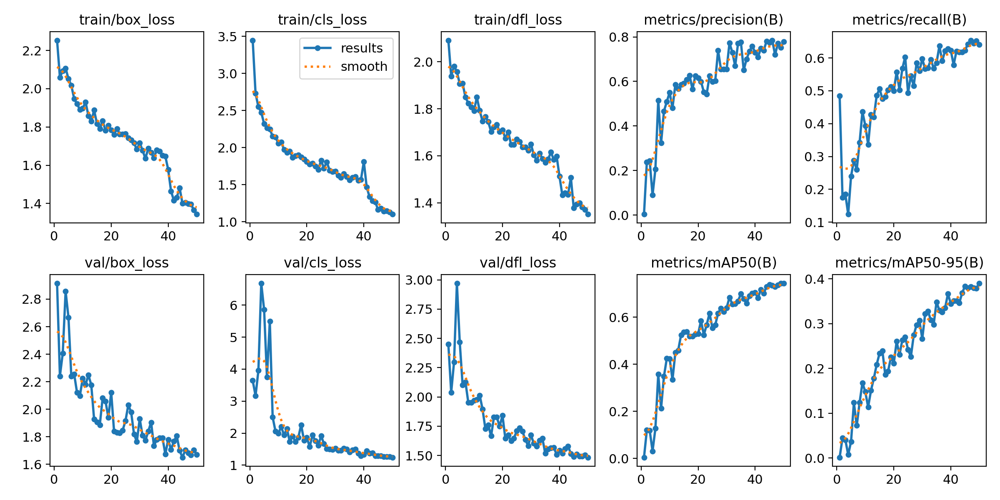

In [ ]:
Image(filename=f'/content/runs/detect/yolov5n_aug_ft1/results.png', width=600)

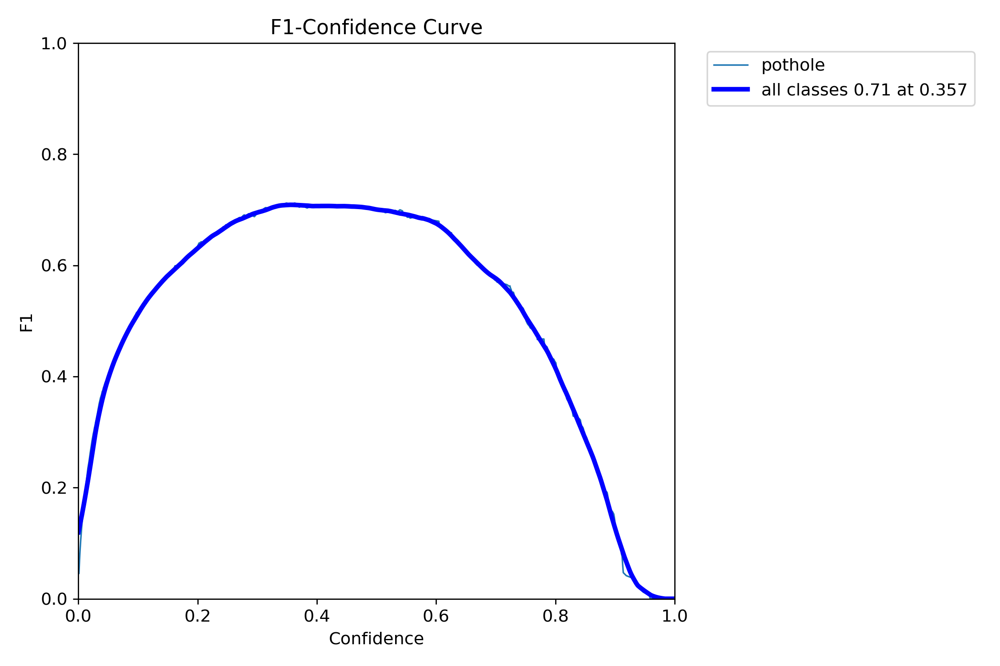

In [ ]:
Image(filename=f'/content/runs/detect/yolov5n_aug_ft1/F1_curve.png', width=600)

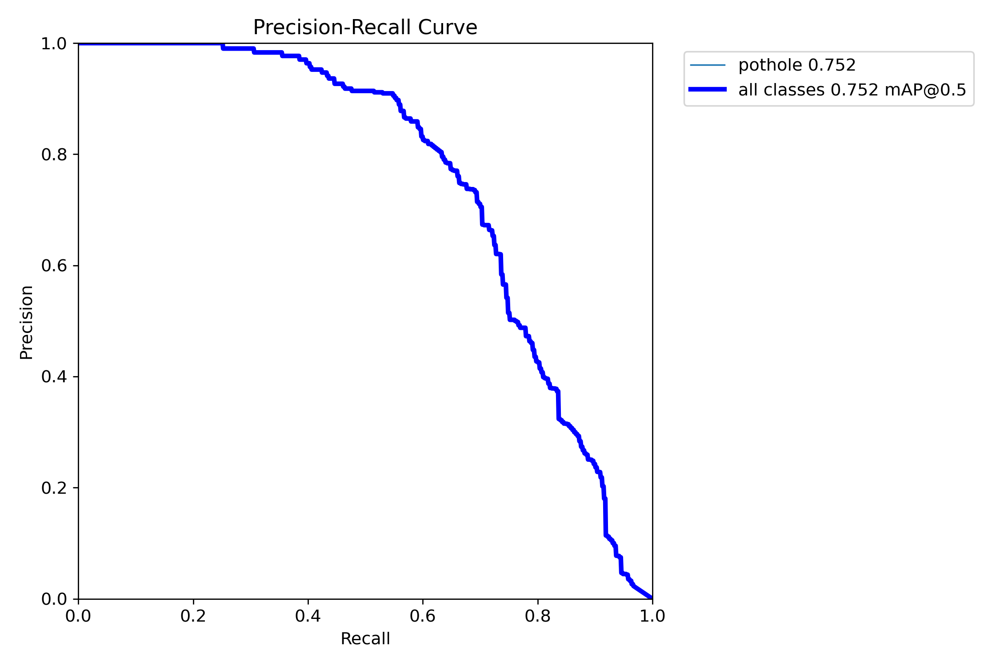

In [ ]:
Image(filename=f'/content/runs/detect/yolov5n_aug_ft1/PR_curve.png', width=600)

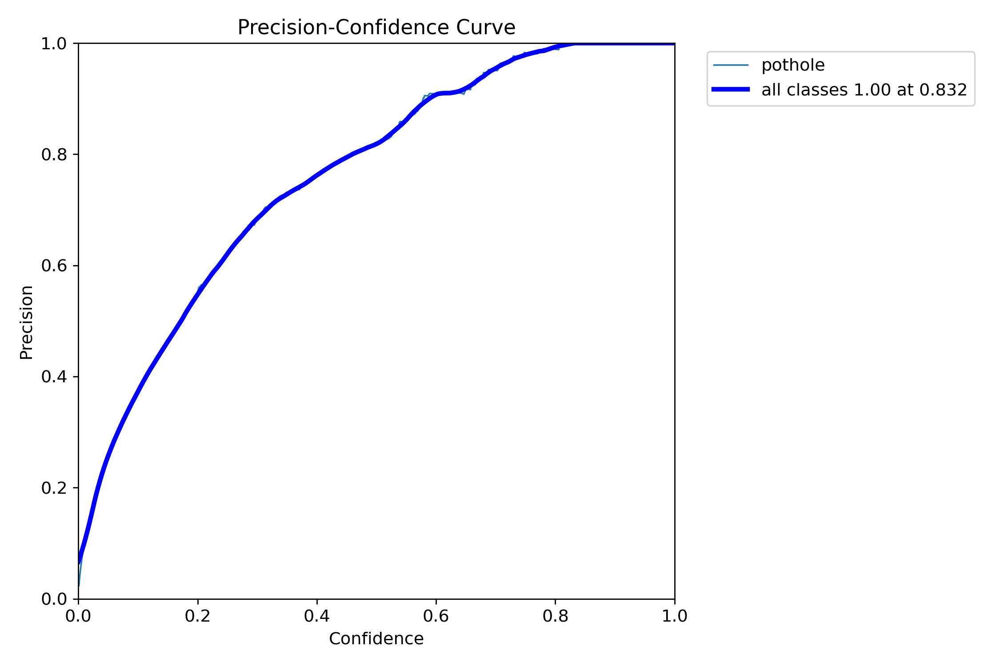

In [ ]:
Image(filename=f'/content/runs/detect/yolov5n_aug_ft1/P_curve.png', width=600)

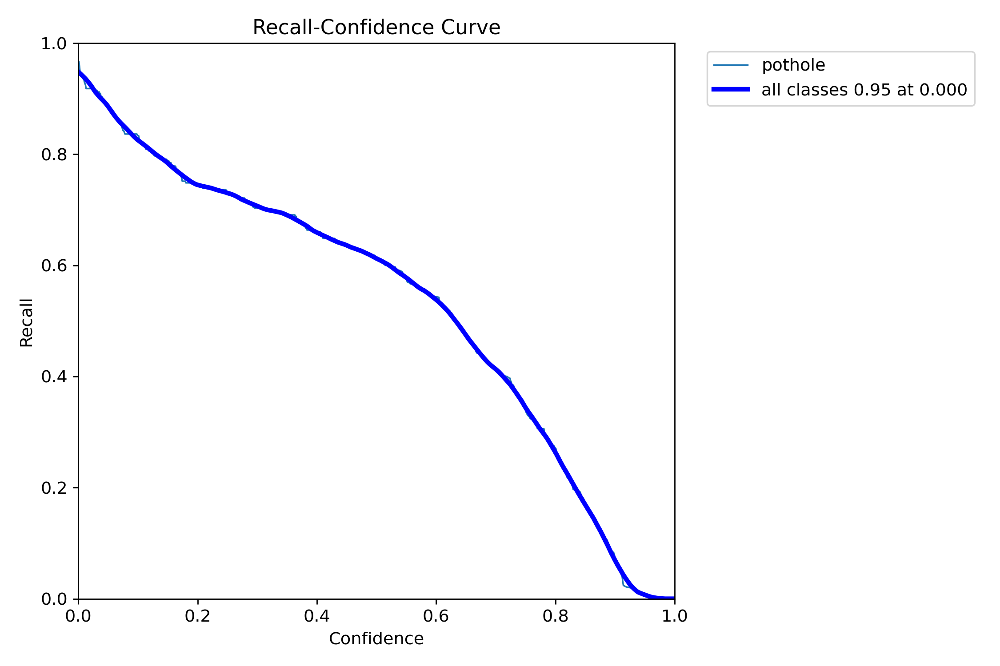

In [ ]:
Image(filename=f'/content/runs/detect/yolov5n_aug_ft1/R_curve.png', width=600)

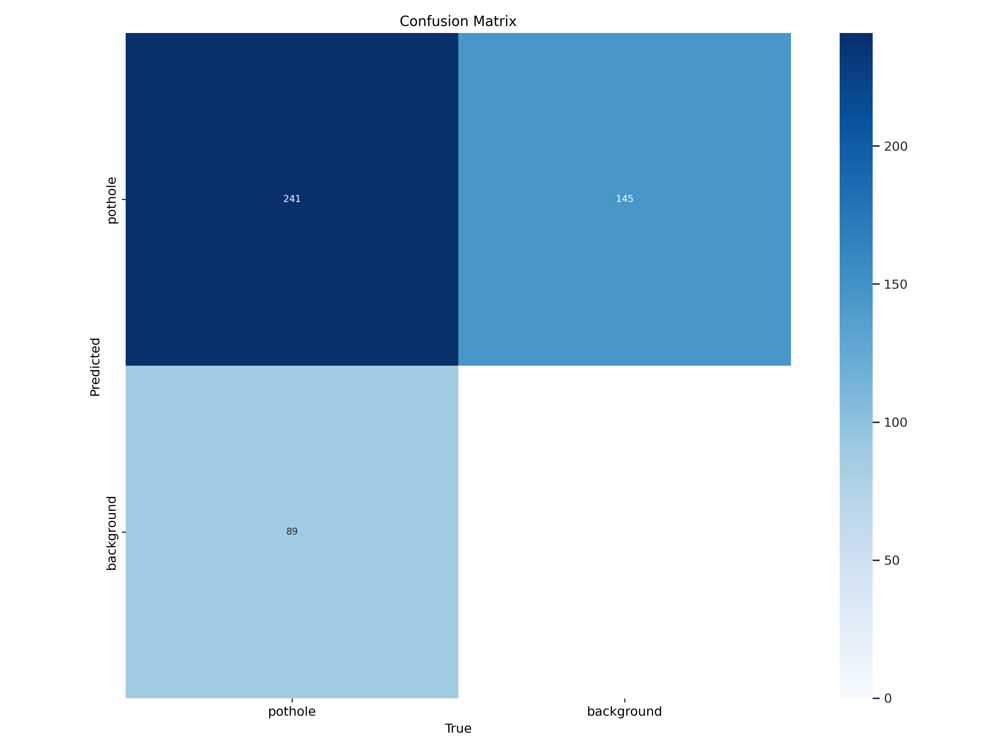

In [ ]:
Image(filename=f'/content/runs/detect/yolov5n_aug_ft1/confusion_matrix.png', width=600)

In [ ]:
metrics_v5 = '/content/runs/detect/yolov5n_aug_ft1/results.csv'

In [ ]:
results_v5 = model_aug_v5.val(name='test_yolov5n_aug_ft1',split='test')

Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv5n summary (fused): 193 layers, 2,503,139 parameters, 0 gradients, 7.1 GFLOPs


val: Scanning /content/yolov8-dataset/test/labels... 67 images, 0 backgrounds, 0 corrupt: 100%|██████████| 67/67 [00:00<00:00, 1308.96it/s]

val: New cache created: /content/yolov8-dataset/test/labels.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.49it/s]


                   all         67        154      0.711      0.714      0.769       0.41
Speed: 0.2ms preprocess, 21.0ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to runs/detect/test_yolov5n_aug_ft1


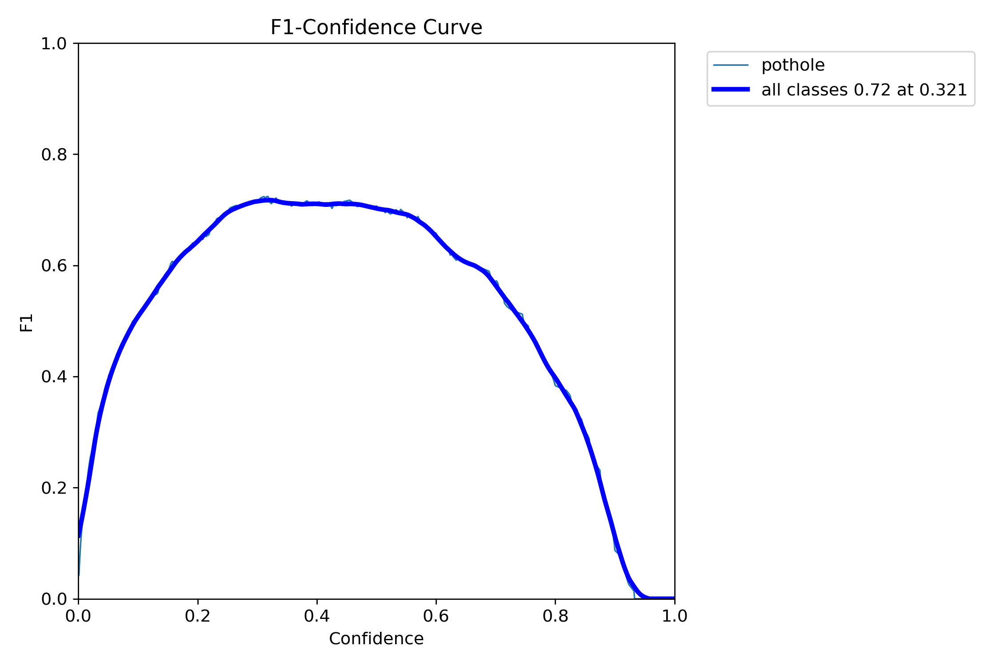

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov5n_aug_ft1/F1_curve.png', width=600)

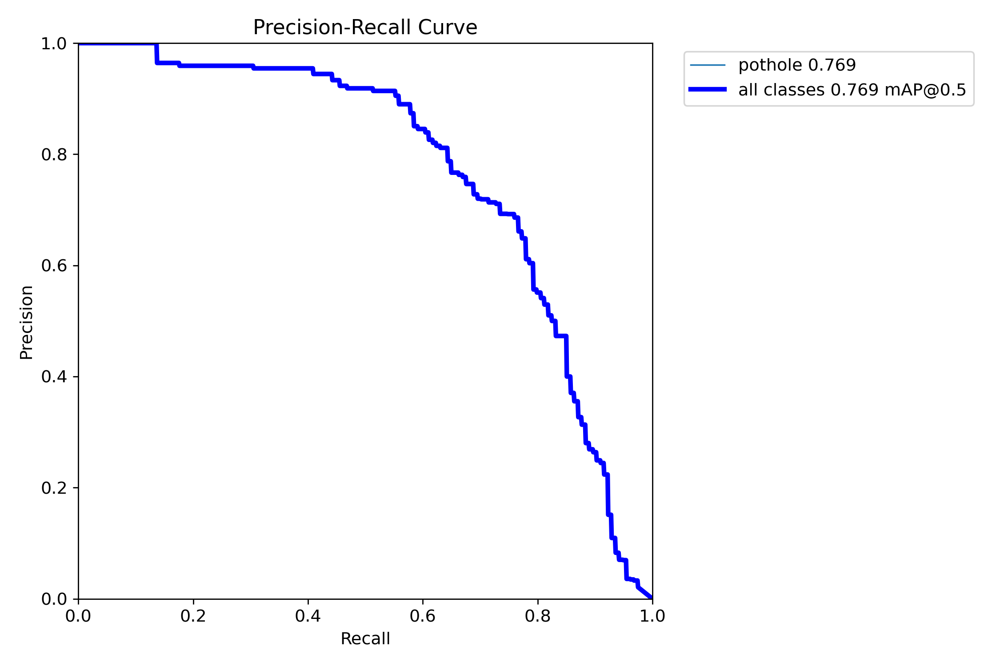

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov5n_aug_ft1/PR_curve.png', width=600)

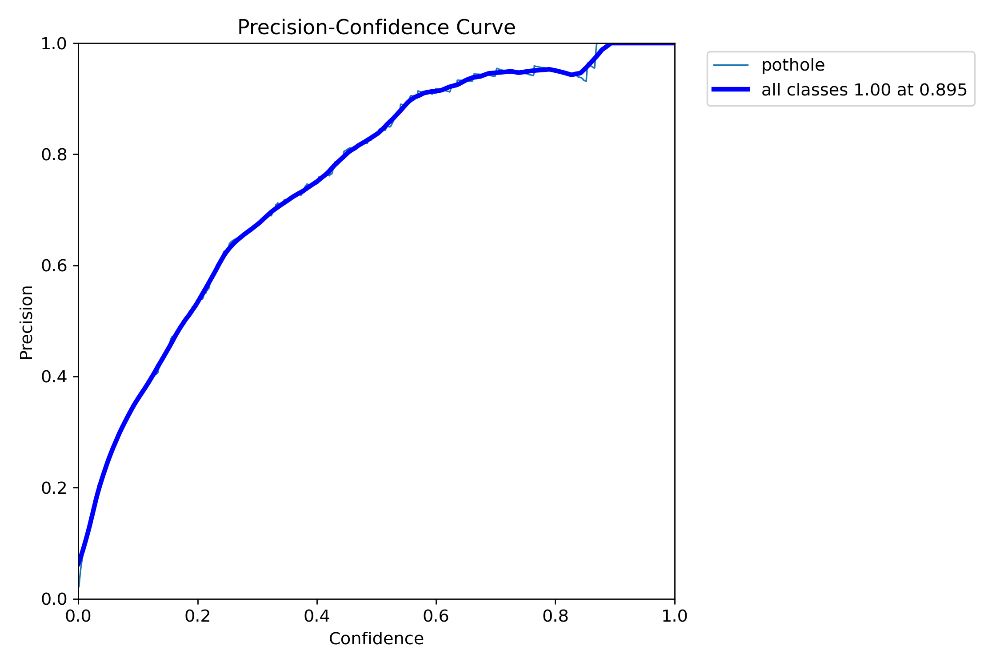

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov5n_aug_ft1/P_curve.png', width=600)

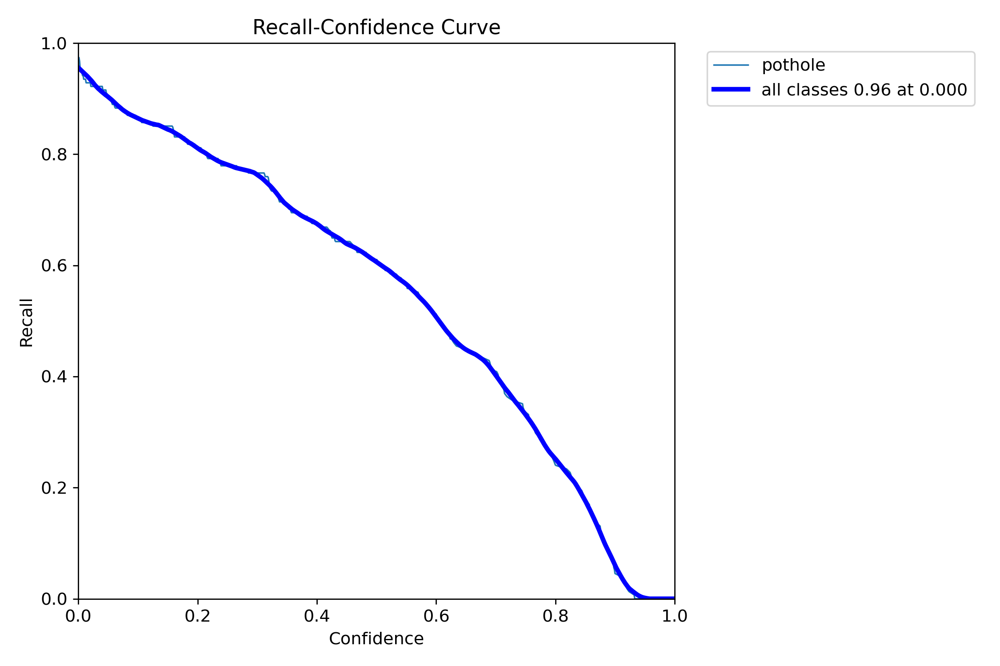

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov5n_aug_ft1/R_curve.png', width=600)

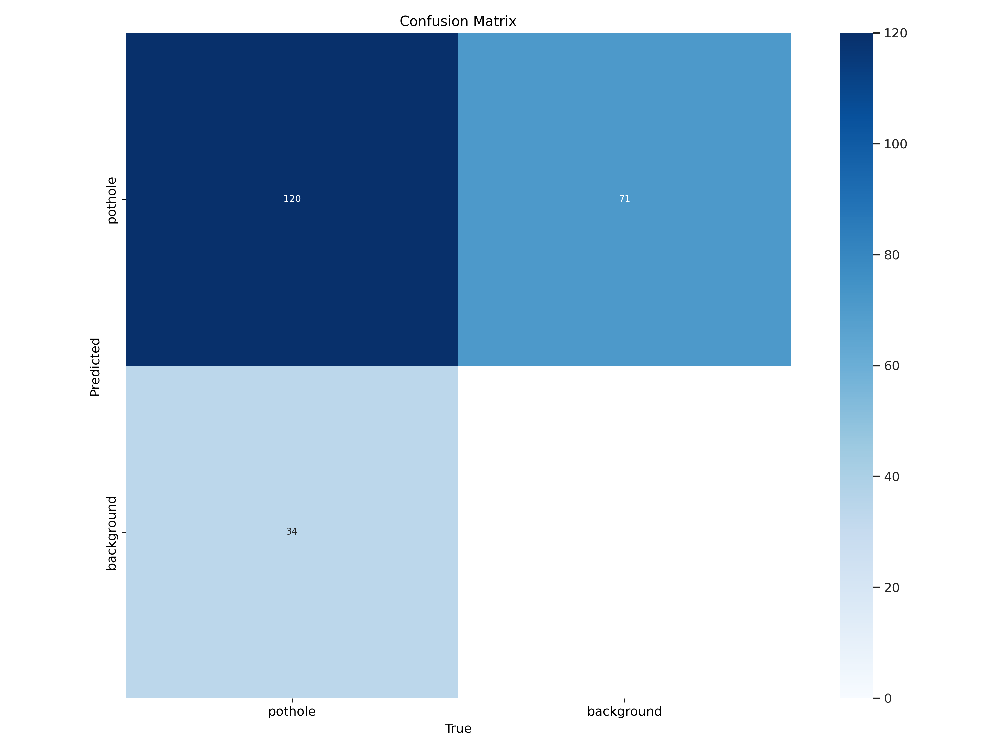

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov5n_aug_ft1/confusion_matrix.png', width=600)

In [ ]:
model_aug_v5.export(format='tflite')

Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.00GHz)

PyTorch: starting from 'runs/detect/yolov5n_aug_ft1/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (5.0 MB)
requirements: Ultralytics requirements ['sng4onnx>=1.0.1', 'onnx_graphsurgeon>=0.3.26', 'onnx>=1.12.0', 'onnx2tf>1.17.5,<=1.26.3', 'onnxslim>=0.1.31', 'tflite_support', 'onnxruntime-gpu'] not found, attempting AutoUpdate...
Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 146.6/146.6 kB 37.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.4/56.4 kB 259.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.0/16.0 MB 349.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 445.6/445.6 kB 352.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 142.6/142.6 kB 332.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.8/60.8 MB 184.0 MB/

100%|██████████| 1.11M/1.11M [00:00<00:00, 172MB/s]
Unzipping calibration_image_sample_data_20x128x128x3_float32.npy.zip to /content/calibration_image_sample_data_20x128x128x3_float32.npy...: 100%|██████████| 1/1 [00:00<00:00, 41.61file/s]


ONNX: starting export with onnx 1.17.0 opset 19...


ONNX: slimming with onnxslim 0.1.45...
ONNX: export success ✅ 1.1s, saved as 'runs/detect/yolov5n_aug_ft1/weights/best.onnx' (9.9 MB)
TensorFlow SavedModel: starting TFLite export with onnx2tf 1.26.3...
TensorFlow SavedModel: export success ✅ 59.5s, saved as 'runs/detect/yolov5n_aug_ft1/weights/best_saved_model' (25.2 MB)

TensorFlow Lite: starting export with tensorflow 2.17.1...
TensorFlow Lite: export success ✅ 0.0s, saved as 'runs/detect/yolov5n_aug_ft1/weights/best_saved_model/best_float32.tflite' (9.8 MB)

Export complete (61.0s)
Results saved to /content/runs/detect/yolov5n_aug_ft1/weights
Predict:         yolo predict task=detect model=runs/detect/yolov5n_aug_ft1/weights/best_saved_model/best_float32.tflite imgsz=640  
Validate:        yolo val task=detect model=runs/detect/yolov5n_aug_ft1/weights/best_saved_model/best_float32.tflite imgsz=640 data=/content/yolov8-dataset/data.yaml  
Visualize:       https://netron.app


'runs/detect/yolov5n_aug_ft1/weights/best_saved_model/best_float32.tflite'

#### YOLOv6

In [ ]:
print("Training YOLOv6...")
model_aug_v6.train(data=os.path.join(dataset_yolov6.location, 'data.yaml'),
                   name='yolov6n_aug_ft1',
                   epochs=epochs,
                   batch=batch_size,
                   imgsz=imgsz,
                   augment=True,
                   fliplr= 0.5,           # Horizontal flip with 50% probability
                   flipud= 0.1,           # Vertical flip with 10% probability
                   scale= 0.3,            # Scale images ±30%
                   translate= 0.2,        # Translate images ±20%
                   hsv_h=0.015,          # HSV hue adjustment ±1.5%
                   hsv_s=0.7,            # HSV saturation adjustment 70%
                   hsv_v=0.4,            # HSV value (brightness) adjustment 40%
                   degrees=10.0,         # Random rotation ±10 degrees
                   shear= 5.0,            # Shear transformations ±5 degrees
                   perspective=0.001,    # Small perspective distortion
                   mosaic= 1.0,           # Enable mosaic augmentation
                   mixup=0.2             # Enable mixup with 20% probability
)

Training YOLOv6...
Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov6n.yaml, data=/content/yolov6-dataset/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov6n_aug_ft1, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_la

train: Scanning /content/yolov6-dataset/labels/train... 465 images, 0 backgrounds, 0 corrupt: 100%|██████████| 465/465 [00:00<00:00, 1058.64it/s]

train: New cache created: /content/yolov6-dataset/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/yolov6-dataset/labels/valid... 133 images, 0 backgrounds, 0 corrupt: 100%|██████████| 133/133 [00:00<00:00, 875.78it/s]

val: New cache created: /content/yolov6-dataset/labels/valid.cache


Plotting labels to runs/detect/yolov6n_aug_ft1/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 53 weight(decay=0.0), 62 weight(decay=0.0005), 61 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolov6n_aug_ft1
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      1.51G      3.485      3.862      4.086          0        640: 100%|██████████| 30/30 [00:04<00:00,  6.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.00it/s]


                   all        133        330    0.00193      0.212    0.00164    0.00049

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      1.68G      3.389      3.582      3.918          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.38it/s]


                   all        133        330    0.00179      0.215    0.00133   0.000437

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      1.63G       3.12      3.385      3.506          2        640: 100%|██████████| 30/30 [00:04<00:00,  7.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.84it/s]

                   all        133        330     0.0144    0.00606    0.00188    0.00061



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      1.63G      2.999      3.328      3.274          5        640: 100%|██████████| 30/30 [00:04<00:00,  7.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.85it/s]

                   all        133        330     0.0272     0.0394     0.0088    0.00246



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      1.63G      2.845      3.248       3.06          9        640: 100%|██████████| 30/30 [00:04<00:00,  7.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.41it/s]

                   all        133        330      0.012      0.194    0.00624    0.00194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      1.62G      2.781      3.168      2.969          5        640: 100%|██████████| 30/30 [00:04<00:00,  7.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.87it/s]

                   all        133        330     0.0137     0.0364    0.00382    0.00123



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      1.62G      2.712      3.177      2.922          8        640: 100%|██████████| 30/30 [00:03<00:00,  7.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.99it/s]

                   all        133        330     0.0149     0.0909    0.00544    0.00165



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      1.63G      2.683      3.094      2.856          2        640: 100%|██████████| 30/30 [00:03<00:00,  7.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.69it/s]

                   all        133        330     0.0192      0.264     0.0119    0.00392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      1.62G      2.609      3.088      2.804         16        640: 100%|██████████| 30/30 [00:04<00:00,  7.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.32it/s]

                   all        133        330      0.022      0.103     0.0125    0.00354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      1.64G      2.582      3.042      2.775          4        640: 100%|██████████| 30/30 [00:04<00:00,  7.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.00it/s]

                   all        133        330      0.117      0.097     0.0567     0.0141



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      1.65G       2.53      3.027       2.73          1        640: 100%|██████████| 30/30 [00:03<00:00,  7.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.32it/s]

                   all        133        330      0.165      0.191     0.0941     0.0253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      1.63G      2.448      2.918      2.675          6        640: 100%|██████████| 30/30 [00:03<00:00,  7.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.69it/s]

                   all        133        330     0.0745      0.145     0.0315    0.00864



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      1.65G      2.406      2.835      2.625          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.63it/s]

                   all        133        330      0.217      0.155      0.113      0.034



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      1.63G      2.414      2.786      2.601         12        640: 100%|██████████| 30/30 [00:04<00:00,  7.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.62it/s]

                   all        133        330      0.157      0.197     0.0906     0.0256



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      1.61G      2.373      2.743      2.568          6        640: 100%|██████████| 30/30 [00:03<00:00,  7.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.21it/s]

                   all        133        330       0.29      0.242      0.184     0.0612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      1.65G      2.344      2.663      2.493         10        640: 100%|██████████| 30/30 [00:03<00:00,  7.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.15it/s]

                   all        133        330      0.254      0.215      0.145     0.0472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50       1.6G      2.293      2.722      2.531          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.43it/s]

                   all        133        330      0.194      0.212      0.143     0.0411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      1.62G       2.24      2.675      2.466          2        640: 100%|██████████| 30/30 [00:04<00:00,  7.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.89it/s]

                   all        133        330      0.313      0.242      0.232     0.0825



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      1.62G      2.293      2.611      2.454         14        640: 100%|██████████| 30/30 [00:03<00:00,  7.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.87it/s]

                   all        133        330      0.349      0.261       0.24      0.102



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      1.64G      2.221      2.567      2.392          2        640: 100%|██████████| 30/30 [00:04<00:00,  7.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.69it/s]

                   all        133        330       0.43      0.261      0.255        0.1



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      1.61G      2.192      2.477      2.384          6        640: 100%|██████████| 30/30 [00:04<00:00,  7.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.66it/s]

                   all        133        330      0.428      0.288      0.304      0.121



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      1.63G      2.198      2.495       2.37          3        640: 100%|██████████| 30/30 [00:03<00:00,  7.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.91it/s]

                   all        133        330       0.42      0.361      0.307      0.114



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      1.63G       2.17      2.426      2.324         10        640: 100%|██████████| 30/30 [00:03<00:00,  7.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.06it/s]

                   all        133        330      0.523      0.324      0.352      0.146



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      1.63G      2.144      2.372      2.299          4        640: 100%|██████████| 30/30 [00:04<00:00,  7.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.52it/s]

                   all        133        330       0.37      0.364      0.312      0.113



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      1.62G       2.12       2.48      2.304          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.51it/s]

                   all        133        330      0.472      0.348       0.35       0.14



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      1.63G      2.119       2.34      2.289          5        640: 100%|██████████| 30/30 [00:03<00:00,  7.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.31it/s]

                   all        133        330       0.49      0.373      0.382      0.165



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      1.61G       2.08      2.354      2.226          1        640: 100%|██████████| 30/30 [00:03<00:00,  7.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.02it/s]

                   all        133        330      0.539      0.373      0.393      0.168



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      1.63G      2.087      2.296       2.23          5        640: 100%|██████████| 30/30 [00:04<00:00,  7.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.34it/s]

                   all        133        330      0.415       0.37      0.365      0.131



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50       1.6G      2.063      2.247      2.216          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.00it/s]

                   all        133        330      0.547      0.379      0.415      0.184



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      1.62G      2.075      2.323      2.246          4        640: 100%|██████████| 30/30 [00:03<00:00,  7.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.05it/s]

                   all        133        330      0.474      0.364      0.367      0.151



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      1.63G      2.076      2.211      2.209          5        640: 100%|██████████| 30/30 [00:03<00:00,  7.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.25it/s]

                   all        133        330       0.53       0.39      0.415      0.165



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      1.65G      1.996      2.198      2.158          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.43it/s]

                   all        133        330      0.582      0.397      0.432      0.183



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      1.63G      2.048      2.231      2.197          8        640: 100%|██████████| 30/30 [00:04<00:00,  7.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.30it/s]

                   all        133        330      0.577      0.409      0.442      0.201



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      1.63G      1.986      2.186      2.148         15        640: 100%|██████████| 30/30 [00:03<00:00,  7.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.12it/s]

                   all        133        330      0.647      0.421      0.465      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      1.64G       1.97      2.144      2.124          3        640: 100%|██████████| 30/30 [00:03<00:00,  7.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.48it/s]

                   all        133        330      0.564      0.421      0.473      0.198



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      1.63G          2       2.15      2.156          4        640: 100%|██████████| 30/30 [00:04<00:00,  7.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.97it/s]

                   all        133        330      0.592      0.436      0.474      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      1.63G      2.007       2.17      2.173          2        640: 100%|██████████| 30/30 [00:04<00:00,  7.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.05it/s]

                   all        133        330       0.61      0.421      0.479      0.209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      1.66G       1.96      2.137      2.134          3        640: 100%|██████████| 30/30 [00:03<00:00,  7.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.22it/s]

                   all        133        330      0.667        0.4      0.475      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      1.63G      1.992      2.143      2.163          2        640: 100%|██████████| 30/30 [00:03<00:00,  7.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.63it/s]

                   all        133        330      0.609      0.467       0.49      0.216



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      1.61G      1.904      2.382      2.053          0        640: 100%|██████████| 30/30 [00:04<00:00,  7.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.94it/s]

                   all        133        330       0.71        0.4      0.508      0.223


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      1.62G      1.724      2.017      1.926          2        640: 100%|██████████| 30/30 [00:05<00:00,  6.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.77it/s]

                   all        133        330      0.557        0.4      0.446      0.197



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      1.68G      1.715      1.865      1.945          1        640: 100%|██████████| 30/30 [00:03<00:00,  7.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.91it/s]

                   all        133        330      0.585      0.473      0.516       0.25



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      1.58G      1.695      1.813      1.912          3        640: 100%|██████████| 30/30 [00:03<00:00,  7.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.53it/s]

                   all        133        330      0.642      0.445      0.516      0.223



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      1.63G       1.74      1.798      1.972          1        640: 100%|██████████| 30/30 [00:03<00:00,  7.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.30it/s]

                   all        133        330       0.66      0.467      0.535      0.235



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      1.62G      1.715       1.76      1.902          1        640: 100%|██████████| 30/30 [00:03<00:00,  7.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.65it/s]

                   all        133        330      0.605      0.509      0.545       0.25



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50       1.6G      1.679      1.735      1.889          4        640: 100%|██████████| 30/30 [00:03<00:00,  7.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.82it/s]

                   all        133        330       0.61      0.503      0.566      0.264



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      1.63G       1.67      1.703      1.887          1        640: 100%|██████████| 30/30 [00:03<00:00,  7.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.63it/s]

                   all        133        330      0.667      0.479       0.56      0.267



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      1.65G      1.686       1.72      1.876          2        640: 100%|██████████| 30/30 [00:03<00:00,  7.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.23it/s]

                   all        133        330      0.764      0.458      0.574      0.273



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      1.62G      1.647      1.644      1.836          5        640: 100%|██████████| 30/30 [00:03<00:00,  7.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.07it/s]

                   all        133        330      0.695      0.482      0.577      0.275



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      1.62G      1.622      1.641      1.842          1        640: 100%|██████████| 30/30 [00:03<00:00,  7.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.93it/s]

                   all        133        330      0.684      0.498      0.581      0.267



50 epochs completed in 0.081 hours.
Optimizer stripped from runs/detect/yolov6n_aug_ft1/weights/last.pt, 8.7MB
Optimizer stripped from runs/detect/yolov6n_aug_ft1/weights/best.pt, 8.7MB

Validating runs/detect/yolov6n_aug_ft1/weights/best.pt...
Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv6n summary (fused): 142 layers, 4,233,843 parameters, 0 gradients, 11.8 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.12it/s]


                   all        133        330      0.625      0.503      0.567      0.276
Speed: 0.2ms preprocess, 6.5ms inference, 0.0ms loss, 6.6ms postprocess per image
Results saved to runs/detect/yolov6n_aug_ft1


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x79d901e63790>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

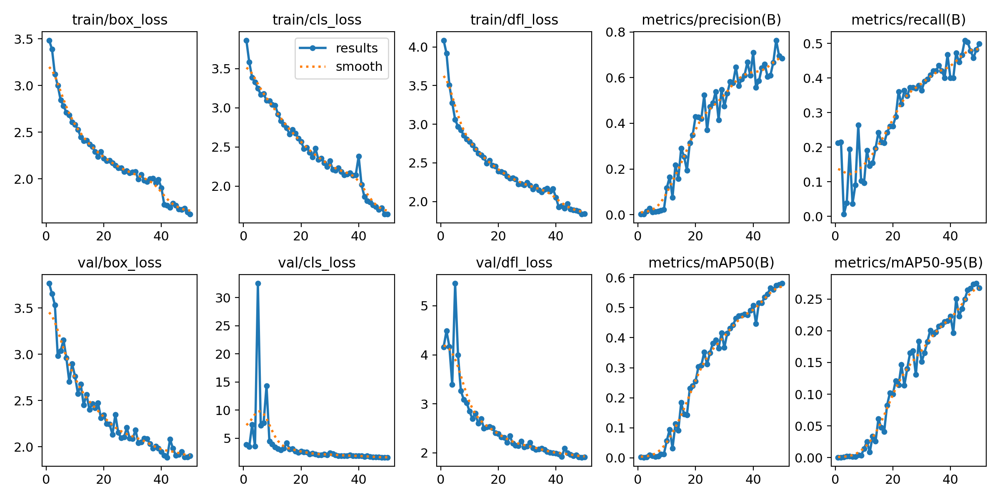

In [ ]:
Image(filename=f'/content/runs/detect/yolov6n_aug_ft1/results.png', width=600)

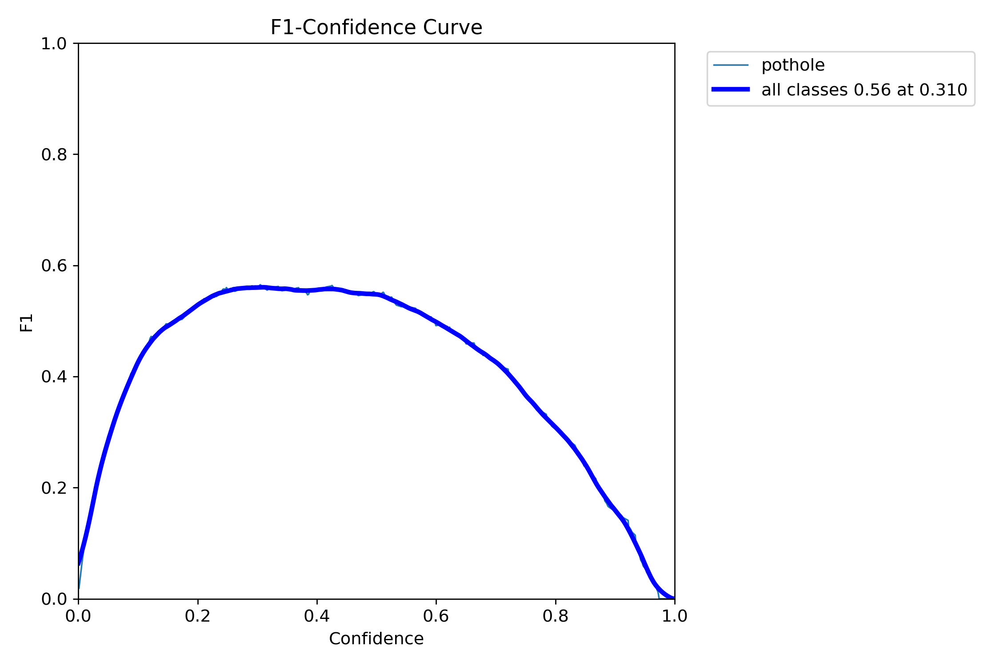

In [ ]:
Image(filename=f'/content/runs/detect/yolov6n_aug_ft1/F1_curve.png', width=600)

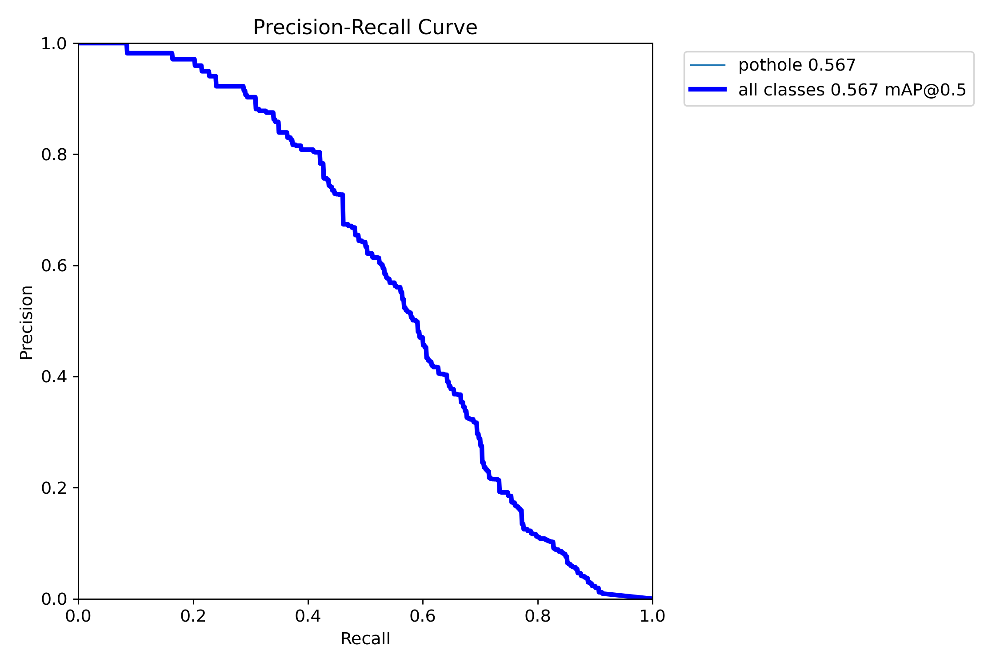

In [ ]:
Image(filename=f'/content/runs/detect/yolov6n_aug_ft1/PR_curve.png', width=600)

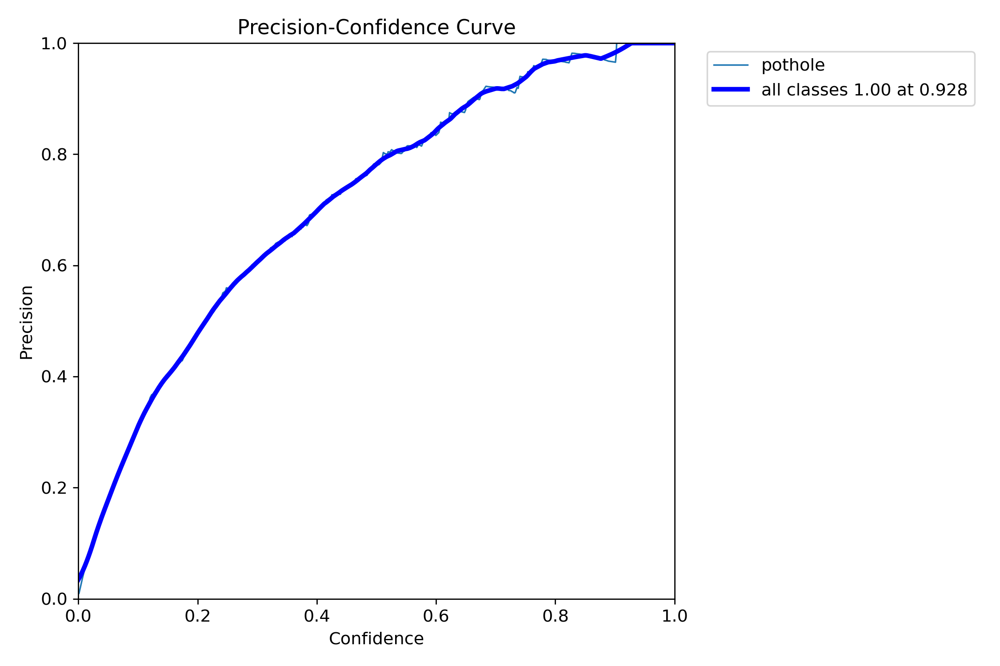

In [ ]:
Image(filename=f'/content/runs/detect/yolov6n_aug_ft1/P_curve.png', width=600)

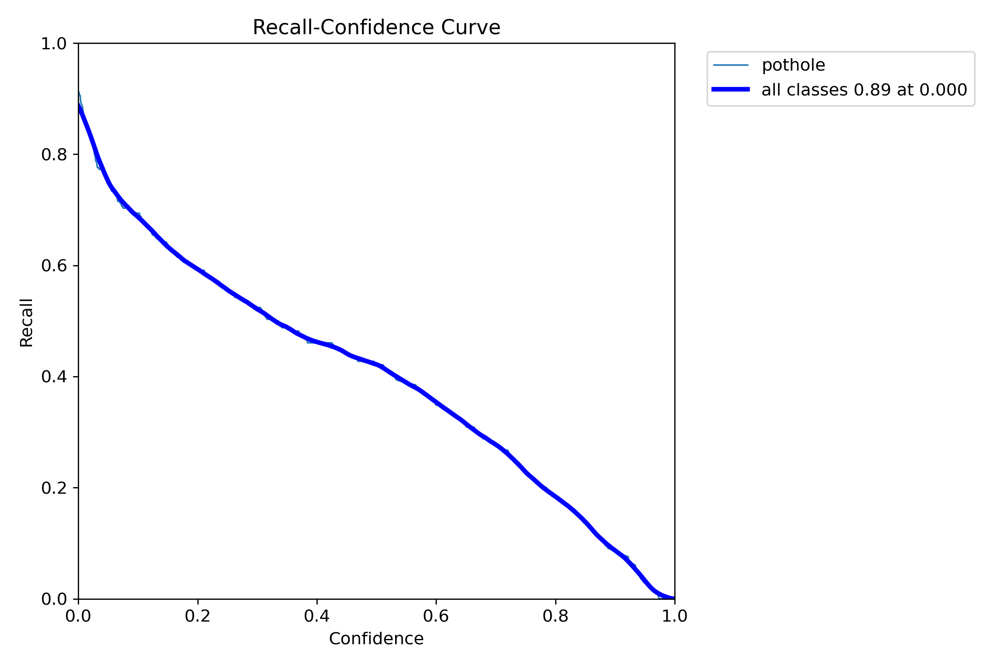

In [ ]:
Image(filename=f'/content/runs/detect/yolov6n_aug_ft1/R_curve.png', width=600)

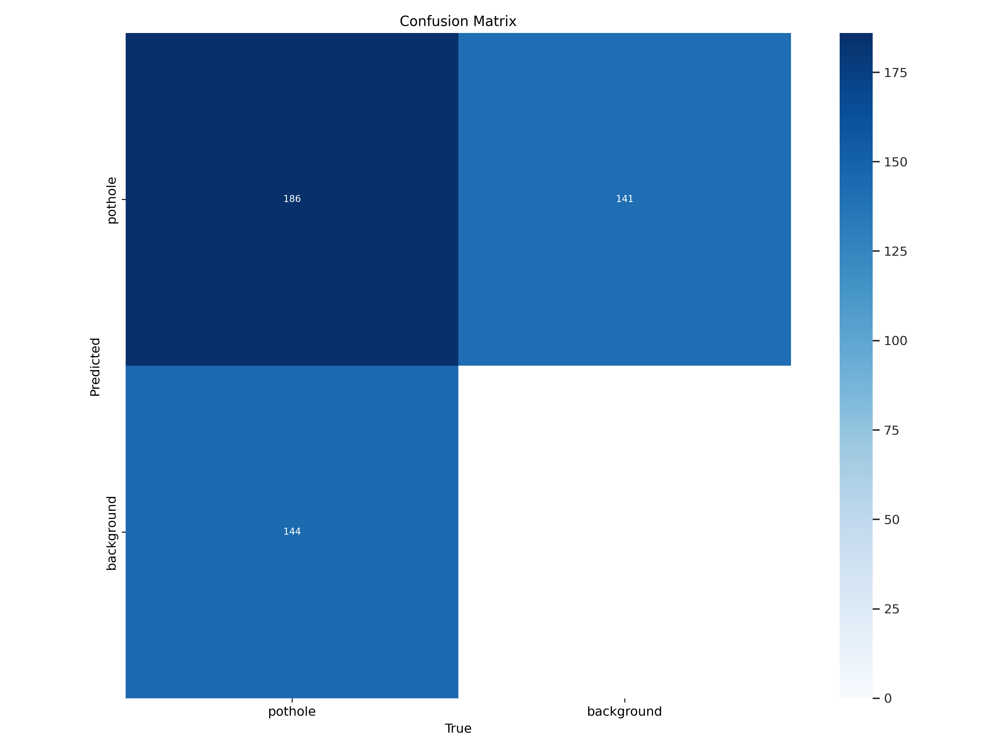

In [ ]:
Image(filename=f'/content/runs/detect/yolov6n_aug_ft1/confusion_matrix.png', width=600)

In [ ]:
metrics_v6 = '/content/runs/detect/yolov6n_aug_ft1/results.csv'

In [ ]:
results_v6 = model_aug_v6.val(name='test_yolov6n_aug_ft1',split='test')

Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv6n summary (fused): 142 layers, 4,233,843 parameters, 0 gradients, 11.8 GFLOPs


val: Scanning /content/yolov6-dataset/labels/test... 67 images, 0 backgrounds, 0 corrupt: 100%|██████████| 67/67 [00:00<00:00, 1069.87it/s]

val: New cache created: /content/yolov6-dataset/labels/test.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.29it/s]


                   all         67        154      0.619        0.5      0.558      0.278
Speed: 0.3ms preprocess, 18.7ms inference, 0.0ms loss, 3.6ms postprocess per image
Results saved to runs/detect/test_yolov6n_aug_ft1


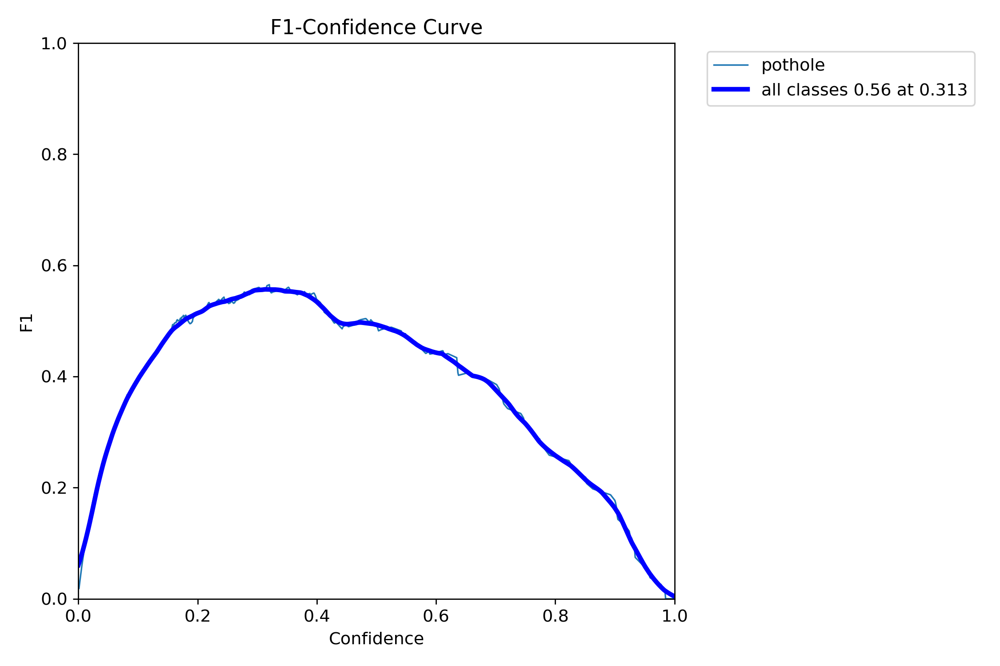

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov6n_aug_ft1/F1_curve.png', width=600)

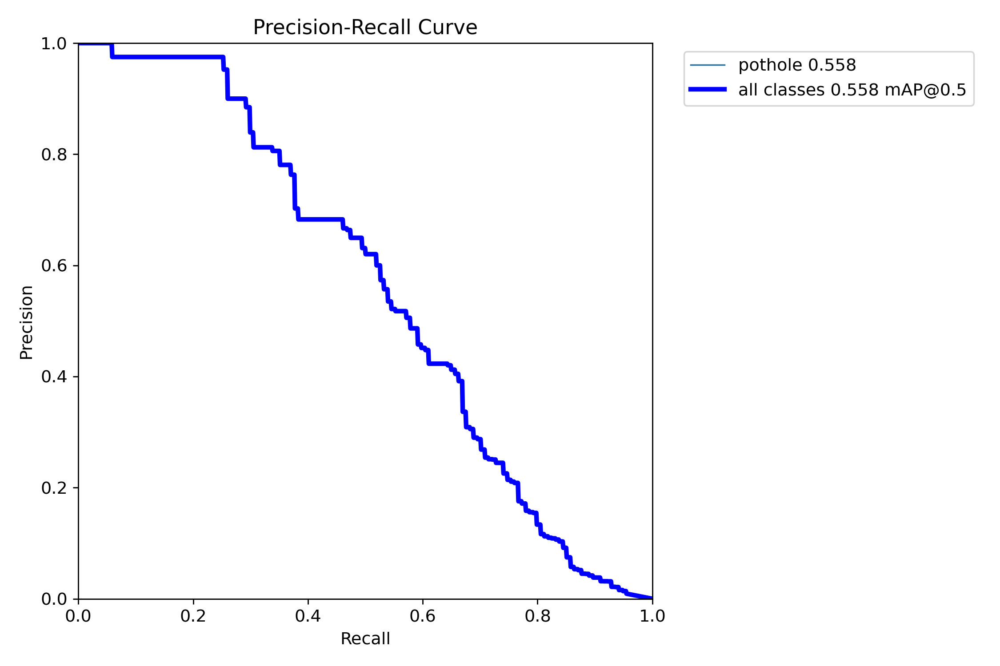

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov6n_aug_ft1/PR_curve.png', width=600)

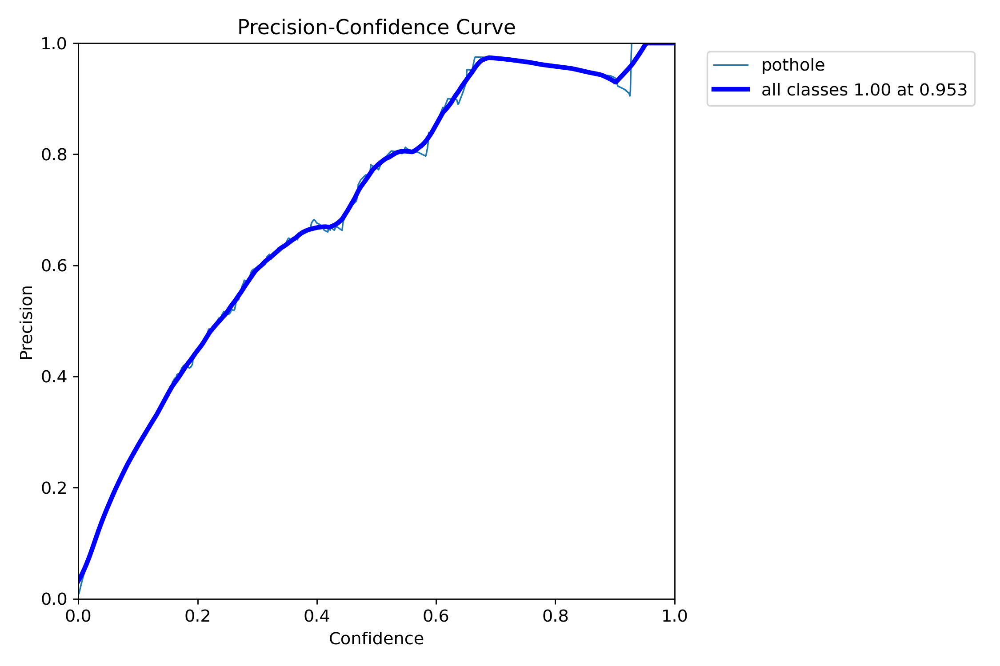

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov6n_aug_ft1/P_curve.png', width=600)

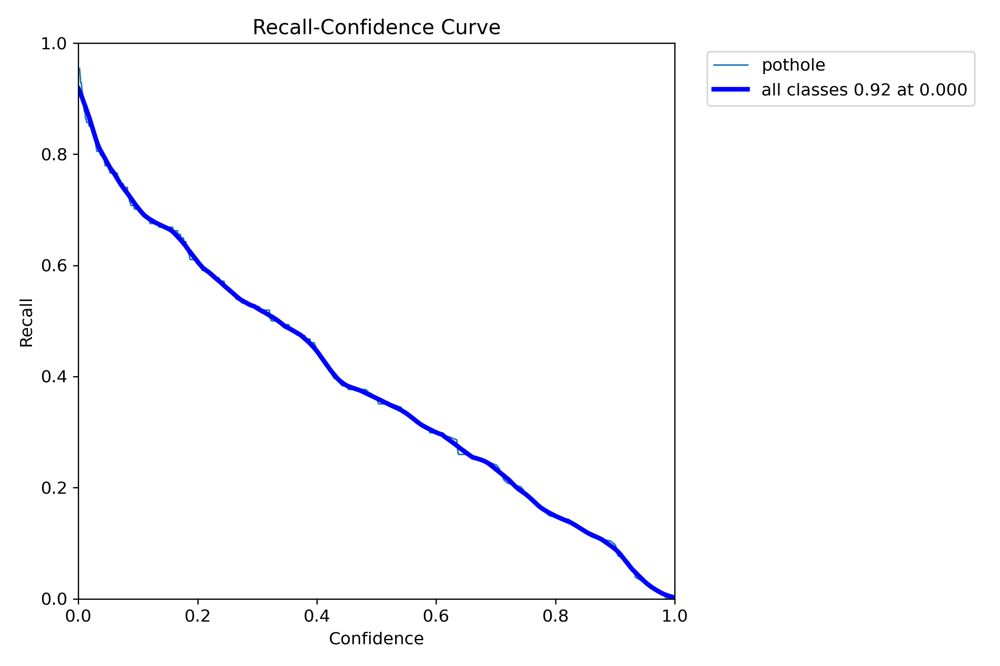

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov6n_aug_ft1/R_curve.png', width=600)

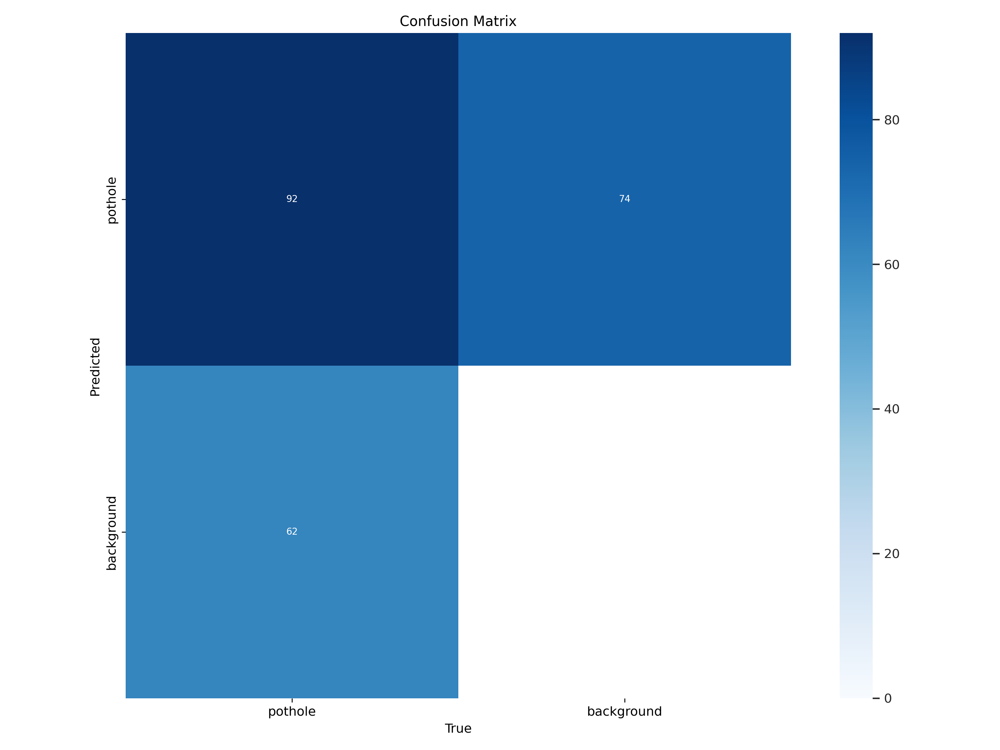

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov6n_aug_ft1/confusion_matrix.png', width=600)

In [ ]:
model_aug_v6.export(format='tflite')

Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.00GHz)

PyTorch: starting from 'runs/detect/yolov6n_aug_ft1/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (8.3 MB)

TensorFlow SavedModel: starting export with tensorflow 2.17.1...

ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.45...
ONNX: export success ✅ 0.9s, saved as 'runs/detect/yolov6n_aug_ft1/weights/best.onnx' (16.4 MB)
TensorFlow SavedModel: starting TFLite export with onnx2tf 1.26.3...
TensorFlow SavedModel: export success ✅ 29.6s, saved as 'runs/detect/yolov6n_aug_ft1/weights/best_saved_model' (41.6 MB)

TensorFlow Lite: starting export with tensorflow 2.17.1...
TensorFlow Lite: export success ✅ 0.0s, saved as 'runs/detect/yolov6n_aug_ft1/weights/best_saved_model/best_float32.tflite' (16.4 MB)

Export complete (29.9s)
Results saved to /content/runs/detect/yolov6n_aug_ft1/weights
Predict:         yolo predict task=detect mode

'runs/detect/yolov6n_aug_ft1/weights/best_saved_model/best_float32.tflite'

#### YOLOv8

In [ ]:
print("Training YOLOv8...")
model_aug_v8.train(data=os.path.join(dataset_yolov8.location, 'data.yaml'),
                   name="yolov8n_aug_ft1",
                   epochs=epochs,
                   batch=batch_size,
                   imgsz=imgsz,
                   device=0,
                   augment=True,
                   fliplr= 0.5,           # Horizontal flip with 50% probability
                   flipud= 0.1,           # Vertical flip with 10% probability
                   scale= 0.3,            # Scale images ±30%
                   translate= 0.2,        # Translate images ±20%
                   hsv_h=0.015,          # HSV hue adjustment ±1.5%
                   hsv_s=0.7,            # HSV saturation adjustment 70%
                   hsv_v=0.4,            # HSV value (brightness) adjustment 40%
                   degrees=10.0,         # Random rotation ±10 degrees
                   shear= 5.0,            # Shear transformations ±5 degrees
                   perspective=0.001,    # Small perspective distortion
                   mosaic= 1.0,           # Enable mosaic augmentation
                   mixup=0.2             # Enable mixup with 20% probability
)

Training YOLOv8...
Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/yolov8-dataset/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=yolov8n_aug_ft1, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=

train: Scanning /content/yolov8-dataset/train/labels.cache... 465 images, 0 backgrounds, 0 corrupt: 100%|██████████| 465/465 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/yolov8-dataset/valid/labels.cache... 133 images, 0 backgrounds, 0 corrupt: 100%|██████████| 133/133 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov8n_aug_ft1/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolov8n_aug_ft1
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50       1.9G       2.19       3.38      2.017          0        640: 100%|██████████| 30/30 [00:04<00:00,  6.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.56it/s]

                   all        133        330    0.00331        0.4    0.00678    0.00218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      1.96G       2.05      2.676      1.885          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.15it/s]


                   all        133        330    0.00591      0.715     0.0124    0.00378

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.04G      2.068      2.492      1.903          2        640: 100%|██████████| 30/30 [00:04<00:00,  6.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.30it/s]


                   all        133        330     0.0462      0.124     0.0271    0.00626

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.04G      2.058      2.424      1.911          5        640: 100%|██████████| 30/30 [00:04<00:00,  6.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.22it/s]

                   all        133        330      0.191      0.155     0.0945     0.0265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.05G      2.016      2.281      1.879          9        640: 100%|██████████| 30/30 [00:04<00:00,  6.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.02it/s]

                   all        133        330      0.294      0.324      0.246     0.0849



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.04G      1.993      2.215      1.869          5        640: 100%|██████████| 30/30 [00:04<00:00,  7.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.07it/s]

                   all        133        330      0.305      0.267      0.215     0.0811



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      1.95G      1.932      2.184      1.834          8        640: 100%|██████████| 30/30 [00:04<00:00,  6.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.29it/s]

                   all        133        330      0.428       0.33      0.324      0.145



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.04G       1.92      2.119      1.818          2        640: 100%|██████████| 30/30 [00:04<00:00,  6.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.62it/s]

                   all        133        330      0.455      0.342      0.305       0.12



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.04G       1.86      2.072      1.769         16        640: 100%|██████████| 30/30 [00:04<00:00,  6.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.88it/s]

                   all        133        330      0.491      0.324      0.327      0.129



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.05G      1.891       2.01      1.788          4        640: 100%|██████████| 30/30 [00:04<00:00,  7.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.93it/s]

                   all        133        330      0.464      0.379      0.393      0.153



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.07G      1.882      2.024      1.785          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.48it/s]

                   all        133        330      0.569      0.421      0.454      0.174



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.04G      1.836       1.93      1.764          6        640: 100%|██████████| 30/30 [00:04<00:00,  6.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.36it/s]

                   all        133        330      0.546      0.421      0.445      0.161



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.07G      1.831      1.907      1.735          3        640: 100%|██████████| 30/30 [00:04<00:00,  6.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.37it/s]

                   all        133        330      0.467       0.45      0.436      0.156



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.04G      1.849      1.895      1.742         12        640: 100%|██████████| 30/30 [00:04<00:00,  6.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.13it/s]

                   all        133        330       0.64      0.412      0.506      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.02G      1.778      1.838      1.709          6        640: 100%|██████████| 30/30 [00:04<00:00,  7.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.33it/s]

                   all        133        330      0.656      0.506      0.568      0.237



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.07G      1.812      1.856      1.704         10        640: 100%|██████████| 30/30 [00:04<00:00,  6.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.02it/s]

                   all        133        330      0.543       0.53      0.539      0.225



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.02G      1.808      1.882      1.709          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.75it/s]

                   all        133        330      0.646      0.479      0.563      0.241



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      1.95G      1.757      1.825      1.695          2        640: 100%|██████████| 30/30 [00:04<00:00,  6.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.08it/s]

                   all        133        330      0.481       0.57      0.512      0.206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.04G      1.782       1.81      1.691         14        640: 100%|██████████| 30/30 [00:04<00:00,  6.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.52it/s]

                   all        133        330      0.637       0.53      0.607      0.273



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.05G      1.751      1.759      1.685          2        640: 100%|██████████| 30/30 [00:04<00:00,  7.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.82it/s]

                   all        133        330      0.638      0.564       0.58       0.26



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      2.02G       1.71      1.725      1.647          6        640: 100%|██████████| 30/30 [00:04<00:00,  6.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.13it/s]

                   all        133        330      0.723      0.533      0.624      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.04G      1.751      1.751       1.69          3        640: 100%|██████████| 30/30 [00:04<00:00,  6.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.90it/s]

                   all        133        330      0.618      0.506      0.569      0.274



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.04G      1.742      1.704      1.631         10        640: 100%|██████████| 30/30 [00:04<00:00,  6.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.87it/s]

                   all        133        330      0.682      0.565      0.618      0.273



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.04G      1.714      1.648      1.621          4        640: 100%|██████████| 30/30 [00:04<00:00,  6.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.67it/s]

                   all        133        330      0.608      0.598      0.613      0.236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.04G      1.743      1.814      1.661          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.98it/s]

                   all        133        330      0.659      0.579      0.624      0.288



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      2.02G      1.719      1.659      1.646          5        640: 100%|██████████| 30/30 [00:04<00:00,  6.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.29it/s]

                   all        133        330      0.671      0.611      0.658      0.299



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      1.95G      1.768      1.682       1.68          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.71it/s]

                   all        133        330      0.701      0.612      0.668       0.32



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.04G        1.7      1.644       1.62          5        640: 100%|██████████| 30/30 [00:04<00:00,  6.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.74it/s]

                   all        133        330      0.704      0.618      0.686      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.01G      1.683      1.654      1.619          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.84it/s]

                   all        133        330       0.68      0.606      0.676       0.32



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.02G      1.693      1.672      1.628          4        640: 100%|██████████| 30/30 [00:04<00:00,  6.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.36it/s]

                   all        133        330       0.69      0.607      0.641      0.271



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      2.04G      1.665      1.579      1.597          5        640: 100%|██████████| 30/30 [00:04<00:00,  6.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.32it/s]

                   all        133        330      0.765      0.592      0.684      0.341



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      2.01G       1.63      1.572      1.562          3        640: 100%|██████████| 30/30 [00:04<00:00,  6.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.66it/s]

                   all        133        330      0.725        0.6      0.688      0.333



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.05G       1.69      1.601      1.603          8        640: 100%|██████████| 30/30 [00:04<00:00,  6.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.75it/s]

                   all        133        330      0.738      0.603      0.691      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      2.02G       1.65      1.553      1.571         15        640: 100%|██████████| 30/30 [00:04<00:00,  7.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.56it/s]

                   all        133        330      0.763      0.615      0.705      0.332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      2.06G      1.648      1.535      1.582          3        640: 100%|██████████| 30/30 [00:04<00:00,  6.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.50it/s]

                   all        133        330      0.806      0.606      0.727      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.04G      1.648      1.539       1.58          4        640: 100%|██████████| 30/30 [00:04<00:00,  6.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.92it/s]

                   all        133        330      0.776       0.63      0.727       0.33



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      2.04G       1.67      1.596      1.608          2        640: 100%|██████████| 30/30 [00:04<00:00,  6.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.60it/s]

                   all        133        330      0.737      0.667      0.721      0.342



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.06G      1.622      1.518      1.563          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.51it/s]

                   all        133        330      0.747      0.618      0.693      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      2.05G      1.627      1.525      1.587          2        640: 100%|██████████| 30/30 [00:04<00:00,  7.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.69it/s]

                   all        133        330      0.775      0.591      0.708      0.365



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      2.08G      1.551      1.763      1.501          0        640: 100%|██████████| 30/30 [00:04<00:00,  6.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.67it/s]

                   all        133        330      0.692      0.694      0.735       0.35


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      2.04G      1.482      1.405      1.444          2        640: 100%|██████████| 30/30 [00:05<00:00,  5.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.45it/s]

                   all        133        330      0.745      0.603      0.693      0.378



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      2.04G      1.404      1.273      1.441          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.98it/s]

                   all        133        330      0.766      0.639      0.734      0.368



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      1.99G      1.377      1.214       1.39          3        640: 100%|██████████| 30/30 [00:04<00:00,  7.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.91it/s]

                   all        133        330      0.769      0.603      0.721      0.366



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      2.04G      1.423      1.214      1.462          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.59it/s]

                   all        133        330      0.801      0.636      0.734      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      2.04G      1.398      1.122      1.383          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.71it/s]

                   all        133        330      0.789      0.623       0.75      0.407



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      2.01G      1.389      1.099      1.401          4        640: 100%|██████████| 30/30 [00:04<00:00,  7.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.82it/s]

                   all        133        330      0.788      0.655      0.761      0.389



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      2.04G      1.351       1.08       1.37          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.00it/s]

                   all        133        330      0.787      0.652       0.76      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      2.01G      1.369      1.081      1.354          2        640: 100%|██████████| 30/30 [00:04<00:00,  7.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.84it/s]

                   all        133        330      0.769      0.677      0.761      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      2.02G      1.338      1.059      1.357          5        640: 100%|██████████| 30/30 [00:04<00:00,  7.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.78it/s]

                   all        133        330       0.78      0.664      0.756      0.403



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      2.01G      1.335      1.046      1.342          1        640: 100%|██████████| 30/30 [00:04<00:00,  7.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.86it/s]

                   all        133        330      0.819      0.661      0.757      0.413



50 epochs completed in 0.084 hours.
Optimizer stripped from runs/detect/yolov8n_aug_ft1/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/yolov8n_aug_ft1/weights/best.pt, 6.2MB

Validating runs/detect/yolov8n_aug_ft1/weights/best.pt...
Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.36it/s]


                   all        133        330      0.771      0.673      0.756       0.42
Speed: 0.2ms preprocess, 6.1ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs/detect/yolov8n_aug_ft1


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x79dac7f03040>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

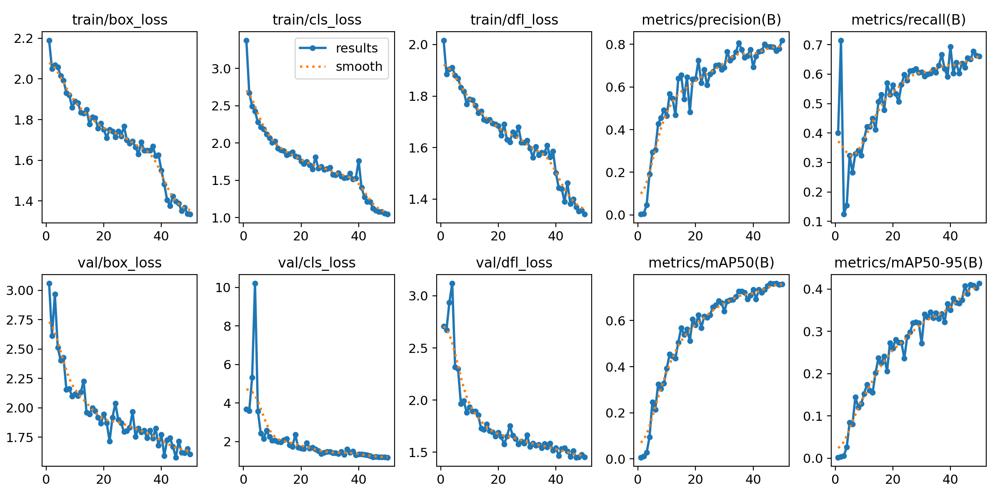

In [ ]:
Image(filename=f'/content/runs/detect/yolov8n_aug_ft1/results.png', width=600)

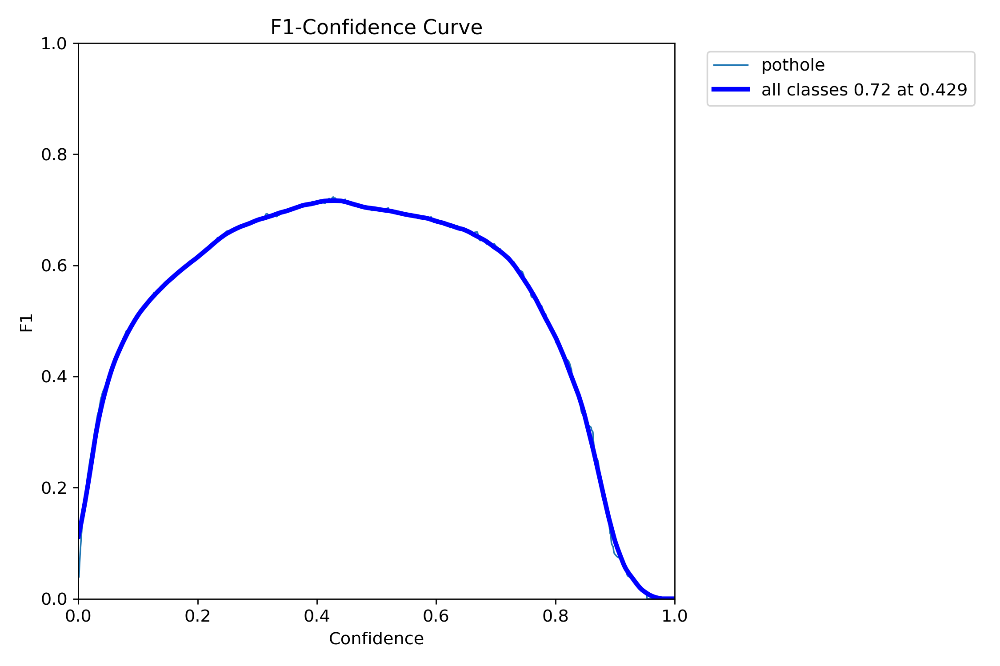

In [ ]:
Image(filename=f'/content/runs/detect/yolov8n_aug_ft1/F1_curve.png', width=600)

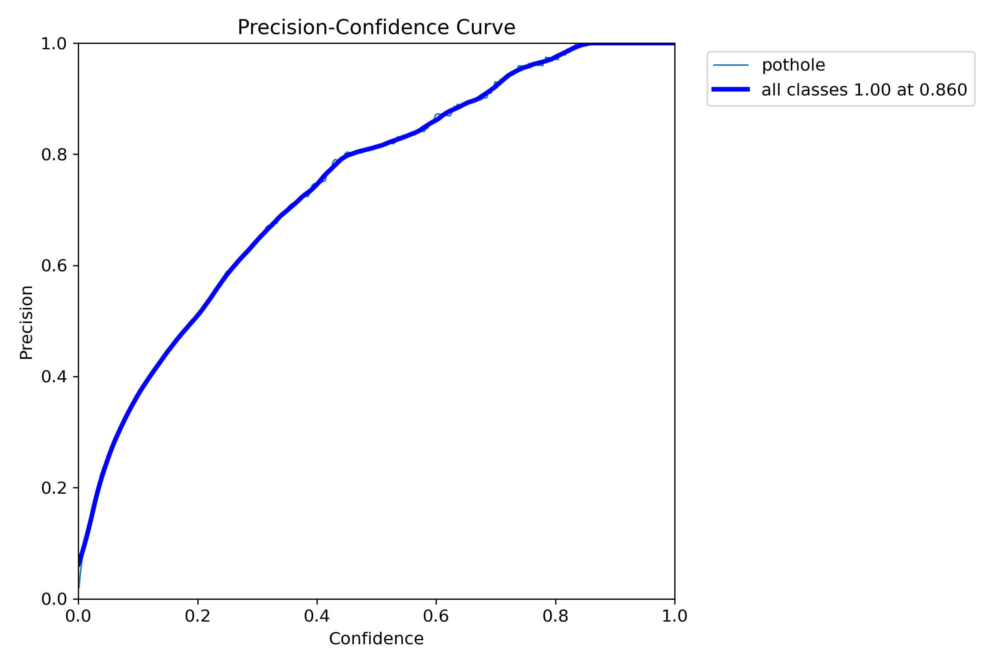

In [ ]:
Image(filename=f'/content/runs/detect/yolov8n_aug_ft1/P_curve.png', width=600)

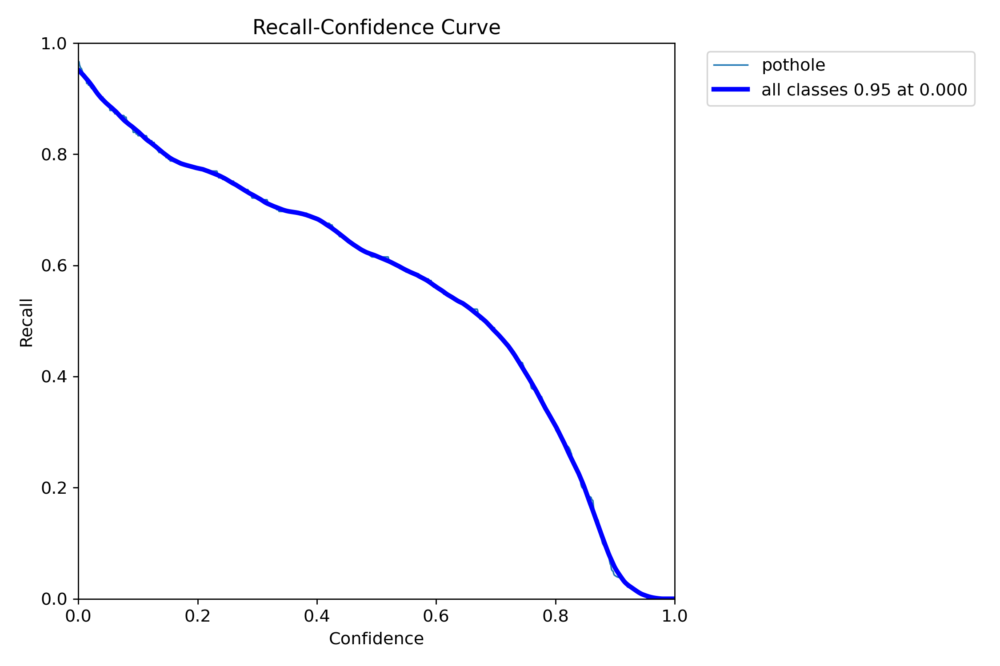

In [ ]:
Image(filename=f'/content/runs/detect/yolov8n_aug_ft1/R_curve.png', width=600)

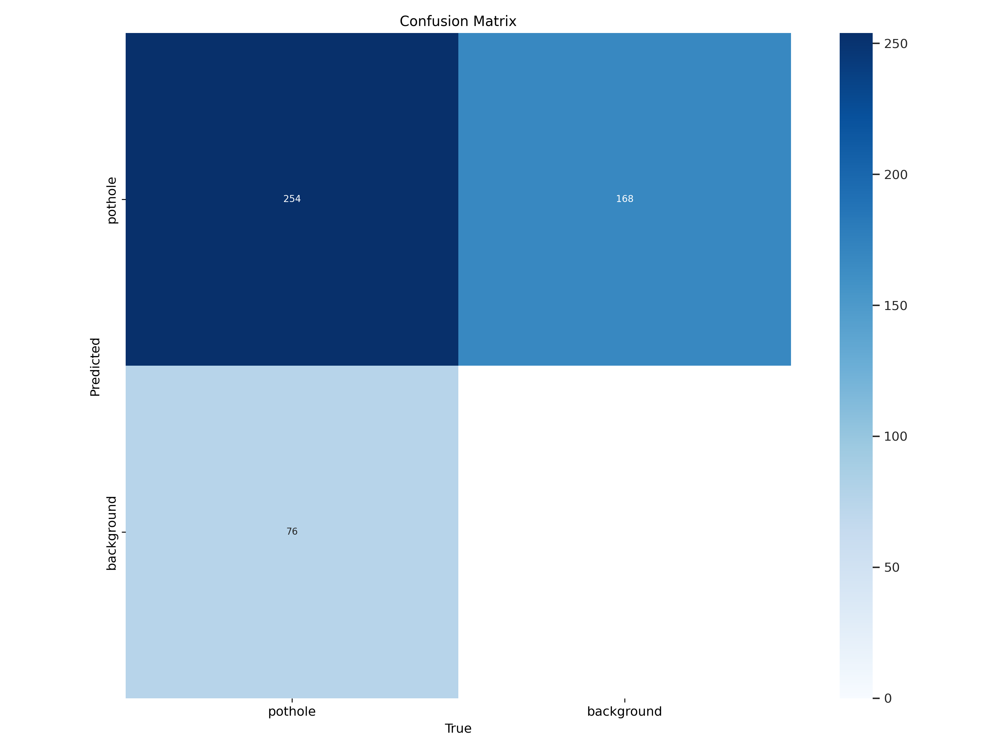

In [ ]:
Image(filename=f'/content/runs/detect/yolov8n_aug_ft1/confusion_matrix.png', width=600)

In [ ]:
metrics_v8 = '/content/runs/detect/yolov8n_aug_ft1/results.csv'

In [ ]:
results_v8 = model_aug_v8.val(name="test_yolov8n_aug_ft1",split='test')

Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/yolov8-dataset/test/labels.cache... 67 images, 0 backgrounds, 0 corrupt: 100%|██████████| 67/67 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.54it/s]


                   all         67        154      0.787      0.721      0.791      0.436
Speed: 0.2ms preprocess, 15.0ms inference, 0.0ms loss, 4.5ms postprocess per image
Results saved to runs/detect/test_yolov8n_aug_ft1


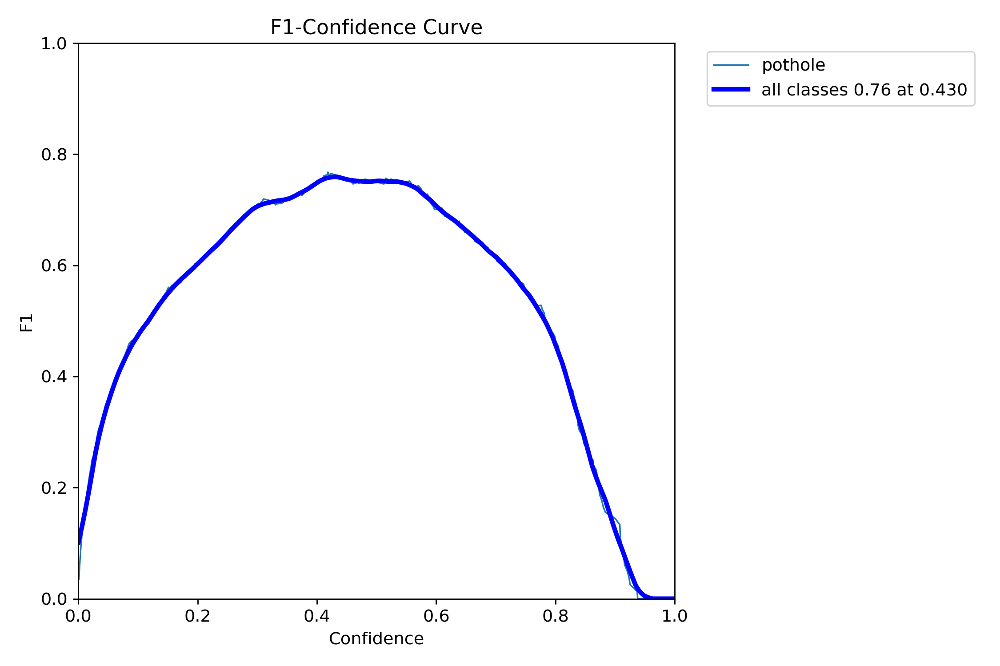

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov8n_aug_ft1/F1_curve.png', width=600)

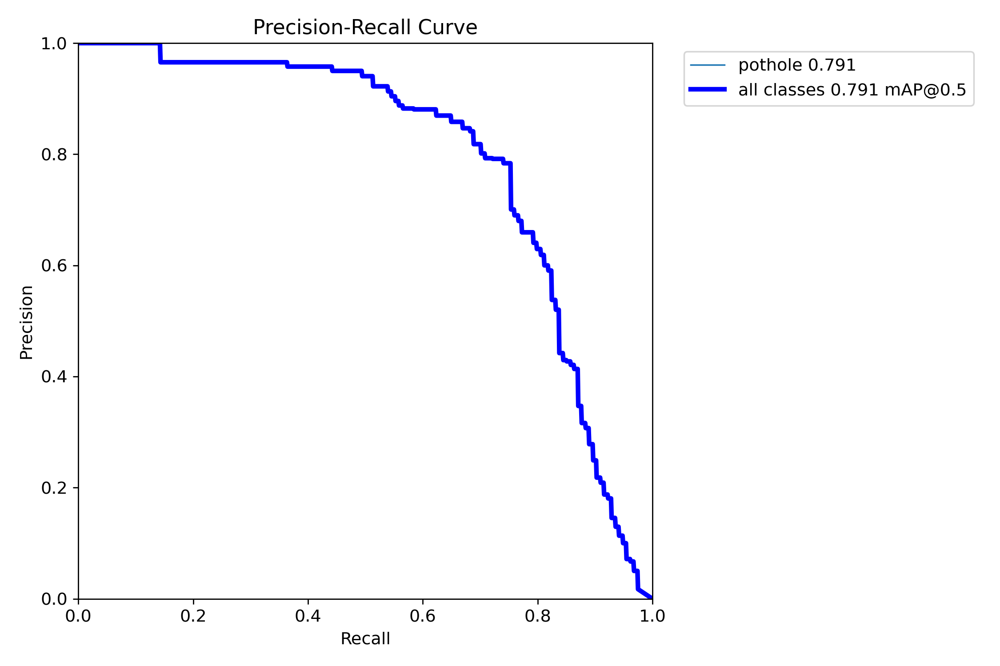

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov8n_aug_ft1/PR_curve.png', width=600)

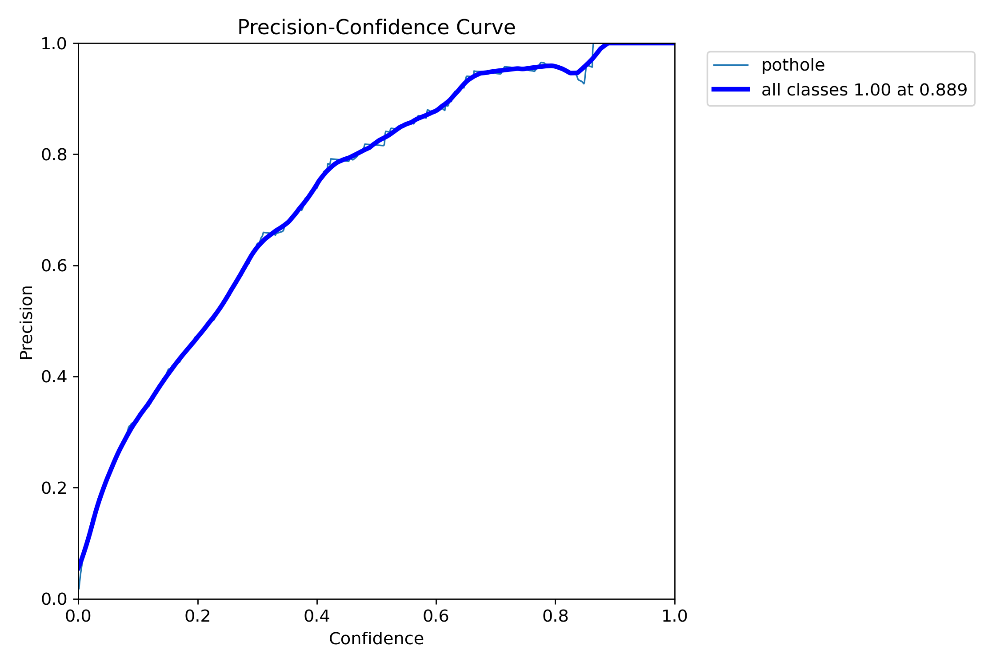

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov8n_aug_ft1/P_curve.png', width=600)

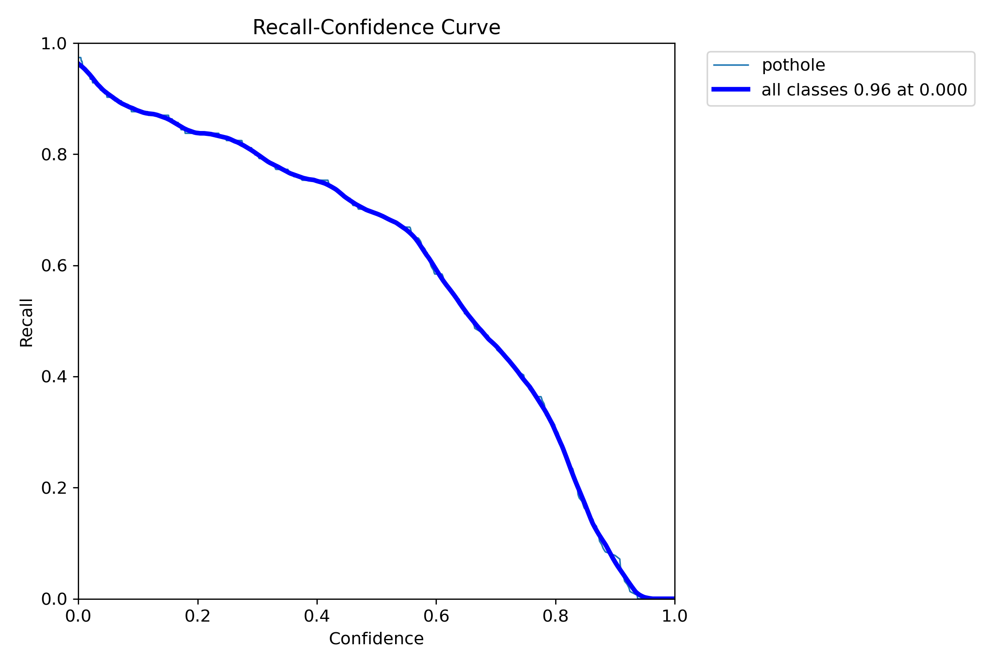

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov8n_aug_ft1/R_curve.png', width=600)

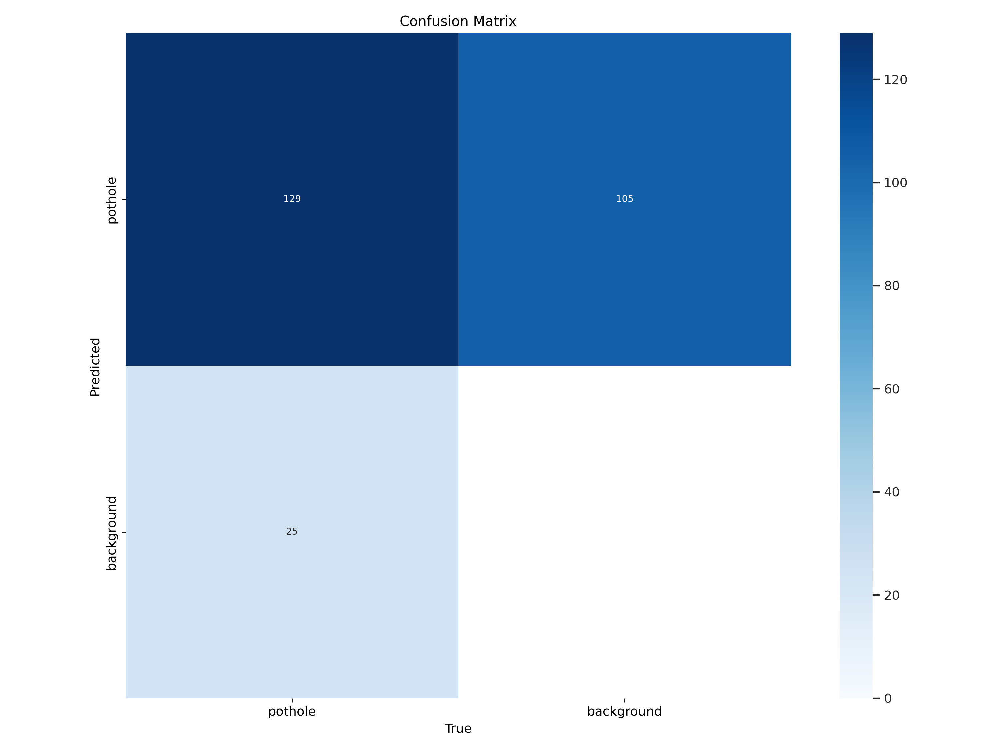

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov8n_aug_ft1/confusion_matrix.png', width=600)

In [ ]:
model_aug_v8.export(format='tflite')

Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.00GHz)

PyTorch: starting from 'runs/detect/yolov8n_aug_ft1/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (5.9 MB)

TensorFlow SavedModel: starting export with tensorflow 2.17.1...

ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.45...
ONNX: export success ✅ 1.2s, saved as 'runs/detect/yolov8n_aug_ft1/weights/best.onnx' (11.8 MB)
TensorFlow SavedModel: starting TFLite export with onnx2tf 1.26.3...
TensorFlow SavedModel: export success ✅ 25.4s, saved as 'runs/detect/yolov8n_aug_ft1/weights/best_saved_model' (30.0 MB)

TensorFlow Lite: starting export with tensorflow 2.17.1...
TensorFlow Lite: export success ✅ 0.0s, saved as 'runs/detect/yolov8n_aug_ft1/weights/best_saved_model/best_float32.tflite' (11.7 MB)

Export complete (25.8s)
Results saved to /content/runs/detect/yolov8n_aug_ft1/weights
Predict:         yolo predict task=detect mode

'runs/detect/yolov8n_aug_ft1/weights/best_saved_model/best_float32.tflite'

#### YOLOv10

In [ ]:
print("Training YOLOv10...")
model_aug_v10.train(data=os.path.join(dataset_yolov8.location, 'data.yaml'),name="yolov10n_aug_ft1", epochs=epochs, batch=batch_size, imgsz=imgsz,
                  augment=True,
                   fliplr= 0.5,           # Horizontal flip with 50% probability
                   flipud= 0.1,           # Vertical flip with 10% probability
                   scale= 0.3,            # Scale images ±30%
                   translate= 0.2,        # Translate images ±20%
                   hsv_h=0.015,          # HSV hue adjustment ±1.5%
                   hsv_s=0.7,            # HSV saturation adjustment 70%
                   hsv_v=0.4,            # HSV value (brightness) adjustment 40%
                   degrees=10.0,         # Random rotation ±10 degrees
                   shear= 5.0,            # Shear transformations ±5 degrees
                   perspective=0.001,    # Small perspective distortion
                   mosaic= 1.0,           # Enable mosaic augmentation
                   mixup=0.2             # Enable mixup with 20% probability
)

Training YOLOv10...
Ultralytics 8.3.58 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov10n.pt, data=/content/yolov8-dataset/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov10n_aug_ft1, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_l

train: Scanning /content/yolov8-dataset/train/labels.cache... 465 images, 0 backgrounds, 0 corrupt: 100%|██████████| 465/465 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/yolov8-dataset/valid/labels.cache... 133 images, 0 backgrounds, 0 corrupt: 100%|██████████| 133/133 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov10n_aug_ft1/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 95 weight(decay=0.0), 108 weight(decay=0.0005), 107 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolov10n_aug_ft1
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.47G      4.113      8.462      3.988          0        640: 100%|██████████| 30/30 [00:06<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.33it/s]

                   all        133        330    0.00173      0.209    0.00498    0.00168



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      2.49G      3.933      7.008      3.706          1        640: 100%|██████████| 30/30 [00:06<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.97it/s]

                   all        133        330     0.0425     0.0273     0.0136    0.00582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.49G      4.041      6.237       3.78          2        640: 100%|██████████| 30/30 [00:06<00:00,  4.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.41it/s]

                   all        133        330    0.00148      0.179    0.00156   0.000484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.49G      4.034      5.795        3.7          5        640: 100%|██████████| 30/30 [00:05<00:00,  5.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.30it/s]

                   all        133        330     0.0655     0.0242    0.00957     0.0027



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.51G      3.975      5.476       3.66          9        640: 100%|██████████| 30/30 [00:06<00:00,  4.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.98it/s]

                   all        133        330      0.137      0.106     0.0459     0.0169



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.48G      3.909      5.196      3.621          5        640: 100%|██████████| 30/30 [00:05<00:00,  5.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.27it/s]

                   all        133        330      0.285      0.233      0.165     0.0541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      2.48G      3.835      5.103      3.545          8        640: 100%|██████████| 30/30 [00:05<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.85it/s]

                   all        133        330        0.3      0.309      0.212     0.0745



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.48G      3.815      4.926      3.507          2        640: 100%|██████████| 30/30 [00:06<00:00,  4.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.09it/s]

                   all        133        330      0.185      0.233      0.143     0.0503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.49G       3.66      4.825      3.395         16        640: 100%|██████████| 30/30 [00:05<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.02it/s]

                   all        133        330      0.351      0.382      0.311      0.129



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.51G      3.712      4.583      3.454          4        640: 100%|██████████| 30/30 [00:05<00:00,  5.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.95it/s]

                   all        133        330       0.48      0.369       0.37      0.143



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.53G      3.769      4.547      3.492          1        640: 100%|██████████| 30/30 [00:05<00:00,  5.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.10it/s]

                   all        133        330      0.448      0.321      0.303      0.115



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.48G      3.657      4.443      3.442          6        640: 100%|██████████| 30/30 [00:05<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.12it/s]

                   all        133        330      0.524      0.416      0.403      0.159



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.53G      3.618        4.4      3.357          3        640: 100%|██████████| 30/30 [00:05<00:00,  5.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.91it/s]

                   all        133        330      0.546      0.318        0.4      0.152



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.49G       3.68      4.396      3.369         12        640: 100%|██████████| 30/30 [00:05<00:00,  5.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.38it/s]

                   all        133        330      0.429      0.445      0.409      0.162



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.47G      3.594      4.238      3.326          6        640: 100%|██████████| 30/30 [00:05<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.16it/s]

                   all        133        330      0.518       0.47      0.459      0.198



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.53G      3.575      4.194      3.298         10        640: 100%|██████████| 30/30 [00:05<00:00,  5.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.86it/s]

                   all        133        330      0.509      0.415      0.408       0.18



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.46G      3.625      4.239      3.347          1        640: 100%|██████████| 30/30 [00:05<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.24it/s]

                   all        133        330      0.541      0.428      0.462      0.215



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.48G      3.521      4.196      3.335          2        640: 100%|██████████| 30/30 [00:05<00:00,  5.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.94it/s]

                   all        133        330      0.433      0.467      0.414      0.153



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.48G      3.556       4.17       3.29         14        640: 100%|██████████| 30/30 [00:06<00:00,  4.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.92it/s]

                   all        133        330      0.523      0.509      0.499       0.22



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50       2.5G      3.581      4.124      3.284          2        640: 100%|██████████| 30/30 [00:05<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.27it/s]

                   all        133        330      0.537      0.458      0.478      0.201



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      2.47G      3.501       3.94      3.266          6        640: 100%|██████████| 30/30 [00:05<00:00,  5.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.87it/s]

                   all        133        330       0.55       0.47      0.504      0.211



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.48G      3.519      4.016       3.31          3        640: 100%|██████████| 30/30 [00:06<00:00,  4.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.25it/s]

                   all        133        330      0.482      0.503      0.463       0.19



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.49G      3.474      3.861      3.198         10        640: 100%|██████████| 30/30 [00:05<00:00,  5.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.16it/s]

                   all        133        330      0.514      0.455      0.482      0.231



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.58G      3.499      3.838       3.21          4        640: 100%|██████████| 30/30 [00:06<00:00,  4.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.07it/s]

                   all        133        330      0.502      0.494      0.478      0.165



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.49G       3.51      3.995      3.238          1        640: 100%|██████████| 30/30 [00:05<00:00,  5.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.20it/s]

                   all        133        330       0.54      0.467      0.497       0.23



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      2.48G       3.41      3.834      3.239          5        640: 100%|██████████| 30/30 [00:05<00:00,  5.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.98it/s]

                   all        133        330      0.487      0.455      0.469      0.212



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      2.47G      3.456      3.884      3.223          1        640: 100%|██████████| 30/30 [00:06<00:00,  4.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.82it/s]

                   all        133        330      0.596      0.533       0.57      0.267



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.49G      3.425      3.761      3.161          5        640: 100%|██████████| 30/30 [00:05<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.38it/s]

                   all        133        330      0.591      0.482      0.529      0.216



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.46G      3.389      3.766      3.172          3        640: 100%|██████████| 30/30 [00:05<00:00,  5.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.84it/s]

                   all        133        330      0.529      0.482      0.488      0.233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.47G      3.446       3.74      3.212          4        640: 100%|██████████| 30/30 [00:06<00:00,  4.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.29it/s]

                   all        133        330      0.555      0.524      0.528      0.231



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      2.49G      3.368      3.665      3.139          5        640: 100%|██████████| 30/30 [00:05<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.38it/s]

                   all        133        330      0.571      0.539      0.548      0.268



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      2.46G      3.267      3.577      3.074          3        640: 100%|██████████| 30/30 [00:05<00:00,  5.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.97it/s]

                   all        133        330      0.655      0.491      0.551      0.266



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.51G      3.355      3.709      3.144          8        640: 100%|██████████| 30/30 [00:05<00:00,  5.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.38it/s]

                   all        133        330      0.583      0.497      0.513      0.241



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      2.48G      3.295      3.597      3.099         15        640: 100%|██████████| 30/30 [00:05<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.04it/s]

                   all        133        330      0.605      0.533      0.568      0.264



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      2.51G      3.314      3.528      3.112          3        640: 100%|██████████| 30/30 [00:05<00:00,  5.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.23it/s]

                   all        133        330      0.603       0.58      0.587      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.48G      3.359      3.541      3.105          4        640: 100%|██████████| 30/30 [00:05<00:00,  5.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.16it/s]

                   all        133        330       0.62      0.579      0.597      0.274



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      2.49G      3.319      3.591      3.146          2        640: 100%|██████████| 30/30 [00:05<00:00,  5.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.29it/s]

                   all        133        330      0.599      0.603      0.614      0.306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.52G      3.277      3.461      3.101          3        640: 100%|██████████| 30/30 [00:06<00:00,  4.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.27it/s]

                   all        133        330      0.703      0.539      0.613      0.288



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50       2.5G      3.276      3.462       3.12          2        640: 100%|██████████| 30/30 [00:05<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.36it/s]

                   all        133        330      0.673      0.555      0.602      0.296



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      2.55G       3.14      3.772      2.959          0        640: 100%|██████████| 30/30 [00:05<00:00,  5.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.08it/s]

                   all        133        330      0.613      0.555      0.597      0.293


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      2.48G      2.996      3.125      2.836          2        640: 100%|██████████| 30/30 [00:06<00:00,  4.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.19it/s]

                   all        133        330      0.681      0.518      0.604      0.309



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      2.49G      2.821      2.746        2.8          1        640: 100%|██████████| 30/30 [00:05<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.11it/s]

                   all        133        330      0.697      0.552      0.628      0.313



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      2.45G       2.83      2.661       2.75          3        640: 100%|██████████| 30/30 [00:05<00:00,  5.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.05it/s]

                   all        133        330      0.699      0.533      0.619        0.3



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      2.49G      2.868      2.708      2.869          1        640: 100%|██████████| 30/30 [00:05<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.06it/s]

                   all        133        330      0.645      0.573      0.639      0.342



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      2.48G      2.844      2.429      2.755          1        640: 100%|██████████| 30/30 [00:05<00:00,  5.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.77it/s]

                   all        133        330      0.636      0.597      0.637      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      2.46G      2.769       2.45      2.723          4        640: 100%|██████████| 30/30 [00:06<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.13it/s]

                   all        133        330      0.683      0.579      0.659      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      2.49G      2.765      2.409      2.713          1        640: 100%|██████████| 30/30 [00:05<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.02it/s]

                   all        133        330      0.685      0.585      0.663      0.353



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      2.46G      2.771      2.397      2.704          2        640: 100%|██████████| 30/30 [00:06<00:00,  4.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.02it/s]

                   all        133        330      0.684      0.577      0.654       0.36



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      2.48G      2.778      2.347      2.724          5        640: 100%|██████████| 30/30 [00:05<00:00,  5.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.13it/s]

                   all        133        330      0.647      0.612      0.648      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      2.48G      2.705      2.301      2.668          1        640: 100%|██████████| 30/30 [00:05<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.89it/s]

                   all        133        330      0.667      0.609      0.655      0.352



50 epochs completed in 0.116 hours.
Optimizer stripped from runs/detect/yolov10n_aug_ft1/weights/last.pt, 5.7MB
Optimizer stripped from runs/detect/yolov10n_aug_ft1/weights/best.pt, 5.7MB

Validating runs/detect/yolov10n_aug_ft1/weights/best.pt...
Ultralytics 8.3.58 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv10n summary (fused): 285 layers, 2,694,806 parameters, 0 gradients, 8.2 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/5 [00:00<?, ?it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  20%|██        | 1/5 [00:00<00:00,  5.36it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  40%|████      | 2/5 [00:00<00:00,  4.27it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  60%|██████    | 3/5 [00:01<00:00,  2.20it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  80%|████████  | 4/5 [00:01<00:00,  2.67it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.41it/s]


                   all        133        330       0.68      0.576      0.654      0.359
Speed: 0.2ms preprocess, 5.0ms inference, 0.0ms loss, 0.2ms postprocess per image
Results saved to runs/detect/yolov10n_aug_ft1


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x78e028f961d0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

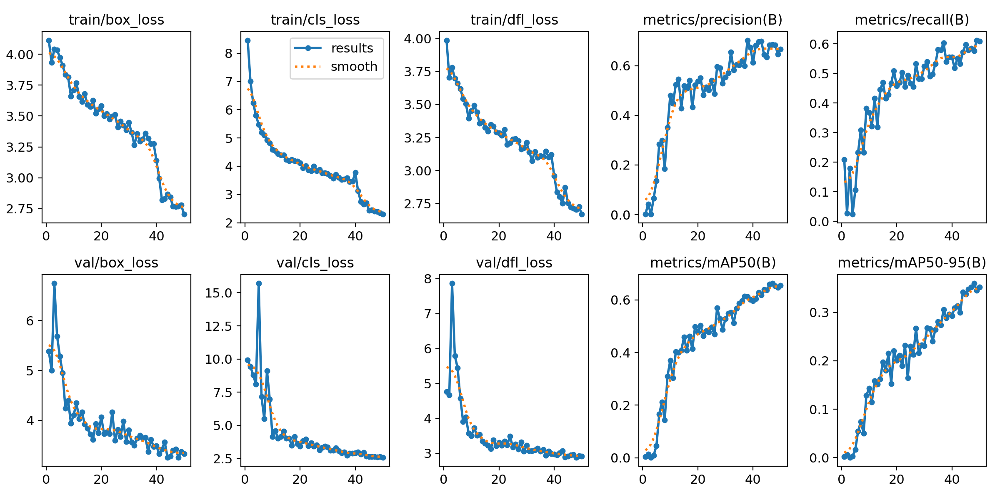

In [ ]:
Image(filename=f'/content/runs/detect/yolov10n_aug_ft1/results.png', width=600)

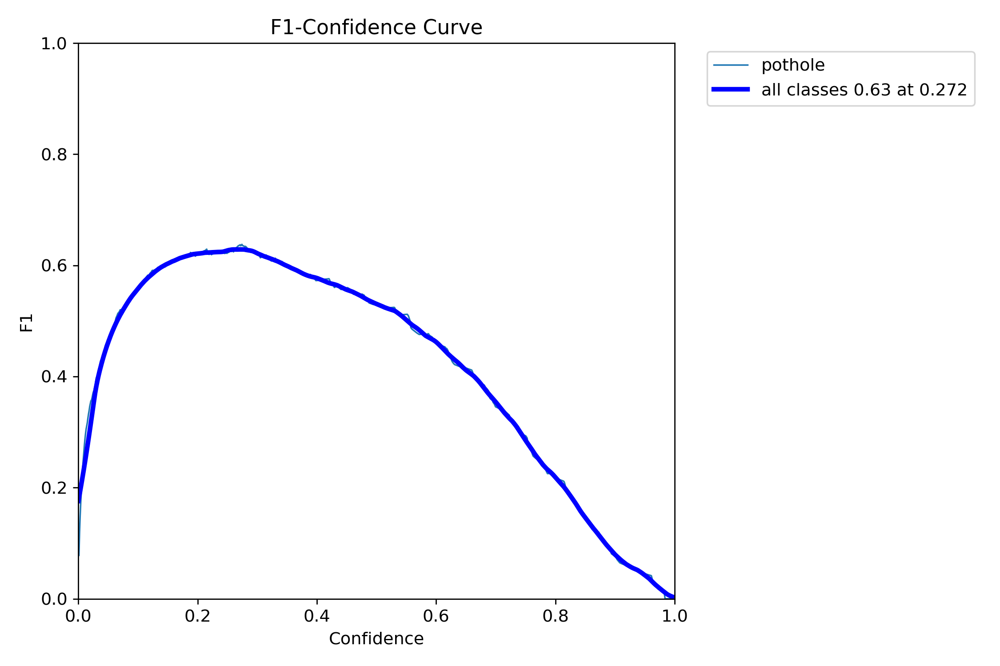

In [ ]:
Image(filename=f'/content/runs/detect/yolov10n_aug_ft1/F1_curve.png', width=600)

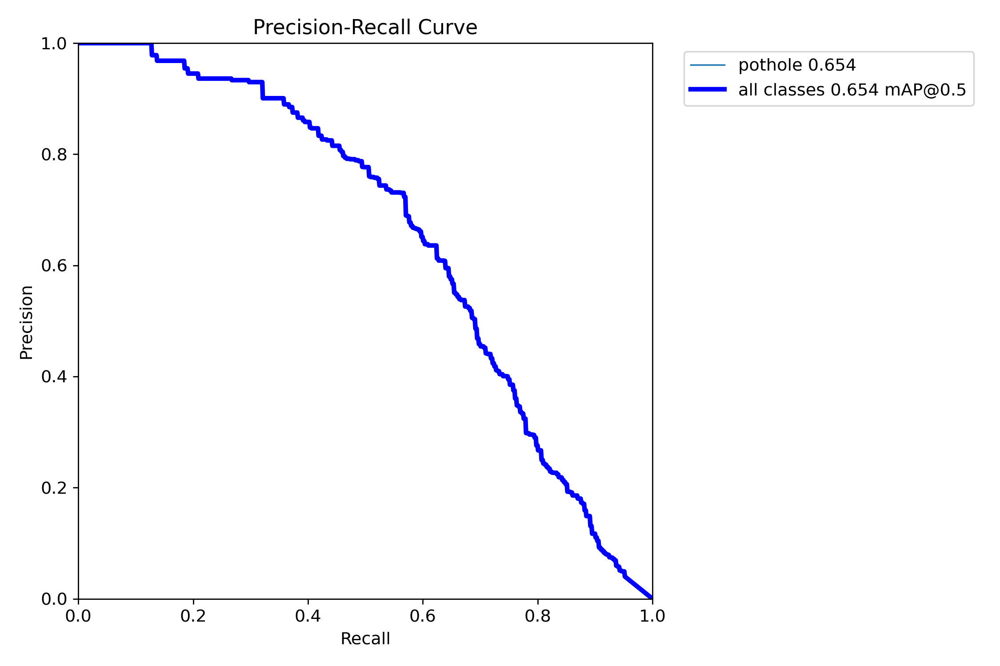

In [ ]:
Image(filename=f'/content/runs/detect/yolov10n_aug_ft1/PR_curve.png', width=600)

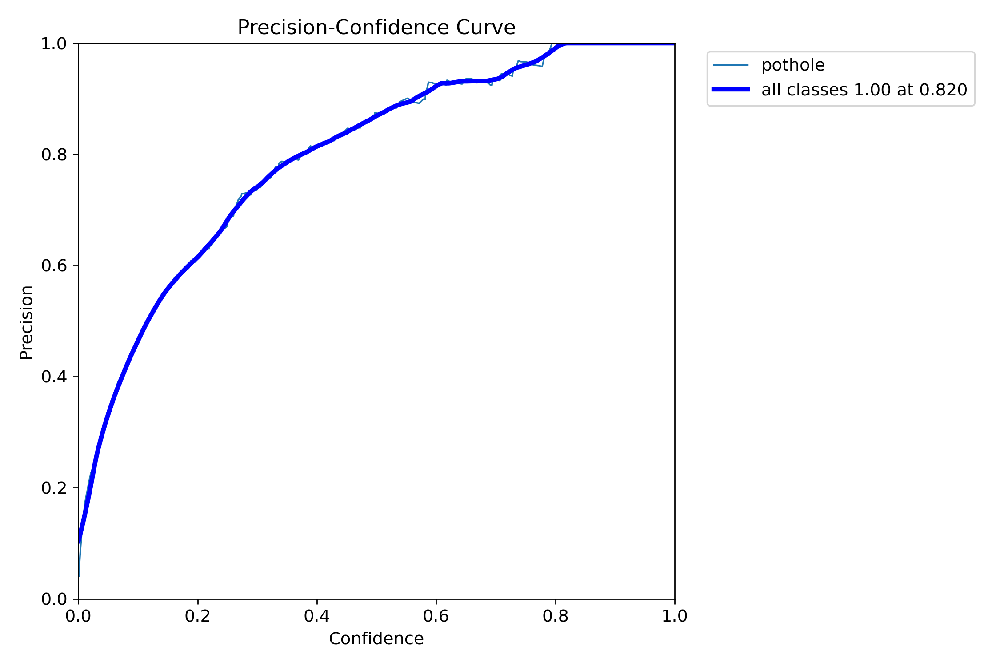

In [ ]:
Image(filename=f'/content/runs/detect/yolov10n_aug_ft1/P_curve.png', width=600)

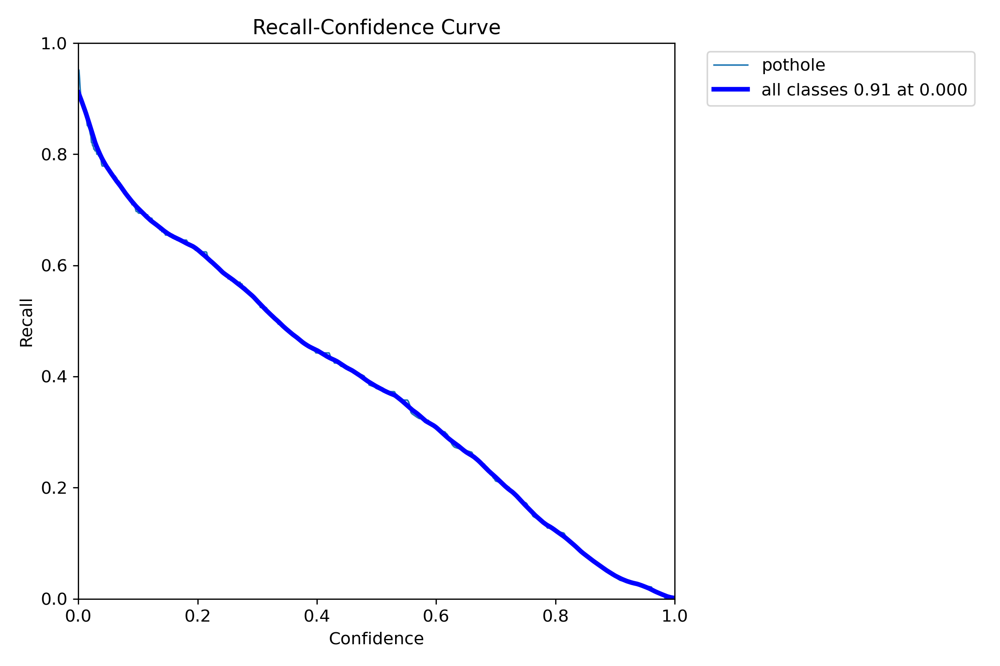

In [ ]:
Image(filename=f'/content/runs/detect/yolov10n_aug_ft1/R_curve.png', width=600)

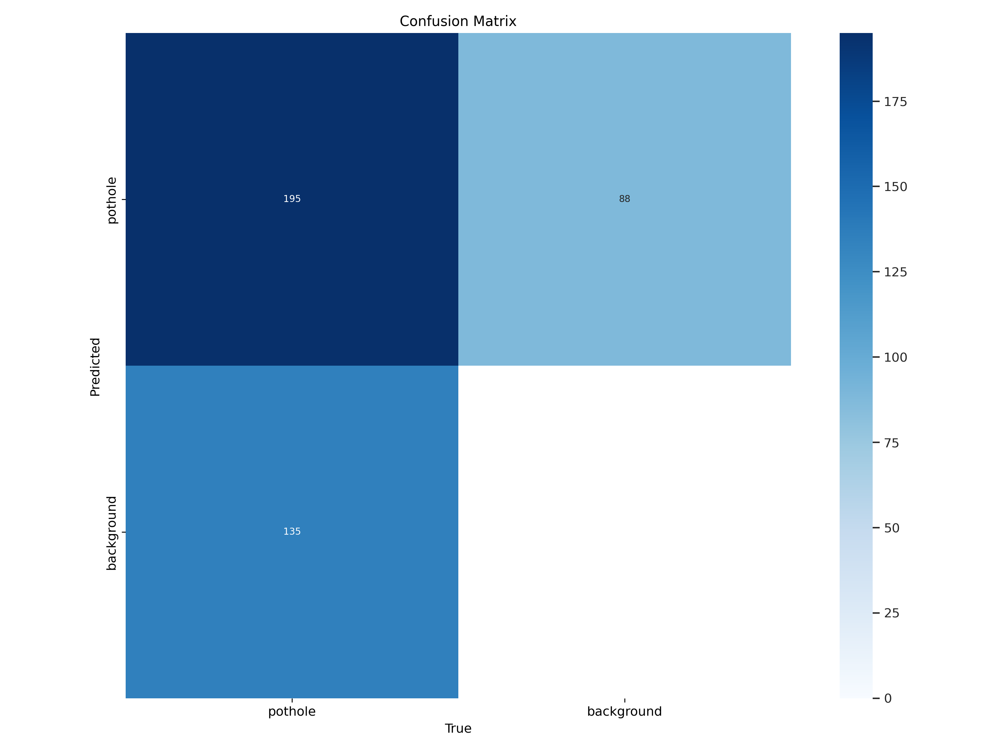

In [ ]:
Image(filename=f'/content/runs/detect/yolov10n_aug_ft1/confusion_matrix.png', width=600)

In [ ]:
metrics_v10 = '/content/runs/detect/yolov10n_aug_ft1/results.csv'

In [ ]:
results_v10 = model_aug_v10.val(name="test_yolov10n_aug_ft1",split='test')

Ultralytics 8.3.58 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv10n summary (fused): 285 layers, 2,694,806 parameters, 0 gradients, 8.2 GFLOPs


val: Scanning /content/yolov8-dataset/test/labels.cache... 67 images, 0 backgrounds, 0 corrupt: 100%|██████████| 67/67 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/5 [00:00<?, ?it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  20%|██        | 1/5 [00:00<00:01,  2.53it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  40%|████      | 2/5 [00:00<00:01,  2.55it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  60%|██████    | 3/5 [00:01<00:00,  2.59it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  80%|████████  | 4/5 [00:01<00:00,  3.23it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.37it/s]


                   all         67        154      0.668      0.649      0.692      0.374
Speed: 0.2ms preprocess, 8.5ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to runs/detect/test_yolov10n_aug_ft1


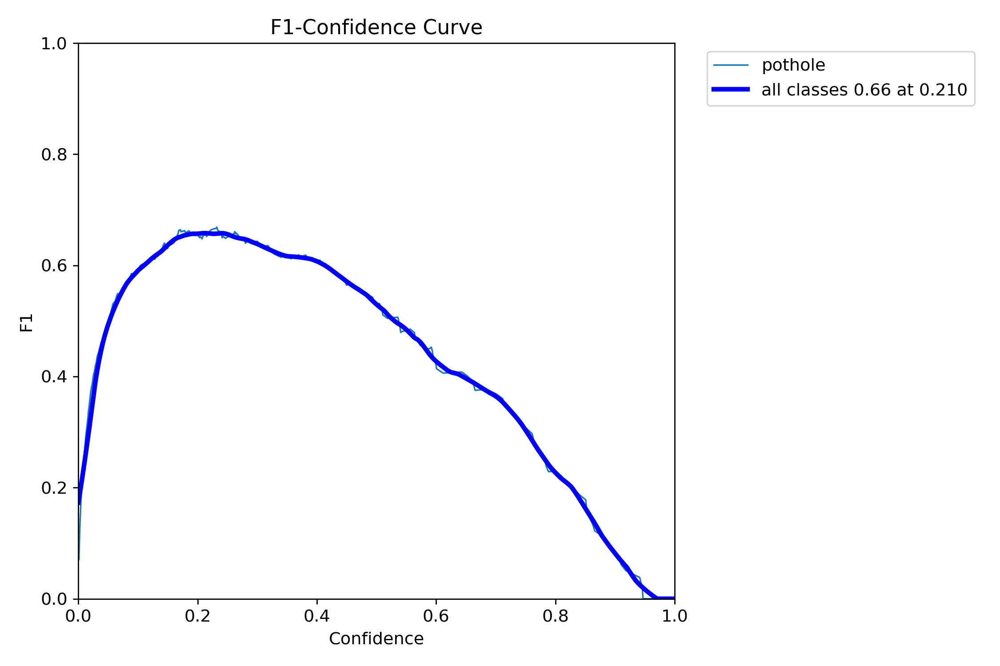

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov10n_aug_ft1/F1_curve.png', width=600)

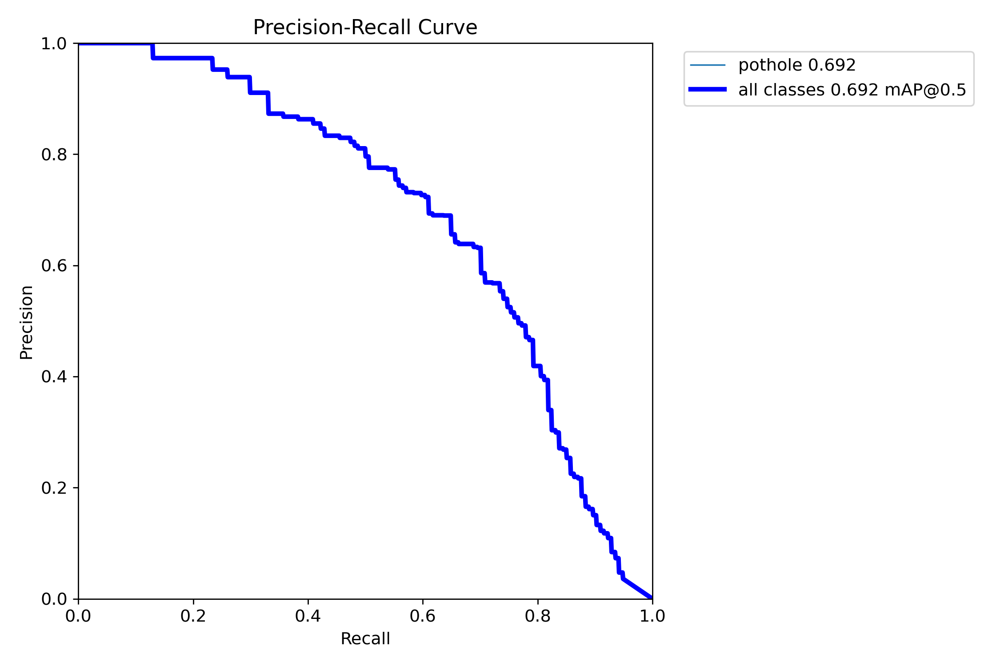

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov10n_aug_ft1/PR_curve.png', width=600)

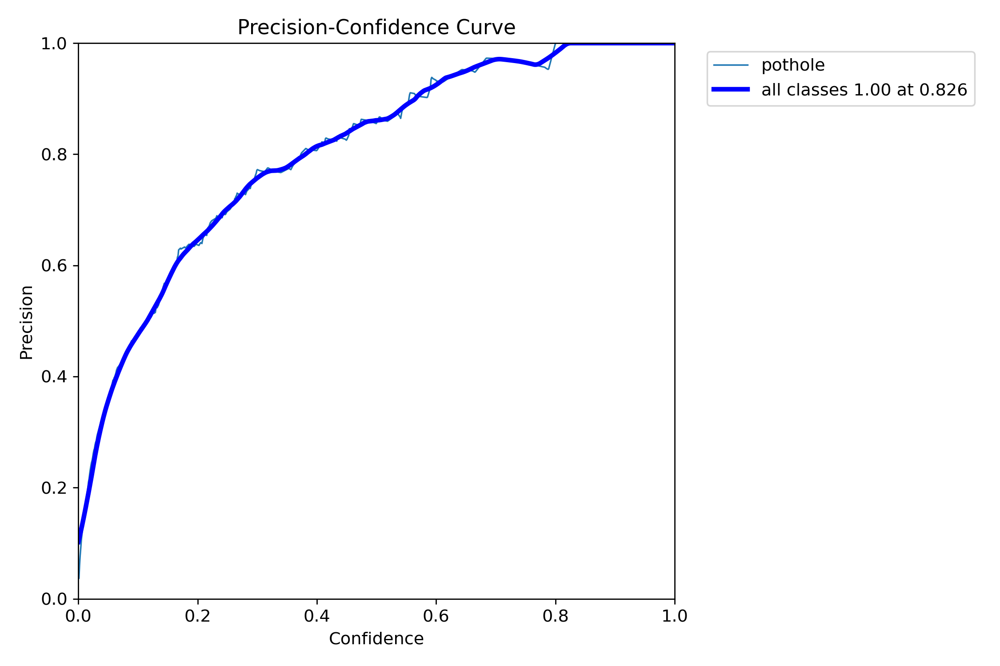

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov10n_aug_ft1/P_curve.png', width=600)

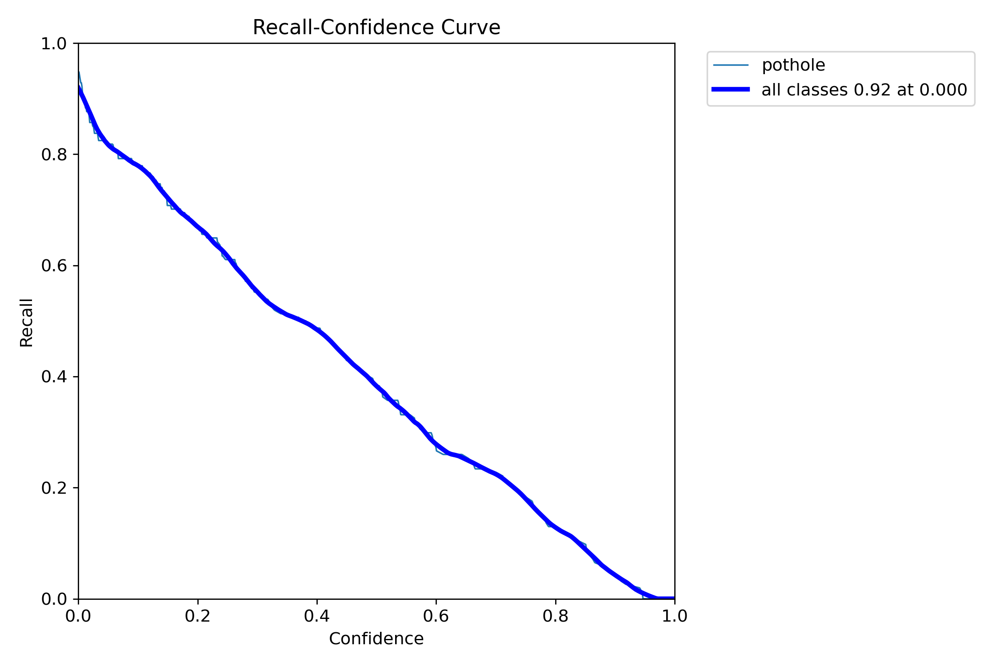

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov10n_aug_ft1/R_curve.png', width=600)

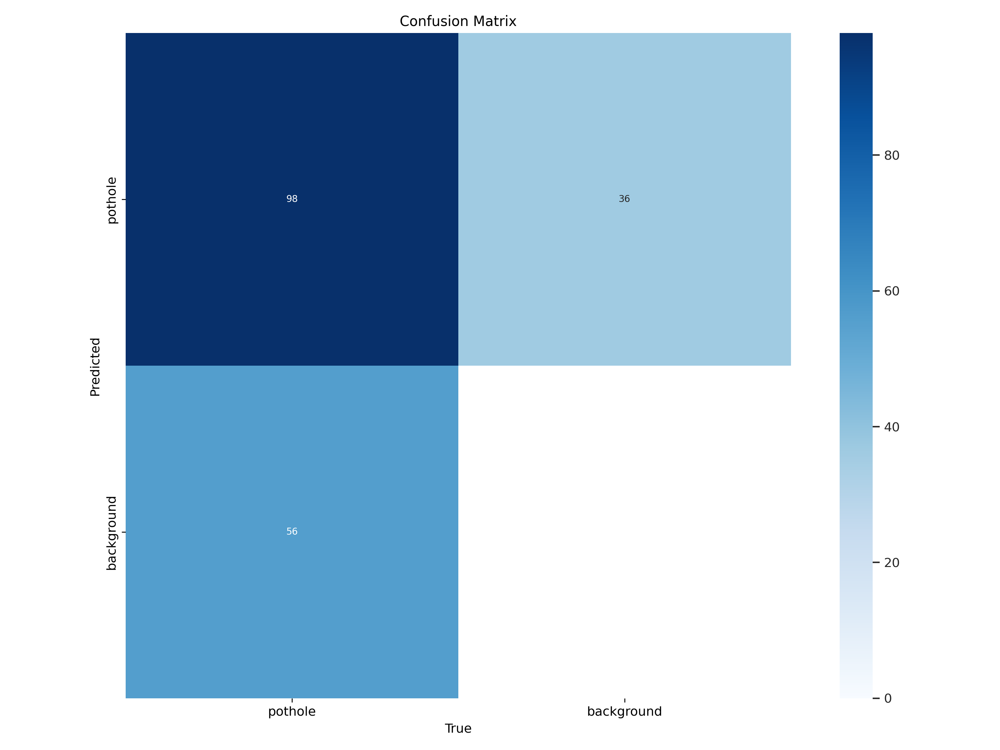

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov10n_aug_ft1/confusion_matrix.png', width=600)

In [ ]:
model_aug_v10.export(format='tflite')

Ultralytics 8.3.58 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.00GHz)

PyTorch: starting from 'runs/detect/yolov10n_aug_ft1/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 300, 6) (5.5 MB)

TensorFlow SavedModel: starting export with tensorflow 2.17.1...

ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.46...
ONNX: export success ✅ 2.2s, saved as 'runs/detect/yolov10n_aug_ft1/weights/best.onnx' (9.0 MB)
TensorFlow SavedModel: starting TFLite export with onnx2tf 1.26.3...
TensorFlow SavedModel: export success ✅ 35.3s, saved as 'runs/detect/yolov10n_aug_ft1/weights/best_saved_model' (23.6 MB)

TensorFlow Lite: starting export with tensorflow 2.17.1...
TensorFlow Lite: export success ✅ 0.0s, saved as 'runs/detect/yolov10n_aug_ft1/weights/best_saved_model/best_float32.tflite' (9.0 MB)

Export complete (35.7s)
Results saved to /content/runs/detect/yolov10n_aug_ft1/weights
Predict:         yolo predict task=detect mo

'runs/detect/yolov10n_aug_ft1/weights/best_saved_model/best_float32.tflite'

#### YOLOv11

In [ ]:
print("Training YOLOv11...")
model_aug_v11.train(data=os.path.join(dataset_yolov11.location, 'data.yaml'),name="yolov11n_aug_ft1", epochs=epochs, batch=batch_size, imgsz=imgsz,
                  augment=True,
                   fliplr= 0.5,           # Horizontal flip with 50% probability
                   flipud= 0.1,           # Vertical flip with 10% probability
                   scale= 0.3,            # Scale images ±30%
                   translate= 0.2,        # Translate images ±20%
                   hsv_h=0.015,          # HSV hue adjustment ±1.5%
                   hsv_s=0.7,            # HSV saturation adjustment 70%
                   hsv_v=0.4,            # HSV value (brightness) adjustment 40%
                   degrees=10.0,         # Random rotation ±10 degrees
                   shear= 5.0,            # Shear transformations ±5 degrees
                   perspective=0.001,    # Small perspective distortion
                   mosaic= 1.0,           # Enable mosaic augmentation
                   mixup=0.2             # Enable mixup with 20% probability
)

Training YOLOv11...
Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/yolov11-dataset/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov11n_aug_ft1, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_l

train: Scanning /content/yolov11-dataset/train/labels... 465 images, 0 backgrounds, 0 corrupt: 100%|██████████| 465/465 [00:00<00:00, 1165.16it/s]


train: New cache created: /content/yolov11-dataset/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/yolov11-dataset/valid/labels... 133 images, 0 backgrounds, 0 corrupt: 100%|██████████| 133/133 [00:00<00:00, 1230.66it/s]

val: New cache created: /content/yolov11-dataset/valid/labels.cache


Plotting labels to runs/detect/yolov11n_aug_ft1/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolov11n_aug_ft1
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.16G      2.244      3.507      2.112          0        640: 100%|██████████| 30/30 [00:05<00:00,  5.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.38it/s]


                   all        133        330    0.00258      0.312    0.00228   0.000664

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      2.14G      2.132      2.986      2.001          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.28it/s]

                   all        133        330    0.00401      0.485    0.00609    0.00148



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.14G      2.118      2.636      2.019          2        640: 100%|██████████| 30/30 [00:04<00:00,  6.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.69it/s]

                   all        133        330    0.00118    0.00303   0.000427   0.000106



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.14G      2.136      2.527      1.987          5        640: 100%|██████████| 30/30 [00:04<00:00,  6.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.14it/s]

                   all        133        330        0.2      0.179      0.106     0.0368



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.15G      2.099      2.358      1.967          9        640: 100%|██████████| 30/30 [00:04<00:00,  6.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.92it/s]

                   all        133        330      0.199      0.236      0.118     0.0407



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.13G      2.033      2.276      1.937          5        640: 100%|██████████| 30/30 [00:04<00:00,  6.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.44it/s]

                   all        133        330      0.353      0.336      0.259     0.0896



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      2.13G      1.971      2.241      1.885          8        640: 100%|██████████| 30/30 [00:04<00:00,  6.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.23it/s]

                   all        133        330      0.275      0.279      0.203     0.0772



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.13G      1.934      2.152      1.849          2        640: 100%|██████████| 30/30 [00:04<00:00,  6.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.42it/s]

                   all        133        330      0.434      0.373      0.335      0.116



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50       2.2G        1.9      2.123       1.82         16        640: 100%|██████████| 30/30 [00:04<00:00,  6.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.58it/s]

                   all        133        330      0.546      0.409      0.431      0.182



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.14G      1.907       2.05      1.825          4        640: 100%|██████████| 30/30 [00:04<00:00,  6.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.33it/s]

                   all        133        330      0.527      0.467      0.481      0.162



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50       2.1G      1.933      2.076      1.866          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.69it/s]

                   all        133        330      0.521      0.379      0.397      0.152



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.13G      1.854       1.98      1.809          6        640: 100%|██████████| 30/30 [00:04<00:00,  6.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.88it/s]

                   all        133        330      0.444      0.436      0.379      0.139



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50       2.1G      1.854      1.933       1.77          3        640: 100%|██████████| 30/30 [00:04<00:00,  6.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.63it/s]

                   all        133        330      0.562      0.467      0.501      0.189



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50       2.2G      1.877      1.952      1.789         12        640: 100%|██████████| 30/30 [00:04<00:00,  6.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.24it/s]

                   all        133        330       0.58      0.458      0.477      0.192



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.19G      1.839      1.861       1.77          6        640: 100%|██████████| 30/30 [00:04<00:00,  6.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.37it/s]

                   all        133        330      0.594       0.46       0.51      0.233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.14G      1.834      1.884      1.742         10        640: 100%|██████████| 30/30 [00:04<00:00,  6.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.98it/s]

                   all        133        330      0.676      0.515       0.56      0.258



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.17G      1.828      1.957      1.745          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.20it/s]

                   all        133        330      0.672      0.524      0.563      0.245



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.12G       1.77      1.874      1.721          2        640: 100%|██████████| 30/30 [00:04<00:00,  6.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.28it/s]

                   all        133        330      0.651      0.485      0.524      0.198



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.14G      1.812       1.84      1.727         14        640: 100%|██████████| 30/30 [00:04<00:00,  6.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.53it/s]

                   all        133        330      0.629      0.473      0.519      0.211



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.14G      1.756      1.801      1.705          2        640: 100%|██████████| 30/30 [00:04<00:00,  6.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.78it/s]

                   all        133        330      0.607      0.518      0.531      0.218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      2.13G      1.751      1.766      1.685          6        640: 100%|██████████| 30/30 [00:04<00:00,  6.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.05it/s]

                   all        133        330      0.692        0.5      0.586      0.259



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.13G      1.767      1.762      1.706          3        640: 100%|██████████| 30/30 [00:04<00:00,  6.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.66it/s]

                   all        133        330      0.633      0.582      0.608      0.291



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.14G       1.76      1.689      1.657         10        640: 100%|██████████| 30/30 [00:04<00:00,  6.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.81it/s]

                   all        133        330      0.746      0.512      0.629      0.278



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.23G      1.751      1.675      1.669          4        640: 100%|██████████| 30/30 [00:04<00:00,  6.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.89it/s]

                   all        133        330      0.644      0.527      0.556      0.208



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.14G      1.761      1.741      1.694          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.46it/s]

                   all        133        330      0.559      0.548      0.537      0.251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      2.13G      1.742      1.701      1.689          5        640: 100%|██████████| 30/30 [00:04<00:00,  6.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.56it/s]

                   all        133        330       0.77      0.524      0.639      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      2.19G      1.759      1.757      1.699          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.41it/s]

                   all        133        330      0.701      0.545      0.626      0.277



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.13G      1.733      1.667      1.655          5        640: 100%|██████████| 30/30 [00:04<00:00,  6.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.88it/s]

                   all        133        330      0.668       0.57      0.645      0.291



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.18G      1.679       1.68      1.652          3        640: 100%|██████████| 30/30 [00:04<00:00,  6.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.47it/s]

                   all        133        330      0.746       0.56      0.657      0.299



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.12G      1.715      1.673      1.661          4        640: 100%|██████████| 30/30 [00:04<00:00,  6.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.44it/s]

                   all        133        330       0.66      0.558      0.607      0.247



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      2.14G      1.688      1.619      1.619          5        640: 100%|██████████| 30/30 [00:04<00:00,  6.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.05it/s]

                   all        133        330      0.642      0.591      0.632      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      2.12G      1.642      1.591      1.592          3        640: 100%|██████████| 30/30 [00:04<00:00,  6.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.73it/s]

                   all        133        330      0.686      0.591       0.65       0.32



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.15G      1.697      1.642      1.631          8        640: 100%|██████████| 30/30 [00:04<00:00,  6.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.39it/s]

                   all        133        330      0.742      0.555      0.662      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      2.13G      1.645      1.588      1.596         15        640: 100%|██████████| 30/30 [00:04<00:00,  6.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.78it/s]

                   all        133        330      0.783      0.594      0.683      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      2.16G      1.658      1.565      1.594          3        640: 100%|██████████| 30/30 [00:04<00:00,  6.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.66it/s]

                   all        133        330      0.724      0.615      0.703       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.21G      1.678       1.56      1.601          4        640: 100%|██████████| 30/30 [00:04<00:00,  6.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.45it/s]

                   all        133        330       0.71      0.585      0.669      0.307



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      2.14G      1.704      1.615      1.636          2        640: 100%|██████████| 30/30 [00:04<00:00,  6.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.50it/s]

                   all        133        330      0.742      0.627      0.714      0.357



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.16G      1.644      1.541      1.601          3        640: 100%|██████████| 30/30 [00:04<00:00,  6.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.48it/s]

                   all        133        330      0.759      0.588      0.693      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      2.15G      1.654      1.551      1.612          2        640: 100%|██████████| 30/30 [00:04<00:00,  6.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.88it/s]

                   all        133        330       0.76      0.603      0.704      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      2.17G       1.56      1.818      1.514          0        640: 100%|██████████| 30/30 [00:04<00:00,  6.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.70it/s]

                   all        133        330      0.714      0.612      0.689      0.333


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      2.14G      1.496      1.444      1.454          2        640: 100%|██████████| 30/30 [00:05<00:00,  5.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.36it/s]

                   all        133        330      0.719      0.627      0.697      0.363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      2.13G      1.423      1.297      1.449          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.66it/s]

                   all        133        330      0.707      0.594      0.671      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      2.09G      1.413      1.279       1.43          3        640: 100%|██████████| 30/30 [00:04<00:00,  6.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.54it/s]

                   all        133        330      0.753      0.576      0.687      0.306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      2.13G      1.438       1.25      1.483          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.75it/s]

                   all        133        330      0.797      0.617      0.717      0.368



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      2.13G      1.414      1.162      1.402          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.03it/s]

                   all        133        330      0.792      0.648      0.738      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      2.12G      1.397      1.136      1.412          4        640: 100%|██████████| 30/30 [00:04<00:00,  6.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.72it/s]

                   all        133        330      0.805      0.639      0.745      0.379



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      2.14G      1.393      1.126      1.407          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.76it/s]

                   all        133        330      0.769      0.657      0.744       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      2.11G      1.409      1.128      1.401          2        640: 100%|██████████| 30/30 [00:04<00:00,  6.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.44it/s]

                   all        133        330      0.791      0.643      0.741      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      2.13G      1.379      1.111      1.391          5        640: 100%|██████████| 30/30 [00:04<00:00,  6.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.61it/s]

                   all        133        330      0.792      0.645      0.742      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      2.13G      1.351      1.077      1.367          1        640: 100%|██████████| 30/30 [00:04<00:00,  6.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.94it/s]

                   all        133        330      0.791      0.641      0.748      0.384



50 epochs completed in 0.090 hours.
Optimizer stripped from runs/detect/yolov11n_aug_ft1/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov11n_aug_ft1/weights/best.pt, 5.5MB

Validating runs/detect/yolov11n_aug_ft1/weights/best.pt...
Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11n summary (fused): 238 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.32it/s]


                   all        133        330       0.72      0.693      0.745        0.4
Speed: 0.2ms preprocess, 6.7ms inference, 0.0ms loss, 4.7ms postprocess per image
Results saved to runs/detect/yolov11n_aug_ft1


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x79da707aaa40>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

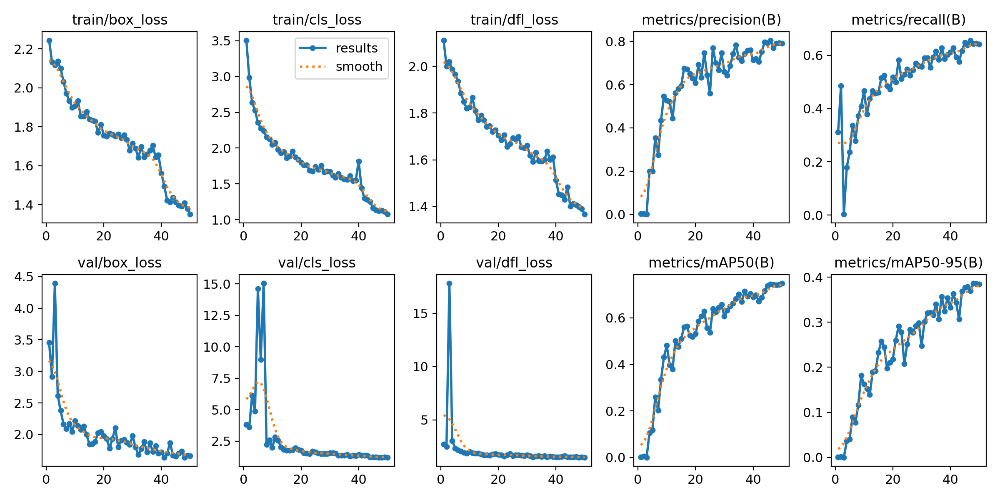

In [ ]:
Image(filename=f'/content/runs/detect/yolov11n_aug_ft1/results.png', width=600)

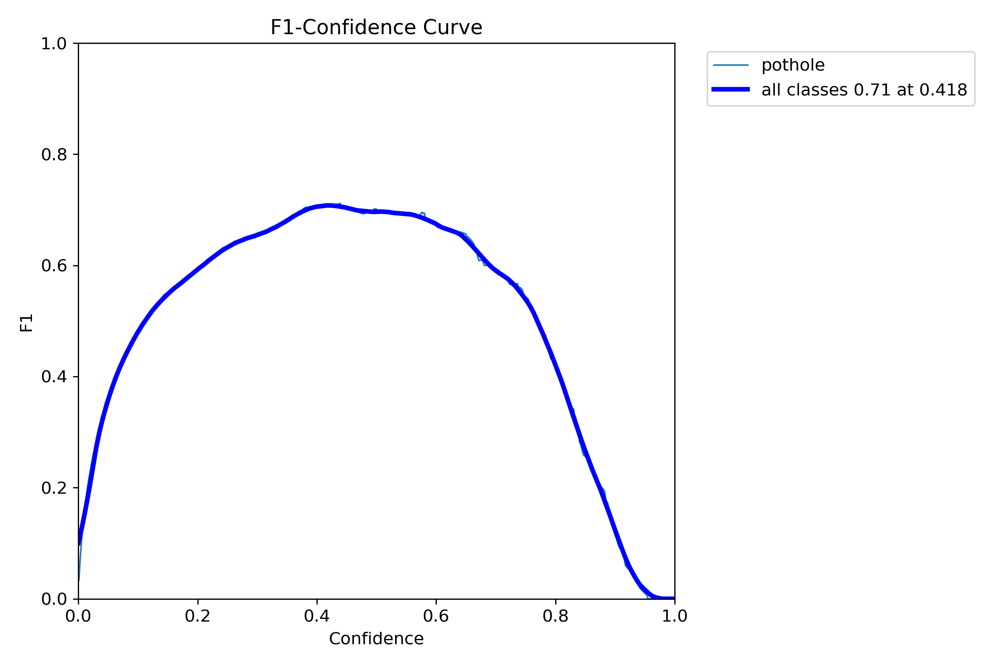

In [ ]:
Image(filename=f'/content/runs/detect/yolov11n_aug_ft1/F1_curve.png', width=600)

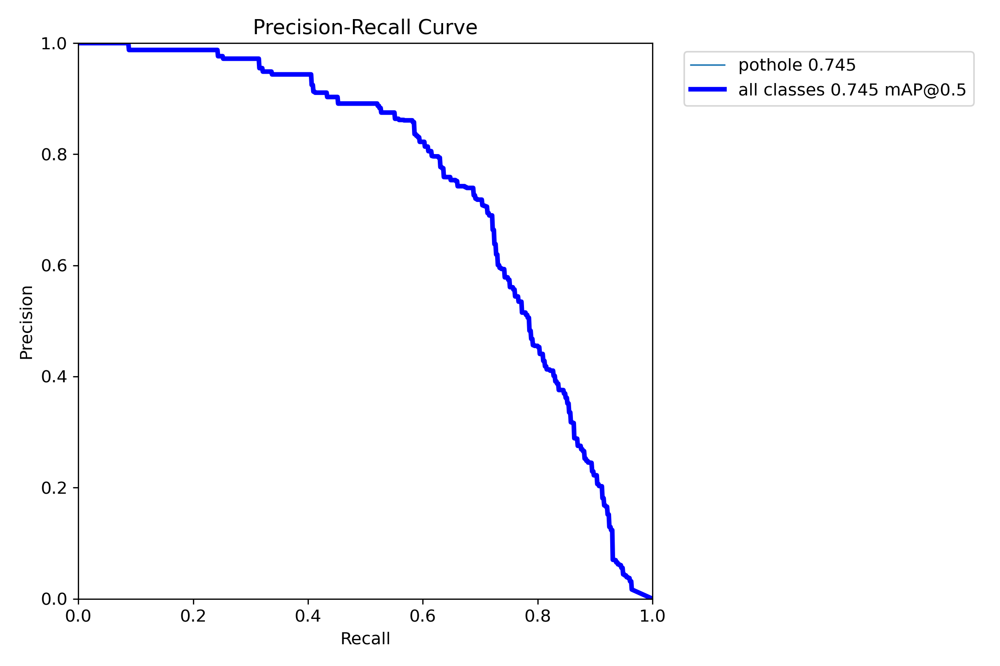

In [ ]:
Image(filename=f'/content/runs/detect/yolov11n_aug_ft1/PR_curve.png', width=600)

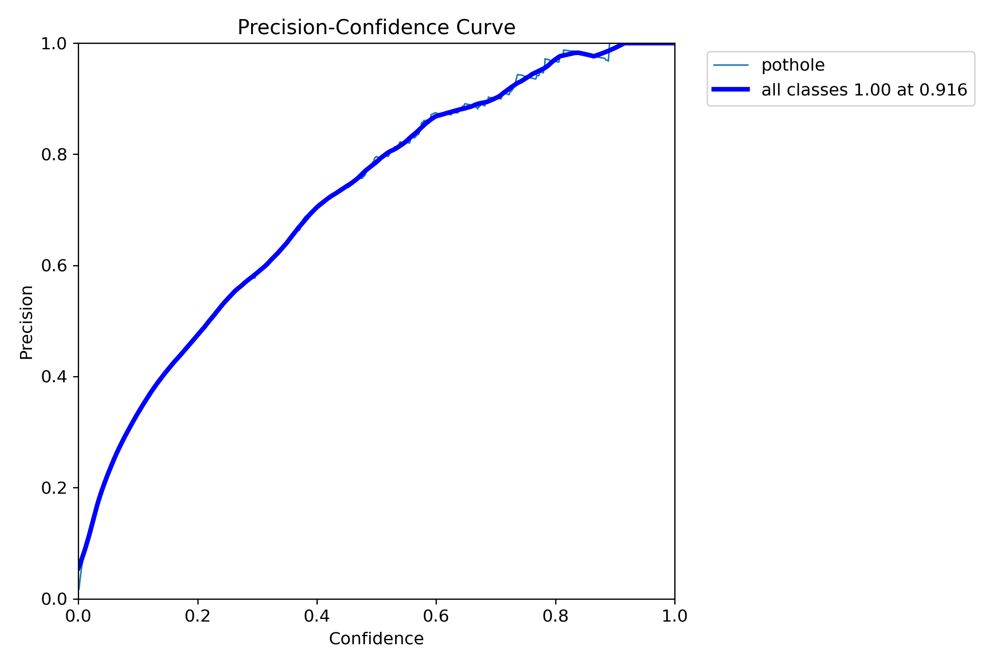

In [ ]:
Image(filename=f'/content/runs/detect/yolov11n_aug_ft1/P_curve.png', width=600)

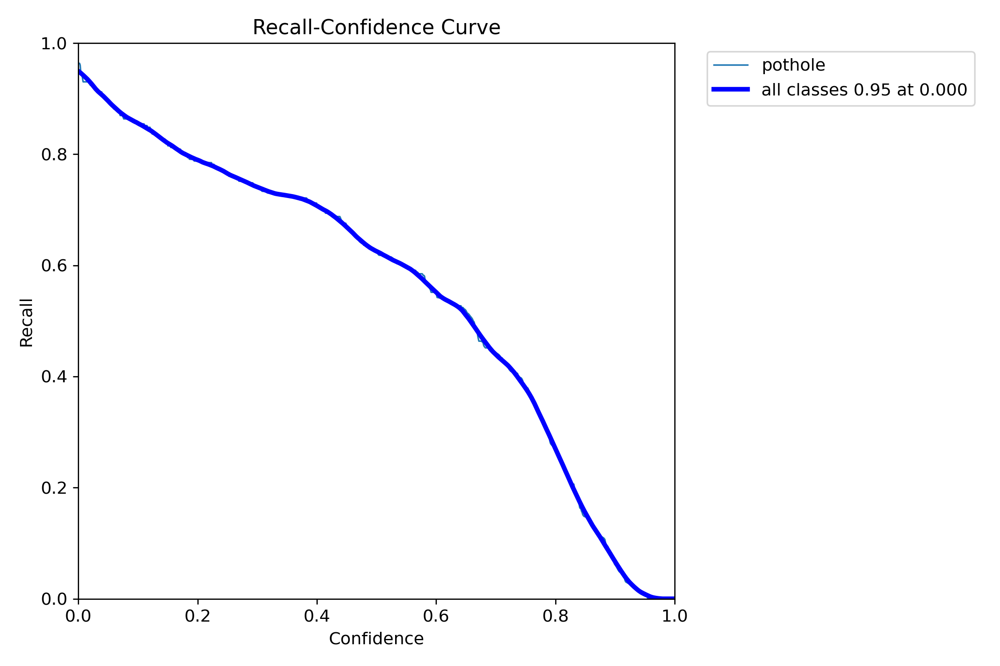

In [ ]:
Image(filename=f'/content/runs/detect/yolov11n_aug_ft1/R_curve.png', width=600)

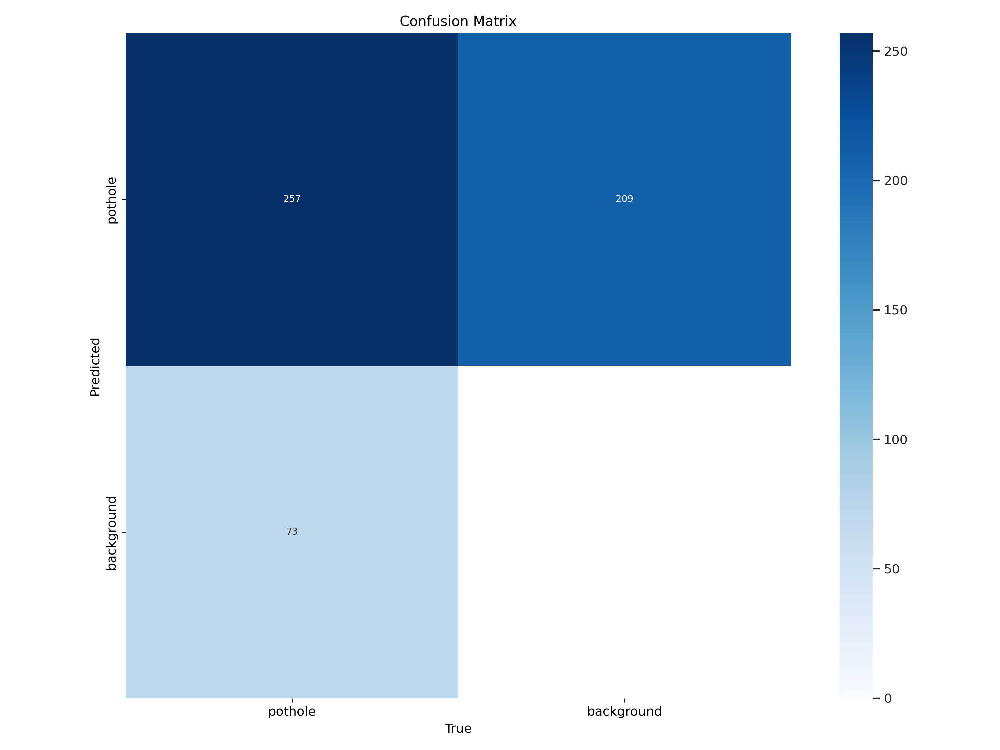

In [ ]:
Image(filename=f'/content/runs/detect/yolov11n_aug_ft1/confusion_matrix.png', width=600)

In [ ]:
metrics_v11 = '/content/runs/detect/yolov11n_aug_ft1/results.csv'

In [ ]:
results_v11 = model_aug_v11.val(name="test_yolov11n_aug_ft1",split='test')

Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11n summary (fused): 238 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/yolov11-dataset/test/labels... 67 images, 0 backgrounds, 0 corrupt: 100%|██████████| 67/67 [00:00<00:00, 1203.12it/s]

val: New cache created: /content/yolov11-dataset/test/labels.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.60it/s]


                   all         67        154      0.738       0.75      0.766      0.424
Speed: 0.2ms preprocess, 15.8ms inference, 0.0ms loss, 4.1ms postprocess per image
Results saved to runs/detect/test_yolov11n_aug_ft1


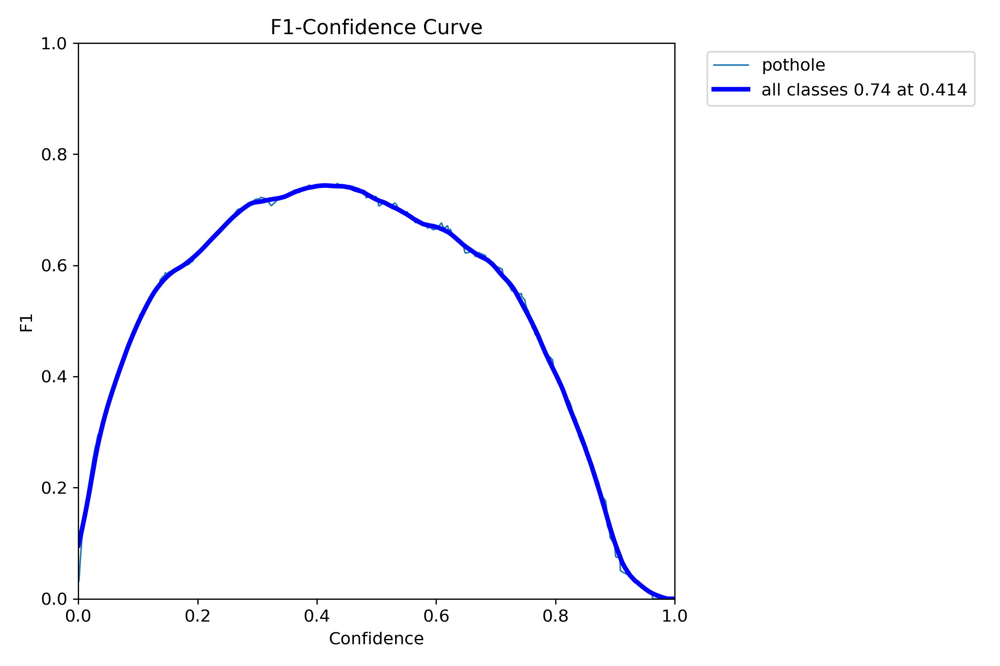

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov11n_aug_ft1/F1_curve.png', width=600)

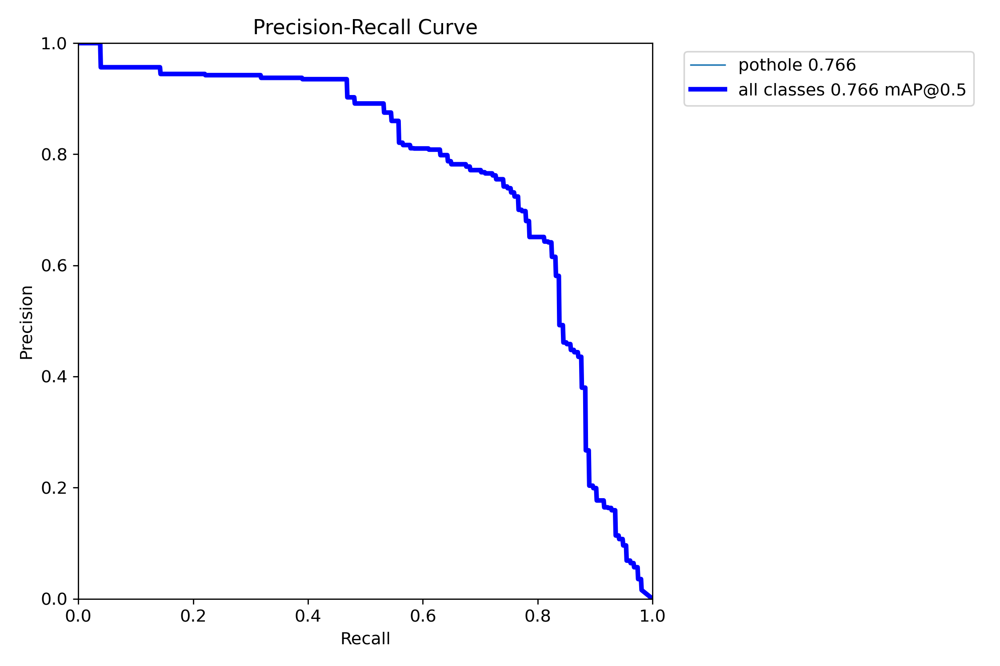

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov11n_aug_ft1/PR_curve.png', width=600)

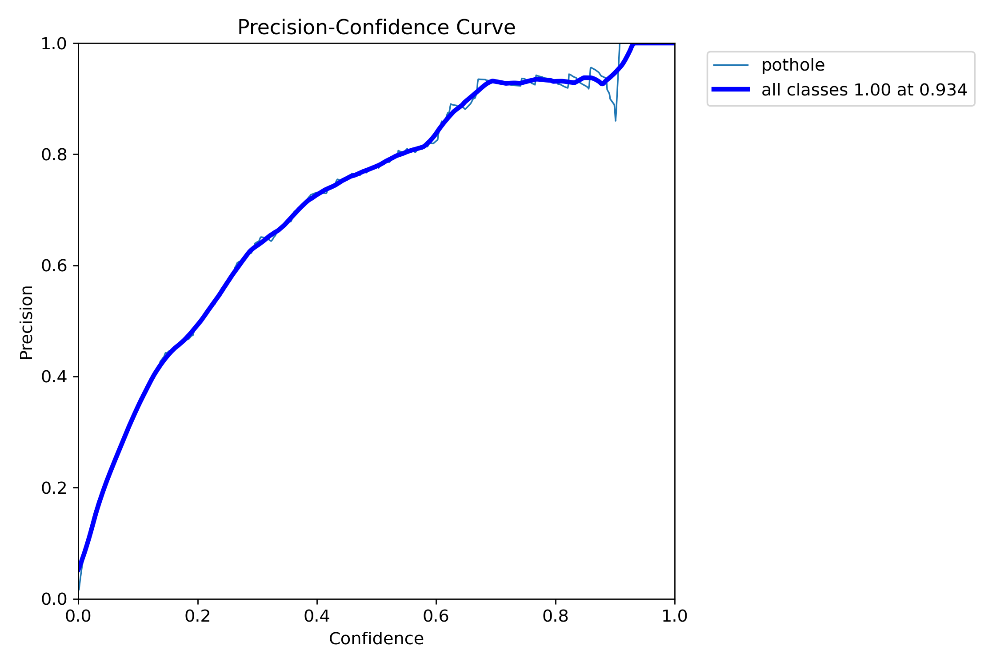

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov11n_aug_ft1/P_curve.png', width=600)

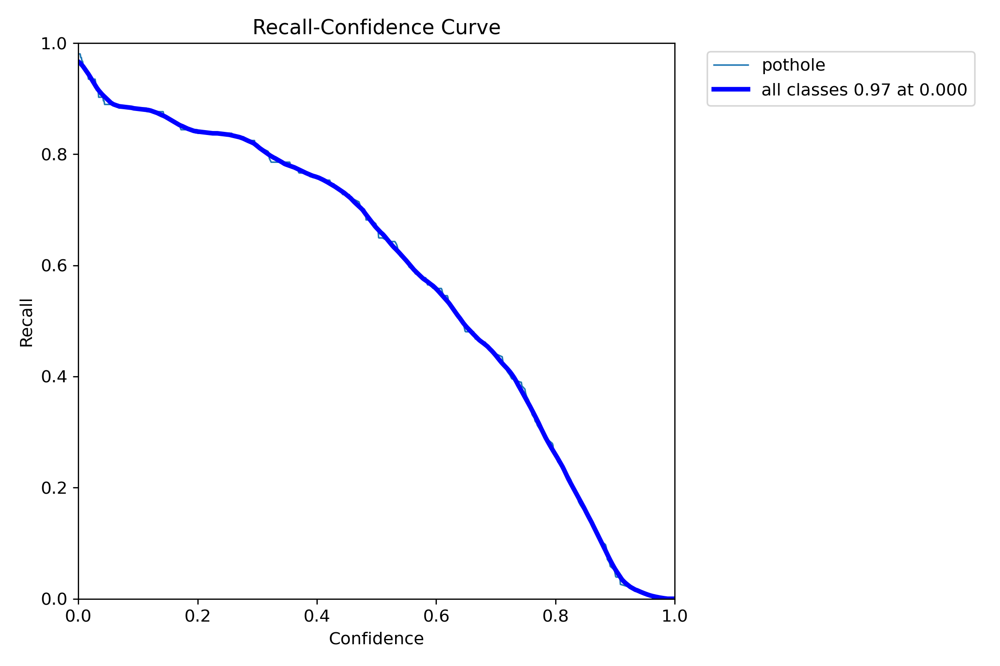

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov11n_aug_ft1/R_curve.png', width=600)

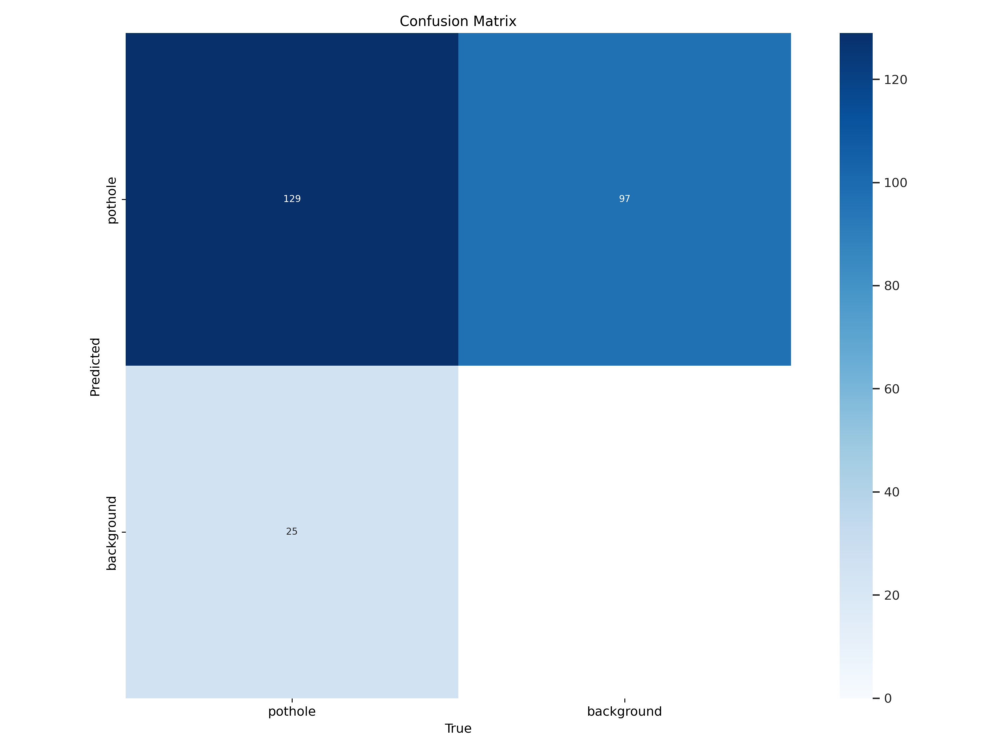

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov11n_aug_ft1/confusion_matrix.png', width=600)

In [ ]:
model_aug_v11.export(format='tflite')

Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.00GHz)

PyTorch: starting from 'runs/detect/yolov11n_aug_ft1/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (5.2 MB)

TensorFlow SavedModel: starting export with tensorflow 2.17.1...

ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.45...
ONNX: export success ✅ 1.5s, saved as 'runs/detect/yolov11n_aug_ft1/weights/best.onnx' (10.2 MB)
TensorFlow SavedModel: starting TFLite export with onnx2tf 1.26.3...
TensorFlow SavedModel: export success ✅ 29.0s, saved as 'runs/detect/yolov11n_aug_ft1/weights/best_saved_model' (26.5 MB)

TensorFlow Lite: starting export with tensorflow 2.17.1...
TensorFlow Lite: export success ✅ 0.0s, saved as 'runs/detect/yolov11n_aug_ft1/weights/best_saved_model/best_float32.tflite' (10.1 MB)

Export complete (29.5s)
Results saved to /content/runs/detect/yolov11n_aug_ft1/weights
Predict:         yolo predict task=detect

'runs/detect/yolov11n_aug_ft1/weights/best_saved_model/best_float32.tflite'

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

In [ ]:
df_5 = pd.read_csv("/content/metrics_aug/results_5.csv")
df_6 = pd.read_csv("/content/metrics_aug/results_6.csv")
df_8 = pd.read_csv("/content/metrics_aug/results_8.csv")
df_10 = pd.read_csv(metrics_v10)
df_11 = pd.read_csv("/content/metrics_aug/results_11.csv")

**Comparison of YOLO Model Performance Based on mAP@0.5:0.95 Over Epochs**

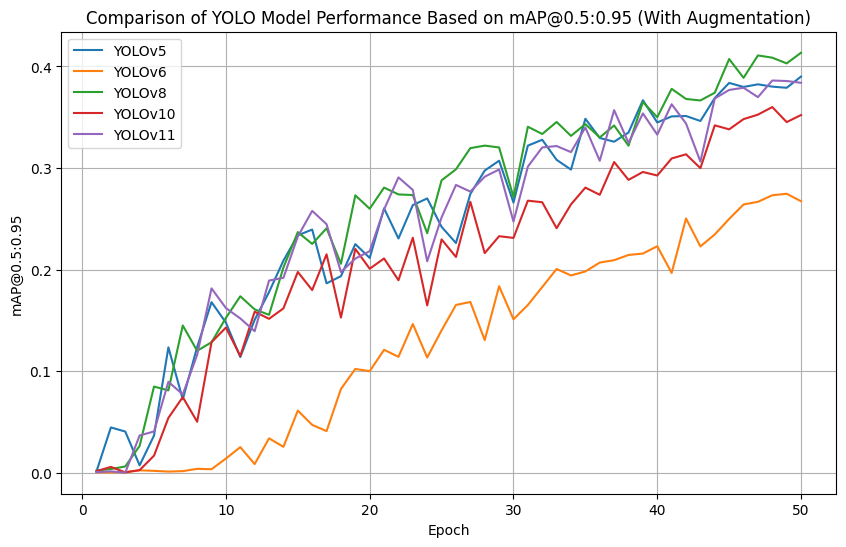

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_5['epoch'], df_5['metrics/mAP50-95(B)'], label='YOLOv5')
plt.plot(df_6['epoch'], df_6['metrics/mAP50-95(B)'], label='YOLOv6')
plt.plot(df_8['epoch'], df_8['metrics/mAP50-95(B)'], label='YOLOv8')
plt.plot(df_10['epoch'], df_10['metrics/mAP50-95(B)'], label='YOLOv10')
plt.plot(df_11['epoch'], df_11['metrics/mAP50-95(B)'], label='YOLOv11')
plt.xlabel('Epoch')
plt.ylabel('mAP@0.5:0.95')
plt.title('Comparison of YOLO Model Performance Based on mAP@0.5:0.95 (With Augmentation)')
plt.legend()
plt.grid(True)
plt.show()

**Recall Comparison**

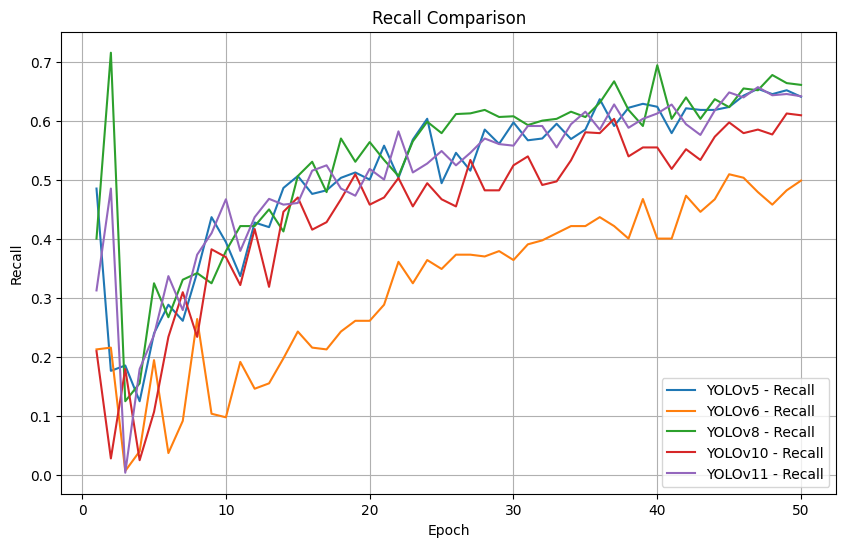

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_5['epoch'], df_5['metrics/recall(B)'], label='YOLOv5 - Recall')
plt.plot(df_6['epoch'], df_6['metrics/recall(B)'], label='YOLOv6 - Recall')
plt.plot(df_8['epoch'], df_8['metrics/recall(B)'], label='YOLOv8 - Recall')
plt.plot(df_10['epoch'], df_10['metrics/recall(B)'], label='YOLOv10 - Recall')
plt.plot(df_11['epoch'], df_11['metrics/recall(B)'], label='YOLOv11 - Recall')
plt.xlabel('Epoch')
plt.ylabel('Recall')
plt.title('Recall Comparison')
plt.legend()
plt.grid(True)
plt.show()

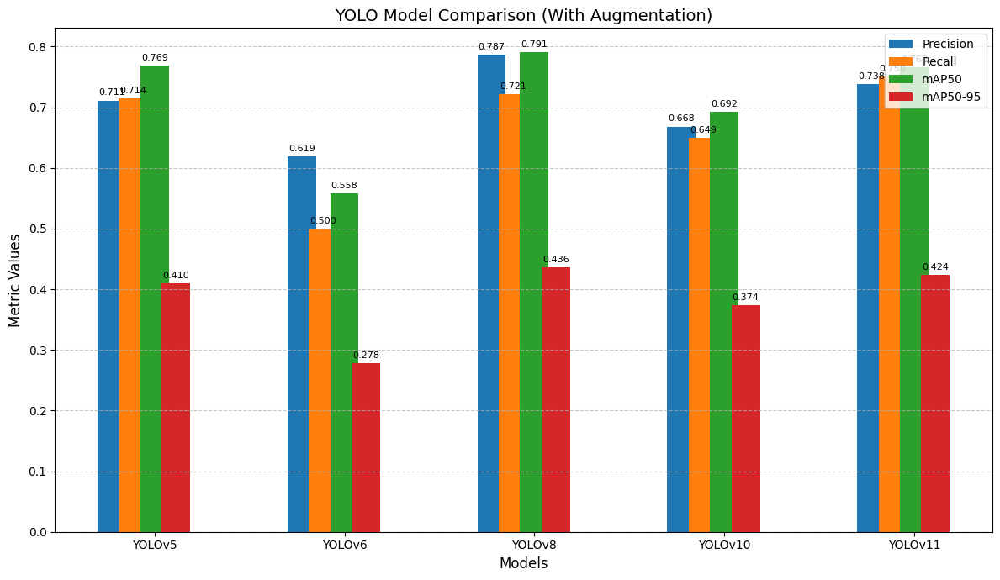

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# --------------------------------------------------------------------
# 1) Grouped Bar Chart
# --------------------------------------------------------------------

# Updated Models list including YOLOv10
models = ["YOLOv5", "YOLOv6", "YOLOv8", "YOLOv10", "YOLOv11"]

# Updated metrics lists including YOLOv10 metrics
precision = [0.711, 0.619, 0.787, 0.668, 0.738]     # P
recall    = [0.714, 0.500, 0.721, 0.649, 0.750]     # R
map50     = [0.769, 0.558, 0.791, 0.692, 0.766]     # mAP@0.50
map50_95  = [0.410, 0.278, 0.436, 0.374, 0.424]     # mAP@0.50:0.95

x = np.arange(len(models))  # the label locations
width = 0.15                 # the width of the bars adjusted for 5 models

fig, ax = plt.subplots(figsize=(12, 7))  # Increased figure size for better spacing

# Plot bars
b1 = ax.bar(x - 1.5*width, precision, width, label='Precision')
b2 = ax.bar(x - 0.75*width, recall,    width, label='Recall')
b3 = ax.bar(x + 0.0*width, map50,     width, label='mAP50')
b4 = ax.bar(x + 0.75*width, map50_95,  width, label='mAP50-95')

# Add some text for labels, title, and custom x-axis tick labels, etc.
ax.set_xlabel('Models', fontsize=12)
ax.set_ylabel('Metric Values', fontsize=12)
ax.set_title('YOLO Model Comparison (With Augmentation)', fontsize=14)
ax.set_xticks(x)
ax.set_xticklabels(models, fontsize=10)
ax.legend()
ax.grid(True, axis='y', linestyle='--', alpha=0.7)

# Annotate bars with their values
for bars in [b1, b2, b3, b4]:
    for bar in bars:
        height = bar.get_height()
        ax.annotate(f'{height:.3f}',
                    xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 3),  # offset text position
                    textcoords="offset points",
                    ha='center', va='bottom', fontsize=8)

plt.tight_layout()
plt.show()

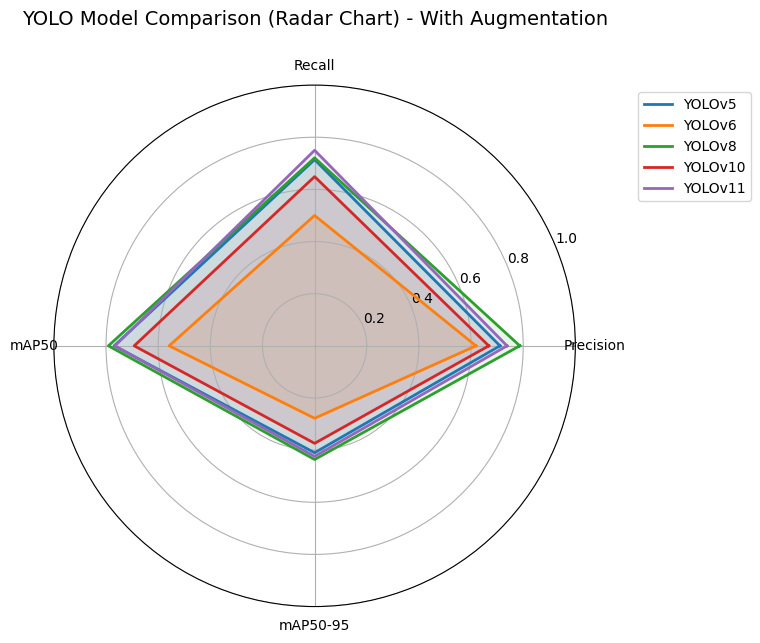

In [ ]:
# --------------------------------------------------------------------
# 2) Radar Chart (Alternative Visualization)
# --------------------------------------------------------------------

# Updated Metrics including YOLOv10
model_metrics = [
    [precision[0], recall[0], map50[0], map50_95[0]],  # YOLOv5
    [precision[1], recall[1], map50[1], map50_95[1]],  # YOLOv6
    [precision[2], recall[2], map50[2], map50_95[2]],  # YOLOv8
    [precision[3], recall[3], map50[3], map50_95[3]],  # YOLOv10
    [precision[4], recall[4], map50[4], map50_95[4]],  # YOLOv11
]

# Radar labels
metrics_labels = ["Precision", "Recall", "mAP50", "mAP50-95"]
num_vars = len(metrics_labels)

# Angles for each metric axis (in radians)
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()

# Append the first angle to close the radar
angles += angles[:1]

fig = plt.figure(figsize=(8, 8))
ax = plt.subplot(111, polar=True)

for idx, m in enumerate(model_metrics):
    # Repeat the first metric to close the loop
    stats = m + [m[0]]
    ax.plot(angles, stats, label=models[idx], linewidth=2)
    ax.fill(angles, stats, alpha=0.1)

# Fix the location of the metric labels (around the circle)
ax.set_thetagrids(np.degrees(angles[:-1]), metrics_labels)

# Set range for radial axis (assuming values are between 0 and 1)
ax.set_ylim(0, 1.0)

# Add legend and title
plt.title("YOLO Model Comparison (Radar Chart) - With Augmentation", y=1.1, fontsize=14)
plt.legend(loc='upper right', bbox_to_anchor=(1.35, 1.0))
plt.tight_layout()
plt.show()

In [ ]:
df_aug_5 = pd.read_csv("/content/metrics_aug/results_5.csv")
df_aug_6 = pd.read_csv("/content/metrics_aug/results_6.csv")
df_aug_8 = pd.read_csv("/content/metrics_aug/results_8.csv")
df_aug_10 = pd.read_csv(metrics_v10)
df_aug_11 = pd.read_csv("/content/metrics_aug/results_11.csv")

In [ ]:
df_5 = pd.read_csv("/content/metrics/results_5.csv")
df_6 = pd.read_csv("/content/metrics/results_6.csv")
df_8 = pd.read_csv("/content/metrics/results_8.csv")
df_10 = pd.read_csv("/content/metrics/results_10.csv")
df_11 = pd.read_csv("/content/metrics/results_11.csv")

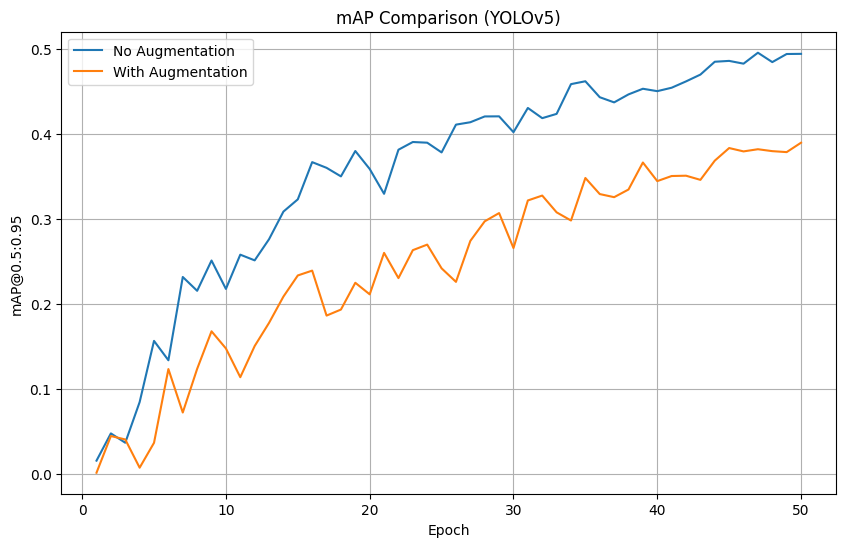

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_5['epoch'], df_5['metrics/mAP50-95(B)'], label='No Augmentation')
plt.plot(df_aug_5['epoch'], df_aug_5['metrics/mAP50-95(B)'], label='With Augmentation')
plt.xlabel('Epoch')
plt.ylabel('mAP@0.5:0.95')
plt.title('mAP Comparison (YOLOv5)')
plt.legend()
plt.grid(True)
plt.show()

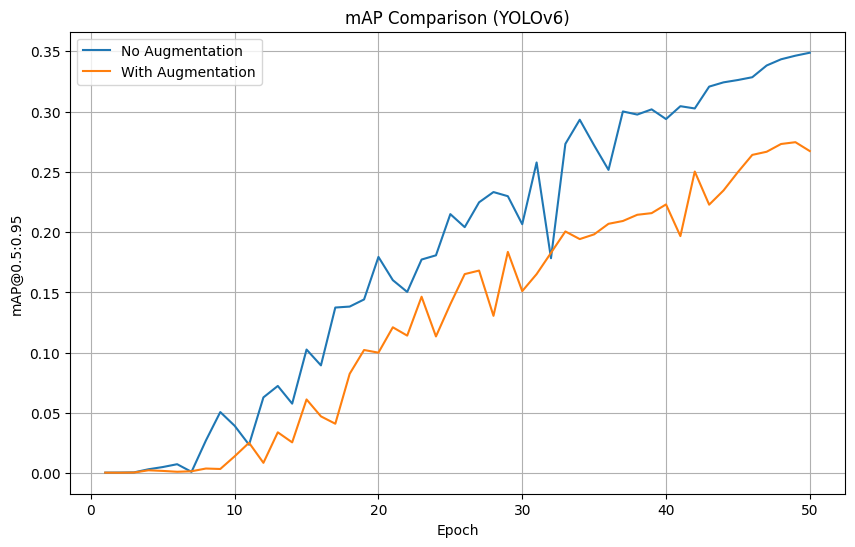

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_6['epoch'], df_6['metrics/mAP50-95(B)'], label='No Augmentation')
plt.plot(df_aug_6['epoch'], df_aug_6['metrics/mAP50-95(B)'], label='With Augmentation')
plt.xlabel('Epoch')
plt.ylabel('mAP@0.5:0.95')
plt.title('mAP Comparison (YOLOv6)')
plt.legend()
plt.grid(True)
plt.show()

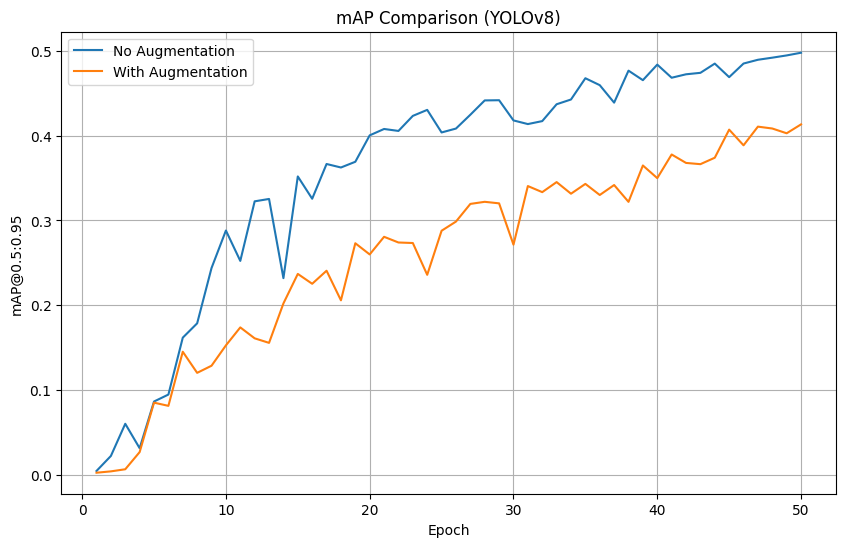

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_8['epoch'], df_8['metrics/mAP50-95(B)'], label='No Augmentation')
plt.plot(df_aug_8['epoch'], df_aug_8['metrics/mAP50-95(B)'], label='With Augmentation')
plt.xlabel('Epoch')
plt.ylabel('mAP@0.5:0.95')
plt.title('mAP Comparison (YOLOv8)')
plt.legend()
plt.grid(True)
plt.show()

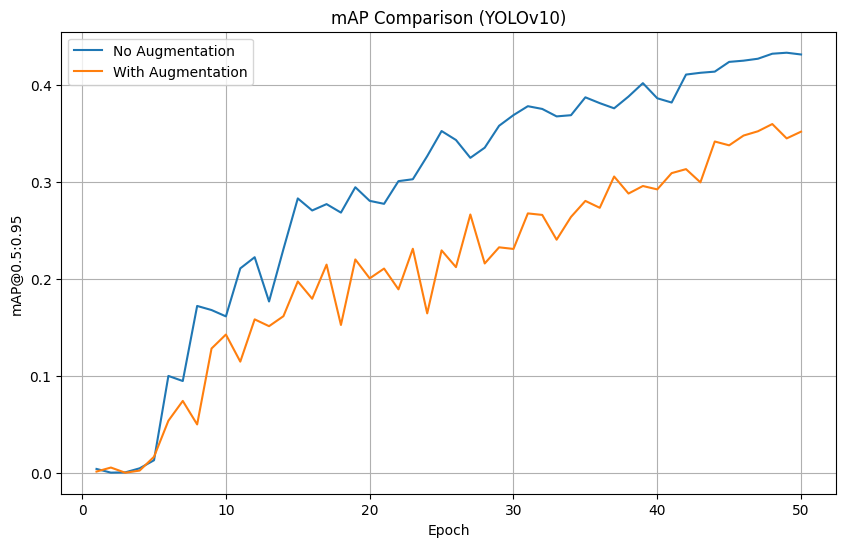

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_10['epoch'], df_10['metrics/mAP50-95(B)'], label='No Augmentation')
plt.plot(df_aug_10['epoch'], df_aug_10['metrics/mAP50-95(B)'], label='With Augmentation')
plt.xlabel('Epoch')
plt.ylabel('mAP@0.5:0.95')
plt.title('mAP Comparison (YOLOv10)')
plt.legend()
plt.grid(True)
plt.show()

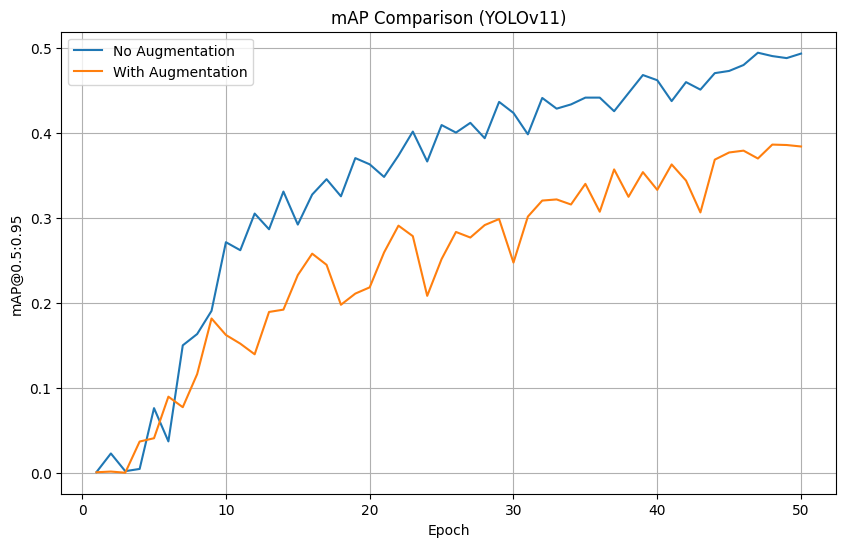

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_11['epoch'], df_11['metrics/mAP50-95(B)'], label='No Augmentation')
plt.plot(df_aug_11['epoch'], df_aug_11['metrics/mAP50-95(B)'], label='With Augmentation')
plt.xlabel('Epoch')
plt.ylabel('mAP@0.5:0.95')
plt.title('mAP Comparison (YOLOv11)')
plt.legend()
plt.grid(True)
plt.show()

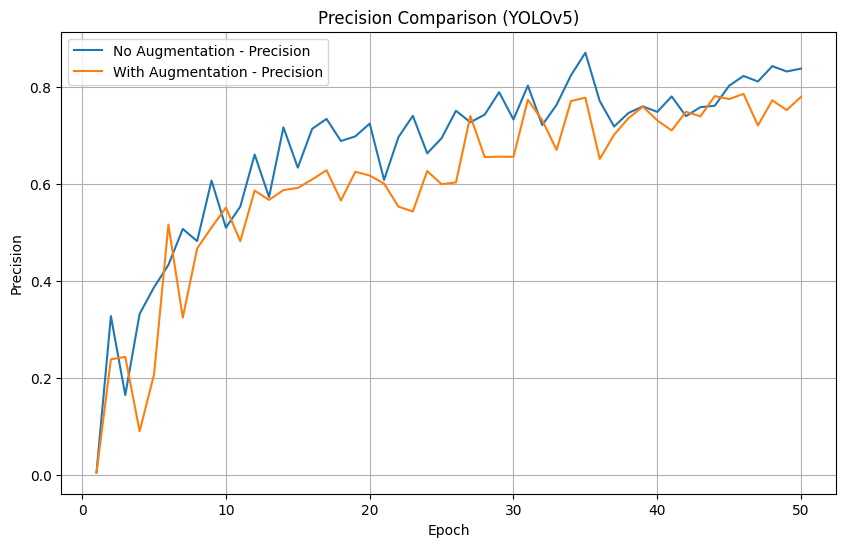

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_5['epoch'], df_5['metrics/precision(B)'], label='No Augmentation - Precision')
plt.plot(df_aug_5['epoch'], df_aug_5['metrics/precision(B)'], label='With Augmentation - Precision')
plt.xlabel('Epoch')
plt.ylabel('Precision')
plt.title('Precision Comparison (YOLOv5)')
plt.legend()
plt.grid(True)
plt.show()

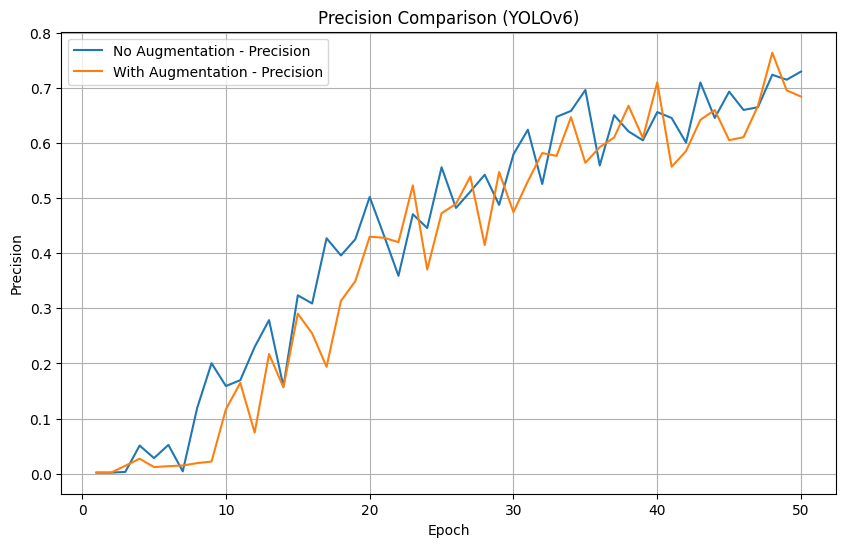

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_6['epoch'], df_6['metrics/precision(B)'], label='No Augmentation - Precision')
plt.plot(df_aug_6['epoch'], df_aug_6['metrics/precision(B)'], label='With Augmentation - Precision')
plt.xlabel('Epoch')
plt.ylabel('Precision')
plt.title('Precision Comparison (YOLOv6)')
plt.legend()
plt.grid(True)
plt.show()

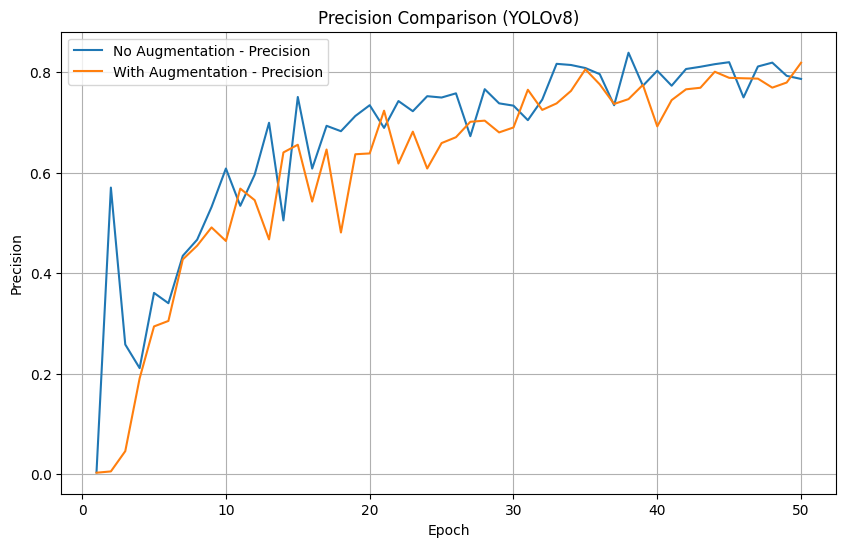

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_8['epoch'], df_8['metrics/precision(B)'], label='No Augmentation - Precision')
plt.plot(df_aug_8['epoch'], df_aug_8['metrics/precision(B)'], label='With Augmentation - Precision')
plt.xlabel('Epoch')
plt.ylabel('Precision')
plt.title('Precision Comparison (YOLOv8)')
plt.legend()
plt.grid(True)
plt.show()

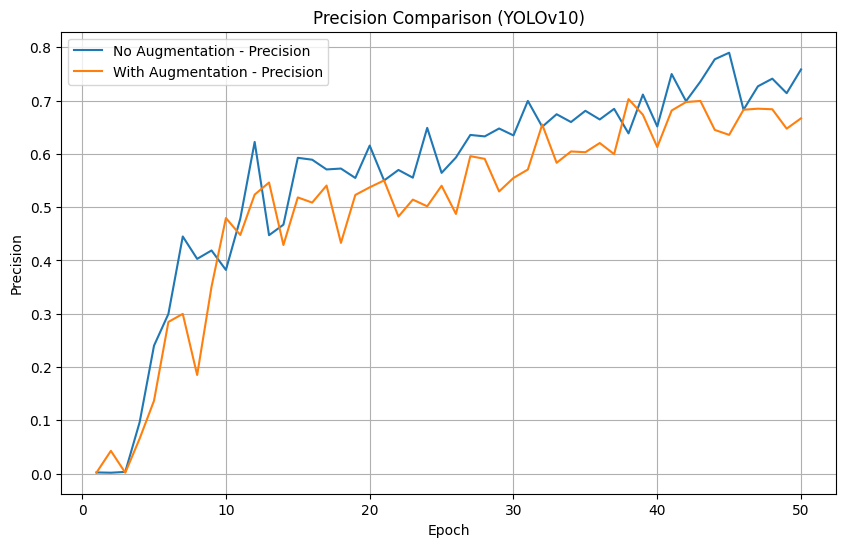

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_10['epoch'], df_10['metrics/precision(B)'], label='No Augmentation - Precision')
plt.plot(df_aug_10['epoch'], df_aug_10['metrics/precision(B)'], label='With Augmentation - Precision')
plt.xlabel('Epoch')
plt.ylabel('Precision')
plt.title('Precision Comparison (YOLOv10)')
plt.legend()
plt.grid(True)
plt.show()

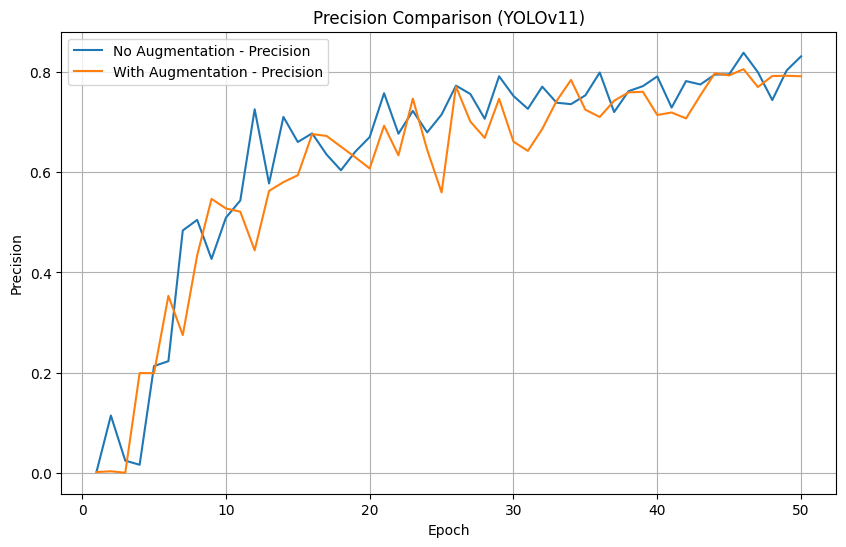

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_11['epoch'], df_11['metrics/precision(B)'], label='No Augmentation - Precision')
plt.plot(df_aug_11['epoch'], df_aug_11['metrics/precision(B)'], label='With Augmentation - Precision')
plt.xlabel('Epoch')
plt.ylabel('Precision')
plt.title('Precision Comparison (YOLOv11)')
plt.legend()
plt.grid(True)
plt.show()

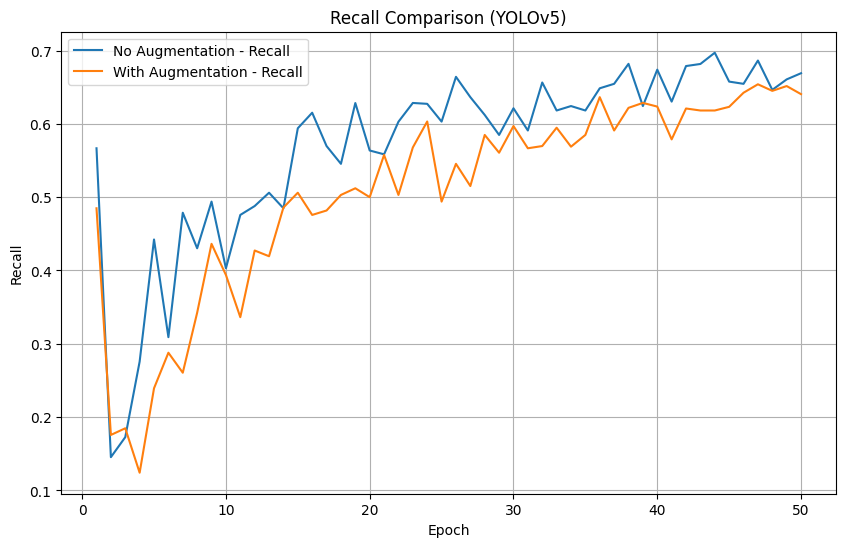

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_5['epoch'], df_5['metrics/recall(B)'], label='No Augmentation - Recall')
plt.plot(df_aug_5['epoch'], df_aug_5['metrics/recall(B)'], label='With Augmentation - Recall')
plt.xlabel('Epoch')
plt.ylabel('Recall')
plt.title('Recall Comparison (YOLOv5)')
plt.legend()
plt.grid(True)
plt.show()

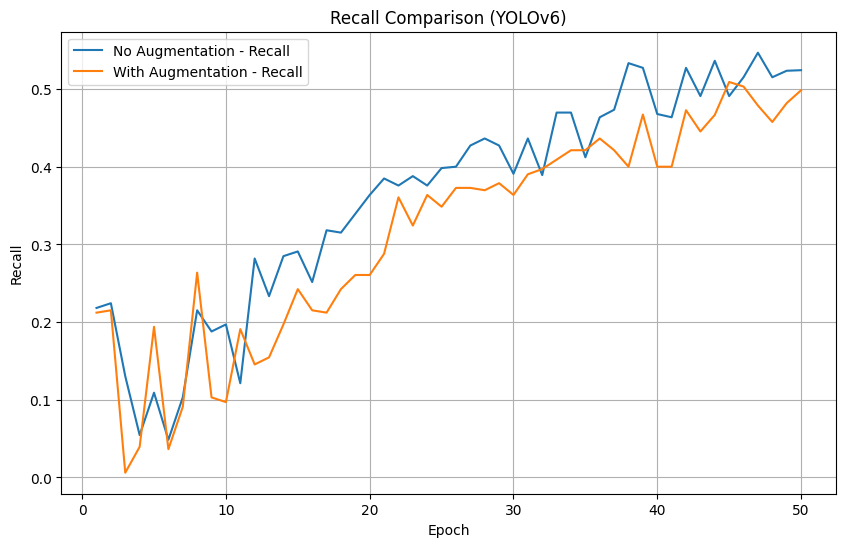

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_6['epoch'], df_6['metrics/recall(B)'], label='No Augmentation - Recall')
plt.plot(df_aug_6['epoch'], df_aug_6['metrics/recall(B)'], label='With Augmentation - Recall')
plt.xlabel('Epoch')
plt.ylabel('Recall')
plt.title('Recall Comparison (YOLOv6)')
plt.legend()
plt.grid(True)
plt.show()

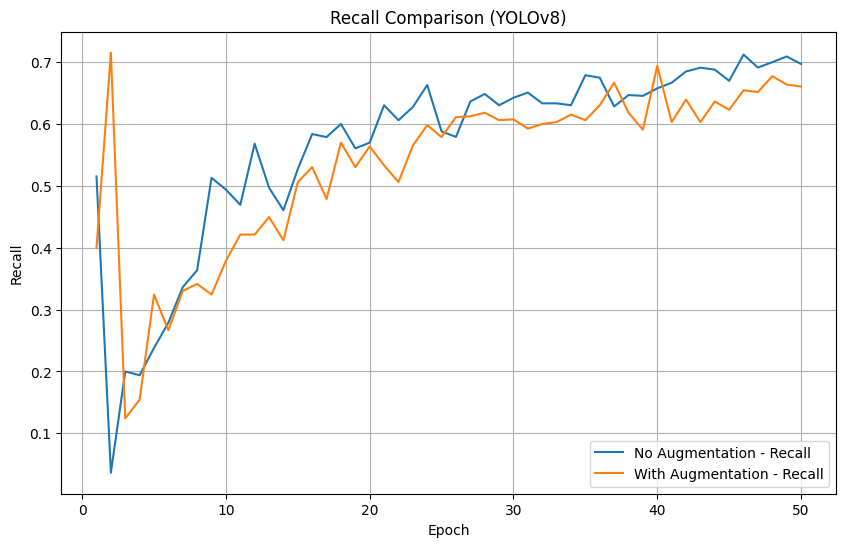

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_8['epoch'], df_8['metrics/recall(B)'], label='No Augmentation - Recall')
plt.plot(df_aug_8['epoch'], df_aug_8['metrics/recall(B)'], label='With Augmentation - Recall')
plt.xlabel('Epoch')
plt.ylabel('Recall')
plt.title('Recall Comparison (YOLOv8)')
plt.legend()
plt.grid(True)
plt.show()

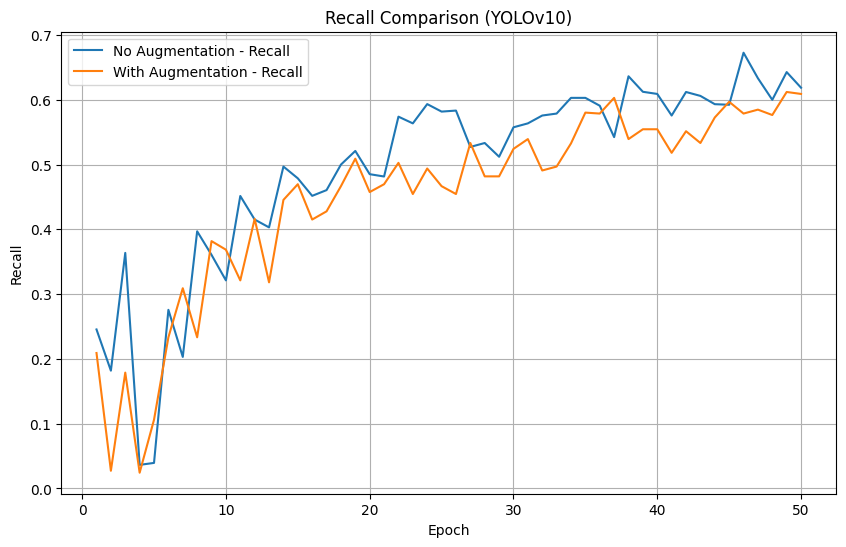

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_10['epoch'], df_10['metrics/recall(B)'], label='No Augmentation - Recall')
plt.plot(df_aug_10['epoch'], df_aug_10['metrics/recall(B)'], label='With Augmentation - Recall')
plt.xlabel('Epoch')
plt.ylabel('Recall')
plt.title('Recall Comparison (YOLOv10)')
plt.legend()
plt.grid(True)
plt.show()

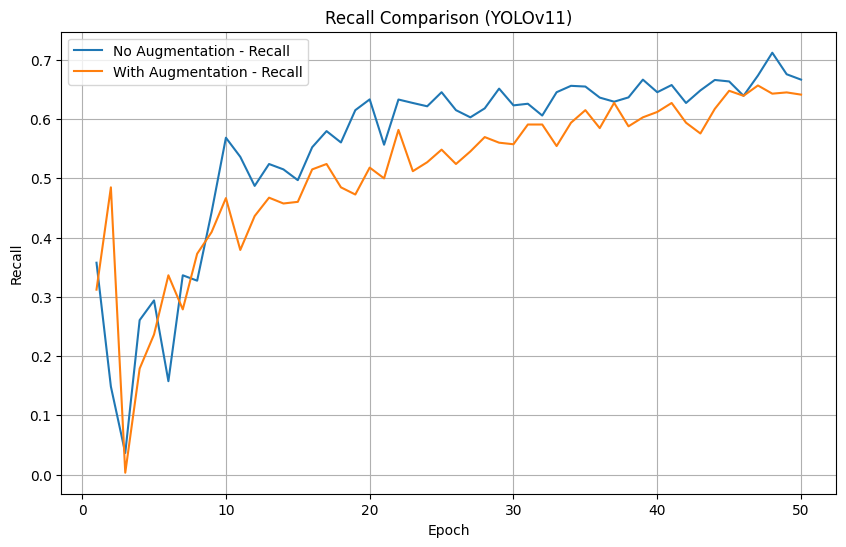

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_11['epoch'], df_11['metrics/recall(B)'], label='No Augmentation - Recall')
plt.plot(df_aug_11['epoch'], df_aug_11['metrics/recall(B)'], label='With Augmentation - Recall')
plt.xlabel('Epoch')
plt.ylabel('Recall')
plt.title('Recall Comparison (YOLOv11)')
plt.legend()
plt.grid(True)
plt.show()

## Trying to improve models with augmentation ( ft2 )

In [ ]:
epochs = 80
batch_size = 64
imgsz = 640

In [ ]:
model_aug_v6_v2 = YOLO('yolov6n.yaml')
model_aug_v8_v2 = YOLO('yolov8n.pt')
model_aug_v5_v2 = YOLO('yolov5n.pt')
model_aug_v10_v2 = YOLO('yolov10n.pt')
model_aug_v11_v2 = YOLO('yolo11n.pt')

PRO TIP 💡 Replace 'model=yolov5n.pt' with new 'model=yolov5nu.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.



#### YOLOv5

In [ ]:
model_aug_v5_v2.train(data=os.path.join(dataset_yolov8.location, 'data.yaml'),
                   epochs=epochs, batch=batch_size,name='yolov5n_aug_ft2',
                   imgsz=imgsz,
                   augment=True,
                   fliplr= 0.5,           # Horizontal flip with 50% probability
                   flipud= 0.1,           # Vertical flip with 10% probability
                   scale= 0.3,            # Scale images ±30%
                   translate= 0.2,        # Translate images ±20%
                   hsv_h=0.015,          # HSV hue adjustment ±1.5%
                   hsv_s=0.7,            # HSV saturation adjustment 70%
                   hsv_v=0.4,            # HSV value (brightness) adjustment 40%
                   degrees=10.0,         # Random rotation ±10 degrees
                   shear= 5.0,            # Shear transformations ±5 degrees
                   perspective=0.001,    # Small perspective distortion
                   mosaic= 1.0,           # Enable mosaic augmentation
                   mixup=0.2             # Enable mixup with 20% probability
)

Ultralytics 8.3.61 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov5n.pt, data=/content/yolov8-dataset/data.yaml, epochs=80, time=None, patience=100, batch=64, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov5n_aug_ft2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=

100%|██████████| 755k/755k [00:00<00:00, 14.5MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1      1760  ultralytics.nn.modules.conv.Conv             [3, 16, 6, 2, 2]              
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      4800  ultralytics.nn.modules.block.C3              [32, 32, 1]                   
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     29184  ultralytics.nn.modules.block.C3              [64, 64, 2]                   
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  3    156928  ultralytics.nn.modules.block.C3              [128, 128, 3]                 
  7                  -1  1    295424  ultralytics

train: Scanning /content/yolov8-dataset/train/labels... 465 images, 0 backgrounds, 0 corrupt: 100%|██████████| 465/465 [00:00<00:00, 1359.70it/s]

train: New cache created: /content/yolov8-dataset/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


A new version of Albumentations is available: 2.0.0 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
val: Scanning /content/yolov8-dataset/valid/labels... 133 images, 0 backgrounds, 0 corrupt: 100%|██████████| 133/133 [00:00<00:00, 1062.54it/s]

val: New cache created: /content/yolov8-dataset/valid/labels.cache


Plotting labels to runs/detect/yolov5n_aug_ft2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 69 weight(decay=0.0), 76 weight(decay=0.0005), 75 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolov5n_aug_ft2
Starting training for 80 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/80      7.01G      2.558      3.426        2.3        129        640: 100%|██████████| 8/8 [00:05<00:00,  1.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.02s/it]

                   all        133        330    0.00123      0.148    0.00179   0.000426



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/80      6.79G      2.398      3.296      2.206         76        640: 100%|██████████| 8/8 [00:03<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.52it/s]

                   all        133        330    0.00218      0.264     0.0018   0.000487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/80      7.11G      2.079      2.817      1.976        110        640: 100%|██████████| 8/8 [00:03<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.20it/s]

                   all        133        330    0.00303      0.367    0.00822    0.00217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/80      7.07G      1.989      2.568      1.845         81        640: 100%|██████████| 8/8 [00:03<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.61it/s]

                   all        133        330    0.00414        0.5     0.0092    0.00264



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/80      6.72G      1.924      2.372      1.806         94        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.44it/s]

                   all        133        330    0.00509      0.615     0.0183     0.0053



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/80      6.75G      1.892      2.288      1.757         78        640: 100%|██████████| 8/8 [00:03<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.62it/s]

                   all        133        330      0.248      0.148        0.1     0.0291



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/80      7.02G      1.858      2.161      1.731         85        640: 100%|██████████| 8/8 [00:03<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.43it/s]

                   all        133        330      0.266      0.133      0.126     0.0459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/80      7.07G      1.897      2.163      1.778         70        640: 100%|██████████| 8/8 [00:03<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.50it/s]

                   all        133        330      0.205       0.13     0.0862     0.0293



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/80      6.97G      1.916      2.144      1.778         70        640: 100%|██████████| 8/8 [00:03<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.79it/s]

                   all        133        330     0.0214     0.0364    0.00793    0.00262



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/80      7.02G      1.951      2.179      1.801        107        640: 100%|██████████| 8/8 [00:03<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.63it/s]

                   all        133        330      0.143      0.179     0.0695     0.0182



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/80      7.02G       1.91      2.106      1.765         68        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.19it/s]

                   all        133        330      0.313      0.127     0.0973     0.0306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/80      6.98G      1.873      2.056      1.747        107        640: 100%|██████████| 8/8 [00:03<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.60it/s]

                   all        133        330      0.185      0.227     0.0896     0.0321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/80      7.11G      1.873      2.036      1.736         71        640: 100%|██████████| 8/8 [00:03<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.41it/s]

                   all        133        330      0.472      0.176      0.168     0.0498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/80         7G      1.886      2.015      1.743         86        640: 100%|██████████| 8/8 [00:03<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.68it/s]

                   all        133        330     0.0447      0.242     0.0312     0.0112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/80      7.06G      1.873      1.969      1.733         92        640: 100%|██████████| 8/8 [00:03<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.78it/s]

                   all        133        330     0.0335      0.115     0.0171    0.00597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/80         7G      1.921      2.032      1.749        118        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.11it/s]

                   all        133        330      0.254      0.282      0.178     0.0659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/80      7.04G      1.862      1.922      1.714         79        640: 100%|██████████| 8/8 [00:03<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.67it/s]

                   all        133        330      0.354      0.294      0.238     0.0846



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/80      7.02G      1.838      1.858      1.693        115        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.70it/s]

                   all        133        330      0.539      0.478      0.455      0.201



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/80      6.74G      1.769       1.86      1.647         89        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.59it/s]

                   all        133        330       0.53      0.465      0.486      0.205



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/80      7.09G      1.805      1.846      1.664         95        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.77it/s]

                   all        133        330        0.4       0.33      0.296       0.14



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/80      6.74G      1.817      1.905      1.702         92        640: 100%|██████████| 8/8 [00:03<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.77it/s]

                   all        133        330      0.471      0.367      0.349      0.144



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/80      6.81G      1.797      1.803      1.661        119        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.72it/s]

                   all        133        330      0.507      0.418      0.417      0.183



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/80      7.06G      1.753      1.748       1.63         85        640: 100%|██████████| 8/8 [00:03<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.73it/s]

                   all        133        330      0.641      0.473      0.546      0.257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/80      6.77G      1.817      1.798       1.69         88        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.72it/s]

                   all        133        330      0.539      0.418      0.437       0.19



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/80      7.06G      1.784      1.848      1.666         75        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.54it/s]

                   all        133        330      0.538      0.388      0.403      0.163



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/80      7.07G      1.754      1.787      1.621        143        640: 100%|██████████| 8/8 [00:03<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.33it/s]

                   all        133        330      0.552       0.49        0.5      0.209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/80      6.74G      1.777      1.725      1.626        135        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.69it/s]

                   all        133        330      0.592      0.518       0.56      0.229



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/80      7.07G       1.74      1.764      1.632        111        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.79it/s]

                   all        133        330      0.622      0.455      0.502      0.205



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/80      7.08G      1.765      1.753      1.635        111        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.62it/s]

                   all        133        330      0.576      0.406      0.432      0.174



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/80      7.09G      1.736      1.735      1.627         76        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.70it/s]

                   all        133        330      0.531      0.452      0.476      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/80      6.97G      1.717      1.646      1.612         93        640: 100%|██████████| 8/8 [00:03<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.77it/s]

                   all        133        330      0.522      0.597      0.544      0.263



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/80      7.04G       1.72       1.71      1.622        104        640: 100%|██████████| 8/8 [00:03<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.79it/s]

                   all        133        330      0.629      0.427      0.502      0.231



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/80      7.02G      1.732      1.688      1.608         89        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.67it/s]

                   all        133        330      0.733      0.397      0.513      0.234



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/80      7.07G      1.695      1.648      1.584         69        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.65it/s]

                   all        133        330      0.625      0.564       0.57      0.257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/80      6.72G      1.711      1.621      1.574         81        640: 100%|██████████| 8/8 [00:03<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.72it/s]

                   all        133        330      0.554      0.473      0.466      0.198



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/80      7.06G      1.722      1.637      1.612        102        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.61it/s]

                   all        133        330        0.6      0.547      0.576      0.259



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/80      7.09G      1.687      1.631      1.588         89        640: 100%|██████████| 8/8 [00:03<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.85it/s]

                   all        133        330      0.611      0.491      0.555      0.229



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/80      7.09G      1.695      1.584      1.587         91        640: 100%|██████████| 8/8 [00:03<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.75it/s]

                   all        133        330      0.641      0.585      0.606      0.269



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/80       6.7G      1.691      1.617      1.576        125        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.64it/s]

                   all        133        330      0.672       0.57       0.62      0.296



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/80      7.38G      1.683      1.594      1.571         78        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.81it/s]

                   all        133        330      0.759      0.602      0.671      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/80      6.98G      1.709      1.601      1.601         72        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.77it/s]

                   all        133        330      0.596      0.573      0.584      0.272



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/80      7.06G      1.708      1.596        1.6        102        640: 100%|██████████| 8/8 [00:03<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.55it/s]

                   all        133        330      0.719      0.458      0.565      0.275



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/80      6.98G      1.699      1.593      1.582        112        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.69it/s]

                   all        133        330      0.681      0.563      0.648      0.278



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/80      7.04G      1.644      1.522      1.545        102        640: 100%|██████████| 8/8 [00:03<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.76it/s]

                   all        133        330       0.65      0.618      0.655      0.271



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/80      7.11G      1.683       1.55       1.58         87        640: 100%|██████████| 8/8 [00:03<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.56it/s]

                   all        133        330      0.717      0.591      0.635      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/80      7.09G      1.661      1.567      1.573         86        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.79it/s]

                   all        133        330      0.795      0.594      0.695      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/80         7G      1.615      1.503      1.541        111        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.71it/s]

                   all        133        330      0.709      0.615      0.678      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/80         7G      1.688       1.55      1.597         97        640: 100%|██████████| 8/8 [00:03<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.75it/s]

                   all        133        330      0.693        0.6      0.661      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/80      7.42G      1.614      1.474      1.519        111        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.79it/s]

                   all        133        330       0.66      0.609      0.647      0.303



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/80      6.77G      1.653      1.531      1.548         92        640: 100%|██████████| 8/8 [00:03<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.64it/s]

                   all        133        330      0.724      0.585      0.671      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      51/80      6.98G       1.62      1.525      1.535         72        640: 100%|██████████| 8/8 [00:03<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.63it/s]

                   all        133        330      0.746      0.562      0.638      0.245



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      52/80      7.04G      1.658      1.533      1.576         83        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.73it/s]

                   all        133        330      0.686      0.615      0.664      0.287



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      53/80      7.09G      1.631      1.508       1.55         80        640: 100%|██████████| 8/8 [00:03<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.48it/s]

                   all        133        330      0.717        0.6      0.686      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      54/80      6.77G      1.631      1.478      1.524         82        640: 100%|██████████| 8/8 [00:03<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.66it/s]

                   all        133        330      0.672      0.618       0.65      0.273



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      55/80      7.07G      1.599      1.442      1.508        134        640: 100%|██████████| 8/8 [00:03<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.67it/s]

                   all        133        330      0.704       0.63      0.682      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      56/80      7.04G      1.583      1.432      1.511         92        640: 100%|██████████| 8/8 [00:03<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.26it/s]

                   all        133        330      0.751      0.603       0.71      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      57/80      6.77G      1.609      1.467      1.516         89        640: 100%|██████████| 8/8 [00:03<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.78it/s]

                   all        133        330      0.722      0.597      0.681      0.313



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      58/80         7G      1.594      1.462      1.498         66        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.72it/s]

                   all        133        330      0.684      0.676      0.726      0.376



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      59/80      6.75G      1.623      1.482      1.512         99        640: 100%|██████████| 8/8 [00:03<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.63it/s]

                   all        133        330      0.765      0.652      0.716      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      60/80      7.06G      1.601      1.457       1.51        109        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.83it/s]

                   all        133        330      0.712      0.661      0.711      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      61/80       6.7G      1.558      1.423      1.501         94        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.77it/s]

                   all        133        330       0.77       0.61       0.73      0.346



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      62/80      7.04G      1.588       1.42      1.501        106        640: 100%|██████████| 8/8 [00:03<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.69it/s]

                   all        133        330      0.719      0.652      0.721      0.352



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      63/80         7G      1.603      1.431       1.51         90        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.76it/s]

                   all        133        330      0.719      0.648      0.728      0.366



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      64/80      6.98G      1.587      1.395      1.486         93        640: 100%|██████████| 8/8 [00:03<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.72it/s]

                   all        133        330      0.771      0.603      0.727      0.363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      65/80      6.72G      1.548      1.356      1.455         92        640: 100%|██████████| 8/8 [00:03<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.82it/s]

                   all        133        330      0.818      0.594      0.731      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      66/80      6.98G      1.591      1.404      1.509        116        640: 100%|██████████| 8/8 [00:03<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.83it/s]

                   all        133        330      0.817      0.588      0.737      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      67/80       6.7G      1.572      1.387      1.475         99        640: 100%|██████████| 8/8 [00:03<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.62it/s]

                   all        133        330       0.76      0.632      0.729      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      68/80      6.72G      1.569      1.386      1.478        106        640: 100%|██████████| 8/8 [00:03<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.81it/s]

                   all        133        330      0.773      0.648       0.75      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      69/80      7.07G      1.567      1.346      1.475         90        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.80it/s]

                   all        133        330      0.797      0.636      0.762      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      70/80      7.02G      1.535       1.35      1.477         78        640: 100%|██████████| 8/8 [00:03<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.70it/s]

                   all        133        330      0.834      0.606       0.74      0.376


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      71/80      7.02G      1.337      1.203      1.323         38        640: 100%|██████████| 8/8 [00:06<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.81it/s]

                   all        133        330      0.726      0.606      0.698      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      72/80      7.01G      1.353       1.13      1.331         43        640: 100%|██████████| 8/8 [00:03<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.75it/s]

                   all        133        330      0.762      0.618       0.73      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      73/80      6.93G        1.3       1.04      1.295         39        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.67it/s]

                   all        133        330      0.705      0.665      0.727      0.363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      74/80      6.98G      1.342      1.027      1.291         38        640: 100%|██████████| 8/8 [00:03<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.87it/s]

                   all        133        330      0.737      0.654      0.748      0.372



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      75/80         7G      1.313      1.014      1.299         36        640: 100%|██████████| 8/8 [00:03<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.77it/s]

                   all        133        330      0.758      0.674      0.762      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      76/80      6.97G      1.294     0.9781      1.285         41        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.88it/s]

                   all        133        330      0.782      0.673       0.76      0.382



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      77/80      6.96G      1.319     0.9696      1.283         62        640: 100%|██████████| 8/8 [00:03<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.87it/s]

                   all        133        330        0.8      0.673       0.77      0.395



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      78/80      6.96G      1.285     0.9732      1.267         93        640: 100%|██████████| 8/8 [00:03<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.80it/s]

                   all        133        330      0.777      0.687      0.778      0.418



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      79/80      6.98G      1.256     0.9589      1.264         63        640: 100%|██████████| 8/8 [00:03<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.87it/s]

                   all        133        330      0.763      0.713       0.78      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      80/80      6.95G      1.315     0.9541      1.276         58        640: 100%|██████████| 8/8 [00:03<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.83it/s]

                   all        133        330      0.791      0.697      0.782      0.399



80 epochs completed in 0.120 hours.
Optimizer stripped from runs/detect/yolov5n_aug_ft2/weights/last.pt, 5.3MB
Optimizer stripped from runs/detect/yolov5n_aug_ft2/weights/best.pt, 5.3MB

Validating runs/detect/yolov5n_aug_ft2/weights/best.pt...
Ultralytics 8.3.61 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv5n summary (fused): 193 layers, 2,503,139 parameters, 0 gradients, 7.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.28it/s]


                   all        133        330       0.84      0.622       0.78      0.434
Speed: 0.2ms preprocess, 7.1ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to runs/detect/yolov5n_aug_ft2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ca775f22440>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

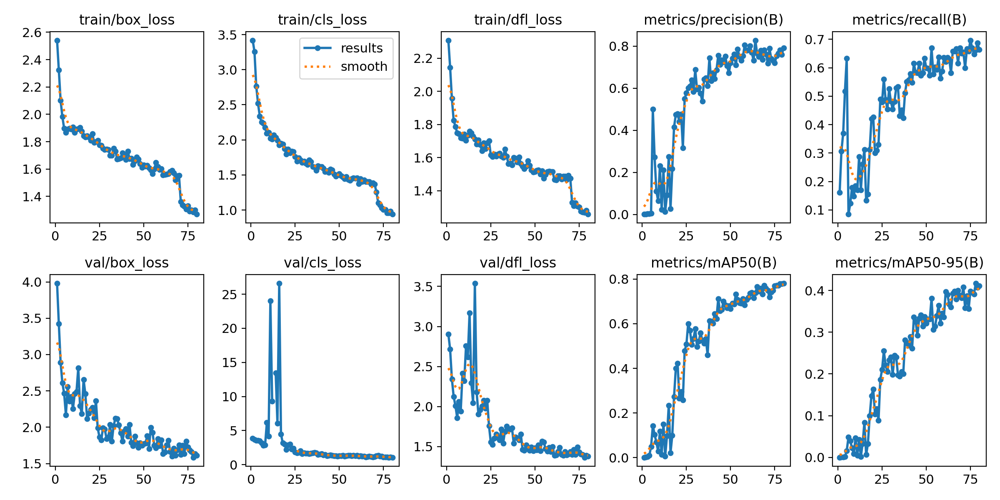

In [ ]:
Image(filename=f'/content/runs/detect/yolov5n_aug_ft2/results.png', width=600)

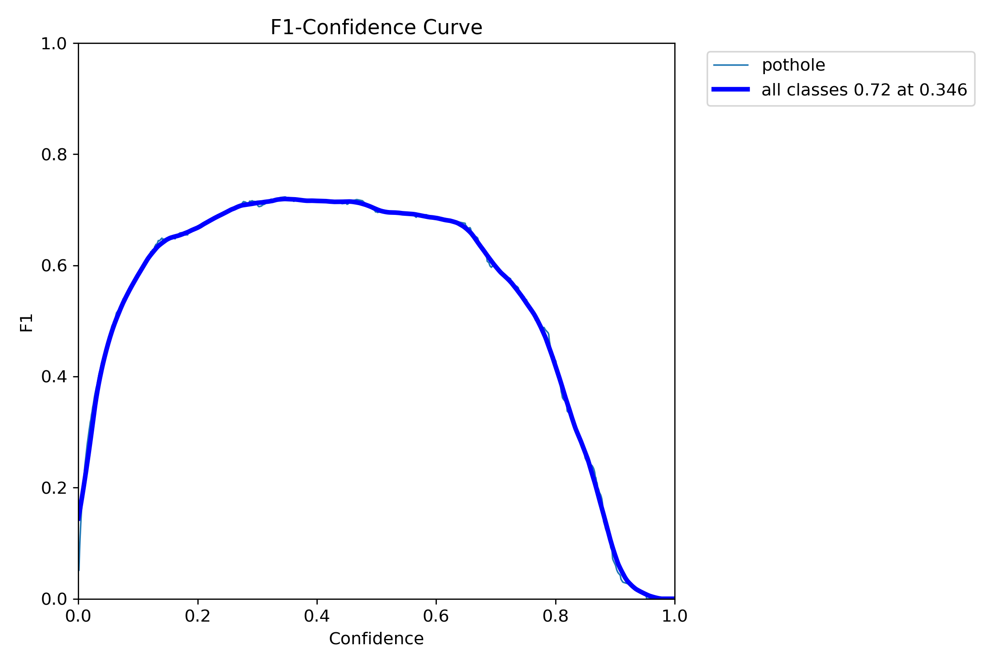

In [ ]:
Image(filename=f'/content/runs/detect/yolov5n_aug_ft2/F1_curve.png', width=600)

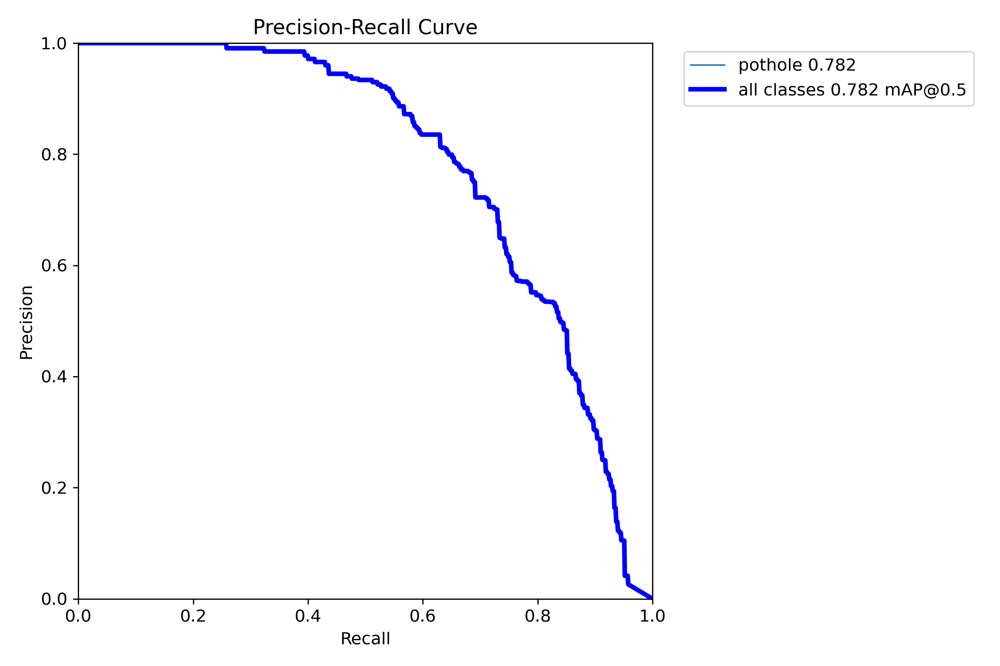

In [ ]:
Image(filename=f'/content/runs/detect/yolov5n_aug_ft2/PR_curve.png', width=600)

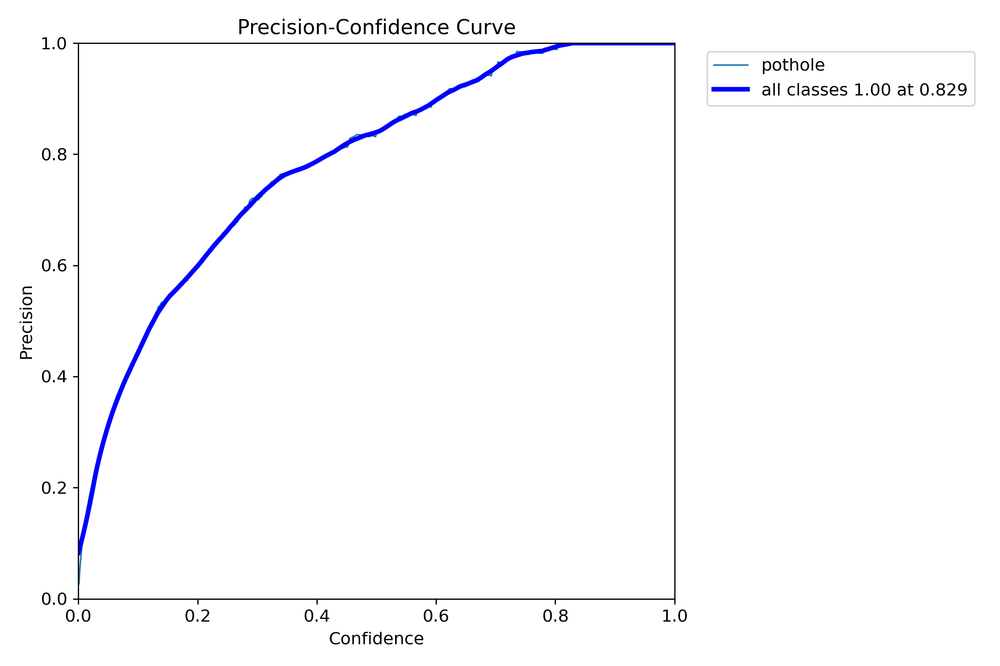

In [ ]:
Image(filename=f'/content/runs/detect/yolov5n_aug_ft2/P_curve.png', width=600)

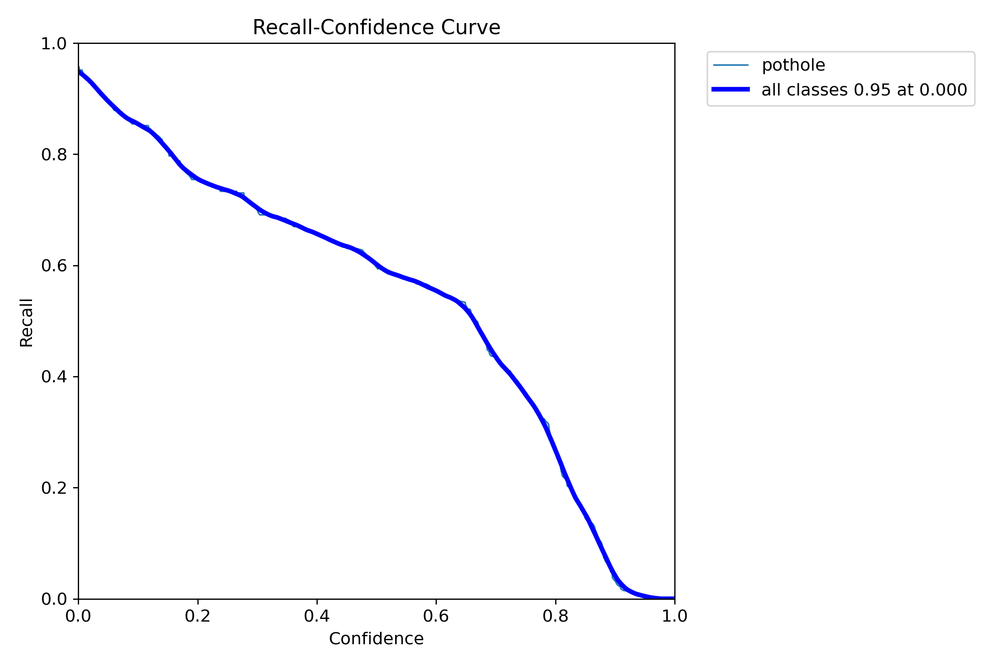

In [ ]:
Image(filename=f'/content/runs/detect/yolov5n_aug_ft2/R_curve.png', width=600)

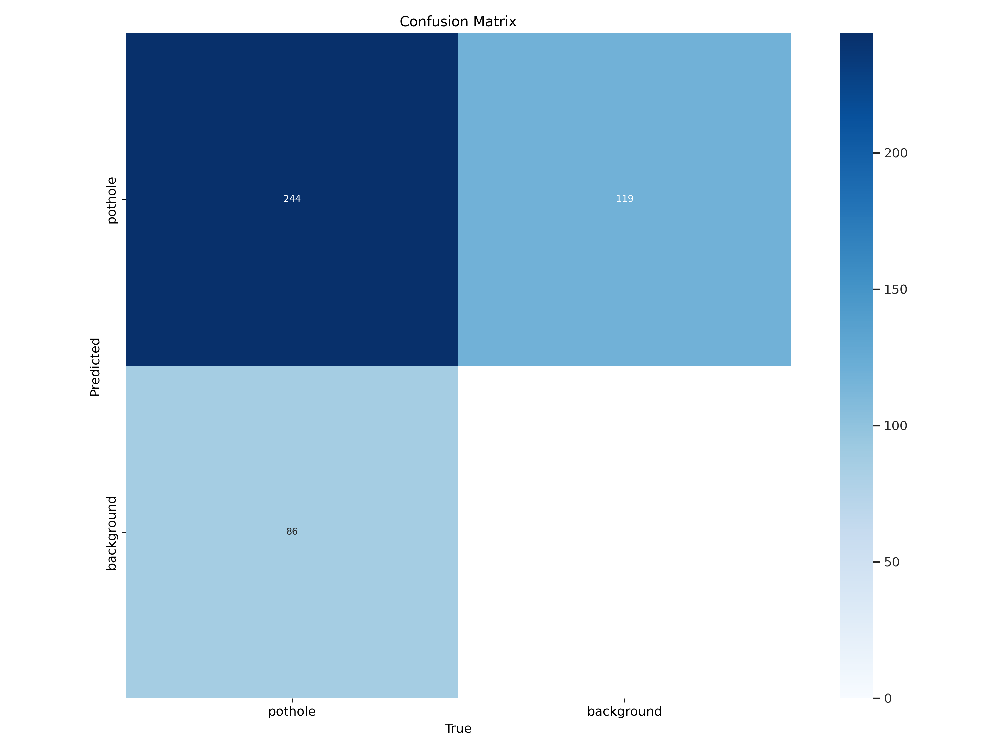

In [ ]:
Image(filename=f'/content/runs/detect/yolov5n_aug_ft2/confusion_matrix.png', width=600)

In [ ]:
metrics_v5_v2 = '/content/runs/detect/yolov5n_aug_ft2/results.csv'

In [ ]:
results_v5_v2 = model_aug_v5_v2.val(name='test_yolov5n_aug_ft2',split='test')

Ultralytics 8.3.58 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)


val: Scanning /content/yolov8-dataset/test/labels.cache... 67 images, 0 backgrounds, 0 corrupt: 100%|██████████| 67/67 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.42s/it]


                   all         67        154      0.765      0.699      0.771      0.436
Speed: 0.3ms preprocess, 15.3ms inference, 0.0ms loss, 2.8ms postprocess per image
Results saved to runs/detect/test_yolov5n_aug_ft24


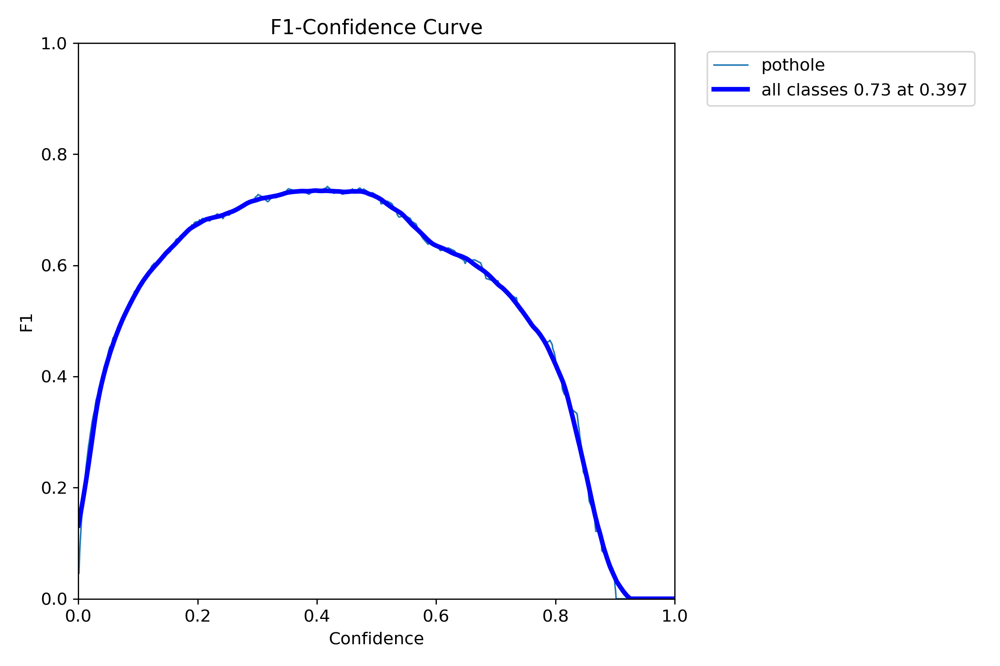

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov5n_aug_ft2/F1_curve.png', width=600)

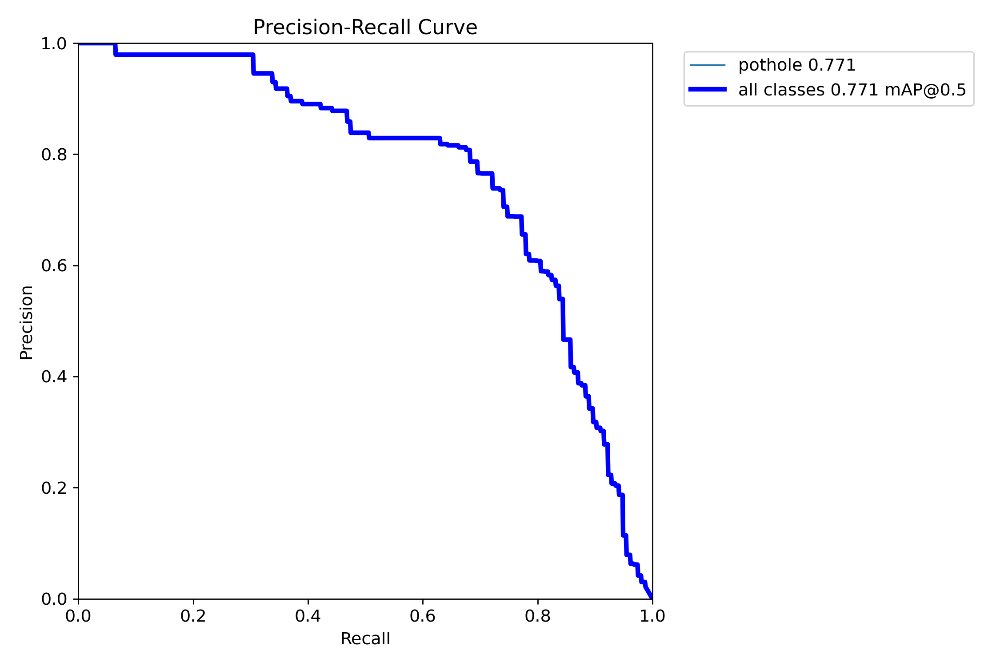

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov5n_aug_ft2/PR_curve.png', width=600)

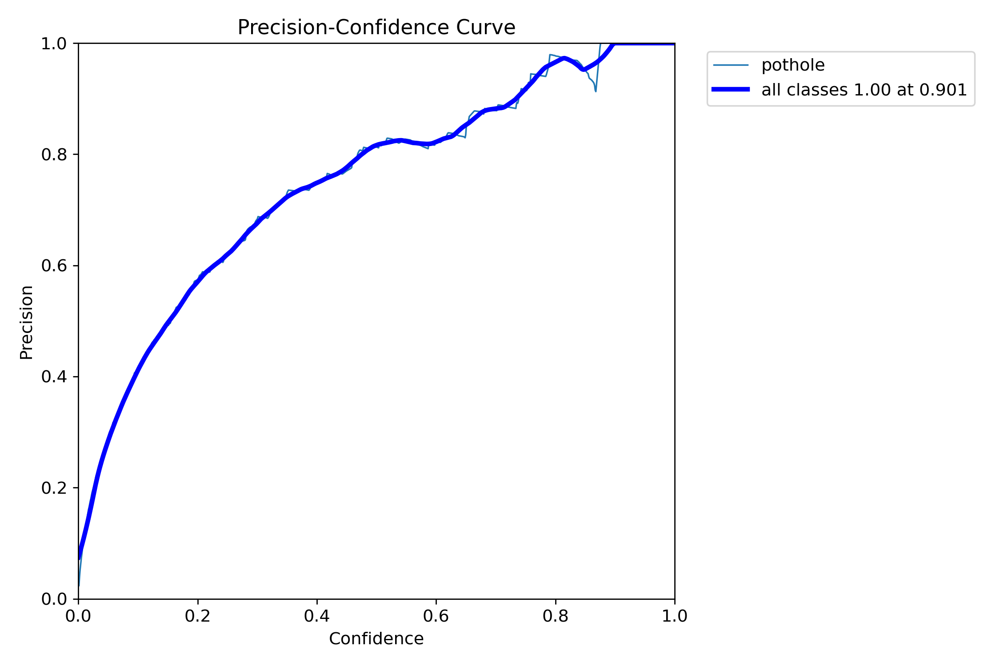

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov5n_aug_ft2/P_curve.png', width=600)

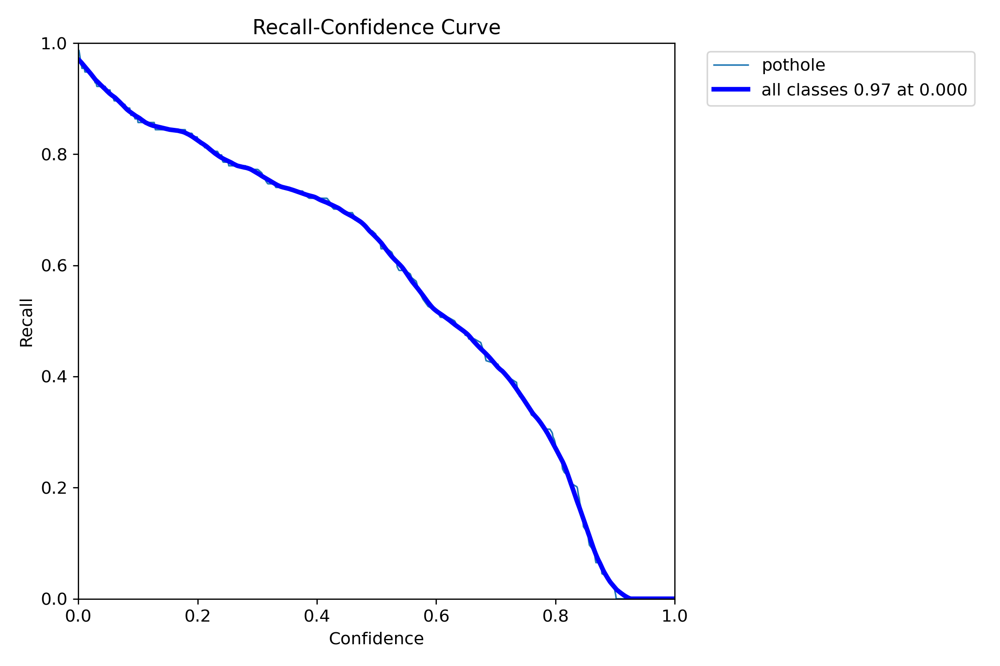

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov5n_aug_ft2/R_curve.png', width=600)

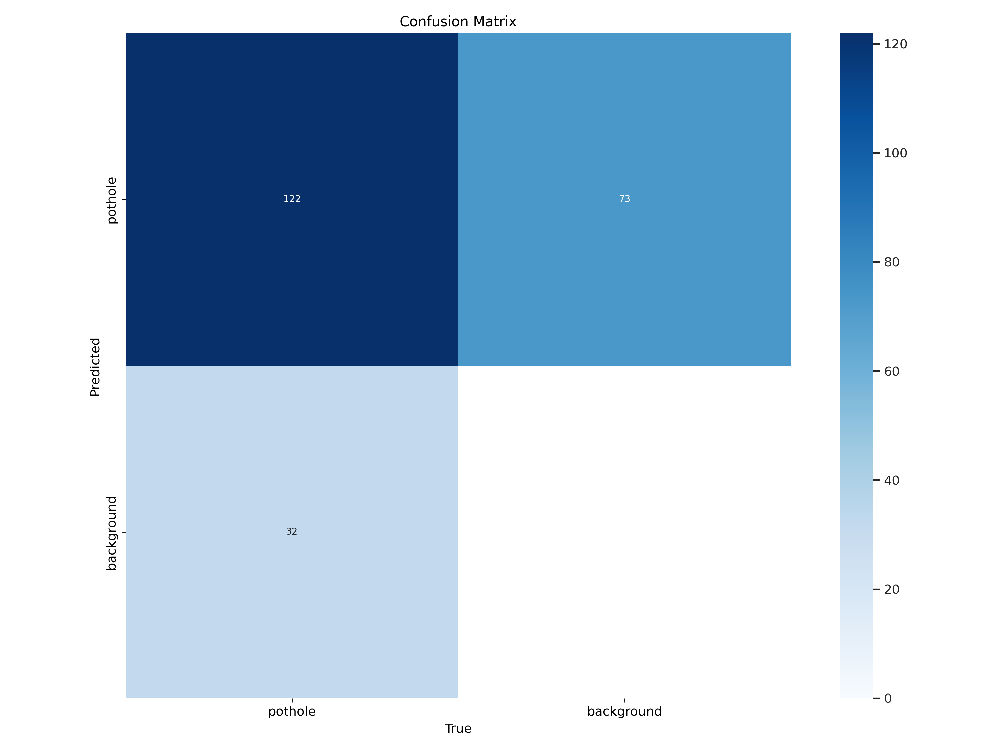

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov5n_aug_ft2/confusion_matrix.png', width=600)

In [ ]:
model_aug_v5_v2.export(format='tflite')

Ultralytics 8.3.61 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.30GHz)
YOLOv5n summary (fused): 193 layers, 2,503,139 parameters, 0 gradients, 7.1 GFLOPs

PyTorch: starting from 'runs/detect/yolov5n_aug_ft2/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (5.0 MB)
requirements: Ultralytics requirements ['sng4onnx>=1.0.1', 'onnx_graphsurgeon>=0.3.26', 'onnx>=1.12.0', 'onnx2tf>1.17.5,<=1.26.3', 'onnxslim>=0.1.31', 'tflite_support', 'onnxruntime-gpu'] not found, attempting AutoUpdate...
Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 146.6/146.6 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.4/56.4 kB 172.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.0/16.0 MB 168.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 445.6/445.6 kB 234.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 142.8/142.8 kB 212.8 M

100%|██████████| 1.11M/1.11M [00:00<00:00, 19.0MB/s]
Unzipping calibration_image_sample_data_20x128x128x3_float32.npy.zip to /content/calibration_image_sample_data_20x128x128x3_float32.npy...: 100%|██████████| 1/1 [00:00<00:00, 49.03file/s]


ONNX: starting export with onnx 1.17.0 opset 19...


ONNX: slimming with onnxslim 0.1.47...
ONNX: export success ✅ 1.0s, saved as 'runs/detect/yolov5n_aug_ft2/weights/best.onnx' (9.9 MB)
TensorFlow SavedModel: starting TFLite export with onnx2tf 1.26.3...
TensorFlow SavedModel: export success ✅ 52.3s, saved as 'runs/detect/yolov5n_aug_ft2/weights/best_saved_model' (25.2 MB)

TensorFlow Lite: starting export with tensorflow 2.17.1...
TensorFlow Lite: export success ✅ 0.0s, saved as 'runs/detect/yolov5n_aug_ft2/weights/best_saved_model/best_float32.tflite' (9.8 MB)

Export complete (54.3s)
Results saved to /content/runs/detect/yolov5n_aug_ft2/weights
Predict:         yolo predict task=detect model=runs/detect/yolov5n_aug_ft2/weights/best_saved_model/best_float32.tflite imgsz=640  
Validate:        yolo val task=detect model=runs/detect/yolov5n_aug_ft2/weights/best_saved_model/best_float32.tflite imgsz=640 data=/content/yolov8-dataset/data.yaml  
Visualize:       https://netron.app


'runs/detect/yolov5n_aug_ft2/weights/best_saved_model/best_float32.tflite'

#### YOLOv6

In [ ]:
print("Training YOLOv6...")
model_aug_v6_v2.train(data=os.path.join(dataset_yolov6.location, 'data.yaml'),
                   name='yolov6n_aug_ft2',
                   epochs=epochs,
                   batch=batch_size,
                   imgsz=imgsz,
                   augment=True,
                   fliplr= 0.5,           # Horizontal flip with 50% probability
                   flipud= 0.1,           # Vertical flip with 10% probability
                   scale= 0.3,            # Scale images ±30%
                   translate= 0.2,        # Translate images ±20%
                   hsv_h=0.015,          # HSV hue adjustment ±1.5%
                   hsv_s=0.7,            # HSV saturation adjustment 70%
                   hsv_v=0.4,            # HSV value (brightness) adjustment 40%
                   degrees=10.0,         # Random rotation ±10 degrees
                   shear= 5.0,            # Shear transformations ±5 degrees
                   perspective=0.001,    # Small perspective distortion
                   mosaic= 1.0,           # Enable mosaic augmentation
                   mixup=0.2             # Enable mixup with 20% probability
)

Training YOLOv6...
Ultralytics 8.3.61 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov6n.yaml, data=/content/yolov6-dataset/data.yaml, epochs=80, time=None, patience=100, batch=64, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov6n_aug_ft2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_la

train: Scanning /content/yolov6-dataset/labels/train... 465 images, 0 backgrounds, 0 corrupt: 100%|██████████| 465/465 [00:00<00:00, 1342.72it/s]

train: New cache created: /content/yolov6-dataset/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/yolov6-dataset/labels/valid... 133 images, 0 backgrounds, 0 corrupt: 100%|██████████| 133/133 [00:00<00:00, 1218.94it/s]

val: New cache created: /content/yolov6-dataset/labels/valid.cache


Plotting labels to runs/detect/yolov6n_aug_ft2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 53 weight(decay=0.0), 62 weight(decay=0.0005), 61 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolov6n_aug_ft2
Starting training for 80 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/80      5.61G      3.692      3.745       4.27        129        640: 100%|██████████| 8/8 [00:03<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.48it/s]

                   all        133        330    0.00173      0.209    0.00137   0.000455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/80      5.67G      3.675      3.722      4.235         76        640: 100%|██████████| 8/8 [00:03<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.30it/s]

                   all        133        330    0.00173      0.209    0.00144   0.000465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/80      5.78G      3.552      3.596      4.147        110        640: 100%|██████████| 8/8 [00:03<00:00,  2.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.57it/s]

                   all        133        330    0.00168      0.203    0.00135   0.000443



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/80      5.74G      3.403      3.511      3.985         81        640: 100%|██████████| 8/8 [00:03<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.88it/s]

                   all        133        330    0.00169      0.203    0.00146   0.000507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/80       5.6G      3.207      3.381      3.773         94        640: 100%|██████████| 8/8 [00:03<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.35it/s]

                   all        133        330    0.00176      0.212    0.00161   0.000522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/80      5.63G      3.036      3.317      3.505         78        640: 100%|██████████| 8/8 [00:03<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.33it/s]

                   all        133        330    0.00166        0.2    0.00182   0.000721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/80      5.68G      2.858      3.228      3.259         85        640: 100%|██████████| 8/8 [00:03<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.85it/s]

                   all        133        330    0.00163      0.197    0.00159   0.000545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/80      5.74G      2.842      3.175       3.14         70        640: 100%|██████████| 8/8 [00:03<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.01it/s]

                   all        133        330    0.00227      0.209    0.00194    0.00064



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/80      5.56G      2.738      3.102      3.009         70        640: 100%|██████████| 8/8 [00:03<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all        133        330   0.000952      0.115   0.000568   0.000167



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/80      5.69G      2.668      3.056       2.92        107        640: 100%|██████████| 8/8 [00:03<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.45it/s]

                   all        133        330     0.0017      0.206    0.00331   0.000944



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/80      5.68G      2.612      3.024      2.823         68        640: 100%|██████████| 8/8 [00:03<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.95it/s]

                   all        133        330    0.00342      0.158    0.00213   0.000759



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/80      5.81G      2.566      2.898      2.769        107        640: 100%|██████████| 8/8 [00:03<00:00,  2.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.75it/s]

                   all        133        330      0.018     0.0121    0.00701    0.00177



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/80      5.77G      2.487      2.886      2.711         71        640: 100%|██████████| 8/8 [00:03<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.32it/s]

                   all        133        330     0.0566     0.0727     0.0118    0.00281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/80      5.82G      2.441      2.843      2.637         86        640: 100%|██████████| 8/8 [00:03<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.99it/s]

                   all        133        330     0.0322     0.0848     0.0079    0.00251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/80      5.72G      2.437      2.814      2.599         92        640: 100%|██████████| 8/8 [00:03<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.23it/s]

                   all        133        330     0.0501     0.0424     0.0169    0.00643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/80      5.66G        2.4      2.725      2.554        118        640: 100%|██████████| 8/8 [00:03<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.41it/s]

                   all        133        330     0.0869     0.0667     0.0239    0.00747



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/80       5.7G      2.335      2.649      2.507         79        640: 100%|██████████| 8/8 [00:03<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.47it/s]

                   all        133        330    0.00918      0.267    0.00563    0.00197



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/80      5.69G      2.287      2.593      2.448        115        640: 100%|██████████| 8/8 [00:03<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.89it/s]

                   all        133        330     0.0685      0.136     0.0345     0.0112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/80      5.61G      2.243      2.556        2.4         89        640: 100%|██████████| 8/8 [00:03<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.16it/s]

                   all        133        330      0.205      0.185      0.122     0.0445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/80      5.91G      2.215      2.477      2.352         95        640: 100%|██████████| 8/8 [00:03<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.74it/s]

                   all        133        330       0.25       0.27      0.204     0.0867



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/80      5.61G      2.208      2.462      2.369         92        640: 100%|██████████| 8/8 [00:03<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.53it/s]

                   all        133        330      0.194      0.236      0.127     0.0463



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/80      5.68G      2.237      2.447      2.317        119        640: 100%|██████████| 8/8 [00:03<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.88it/s]

                   all        133        330      0.276      0.197      0.155     0.0563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/80      5.72G       2.11      2.379       2.27         85        640: 100%|██████████| 8/8 [00:03<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.92it/s]

                   all        133        330      0.334      0.255      0.214     0.0762



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/80      5.64G      2.181      2.402      2.326         88        640: 100%|██████████| 8/8 [00:03<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.25it/s]

                   all        133        330      0.511      0.245      0.297      0.125



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/80      5.72G      2.148      2.395      2.291         75        640: 100%|██████████| 8/8 [00:03<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.90it/s]

                   all        133        330      0.246       0.19      0.139     0.0521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/80      5.73G      2.095      2.325      2.234        143        640: 100%|██████████| 8/8 [00:03<00:00,  2.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.05it/s]

                   all        133        330      0.304      0.188      0.173      0.058



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/80      5.61G      2.097       2.33      2.226        135        640: 100%|██████████| 8/8 [00:03<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.25it/s]

                   all        133        330      0.285       0.27      0.192     0.0757



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/80      5.74G      2.045      2.284      2.191        111        640: 100%|██████████| 8/8 [00:03<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.75it/s]

                   all        133        330      0.518      0.294      0.339      0.148



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/80      5.74G      2.112      2.253      2.223        111        640: 100%|██████████| 8/8 [00:03<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.89it/s]

                   all        133        330      0.509      0.378      0.383      0.155



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/80      5.75G      2.026      2.231      2.153         76        640: 100%|██████████| 8/8 [00:03<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.17it/s]

                   all        133        330      0.428      0.378      0.364       0.16



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/80      5.63G      2.016      2.209       2.14         93        640: 100%|██████████| 8/8 [00:03<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.38it/s]

                   all        133        330      0.225      0.239       0.17     0.0748



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/80       5.7G      2.062      2.272      2.192        104        640: 100%|██████████| 8/8 [00:03<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.27it/s]

                   all        133        330      0.326      0.279      0.221     0.0854



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/80      5.69G      2.068       2.25      2.195         89        640: 100%|██████████| 8/8 [00:03<00:00,  2.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.53it/s]

                   all        133        330      0.337      0.252      0.214     0.0925



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/80      5.74G      1.969       2.17        2.1         69        640: 100%|██████████| 8/8 [00:03<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.23it/s]

                   all        133        330      0.443      0.452        0.4      0.176



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/80      5.59G      2.015      2.123      2.104         81        640: 100%|██████████| 8/8 [00:03<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.84it/s]

                   all        133        330      0.475      0.352      0.361      0.149



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/80      5.73G      1.988      2.159      2.119        102        640: 100%|██████████| 8/8 [00:03<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.35it/s]

                   all        133        330      0.566      0.364      0.411      0.172



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/80      5.75G      1.982      2.102      2.099         89        640: 100%|██████████| 8/8 [00:03<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.27it/s]

                   all        133        330      0.453      0.355      0.329      0.141



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/80      5.75G      1.957      2.113      2.113         91        640: 100%|██████████| 8/8 [00:03<00:00,  2.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.32it/s]

                   all        133        330      0.521      0.403      0.397      0.168



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/80      5.57G      1.964      2.081      2.073        125        640: 100%|██████████| 8/8 [00:03<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.88it/s]

                   all        133        330      0.577      0.438      0.478      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/80      6.21G      1.939      2.103      2.075         78        640: 100%|██████████| 8/8 [00:03<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.69it/s]

                   all        133        330      0.619      0.413      0.476      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/80      5.81G      1.974      2.076      2.077         72        640: 100%|██████████| 8/8 [00:03<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.60it/s]

                   all        133        330      0.513      0.464      0.442      0.198



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/80      5.72G      1.973      2.078      2.063        102        640: 100%|██████████| 8/8 [00:03<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.51it/s]

                   all        133        330      0.607      0.485      0.512      0.242



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/80      5.64G      1.976      2.057      2.066        112        640: 100%|██████████| 8/8 [00:03<00:00,  2.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.18it/s]

                   all        133        330      0.566      0.439      0.458      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/80       5.7G      1.918       2.02      2.026        102        640: 100%|██████████| 8/8 [00:03<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.82it/s]

                   all        133        330      0.505      0.469      0.492      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/80      5.78G      1.947      2.034      2.065         87        640: 100%|██████████| 8/8 [00:03<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.71it/s]

                   all        133        330      0.631      0.461      0.472      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/80      5.75G      1.939      2.075      2.072         86        640: 100%|██████████| 8/8 [00:03<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]

                   all        133        330      0.529      0.461       0.49      0.227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/80      5.66G      1.892       2.01      2.028        111        640: 100%|██████████| 8/8 [00:03<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.46it/s]

                   all        133        330      0.562      0.461      0.514      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/80      5.83G      1.929      2.038       2.07         97        640: 100%|██████████| 8/8 [00:03<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.46it/s]

                   all        133        330      0.582      0.477        0.5      0.211



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/80      6.08G      1.892      1.991      1.964        111        640: 100%|██████████| 8/8 [00:03<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.55it/s]

                   all        133        330      0.559      0.476      0.491      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/80      5.65G      1.932       2.02      2.015         92        640: 100%|██████████| 8/8 [00:03<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.70it/s]

                   all        133        330      0.579      0.448      0.493      0.232



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      51/80      5.81G      1.897      2.006      2.008         72        640: 100%|██████████| 8/8 [00:03<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.70it/s]

                   all        133        330       0.62      0.485      0.552      0.257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      52/80       5.7G      1.901      2.002      2.037         83        640: 100%|██████████| 8/8 [00:03<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.44it/s]

                   all        133        330      0.636      0.466      0.532      0.225



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      53/80      5.69G      1.878      1.967      2.014         80        640: 100%|██████████| 8/8 [00:03<00:00,  2.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.87it/s]

                   all        133        330      0.651      0.485      0.564      0.264



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      54/80      5.64G      1.901      1.929          2         82        640: 100%|██████████| 8/8 [00:03<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.94it/s]

                   all        133        330      0.525      0.473      0.506      0.222



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      55/80      5.74G      1.865      1.929      1.961        134        640: 100%|██████████| 8/8 [00:03<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.23it/s]

                   all        133        330      0.579      0.476      0.502      0.239



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      56/80      5.71G      1.851      1.907      1.958         92        640: 100%|██████████| 8/8 [00:03<00:00,  2.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.47it/s]

                   all        133        330      0.723      0.476       0.59      0.268



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      57/80      5.65G      1.876      1.961      1.985         89        640: 100%|██████████| 8/8 [00:03<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.14it/s]

                   all        133        330      0.489      0.548       0.51      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      58/80      5.83G      1.866      1.931      1.969         66        640: 100%|██████████| 8/8 [00:03<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.04it/s]

                   all        133        330      0.657      0.465      0.526      0.246



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      59/80      5.62G      1.876      1.936      1.971         99        640: 100%|██████████| 8/8 [00:03<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.76it/s]

                   all        133        330      0.706      0.476      0.579      0.258



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      60/80      5.73G      1.845      1.943      1.954        109        640: 100%|██████████| 8/8 [00:03<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.72it/s]

                   all        133        330      0.586      0.527      0.588      0.267



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      61/80      5.57G      1.827      1.905      1.947         94        640: 100%|██████████| 8/8 [00:03<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.70it/s]

                   all        133        330      0.622      0.509      0.584      0.249



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      62/80       5.7G      1.855      1.893      1.961        106        640: 100%|██████████| 8/8 [00:03<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.82it/s]

                   all        133        330      0.702      0.488      0.563      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      63/80      5.67G      1.856      1.892      1.961         90        640: 100%|██████████| 8/8 [00:03<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.09it/s]

                   all        133        330      0.594      0.558       0.57      0.266



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      64/80      5.81G      1.864      1.854       1.94         93        640: 100%|██████████| 8/8 [00:03<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.33it/s]

                   all        133        330       0.64      0.522      0.598      0.249



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      65/80      5.59G      1.797      1.818      1.899         92        640: 100%|██████████| 8/8 [00:03<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.25it/s]

                   all        133        330      0.657      0.512      0.575      0.256



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      66/80      5.81G      1.847      1.858      1.944        116        640: 100%|██████████| 8/8 [00:03<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.31it/s]

                   all        133        330      0.695      0.518      0.593      0.265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      67/80      5.57G      1.834      1.824      1.912         99        640: 100%|██████████| 8/8 [00:03<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.10it/s]

                   all        133        330      0.672      0.545       0.61      0.287



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      68/80      5.59G      1.835      1.837      1.923        106        640: 100%|██████████| 8/8 [00:03<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.19it/s]

                   all        133        330      0.718      0.515      0.632      0.287



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      69/80      5.74G       1.83       1.81      1.932         90        640: 100%|██████████| 8/8 [00:03<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.70it/s]

                   all        133        330      0.639      0.536      0.609      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      70/80      5.68G      1.804      1.826      1.917         78        640: 100%|██████████| 8/8 [00:03<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.47it/s]

                   all        133        330      0.622      0.552      0.608      0.294


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      71/80      5.69G      1.541      1.672      1.713         38        640: 100%|██████████| 8/8 [00:05<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.42it/s]

                   all        133        330      0.599      0.552      0.583      0.262



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      72/80      5.84G      1.559      1.605      1.727         43        640: 100%|██████████| 8/8 [00:03<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.36it/s]

                   all        133        330      0.669      0.512      0.599      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      73/80      5.76G      1.516      1.488      1.674         39        640: 100%|██████████| 8/8 [00:03<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.60it/s]

                   all        133        330      0.675      0.555      0.637      0.304



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      74/80      5.81G      1.533      1.458      1.689         38        640: 100%|██████████| 8/8 [00:03<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.76it/s]

                   all        133        330      0.695      0.545      0.644      0.317



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      75/80      5.83G      1.543      1.457      1.685         36        640: 100%|██████████| 8/8 [00:03<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.72it/s]

                   all        133        330      0.705      0.542      0.631      0.291



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      76/80      5.79G      1.486      1.387      1.632         41        640: 100%|██████████| 8/8 [00:03<00:00,  2.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.57it/s]

                   all        133        330      0.665      0.579      0.632      0.306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      77/80      5.79G       1.52      1.384      1.634         62        640: 100%|██████████| 8/8 [00:03<00:00,  2.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.73it/s]

                   all        133        330      0.701      0.542      0.637       0.31



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      78/80      5.79G      1.502      1.377      1.617         93        640: 100%|██████████| 8/8 [00:03<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.88it/s]

                   all        133        330      0.734      0.552      0.644       0.32



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      79/80      5.81G      1.485      1.385       1.65         63        640: 100%|██████████| 8/8 [00:03<00:00,  2.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.81it/s]

                   all        133        330      0.709      0.576      0.651      0.312



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      80/80      5.77G      1.501      1.367      1.642         58        640: 100%|██████████| 8/8 [00:03<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.63it/s]

                   all        133        330      0.732      0.564       0.65      0.305



80 epochs completed in 0.118 hours.
Optimizer stripped from runs/detect/yolov6n_aug_ft2/weights/last.pt, 8.7MB
Optimizer stripped from runs/detect/yolov6n_aug_ft2/weights/best.pt, 8.7MB

Validating runs/detect/yolov6n_aug_ft2/weights/best.pt...
Ultralytics 8.3.61 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv6n summary (fused): 142 layers, 4,233,843 parameters, 0 gradients, 11.8 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]


                   all        133        330      0.681      0.579      0.651      0.329
Speed: 0.2ms preprocess, 6.3ms inference, 0.0ms loss, 1.7ms postprocess per image
Results saved to runs/detect/yolov6n_aug_ft2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ca5dc9af730>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

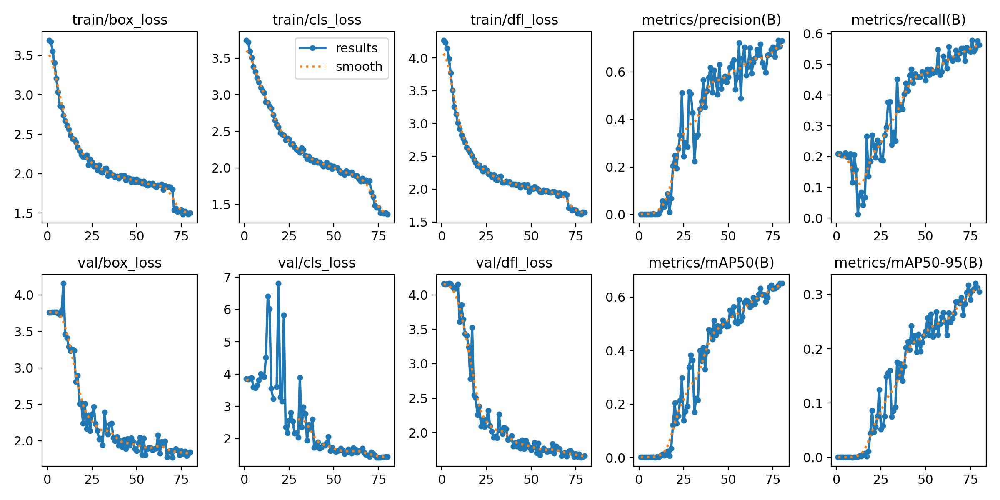

In [ ]:
Image(filename=f'/content/runs/detect/yolov6n_aug_ft2/results.png', width=600)

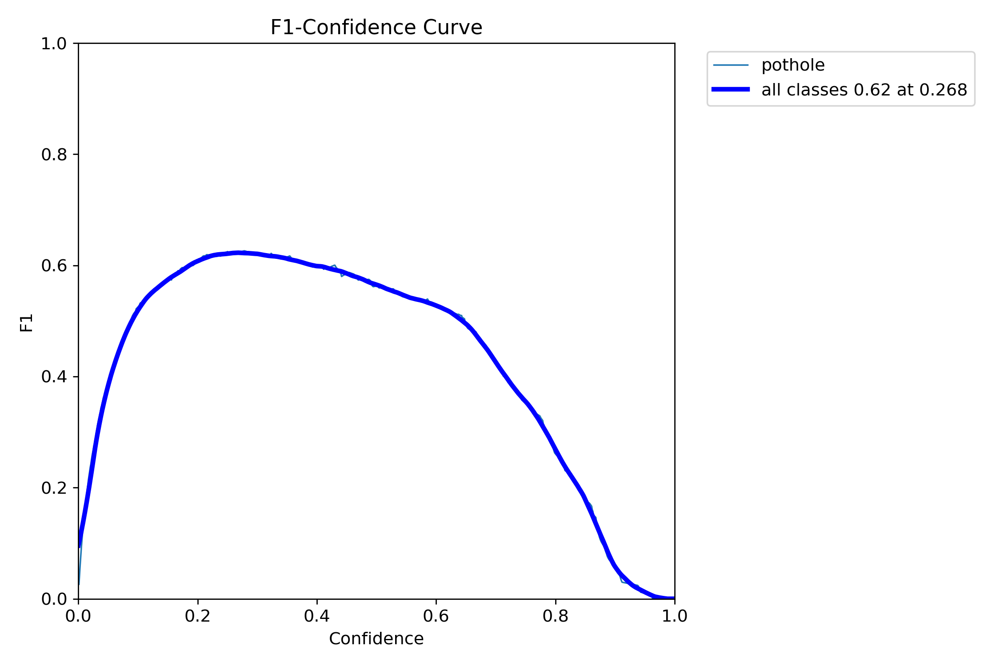

In [ ]:
Image(filename=f'/content/runs/detect/yolov6n_aug_ft2/F1_curve.png', width=600)

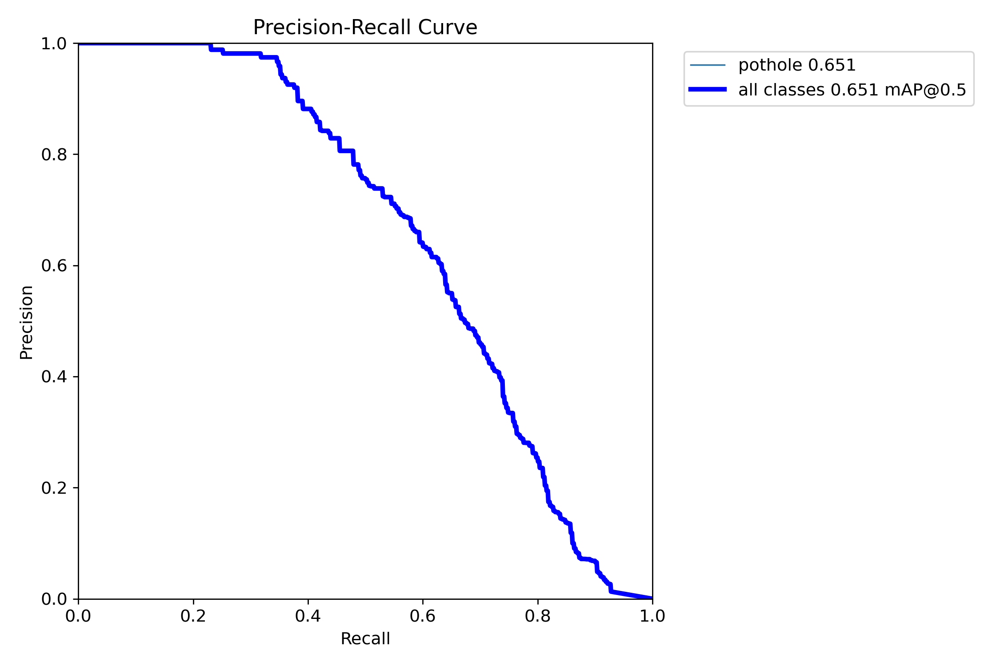

In [ ]:
Image(filename=f'/content/runs/detect/yolov6n_aug_ft2/PR_curve.png', width=600)

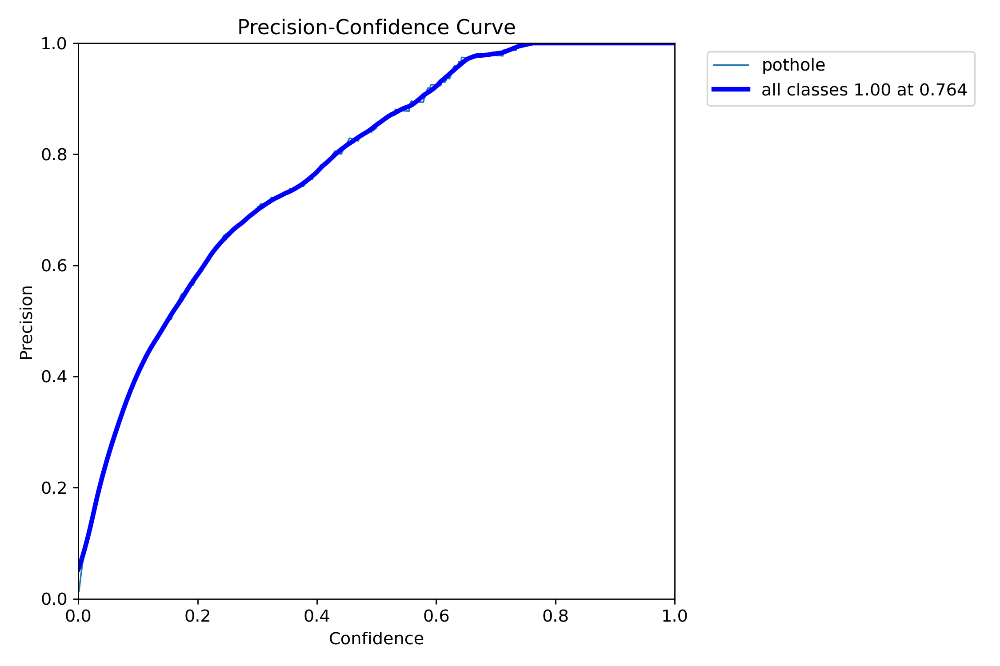

In [ ]:
Image(filename=f'/content/runs/detect/yolov6n_aug_ft2/P_curve.png', width=600)

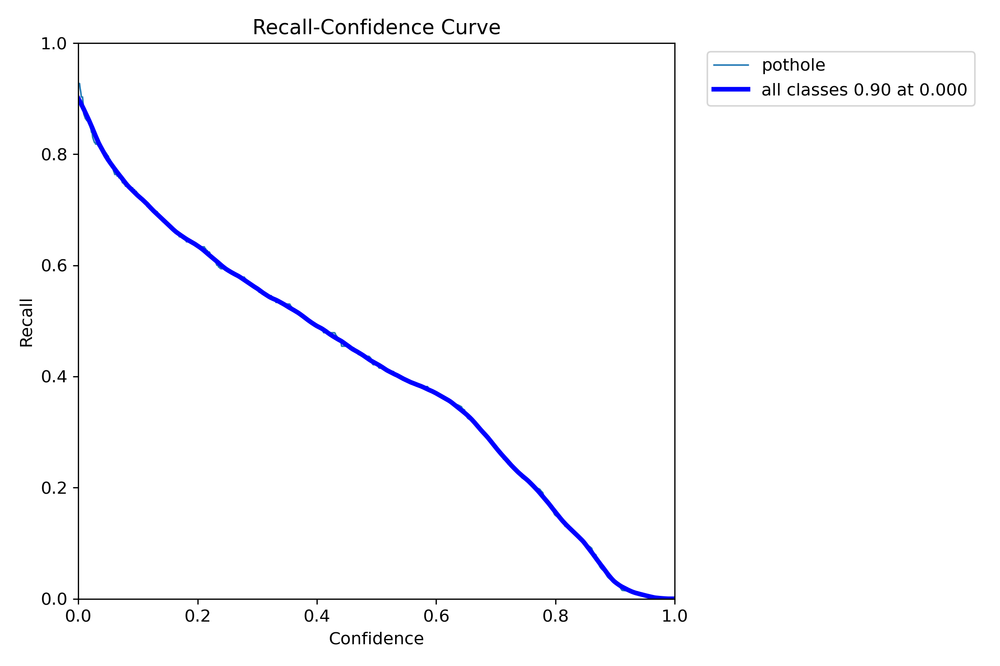

In [ ]:
Image(filename=f'/content/runs/detect/yolov6n_aug_ft2/R_curve.png', width=600)

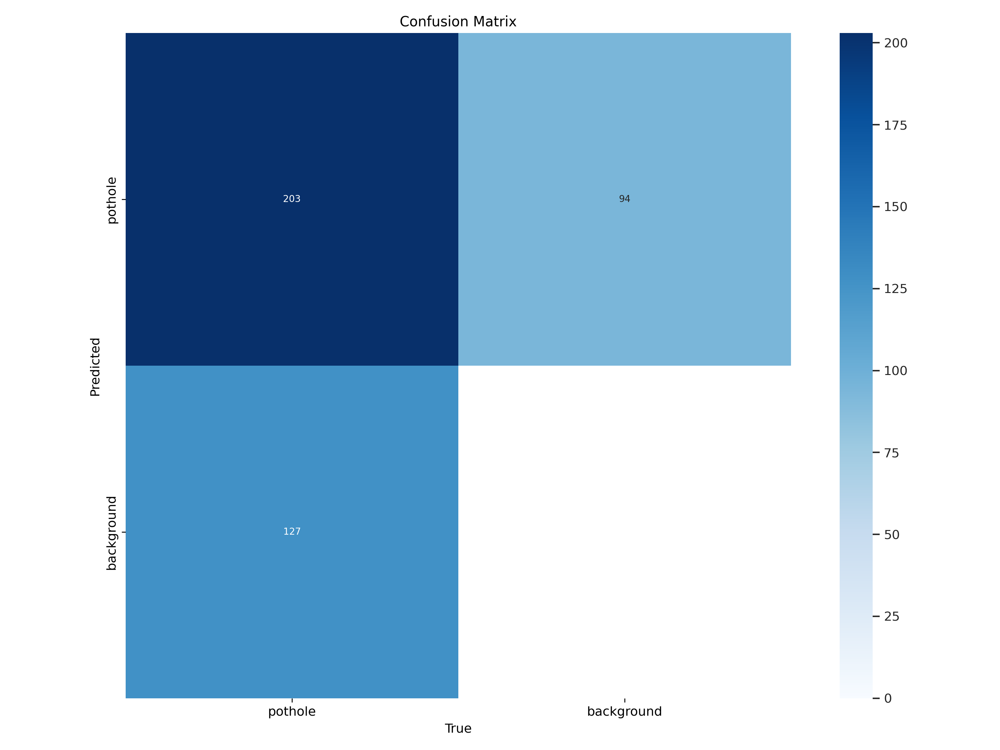

In [ ]:
Image(filename=f'/content/runs/detect/yolov6n_aug_ft2/confusion_matrix.png', width=600)

In [ ]:
metrics_v6_v2 = '/content/runs/detect/yolov6n_aug_ft2/results.csv'

In [ ]:
results_v6_v2 = model_aug_v6_v2.val(name='test_yolov6n_aug_ft2',split='test')

Ultralytics 8.3.61 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv6n summary (fused): 142 layers, 4,233,843 parameters, 0 gradients, 11.8 GFLOPs


val: Scanning /content/yolov6-dataset/labels/test... 67 images, 0 backgrounds, 0 corrupt: 100%|██████████| 67/67 [00:00<00:00, 1438.44it/s]

val: New cache created: /content/yolov6-dataset/labels/test.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.25s/it]


                   all         67        154      0.684       0.63      0.685       0.34
Speed: 1.0ms preprocess, 16.2ms inference, 0.0ms loss, 1.6ms postprocess per image
Results saved to runs/detect/test_yolov6n_aug_ft2


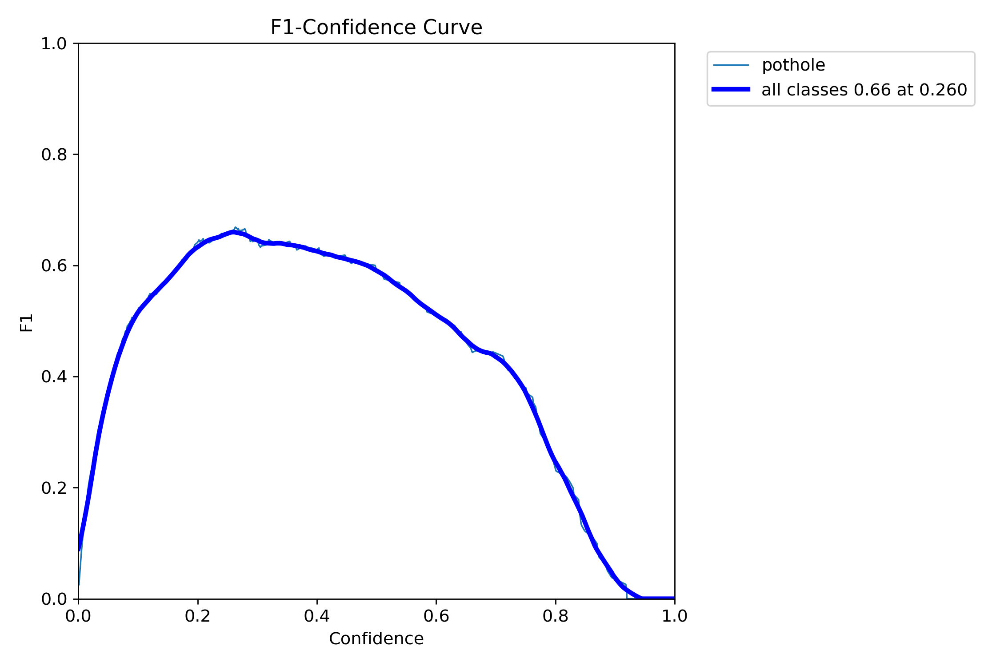

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov6n_aug_ft2/F1_curve.png', width=600)

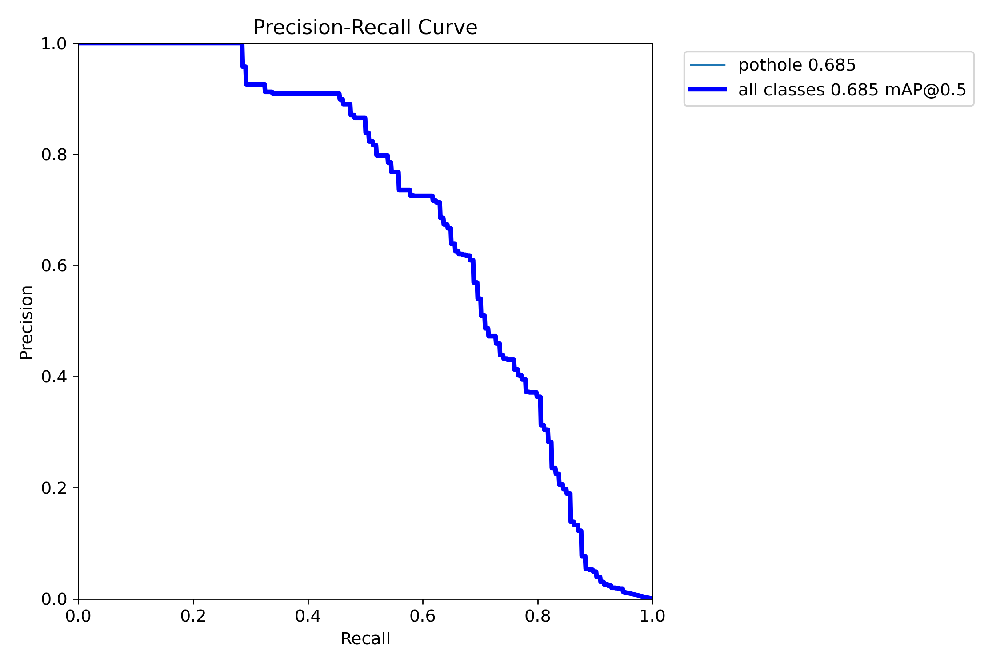

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov6n_aug_ft2/PR_curve.png', width=600)

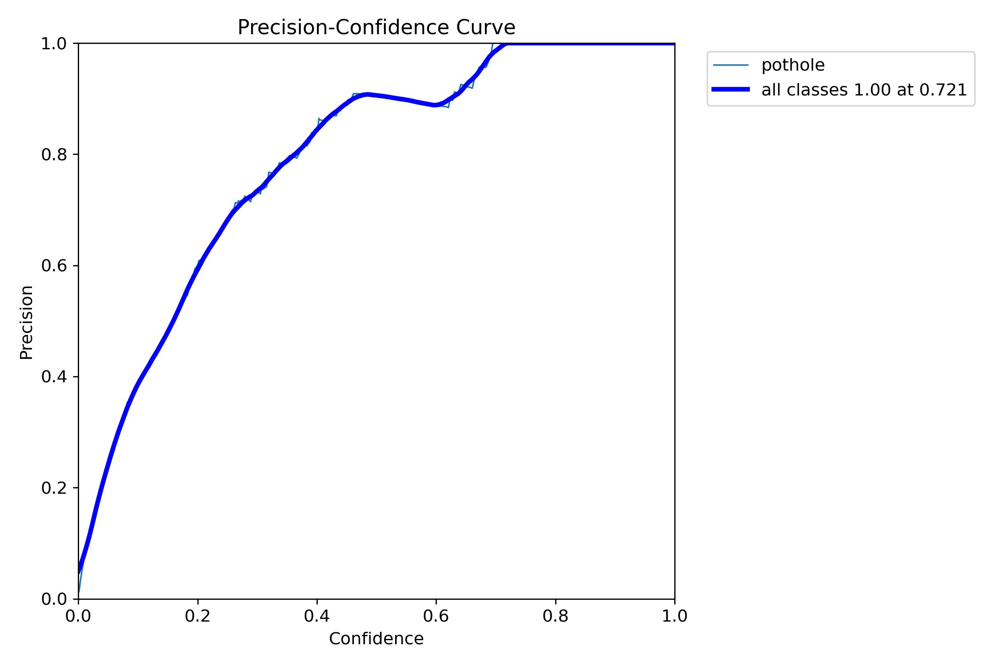

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov6n_aug_ft2/P_curve.png', width=600)

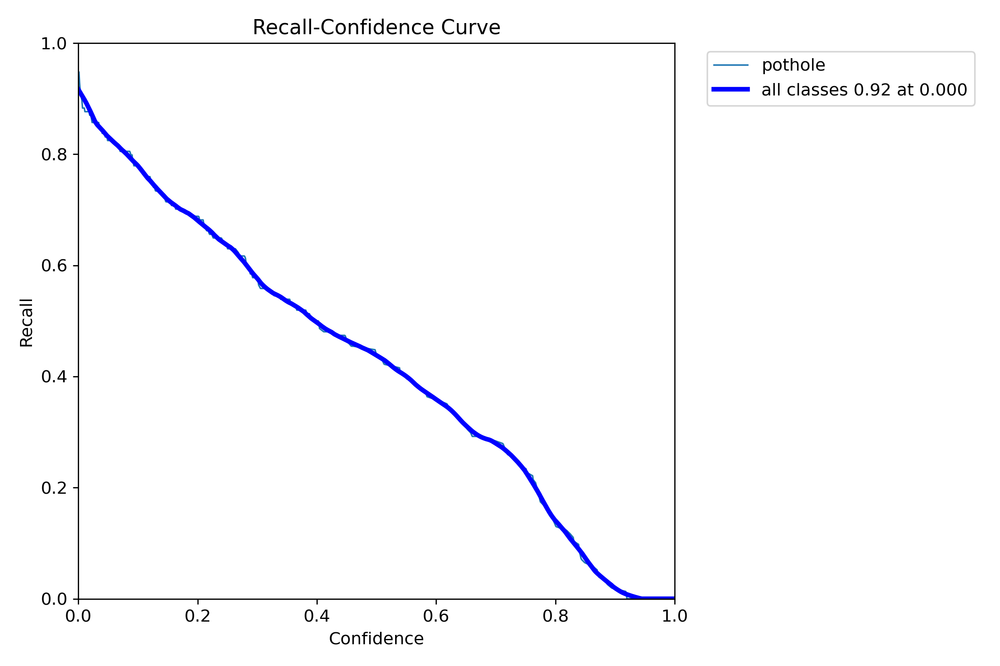

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov6n_aug_ft2/R_curve.png', width=600)

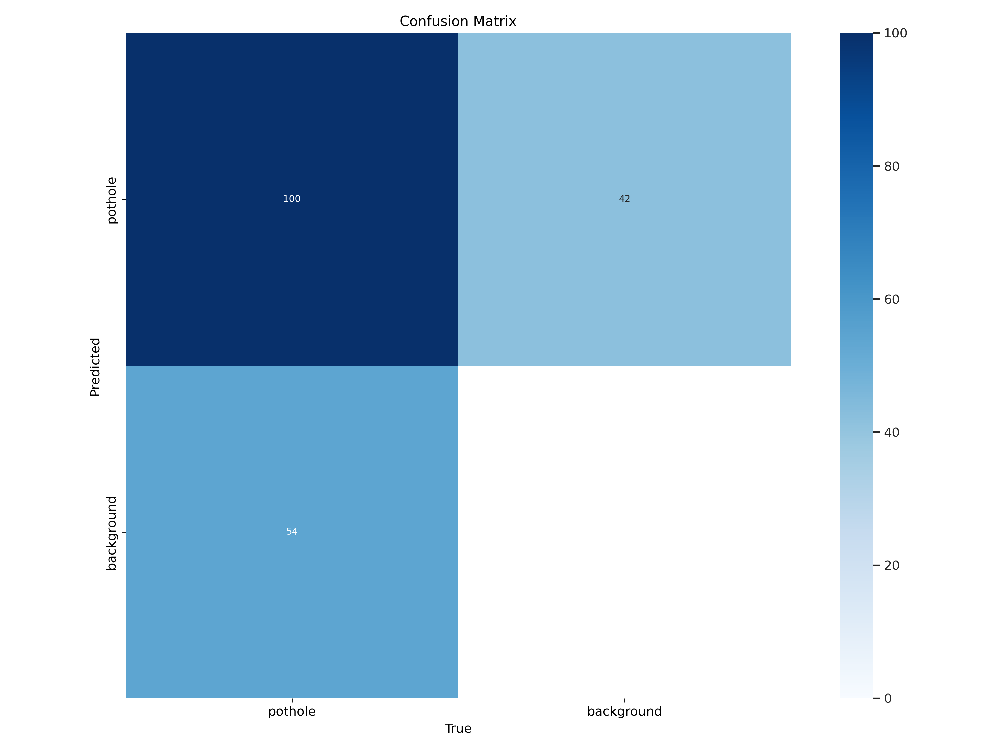

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov6n_aug_ft2/confusion_matrix.png', width=600)

In [ ]:
model_aug_v6_v2.export(format='tflite')

Ultralytics 8.3.61 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.30GHz)

PyTorch: starting from 'runs/detect/yolov6n_aug_ft2/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (8.3 MB)

TensorFlow SavedModel: starting export with tensorflow 2.17.1...

ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.47...
ONNX: export success ✅ 1.8s, saved as 'runs/detect/yolov6n_aug_ft2/weights/best.onnx' (16.4 MB)
TensorFlow SavedModel: starting TFLite export with onnx2tf 1.26.3...
TensorFlow SavedModel: export success ✅ 30.9s, saved as 'runs/detect/yolov6n_aug_ft2/weights/best_saved_model' (41.6 MB)

TensorFlow Lite: starting export with tensorflow 2.17.1...
TensorFlow Lite: export success ✅ 0.0s, saved as 'runs/detect/yolov6n_aug_ft2/weights/best_saved_model/best_float32.tflite' (16.4 MB)

Export complete (31.4s)
Results saved to /content/runs/detect/yolov6n_aug_ft2/weights
Predict:         yolo predict task=detect mode

'runs/detect/yolov6n_aug_ft2/weights/best_saved_model/best_float32.tflite'

#### YOLOv8

In [ ]:
print("Training YOLOv8...")
model_aug_v8_v2.train(data=os.path.join(dataset_yolov8.location, 'data.yaml'),
                   name="yolov8n_aug_ft2",
                   epochs=epochs,
                   batch=batch_size,
                   imgsz=imgsz,
                   device=0,
                   augment=True,
                   fliplr= 0.5,           # Horizontal flip with 50% probability
                   flipud= 0.1,           # Vertical flip with 10% probability
                   scale= 0.3,            # Scale images ±30%
                   translate= 0.2,        # Translate images ±20%
                   hsv_h=0.015,          # HSV hue adjustment ±1.5%
                   hsv_s=0.7,            # HSV saturation adjustment 70%
                   hsv_v=0.4,            # HSV value (brightness) adjustment 40%
                   degrees=10.0,         # Random rotation ±10 degrees
                   shear= 5.0,            # Shear transformations ±5 degrees
                   perspective=0.001,    # Small perspective distortion
                   mosaic= 1.0,           # Enable mosaic augmentation
                   mixup=0.2             # Enable mixup with 20% probability
)

Training YOLOv8...
Ultralytics 8.3.61 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/yolov8-dataset/data.yaml, epochs=80, time=None, patience=100, batch=64, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=yolov8n_aug_ft2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=

train: Scanning /content/yolov8-dataset/train/labels.cache... 465 images, 0 backgrounds, 0 corrupt: 100%|██████████| 465/465 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/yolov8-dataset/valid/labels.cache... 133 images, 0 backgrounds, 0 corrupt: 100%|██████████| 133/133 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov8n_aug_ft2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolov8n_aug_ft2
Starting training for 80 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/80      6.52G      2.505      3.424      2.267        129        640: 100%|██████████| 8/8 [00:04<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.25it/s]

                   all        133        330    0.00133      0.161    0.00124    0.00033



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/80      6.95G      2.309       3.24      2.128         76        640: 100%|██████████| 8/8 [00:03<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.62it/s]

                   all        133        330    0.00143      0.173    0.00215   0.000502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/80      6.85G      1.973      2.632      1.876        110        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.13it/s]

                   all        133        330    0.00221      0.267    0.00249   0.000831



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/80      6.82G      1.898      2.415      1.783         81        640: 100%|██████████| 8/8 [00:03<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.34it/s]

                   all        133        330    0.00479      0.579     0.0256    0.00927



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/80      6.88G       1.83       2.22      1.719         94        640: 100%|██████████| 8/8 [00:03<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.38it/s]

                   all        133        330    0.00506      0.612     0.0283     0.0109



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/80      6.92G      1.841      2.161      1.706         78        640: 100%|██████████| 8/8 [00:03<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.36it/s]

                   all        133        330     0.0956     0.0788     0.0291    0.00827



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/80      6.76G       1.82      2.086      1.722         85        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.97it/s]

                   all        133        330      0.187     0.0909     0.0486     0.0155



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/80      6.82G      1.839      2.115      1.769         70        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.96it/s]

                   all        133        330      0.331     0.0788     0.0982     0.0373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/80      6.64G      1.844      2.068      1.755         70        640: 100%|██████████| 8/8 [00:03<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.80it/s]

                   all        133        330     0.0106      0.133    0.00944    0.00361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/80      6.76G      1.922      2.077      1.791        107        640: 100%|██████████| 8/8 [00:03<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.15it/s]

                   all        133        330      0.128      0.118     0.0482     0.0134



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/80      6.76G      1.868      2.043      1.782         68        640: 100%|██████████| 8/8 [00:03<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.17it/s]

                   all        133        330      0.263     0.0667      0.053     0.0152



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/80      6.73G      1.869      2.041      1.783        107        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.76it/s]

                   all        133        330    0.00631      0.212    0.00481    0.00157



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/80      6.85G      1.858      1.988      1.749         71        640: 100%|██████████| 8/8 [00:03<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.56it/s]

                   all        133        330      0.351      0.118      0.106     0.0398



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/80      6.74G      1.868      1.983       1.76         86        640: 100%|██████████| 8/8 [00:03<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.90it/s]

                   all        133        330      0.229      0.118     0.0716     0.0251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/80       6.8G      1.866      1.927      1.739         92        640: 100%|██████████| 8/8 [00:03<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.63it/s]

                   all        133        330    0.00389      0.303    0.00275   0.000923



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/80      6.74G      1.883      1.956      1.758        118        640: 100%|██████████| 8/8 [00:03<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.72it/s]

                   all        133        330      0.201      0.127     0.0919     0.0389



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/80      6.78G      1.814      1.885      1.715         79        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.79it/s]

                   all        133        330      0.159     0.0576     0.0329     0.0124



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/80      6.76G      1.797       1.84      1.685        115        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.79it/s]

                   all        133        330      0.341      0.267      0.227     0.0772



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/80       6.9G      1.785      1.842      1.686         89        640: 100%|██████████| 8/8 [00:03<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.59it/s]

                   all        133        330      0.353      0.261      0.219     0.0738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/80      6.77G      1.768      1.827      1.656         95        640: 100%|██████████| 8/8 [00:03<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.40it/s]

                   all        133        330      0.208      0.207      0.122     0.0553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/80       6.9G      1.761      1.859      1.718         92        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.83it/s]

                   all        133        330      0.502      0.382      0.404      0.175



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/80      6.97G      1.792      1.769      1.704        119        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.82it/s]

                   all        133        330      0.617      0.339      0.395      0.158



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/80       6.8G      1.756      1.746      1.686         85        640: 100%|██████████| 8/8 [00:03<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.67it/s]

                   all        133        330       0.49      0.296      0.304      0.129



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/80      6.93G      1.786      1.785      1.693         88        640: 100%|██████████| 8/8 [00:03<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.52it/s]

                   all        133        330      0.523      0.349      0.372      0.155



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/80       6.8G      1.775      1.789      1.687         75        640: 100%|██████████| 8/8 [00:03<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.85it/s]

                   all        133        330      0.377       0.23       0.24      0.103



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/80      6.81G      1.734      1.761      1.645        143        640: 100%|██████████| 8/8 [00:03<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.85it/s]

                   all        133        330      0.529      0.412      0.431      0.179



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/80       6.9G      1.754      1.699       1.64        135        640: 100%|██████████| 8/8 [00:03<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.74it/s]

                   all        133        330      0.494      0.324      0.343       0.16



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/80      6.82G      1.734      1.739       1.64        111        640: 100%|██████████| 8/8 [00:03<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.70it/s]

                   all        133        330      0.647      0.364       0.46      0.227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/80      6.82G      1.728      1.674      1.628        111        640: 100%|██████████| 8/8 [00:03<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.44it/s]

                   all        133        330      0.455        0.4      0.359      0.155



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/80      6.83G      1.716      1.676      1.631         76        640: 100%|██████████| 8/8 [00:03<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.62it/s]

                   all        133        330      0.679      0.467      0.526      0.264



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/80      6.64G       1.69      1.612      1.614         93        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.75it/s]

                   all        133        330      0.511      0.488       0.43      0.212



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/80      6.78G       1.71      1.678      1.619        104        640: 100%|██████████| 8/8 [00:03<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.86it/s]

                   all        133        330      0.477      0.477      0.434      0.196



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/80      6.76G      1.684      1.611      1.599         89        640: 100%|██████████| 8/8 [00:03<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.74it/s]

                   all        133        330      0.679      0.533      0.597      0.286



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/80      6.82G      1.664      1.605      1.573         69        640: 100%|██████████| 8/8 [00:03<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.53it/s]

                   all        133        330      0.522       0.47      0.508      0.218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/80      6.88G       1.68      1.584      1.583         81        640: 100%|██████████| 8/8 [00:03<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.60it/s]

                   all        133        330      0.691       0.57      0.624       0.27



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/80       6.8G      1.677      1.573      1.619        102        640: 100%|██████████| 8/8 [00:03<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.10it/s]

                   all        133        330      0.631      0.567      0.581      0.249



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/80      6.76G       1.67      1.564      1.598         89        640: 100%|██████████| 8/8 [00:03<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.36it/s]

                   all        133        330      0.648      0.535      0.572      0.267



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/80      6.83G       1.66      1.566      1.592         91        640: 100%|██████████| 8/8 [00:03<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.31it/s]

                   all        133        330      0.701      0.652      0.686      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/80      6.86G      1.659       1.55      1.588        125        640: 100%|██████████| 8/8 [00:03<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.77it/s]

                   all        133        330      0.679      0.614      0.646      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/80      7.12G      1.657       1.56       1.59         78        640: 100%|██████████| 8/8 [00:03<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.69it/s]

                   all        133        330      0.693      0.609       0.67      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/80      6.73G      1.648      1.535      1.607         72        640: 100%|██████████| 8/8 [00:03<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.69it/s]

                   all        133        330      0.639      0.597      0.631       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/80       6.8G      1.663      1.537      1.602        102        640: 100%|██████████| 8/8 [00:03<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.65it/s]

                   all        133        330      0.695      0.582      0.624      0.312



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/80      6.72G      1.676       1.53      1.601        112        640: 100%|██████████| 8/8 [00:03<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.77it/s]

                   all        133        330      0.635      0.582      0.624      0.275



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/80      6.78G      1.615      1.486      1.557        102        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.84it/s]

                   all        133        330      0.717      0.552      0.649      0.263



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/80      6.85G      1.644      1.487       1.59         87        640: 100%|██████████| 8/8 [00:03<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.80it/s]

                   all        133        330      0.736      0.597      0.684      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/80      6.83G      1.622      1.534      1.586         86        640: 100%|██████████| 8/8 [00:03<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.77it/s]

                   all        133        330      0.761       0.56       0.66      0.292



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/80      6.74G      1.602      1.476      1.559        111        640: 100%|██████████| 8/8 [00:03<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.65it/s]

                   all        133        330      0.778      0.586      0.673      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/80      6.74G      1.663      1.515      1.603         97        640: 100%|██████████| 8/8 [00:03<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.68it/s]

                   all        133        330      0.753      0.594      0.673      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/80      7.16G      1.569      1.447      1.512        111        640: 100%|██████████| 8/8 [00:03<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.80it/s]

                   all        133        330      0.768      0.621      0.709      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/80      6.94G      1.595      1.471      1.534         92        640: 100%|██████████| 8/8 [00:03<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.74it/s]

                   all        133        330      0.711      0.591      0.655      0.287



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      51/80      6.73G      1.594      1.469      1.549         72        640: 100%|██████████| 8/8 [00:03<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.72it/s]

                   all        133        330       0.73      0.582      0.659      0.273



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      52/80      6.78G      1.606      1.502      1.563         83        640: 100%|██████████| 8/8 [00:03<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.66it/s]

                   all        133        330      0.783      0.579      0.691      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      53/80      6.77G      1.578      1.436      1.546         80        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.84it/s]

                   all        133        330      0.787      0.621      0.715      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      54/80      6.93G      1.587      1.417      1.535         82        640: 100%|██████████| 8/8 [00:03<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.66it/s]

                   all        133        330      0.718      0.648      0.709      0.332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      55/80      6.82G      1.556      1.391      1.516        134        640: 100%|██████████| 8/8 [00:03<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.46it/s]

                   all        133        330      0.692      0.652      0.703      0.357



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      56/80      6.78G       1.55      1.397      1.518         92        640: 100%|██████████| 8/8 [00:03<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.68it/s]

                   all        133        330      0.778      0.633      0.726      0.363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      57/80      6.94G      1.582      1.442       1.53         89        640: 100%|██████████| 8/8 [00:03<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.85it/s]

                   all        133        330       0.73      0.609      0.673        0.3



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      58/80      6.74G      1.541      1.418      1.496         66        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.82it/s]

                   all        133        330      0.764      0.624      0.719      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      59/80      6.92G      1.569      1.434      1.509         99        640: 100%|██████████| 8/8 [00:03<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.62it/s]

                   all        133        330       0.79      0.615      0.716      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      60/80       6.8G       1.55      1.402      1.507        109        640: 100%|██████████| 8/8 [00:03<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.69it/s]

                   all        133        330       0.73      0.627      0.711       0.35



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      61/80      6.86G      1.522      1.366      1.498         94        640: 100%|██████████| 8/8 [00:03<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.61it/s]

                   all        133        330      0.796      0.603      0.714      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      62/80      6.78G      1.557      1.379      1.507        106        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.78it/s]

                   all        133        330      0.748      0.652      0.736      0.362



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      63/80      6.74G      1.563      1.374      1.506         90        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.85it/s]

                   all        133        330      0.794      0.612      0.725       0.36



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      64/80      6.73G      1.559      1.348      1.487         93        640: 100%|██████████| 8/8 [00:03<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.72it/s]

                   all        133        330      0.782      0.661      0.736       0.35



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      65/80      6.88G      1.495      1.293      1.443         92        640: 100%|██████████| 8/8 [00:03<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.30it/s]

                   all        133        330      0.822      0.631      0.748      0.402



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      66/80      6.73G      1.573      1.349      1.514        116        640: 100%|██████████| 8/8 [00:03<00:00,  2.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.67it/s]

                   all        133        330      0.852       0.63      0.755      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      67/80      6.87G      1.546       1.34      1.487         99        640: 100%|██████████| 8/8 [00:03<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.70it/s]

                   all        133        330      0.758      0.685      0.762       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      68/80      6.88G       1.54      1.334      1.482        106        640: 100%|██████████| 8/8 [00:03<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.86it/s]

                   all        133        330      0.798      0.612      0.746      0.384



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      69/80      6.82G      1.525      1.324      1.477         90        640: 100%|██████████| 8/8 [00:03<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.70it/s]

                   all        133        330      0.776      0.672      0.764      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      70/80      6.76G        1.5        1.3      1.474         78        640: 100%|██████████| 8/8 [00:03<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.66it/s]

                   all        133        330      0.745      0.685      0.765      0.405


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      71/80      6.76G      1.284      1.132      1.326         38        640: 100%|██████████| 8/8 [00:05<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.69it/s]

                   all        133        330      0.742      0.629      0.729      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      72/80      6.75G      1.318      1.066      1.337         43        640: 100%|██████████| 8/8 [00:03<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.61it/s]

                   all        133        330      0.802      0.661      0.763      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      73/80      6.64G      1.267     0.9823      1.306         39        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.71it/s]

                   all        133        330      0.844      0.597      0.751      0.384



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      74/80      6.73G      1.294     0.9368      1.302         38        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.69it/s]

                   all        133        330      0.835      0.642      0.769      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      75/80      6.74G      1.266     0.9411      1.298         36        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.85it/s]

                   all        133        330      0.795      0.645      0.773      0.413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      76/80      6.64G      1.256     0.9237      1.292         41        640: 100%|██████████| 8/8 [00:03<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.84it/s]

                   all        133        330      0.868      0.627      0.764      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      77/80       6.7G      1.269     0.8986      1.285         62        640: 100%|██████████| 8/8 [00:03<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.69it/s]

                   all        133        330      0.852      0.628      0.776       0.42



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      78/80       6.7G      1.239     0.8943      1.267         93        640: 100%|██████████| 8/8 [00:03<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.73it/s]

                   all        133        330      0.861      0.637      0.778      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      79/80      6.73G      1.213      0.888      1.274         63        640: 100%|██████████| 8/8 [00:03<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.81it/s]

                   all        133        330      0.841      0.648      0.773      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      80/80      6.69G      1.251     0.8739       1.27         58        640: 100%|██████████| 8/8 [00:03<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.77it/s]

                   all        133        330       0.85      0.651      0.779      0.424



80 epochs completed in 0.122 hours.
Optimizer stripped from runs/detect/yolov8n_aug_ft2/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/yolov8n_aug_ft2/weights/best.pt, 6.2MB

Validating runs/detect/yolov8n_aug_ft2/weights/best.pt...
Ultralytics 8.3.61 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.51it/s]


                   all        133        330      0.825      0.664      0.779       0.44
Speed: 0.2ms preprocess, 6.5ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to runs/detect/yolov8n_aug_ft2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ca775854f40>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

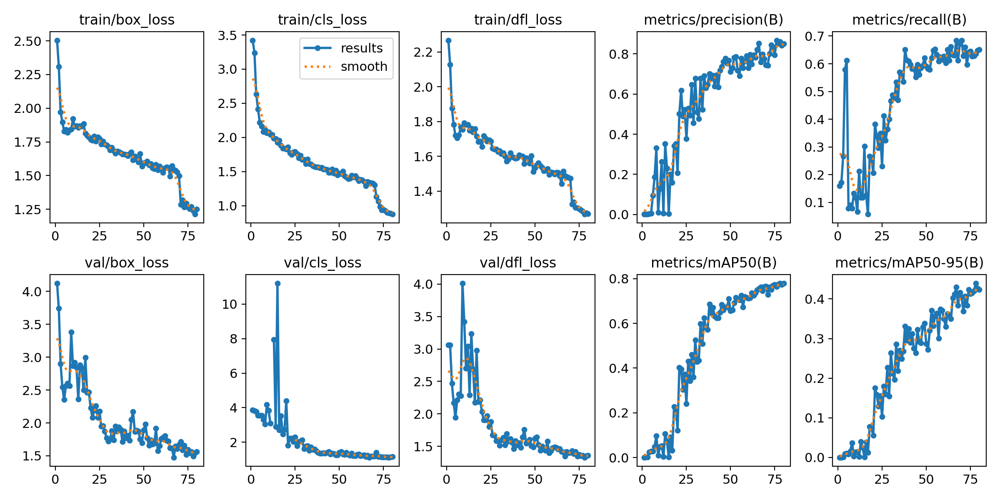

In [ ]:
Image(filename=f'/content/runs/detect/yolov8n_aug_ft2/results.png', width=600)

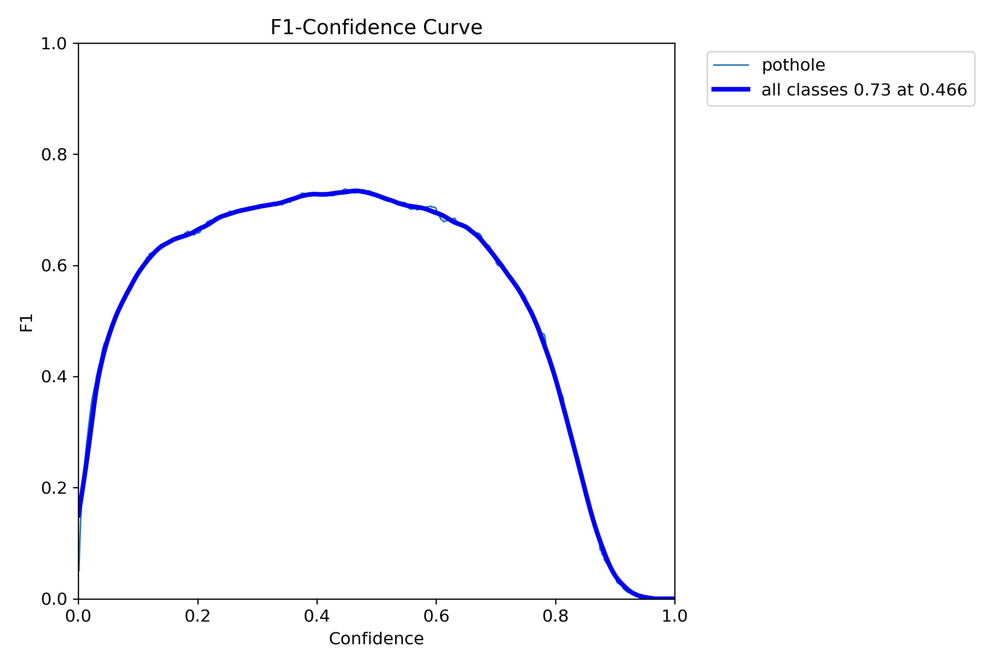

In [ ]:
Image(filename=f'/content/runs/detect/yolov8n_aug_ft2/F1_curve.png', width=600)

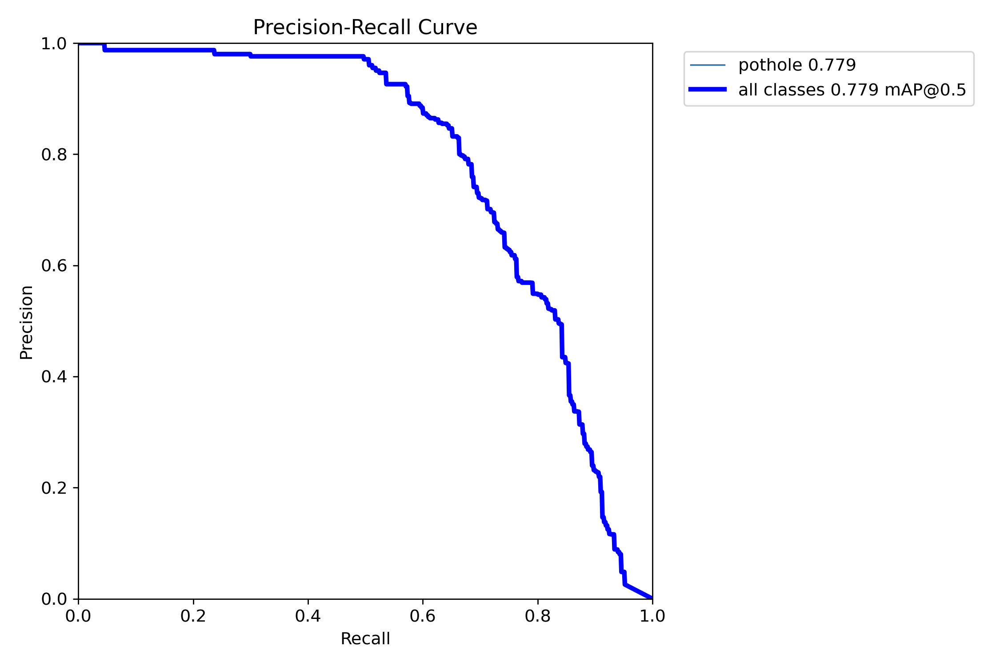

In [ ]:
Image(filename=f'/content/runs/detect/yolov8n_aug_ft2/PR_curve.png', width=600)

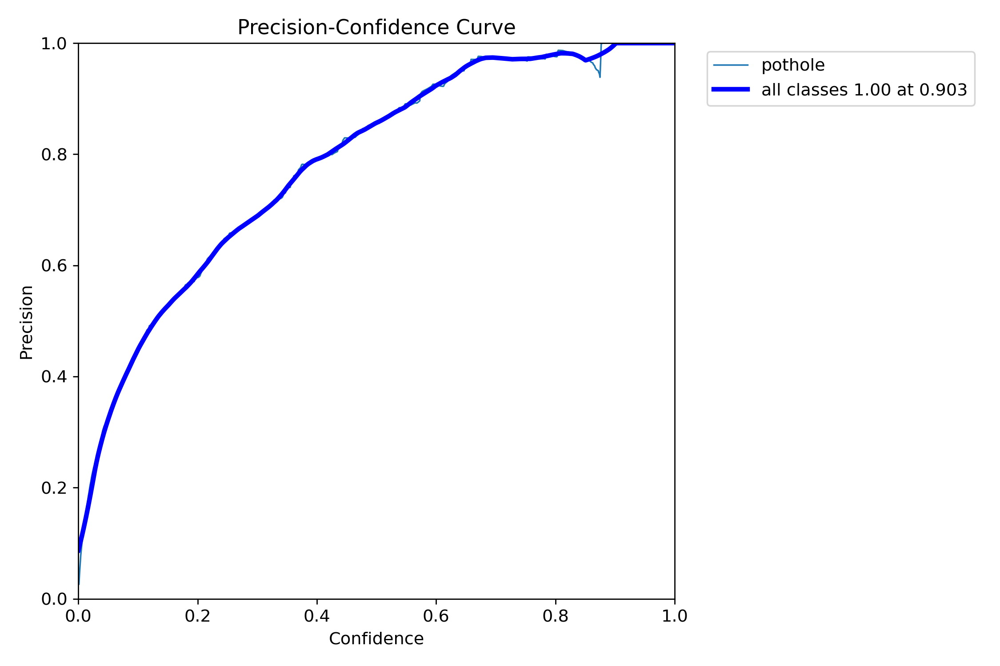

In [ ]:
Image(filename=f'/content/runs/detect/yolov8n_aug_ft2/P_curve.png', width=600)

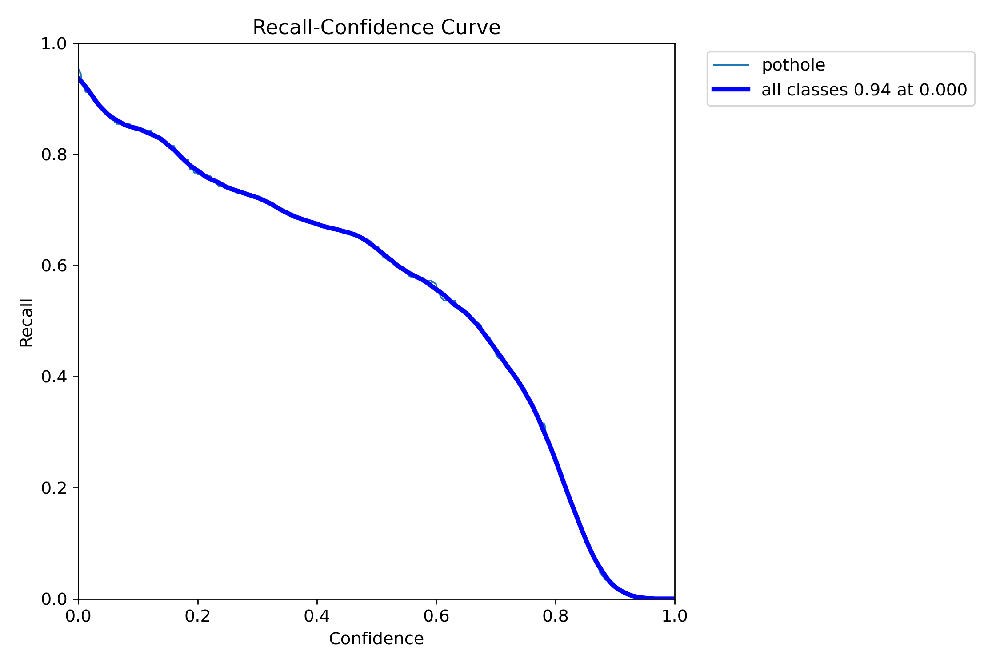

In [ ]:
Image(filename=f'/content/runs/detect/yolov8n_aug_ft2/R_curve.png', width=600)

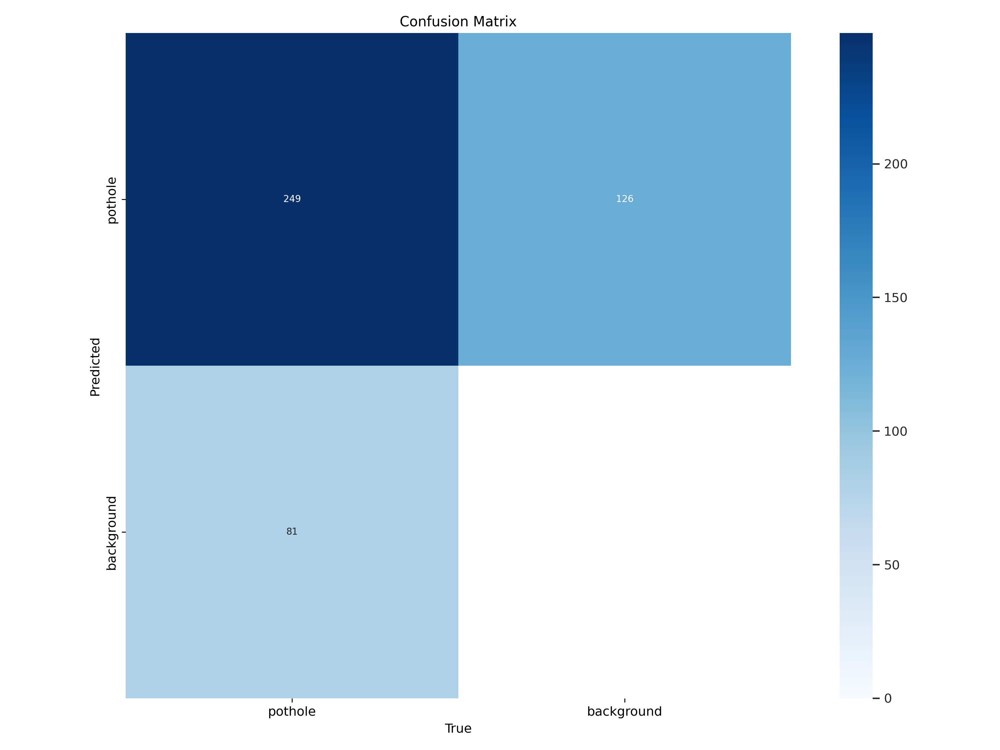

In [ ]:
Image(filename=f'/content/runs/detect/yolov8n_aug_ft2/confusion_matrix.png', width=600)

In [ ]:
metrics_v8_v2 = '/content/runs/detect/yolov8n_aug_ft2/results.csv'

In [ ]:
results_v8_v2 = model_aug_v8_v2.val(name='test_yolov8n_aug_ft2',split='test')

Ultralytics 8.3.61 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/yolov8-dataset/test/labels... 67 images, 0 backgrounds, 0 corrupt: 100%|██████████| 67/67 [00:00<00:00, 1323.85it/s]

val: New cache created: /content/yolov8-dataset/test/labels.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.19s/it]


                   all         67        154       0.76      0.753      0.801      0.462
Speed: 1.0ms preprocess, 13.4ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to runs/detect/test_yolov8n_aug_ft2


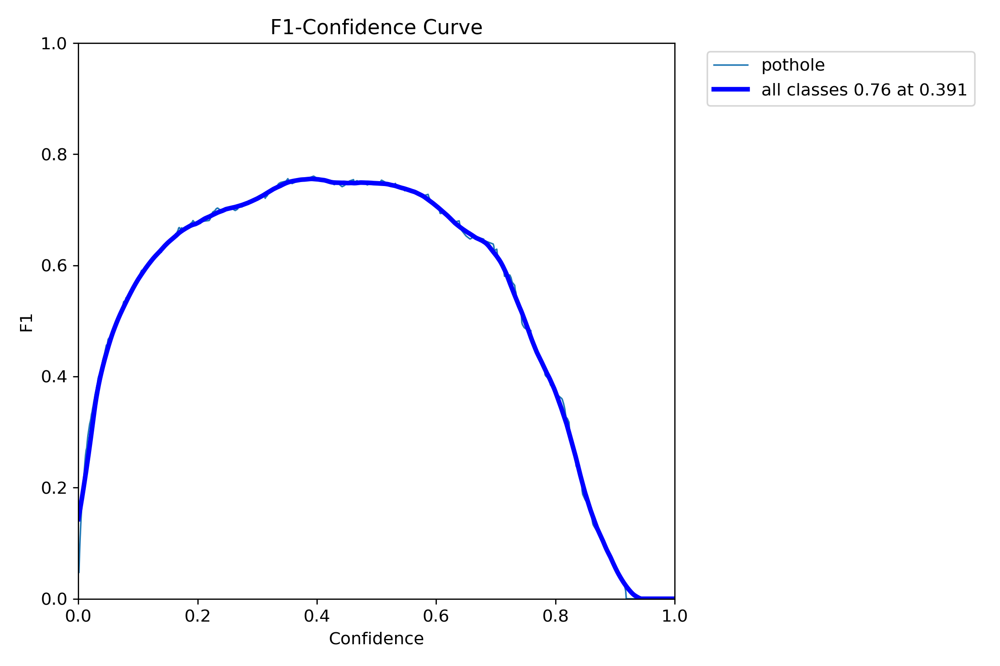

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov8n_aug_ft2/F1_curve.png', width=600)

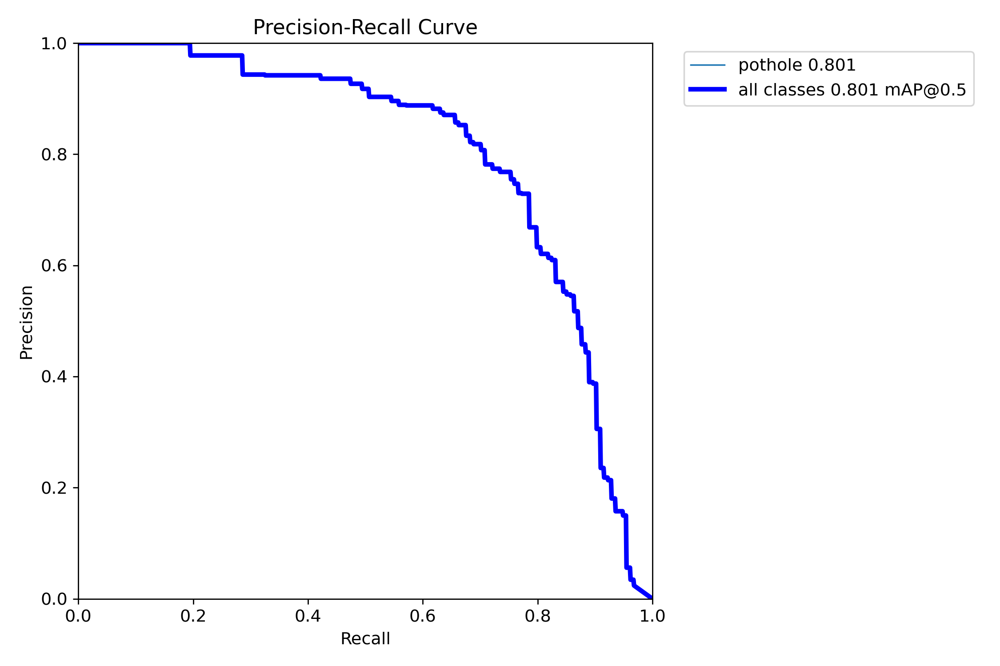

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov8n_aug_ft2/PR_curve.png', width=600)

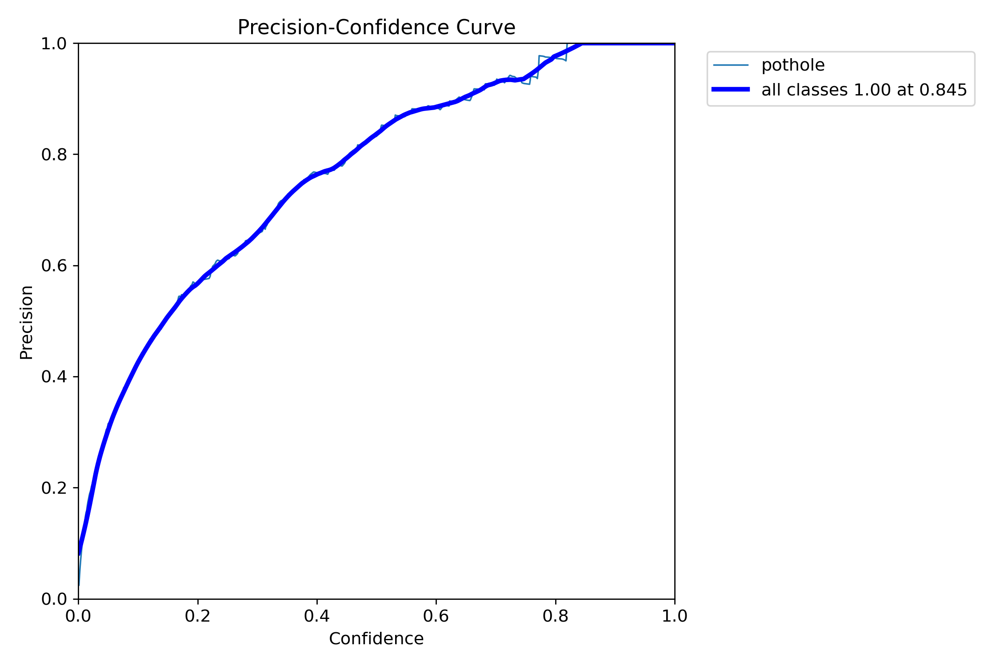

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov8n_aug_ft2/P_curve.png', width=600)

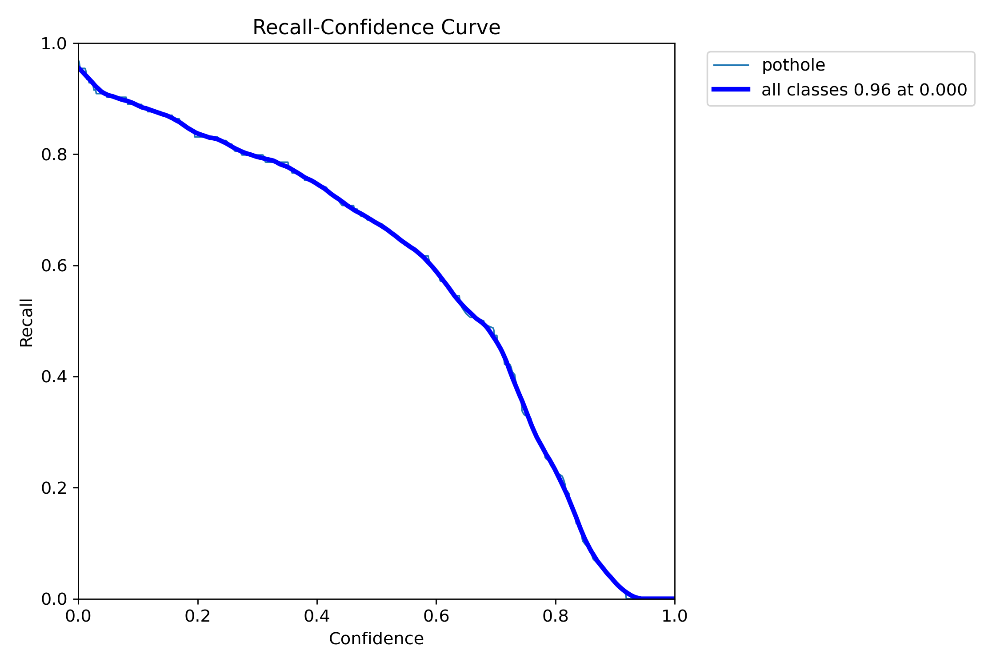

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov8n_aug_ft2/R_curve.png', width=600)


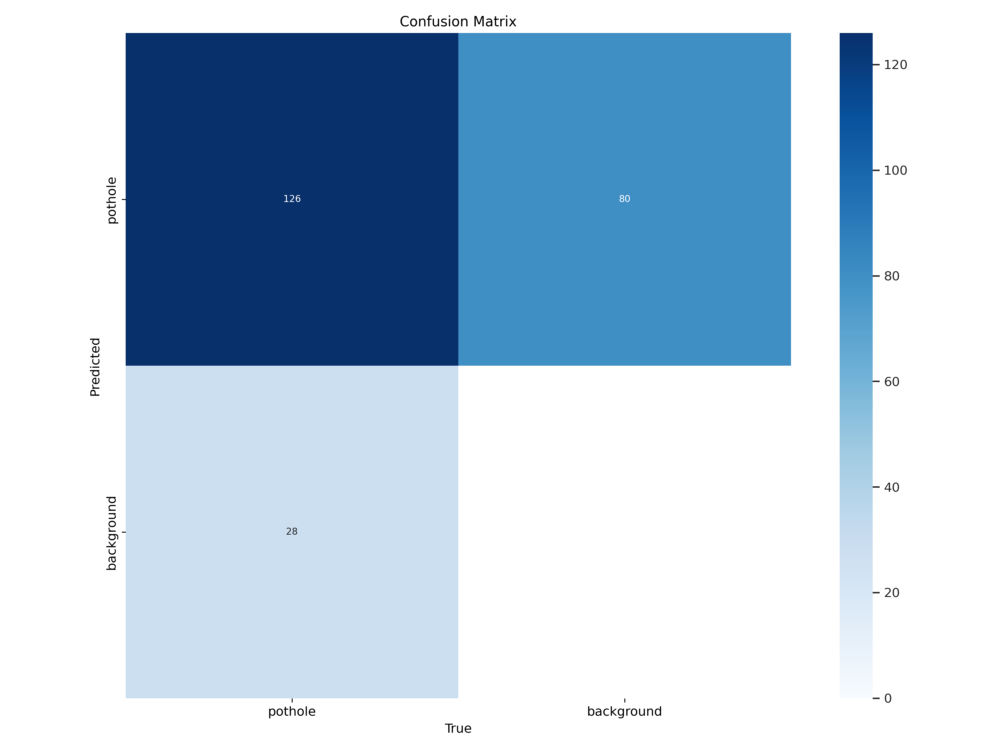

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov8n_aug_ft2/confusion_matrix.png', width=600)

In [ ]:
model_aug_v8_v2.export(format='tflite')

Ultralytics 8.3.61 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.30GHz)

PyTorch: starting from 'runs/detect/yolov8n_aug_ft2/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (5.9 MB)

TensorFlow SavedModel: starting export with tensorflow 2.17.1...

ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.47...
ONNX: export success ✅ 1.2s, saved as 'runs/detect/yolov8n_aug_ft2/weights/best.onnx' (11.8 MB)
TensorFlow SavedModel: starting TFLite export with onnx2tf 1.26.3...
TensorFlow SavedModel: export success ✅ 24.6s, saved as 'runs/detect/yolov8n_aug_ft2/weights/best_saved_model' (30.0 MB)

TensorFlow Lite: starting export with tensorflow 2.17.1...
TensorFlow Lite: export success ✅ 0.0s, saved as 'runs/detect/yolov8n_aug_ft2/weights/best_saved_model/best_float32.tflite' (11.7 MB)

Export complete (25.0s)
Results saved to /content/runs/detect/yolov8n_aug_ft2/weights
Predict:         yolo predict task=detect mode

'runs/detect/yolov8n_aug_ft2/weights/best_saved_model/best_float32.tflite'

#### YOLOv10

In [ ]:
print("Training YOLOv10...")
model_aug_v10_v2.train(data=os.path.join(dataset_yolov8.location, 'data.yaml'),name="yolov10n_aug_ft2", epochs=epochs, batch=batch_size, imgsz=imgsz,
                  augment=True,
                   fliplr= 0.5,           # Horizontal flip with 50% probability
                   flipud= 0.1,           # Vertical flip with 10% probability
                   scale= 0.3,            # Scale images ±30%
                   translate= 0.2,        # Translate images ±20%
                   hsv_h=0.015,          # HSV hue adjustment ±1.5%
                   hsv_s=0.7,            # HSV saturation adjustment 70%
                   hsv_v=0.4,            # HSV value (brightness) adjustment 40%
                   degrees=10.0,         # Random rotation ±10 degrees
                   shear= 5.0,            # Shear transformations ±5 degrees
                   perspective=0.001,    # Small perspective distortion
                   mosaic= 1.0,           # Enable mosaic augmentation
                   mixup=0.2             # Enable mixup with 20% probability
)

Training YOLOv10...
Ultralytics 8.3.61 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov10n.pt, data=/content/yolov8-dataset/data.yaml, epochs=80, time=None, patience=100, batch=64, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov10n_aug_ft22, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_

train: Scanning /content/yolov8-dataset/train/labels.cache... 465 images, 0 backgrounds, 0 corrupt: 100%|██████████| 465/465 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


A new version of Albumentations is available: 2.0.0 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
val: Scanning /content/yolov8-dataset/valid/labels.cache... 133 images, 0 backgrounds, 0 corrupt: 100%|██████████| 133/133 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov10n_aug_ft22/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 95 weight(decay=0.0), 108 weight(decay=0.0005), 107 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolov10n_aug_ft22
Starting training for 80 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/80      8.77G      4.691      8.421       4.47        129        640: 100%|██████████| 8/8 [00:06<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.27it/s]

                   all        133        330    0.00145      0.176    0.00129    0.00036



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/80      9.15G      4.473        8.3      4.229         76        640: 100%|██████████| 8/8 [00:05<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.35it/s]

                   all        133        330    0.00113      0.136     0.0011   0.000428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/80         9G      3.815      7.328      3.565        110        640: 100%|██████████| 8/8 [00:05<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.51it/s]

                   all        133        330     0.0012      0.145    0.00199   0.000699



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/80      8.95G      3.724       6.66      3.434         81        640: 100%|██████████| 8/8 [00:05<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.43it/s]

                   all        133        330    0.00193      0.233    0.00369    0.00139



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/80      9.05G      3.613      6.055      3.365         94        640: 100%|██████████| 8/8 [00:05<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.49it/s]

                   all        133        330    0.00263      0.318     0.0342     0.0108



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/80       9.1G      3.591      5.724      3.325         78        640: 100%|██████████| 8/8 [00:05<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.46it/s]

                   all        133        330     0.0011      0.133   0.000846   0.000337



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/80      8.87G      3.562      5.335      3.312         85        640: 100%|██████████| 8/8 [00:05<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.53it/s]

                   all        133        330   0.000777     0.0939    0.00144   0.000444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/80      8.95G      3.682      5.269      3.404         70        640: 100%|██████████| 8/8 [00:05<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.49it/s]

                   all        133        330   7.52e-05    0.00909    3.8e-05   1.01e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/80      8.79G      3.681      5.108      3.387         70        640: 100%|██████████| 8/8 [00:05<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.54it/s]

                   all        133        330   7.52e-05    0.00909    3.8e-05   1.01e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/80      8.87G       3.78      5.034      3.454        107        640: 100%|██████████| 8/8 [00:05<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.54it/s]

                   all        133        330   0.000175     0.0212   8.97e-05   2.67e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/80      8.87G      3.779      4.942      3.433         68        640: 100%|██████████| 8/8 [00:05<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.49it/s]

                   all        133        330      0.244     0.0879     0.0783     0.0236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/80      8.82G      3.711      4.754      3.403        107        640: 100%|██████████| 8/8 [00:05<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.47it/s]

                   all        133        330      0.224      0.109     0.0963     0.0296



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/80         9G      3.674      4.624      3.359         71        640: 100%|██████████| 8/8 [00:05<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.41it/s]

                   all        133        330     0.0234        0.1    0.00898    0.00319



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/80      8.84G      3.735      4.642      3.394         86        640: 100%|██████████| 8/8 [00:05<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.41it/s]

                   all        133        330    0.00382      0.118    0.00237    0.00098



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/80      8.93G      3.672      4.517       3.31         92        640: 100%|██████████| 8/8 [00:05<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.43it/s]

                   all        133        330   2.76e-05    0.00303   1.26e-05   5.03e-06



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/80      8.84G      3.774      4.569       3.37        118        640: 100%|██████████| 8/8 [00:05<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.55it/s]

                   all        133        330     0.0146     0.0758     0.0131    0.00536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/80      8.89G      3.625      4.364      3.304         79        640: 100%|██████████| 8/8 [00:05<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.70it/s]

                   all        133        330      0.111     0.0394     0.0658     0.0256



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/80      8.86G      3.592      4.247      3.301        115        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.52it/s]

                   all        133        330      0.345     0.0636     0.0742     0.0266



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/80      9.07G      3.591      4.254      3.267         89        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.57it/s]

                   all        133        330      0.316     0.0545     0.0604       0.03



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/80      8.91G      3.545      4.174      3.215         95        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.49it/s]

                   all        133        330       0.24      0.121     0.0922     0.0337



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/80      9.07G      3.559      4.169      3.281         92        640: 100%|██████████| 8/8 [00:05<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.41it/s]

                   all        133        330      0.253      0.227      0.178     0.0657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/80      9.18G      3.624      4.049       3.24        119        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.34it/s]

                   all        133        330      0.356      0.364      0.288      0.122



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/80      8.92G      3.465      3.902      3.162         85        640: 100%|██████████| 8/8 [00:05<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.38it/s]

                   all        133        330      0.421      0.279      0.274      0.114



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/80      9.12G      3.558      4.063      3.249         88        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.45it/s]

                   all        133        330      0.269      0.206      0.148     0.0621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/80      8.92G      3.588      4.121      3.262         75        640: 100%|██████████| 8/8 [00:05<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.41it/s]

                   all        133        330      0.551      0.357      0.404      0.189



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/80      8.95G      3.495      3.953      3.168        143        640: 100%|██████████| 8/8 [00:05<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.45it/s]

                   all        133        330      0.478      0.367      0.367       0.15



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/80      9.07G      3.561      3.972      3.223        135        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.30it/s]

                   all        133        330       0.39      0.388      0.299      0.123



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/80      8.95G      3.447      3.904        3.2        111        640: 100%|██████████| 8/8 [00:05<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.45it/s]

                   all        133        330      0.449      0.176      0.194     0.0797



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/80      8.95G      3.511      3.878      3.196        111        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.44it/s]

                   all        133        330      0.548      0.294      0.312      0.136



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/80      8.97G      3.476      3.878      3.179         76        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.45it/s]

                   all        133        330      0.449      0.294      0.311      0.153



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/80      8.79G      3.407      3.704       3.14         93        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.41it/s]

                   all        133        330      0.483      0.315      0.294      0.136



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/80       8.9G       3.44      3.835      3.165        104        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.44it/s]

                   all        133        330       0.56      0.455      0.474      0.229



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/80      8.86G      3.515      3.722      3.177         89        640: 100%|██████████| 8/8 [00:05<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.45it/s]

                   all        133        330      0.542      0.382      0.394      0.181



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/80      8.95G      3.388      3.668      3.097         69        640: 100%|██████████| 8/8 [00:05<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.40it/s]

                   all        133        330      0.454      0.473      0.443       0.21



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/80      9.05G      3.421      3.685      3.122         81        640: 100%|██████████| 8/8 [00:05<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.44it/s]

                   all        133        330      0.463      0.426      0.386      0.156



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/80      8.92G       3.45      3.636      3.194        102        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.46it/s]

                   all        133        330       0.47      0.327      0.328      0.129



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/80      8.91G      3.371      3.544      3.132         89        640: 100%|██████████| 8/8 [00:05<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.41it/s]

                   all        133        330      0.509       0.37      0.372      0.143



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/80      8.97G      3.359      3.511      3.117         91        640: 100%|██████████| 8/8 [00:05<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.34it/s]

                   all        133        330      0.361      0.361       0.27      0.104



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/80      9.09G      3.359      3.579      3.122        125        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.42it/s]

                   all        133        330      0.617      0.433      0.501      0.225



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/80      9.26G      3.312      3.565      3.082         78        640: 100%|██████████| 8/8 [00:05<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.30it/s]

                   all        133        330      0.569      0.458      0.491      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/80      8.81G      3.374      3.512      3.142         72        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.32it/s]

                   all        133        330      0.552      0.527      0.531       0.24



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/80      8.92G      3.377       3.48      3.115        102        640: 100%|██████████| 8/8 [00:05<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.37it/s]

                   all        133        330      0.616      0.511      0.547      0.262



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/80      8.81G      3.382      3.556      3.135        112        640: 100%|██████████| 8/8 [00:05<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.28it/s]

                   all        133        330      0.629      0.388      0.462      0.227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/80       8.9G      3.287      3.378      3.049        102        640: 100%|██████████| 8/8 [00:05<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.36it/s]

                   all        133        330      0.555      0.509      0.528      0.231



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/80         9G      3.371       3.42      3.154         87        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.42it/s]

                   all        133        330      0.565       0.44      0.503      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/80      8.97G      3.334      3.505      3.133         86        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.32it/s]

                   all        133        330        0.5      0.533      0.512      0.219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/80      8.84G      3.278      3.322      3.064        111        640: 100%|██████████| 8/8 [00:05<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.43it/s]

                   all        133        330      0.635      0.545      0.595      0.264



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/80      8.84G      3.357      3.428      3.118         97        640: 100%|██████████| 8/8 [00:05<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.40it/s]

                   all        133        330      0.558      0.573       0.57      0.274



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/80      9.28G      3.193      3.245      2.957        111        640: 100%|██████████| 8/8 [00:05<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.41it/s]

                   all        133        330      0.646      0.481      0.562      0.271



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/80      9.12G      3.277      3.365       3.01         92        640: 100%|██████████| 8/8 [00:05<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.37it/s]

                   all        133        330      0.676      0.501      0.586      0.269



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      51/80      8.81G      3.216      3.306      3.024         72        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.39it/s]

                   all        133        330      0.699      0.536       0.61      0.288



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      52/80       8.9G      3.262      3.374      3.081         83        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.39it/s]

                   all        133        330      0.643      0.564      0.636      0.312



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      53/80      8.91G      3.218      3.272      3.033         80        640: 100%|██████████| 8/8 [00:05<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.46it/s]

                   all        133        330      0.592      0.527      0.581      0.304



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      54/80      9.12G      3.245      3.225      3.021         82        640: 100%|██████████| 8/8 [00:05<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.36it/s]

                   all        133        330      0.619      0.509      0.558      0.249



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      55/80      8.95G      3.212      3.234      2.984        134        640: 100%|██████████| 8/8 [00:05<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.42it/s]

                   all        133        330      0.603      0.586      0.594      0.303



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      56/80       8.9G      3.175      3.169      3.004         92        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.38it/s]

                   all        133        330      0.635      0.563      0.632      0.315



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      57/80      9.12G       3.22      3.239      3.014         89        640: 100%|██████████| 8/8 [00:05<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.41it/s]

                   all        133        330      0.663      0.564      0.603      0.262



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      58/80      8.84G      3.223      3.213      3.002         66        640: 100%|██████████| 8/8 [00:05<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.31it/s]

                   all        133        330      0.695       0.57      0.652      0.312



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      59/80       9.1G      3.228      3.268      2.976         99        640: 100%|██████████| 8/8 [00:05<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.42it/s]

                   all        133        330      0.712      0.582       0.64      0.307



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      60/80      8.92G      3.196      3.221      2.967        109        640: 100%|██████████| 8/8 [00:05<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.38it/s]

                   all        133        330      0.696      0.603      0.659      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      61/80      9.09G      3.117       3.12      2.946         94        640: 100%|██████████| 8/8 [00:05<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.41it/s]

                   all        133        330      0.674      0.594      0.644      0.304



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      62/80       8.9G      3.196      3.146      2.975        106        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.38it/s]

                   all        133        330      0.678      0.606      0.673      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      63/80      8.84G      3.211      3.156      2.976         90        640: 100%|██████████| 8/8 [00:05<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.42it/s]

                   all        133        330      0.634      0.645      0.656      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      64/80      8.81G      3.206      3.101      2.947         93        640: 100%|██████████| 8/8 [00:05<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.39it/s]

                   all        133        330      0.658      0.621      0.641      0.311



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      65/80      9.05G      3.072      2.992      2.846         92        640: 100%|██████████| 8/8 [00:05<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.35it/s]

                   all        133        330      0.676      0.594      0.647      0.328



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      66/80      8.81G      3.152      3.085       2.94        116        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.42it/s]

                   all        133        330      0.719      0.603      0.695      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      67/80      9.02G      3.127      3.006      2.891         99        640: 100%|██████████| 8/8 [00:05<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.38it/s]

                   all        133        330      0.725      0.582      0.669      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      68/80      9.05G      3.131      2.996      2.901        106        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.39it/s]

                   all        133        330      0.723       0.57      0.668      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      69/80      8.95G      3.128      2.966      2.914         90        640: 100%|██████████| 8/8 [00:05<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.38it/s]

                   all        133        330      0.674      0.603      0.671      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      70/80      8.86G      3.072      2.968      2.913         78        640: 100%|██████████| 8/8 [00:05<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.45it/s]

                   all        133        330      0.768      0.563      0.694      0.361


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      71/80      8.86G       2.67      2.499      2.621         38        640: 100%|██████████| 8/8 [00:07<00:00,  1.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.41it/s]

                   all        133        330      0.716      0.596      0.683      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      72/80      8.89G      2.693      2.287      2.641         43        640: 100%|██████████| 8/8 [00:05<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.40it/s]

                   all        133        330      0.691      0.589      0.667      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      73/80      8.75G       2.59      2.148      2.565         39        640: 100%|██████████| 8/8 [00:05<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.41it/s]

                   all        133        330      0.713      0.567      0.671      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      74/80      8.81G       2.69      2.099      2.589         38        640: 100%|██████████| 8/8 [00:05<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.44it/s]

                   all        133        330      0.714      0.589      0.678      0.367



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      75/80      8.84G      2.641      2.071        2.6         36        640: 100%|██████████| 8/8 [00:05<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.36it/s]

                   all        133        330      0.744      0.564      0.667       0.35



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      76/80      8.79G      2.569       2.03      2.548         41        640: 100%|██████████| 8/8 [00:05<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.40it/s]

                   all        133        330      0.769      0.561      0.676      0.368



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      77/80      8.87G      2.609      1.978      2.551         62        640: 100%|██████████| 8/8 [00:05<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.34it/s]

                   all        133        330      0.742      0.574      0.677      0.363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      78/80      8.87G      2.581      2.003      2.534         93        640: 100%|██████████| 8/8 [00:05<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.39it/s]

                   all        133        330      0.796      0.552      0.694      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      79/80      8.81G      2.524      1.964      2.544         63        640: 100%|██████████| 8/8 [00:05<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.37it/s]

                   all        133        330      0.796      0.548      0.678      0.367



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      80/80      8.84G      2.592      1.944      2.539         58        640: 100%|██████████| 8/8 [00:05<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.41it/s]

                   all        133        330      0.702      0.624      0.688      0.364



80 epochs completed in 0.164 hours.
Optimizer stripped from runs/detect/yolov10n_aug_ft22/weights/last.pt, 5.7MB
Optimizer stripped from runs/detect/yolov10n_aug_ft22/weights/best.pt, 5.7MB

Validating runs/detect/yolov10n_aug_ft22/weights/best.pt...
Ultralytics 8.3.61 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv10n summary (fused): 285 layers, 2,694,806 parameters, 0 gradients, 8.2 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:00<00:00,  1.34it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.54it/s]


                   all        133        330      0.798      0.552      0.693      0.373
Speed: 0.2ms preprocess, 2.8ms inference, 0.0ms loss, 0.1ms postprocess per image
Results saved to runs/detect/yolov10n_aug_ft22


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x799f1db6b730>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

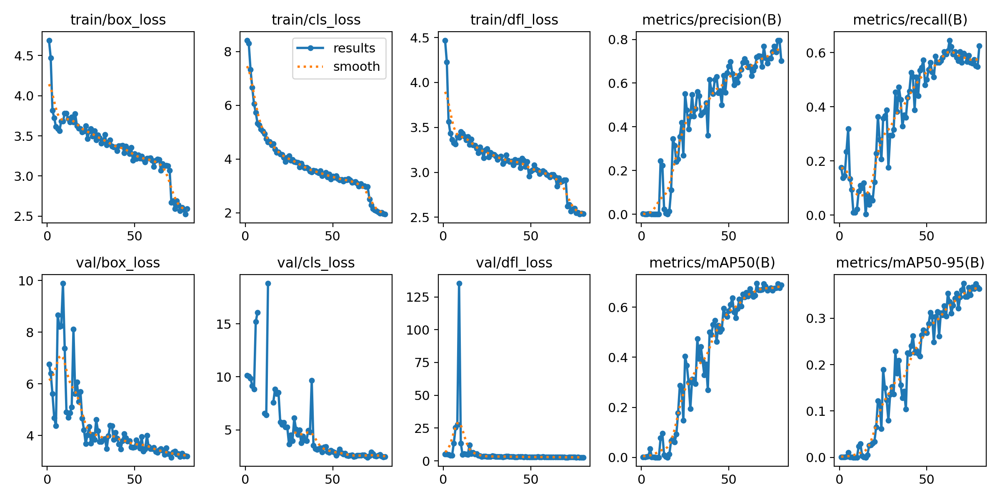

In [ ]:
Image(filename=f'/content/runs/detect/yolov10n_aug_ft2/results.png', width=600)

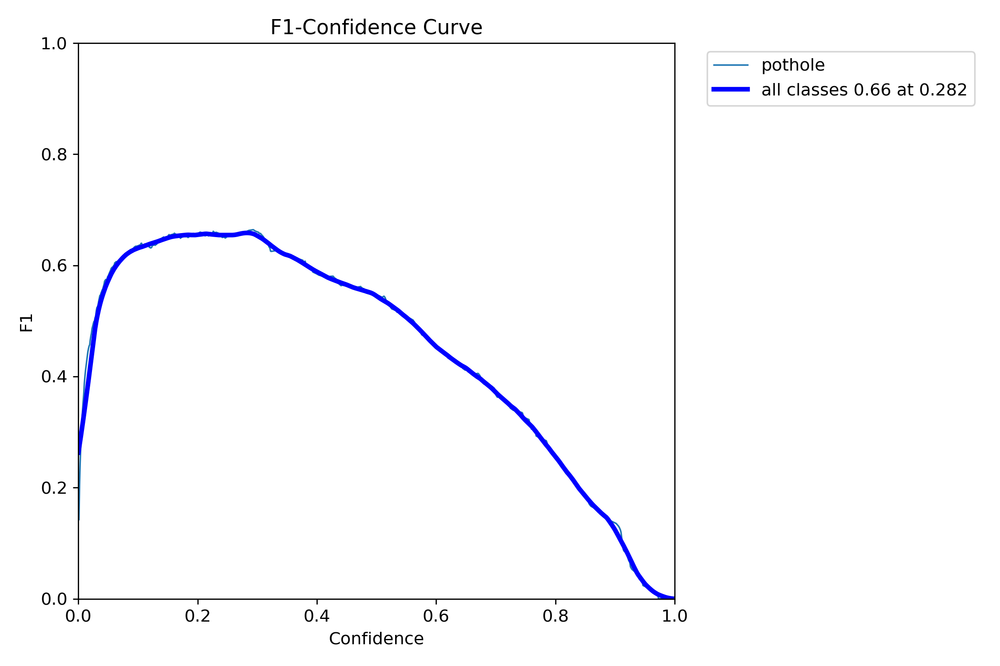

In [ ]:
Image(filename=f'/content/runs/detect/yolov10n_aug_ft2/F1_curve.png', width=600)

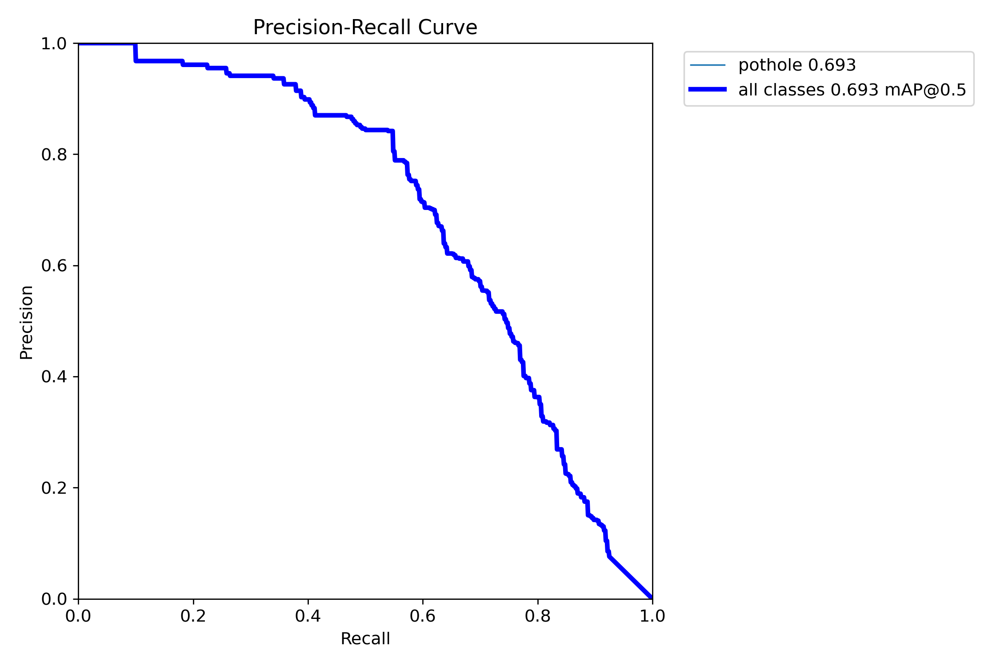

In [ ]:
Image(filename=f'/content/runs/detect/yolov10n_aug_ft2/PR_curve.png', width=600)

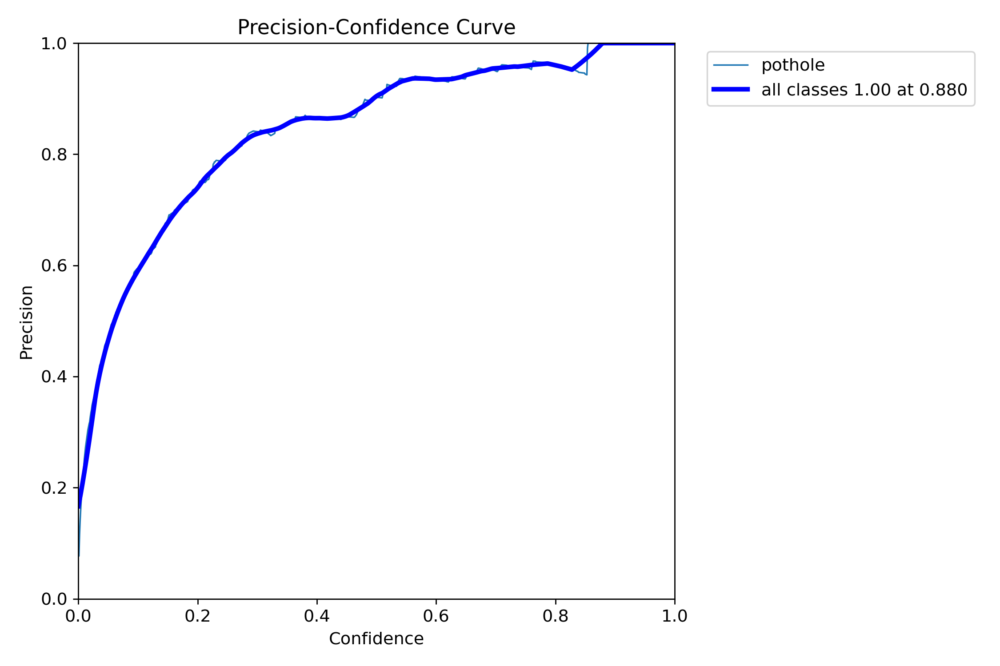

In [ ]:
Image(filename=f'/content/runs/detect/yolov10n_aug_ft2/P_curve.png', width=600)

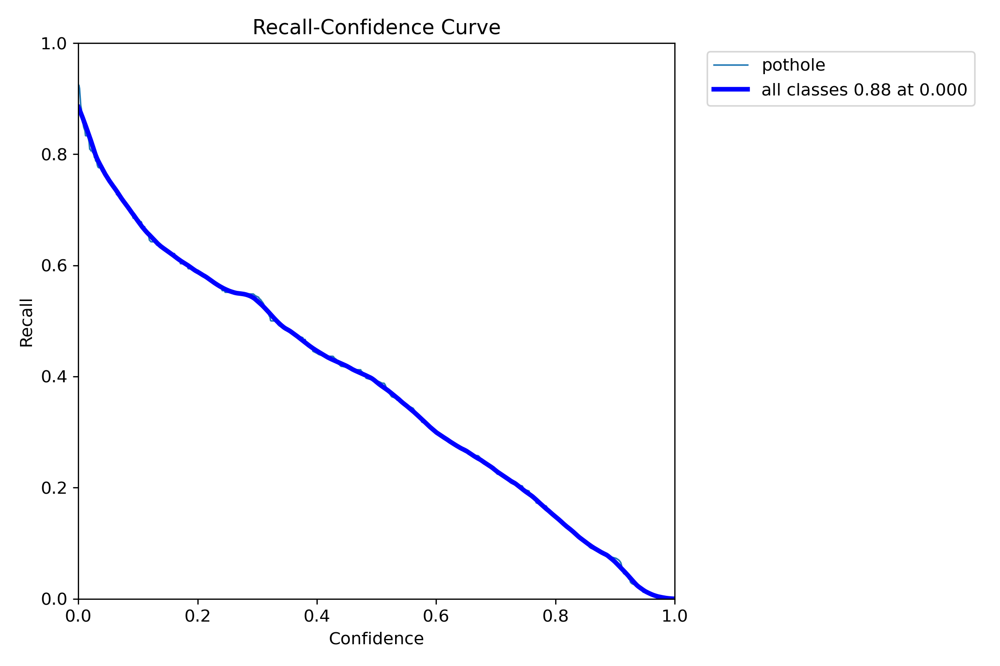

In [ ]:
Image(filename=f'/content/runs/detect/yolov10n_aug_ft2/R_curve.png', width=600)

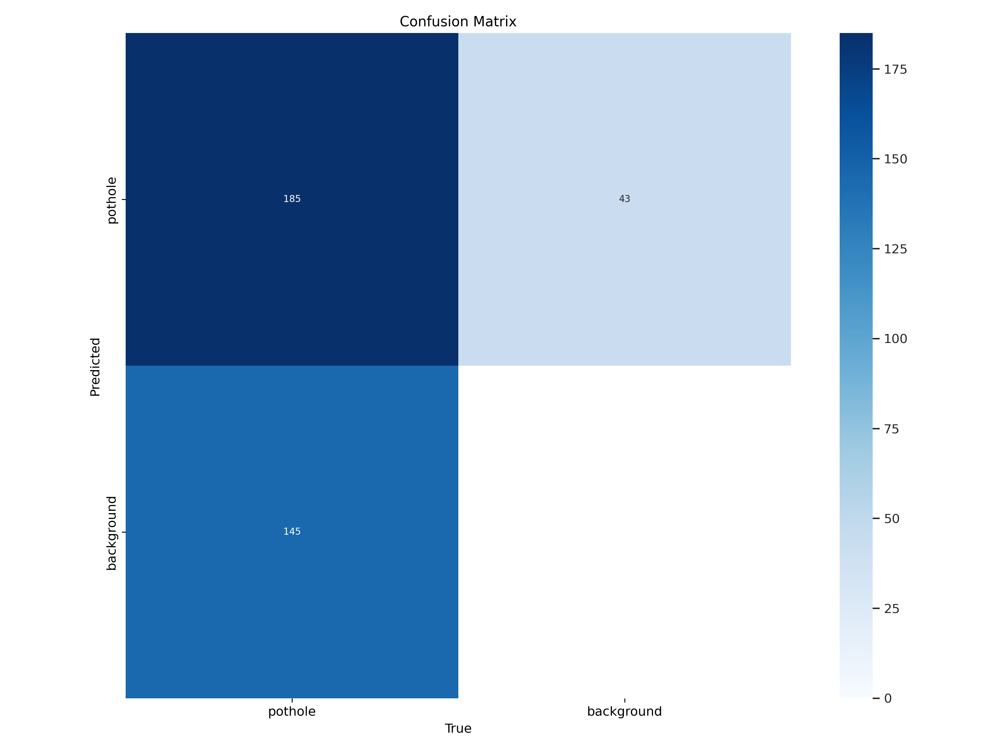

In [ ]:
Image(filename=f'/content/runs/detect/yolov10n_aug_ft2/confusion_matrix.png', width=600)

In [ ]:
metrics_v10_v2 = '/content/runs/detect/yolov10n_aug_ft2/results.csv'

In [ ]:
results_v10_v2 = model_aug_v10_v2.val(name='test_yolov10n_aug_ft2',split='test')

Ultralytics 8.3.61 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv10n summary (fused): 285 layers, 2,694,806 parameters, 0 gradients, 8.2 GFLOPs


val: Scanning /content/yolov8-dataset/test/labels.cache... 67 images, 0 backgrounds, 0 corrupt: 100%|██████████| 67/67 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:01<00:01,  1.74s/it]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.07it/s]


                   all         67        154      0.755      0.669      0.742      0.401
Speed: 0.2ms preprocess, 7.9ms inference, 0.0ms loss, 0.3ms postprocess per image
Results saved to runs/detect/test_yolov10n_aug_ft2


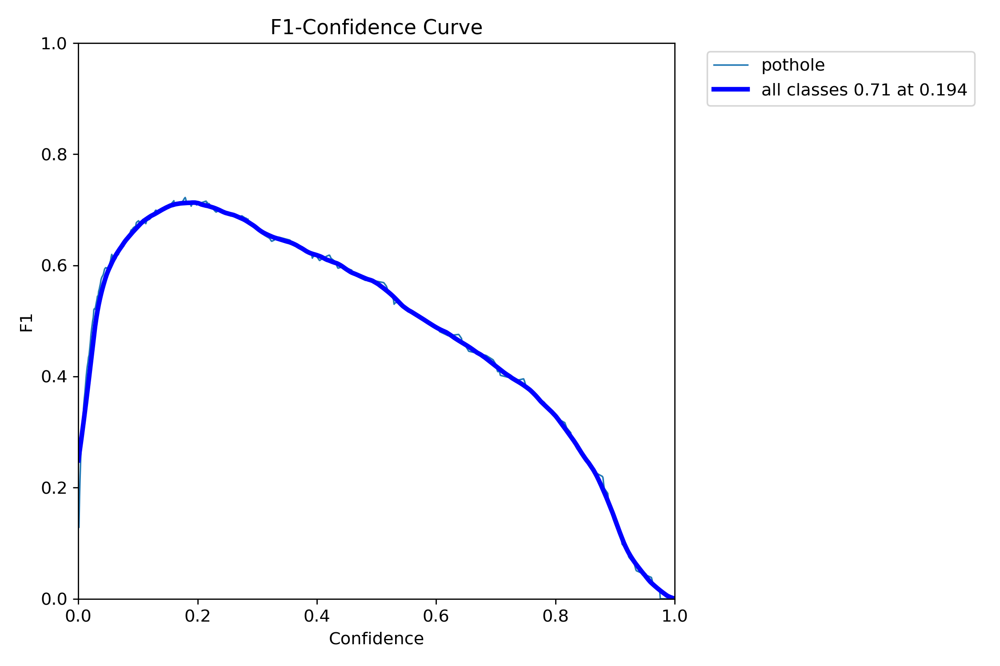

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov10n_aug_ft2/F1_curve.png', width=600)

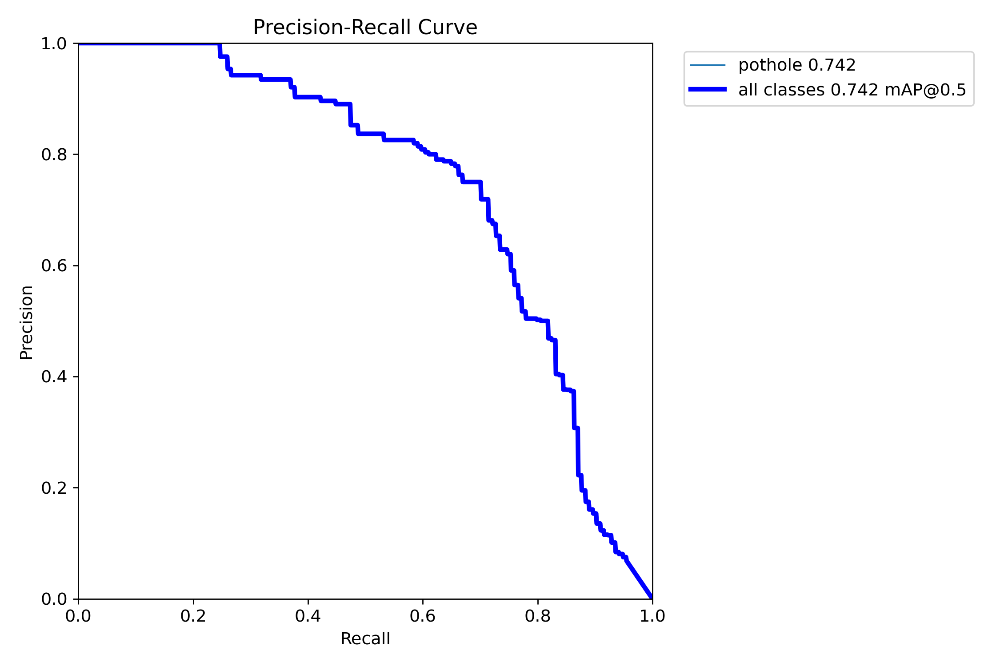

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov10n_aug_ft2/PR_curve.png', width=600)

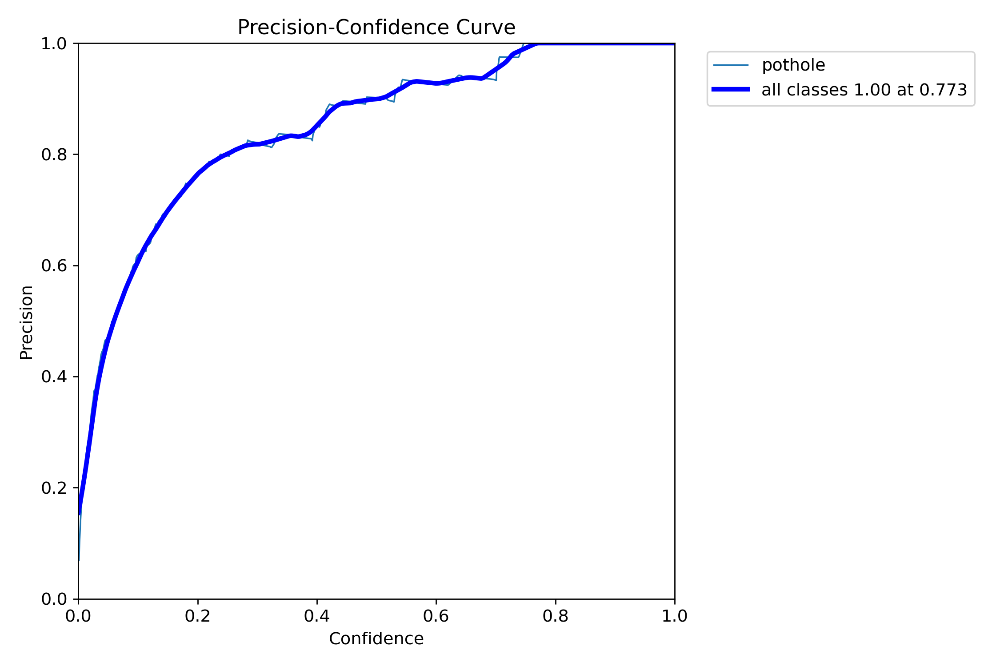

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov10n_aug_ft2/P_curve.png', width=600)

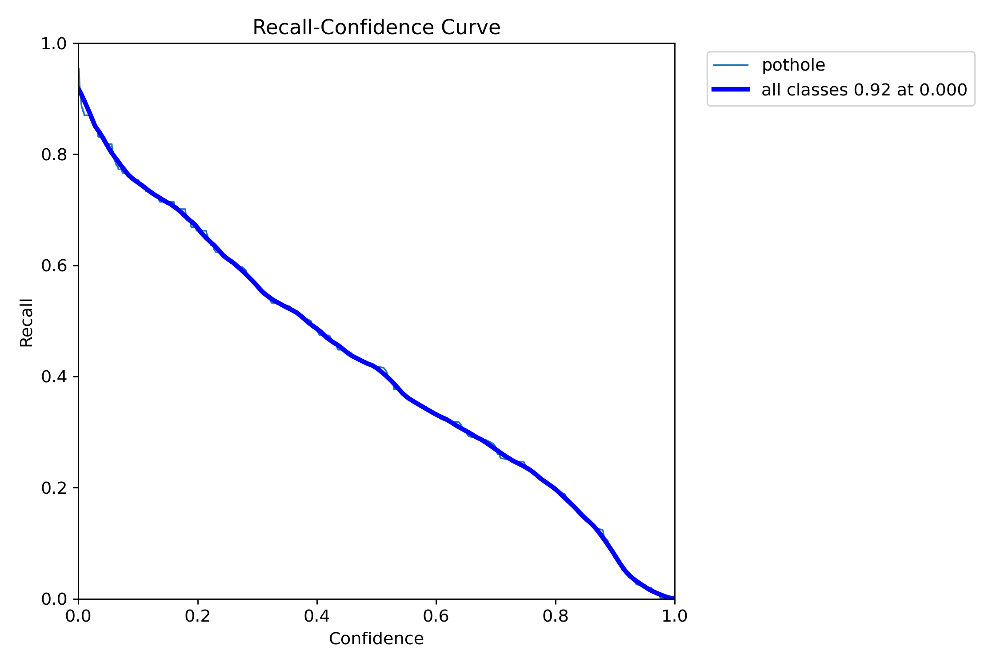

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov10n_aug_ft2/R_curve.png', width=600)

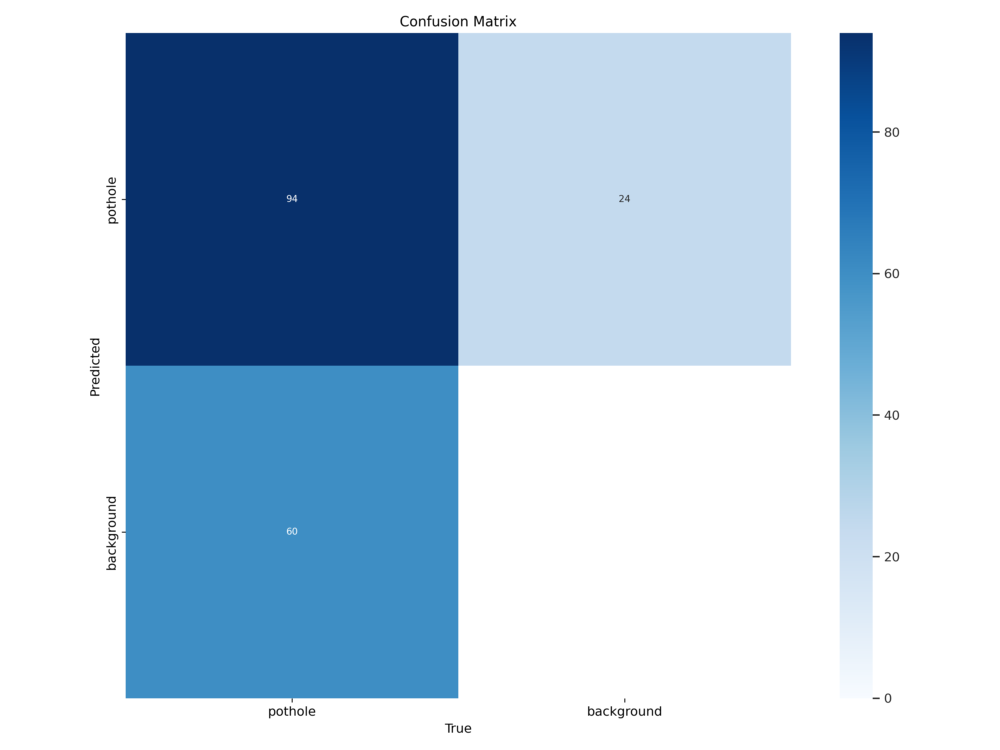

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov10n_aug_ft2/confusion_matrix.png', width=600)

In [ ]:
model_aug_v10_v2.export(format='tflite')

Ultralytics 8.3.61 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.30GHz)

PyTorch: starting from 'runs/detect/yolov10n_aug_ft22/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 300, 6) (5.5 MB)

TensorFlow SavedModel: starting export with tensorflow 2.17.1...

ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.47...
ONNX: export success ✅ 2.2s, saved as 'runs/detect/yolov10n_aug_ft22/weights/best.onnx' (9.0 MB)
TensorFlow SavedModel: starting TFLite export with onnx2tf 1.26.3...
TensorFlow SavedModel: export success ✅ 39.5s, saved as 'runs/detect/yolov10n_aug_ft22/weights/best_saved_model' (23.6 MB)

TensorFlow Lite: starting export with tensorflow 2.17.1...
TensorFlow Lite: export success ✅ 0.0s, saved as 'runs/detect/yolov10n_aug_ft22/weights/best_saved_model/best_float32.tflite' (9.0 MB)

Export complete (39.9s)
Results saved to /content/runs/detect/yolov10n_aug_ft22/weights
Predict:         yolo predict task=dete

'runs/detect/yolov10n_aug_ft22/weights/best_saved_model/best_float32.tflite'

#### YOLOv11

In [ ]:
print("Training YOLOv11...")
model_aug_v11_v2.train(data=os.path.join(dataset_yolov11.location, 'data.yaml'),name="yolov11n_aug_ft2", epochs=epochs, batch=batch_size, imgsz=imgsz,
                  augment=True,
                   fliplr= 0.5,           # Horizontal flip with 50% probability
                   flipud= 0.1,           # Vertical flip with 10% probability
                   scale= 0.3,            # Scale images ±30%
                   translate= 0.2,        # Translate images ±20%
                   hsv_h=0.015,          # HSV hue adjustment ±1.5%
                   hsv_s=0.7,            # HSV saturation adjustment 70%
                   hsv_v=0.4,            # HSV value (brightness) adjustment 40%
                   degrees=10.0,         # Random rotation ±10 degrees
                   shear= 5.0,            # Shear transformations ±5 degrees
                   perspective=0.001,    # Small perspective distortion
                   mosaic= 1.0,           # Enable mosaic augmentation
                   mixup=0.2             # Enable mixup with 20% probability
)

Training YOLOv11...
Ultralytics 8.3.61 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/yolov11-dataset/data.yaml, epochs=80, time=None, patience=100, batch=64, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov11n_aug_ft2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_l

train: Scanning /content/yolov11-dataset/train/labels... 465 images, 0 backgrounds, 0 corrupt: 100%|██████████| 465/465 [00:00<00:00, 773.06it/s]


train: New cache created: /content/yolov11-dataset/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/yolov11-dataset/valid/labels... 133 images, 0 backgrounds, 0 corrupt: 100%|██████████| 133/133 [00:00<00:00, 652.86it/s]

val: New cache created: /content/yolov11-dataset/valid/labels.cache


Plotting labels to runs/detect/yolov11n_aug_ft2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/yolov11n_aug_ft2
Starting training for 80 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/80      7.24G      2.571       3.44      2.336        129        640: 100%|██████████| 8/8 [00:04<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.83it/s]

                   all        133        330    0.00128      0.155    0.00103   0.000281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/80      7.46G       2.41      3.385      2.245         76        640: 100%|██████████| 8/8 [00:04<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.90it/s]

                   all        133        330    0.00178      0.215    0.00142   0.000362



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/80      7.09G      2.019      3.046      1.899        110        640: 100%|██████████| 8/8 [00:04<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.42it/s]

                   all        133        330    0.00266      0.321    0.00208   0.000622



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/80      7.02G      1.986      2.652      1.816         81        640: 100%|██████████| 8/8 [00:04<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.65it/s]

                   all        133        330    0.00306       0.37     0.0112    0.00512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/80      7.12G      1.929      2.415      1.772         94        640: 100%|██████████| 8/8 [00:04<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.31it/s]

                   all        133        330    0.00481      0.582     0.0209    0.00617



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/80      7.15G       1.89      2.345       1.76         78        640: 100%|██████████| 8/8 [00:04<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.91s/it]


                   all        133        330      0.243     0.0303     0.0322     0.0062

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/80       7.1G       1.87      2.235      1.769         85        640: 100%|██████████| 8/8 [00:04<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.14it/s]

                   all        133        330    0.00336      0.406     0.0326     0.0105



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/80      7.25G      1.905      2.195      1.805         70        640: 100%|██████████| 8/8 [00:04<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.50it/s]

                   all        133        330     0.0737      0.152     0.0368    0.00881



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/80      7.35G      1.932      2.172      1.827         70        640: 100%|██████████| 8/8 [00:04<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.14it/s]

                   all        133        330      0.105     0.0212     0.0178    0.00511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/80      7.07G      1.944      2.157      1.784        107        640: 100%|██████████| 8/8 [00:04<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.14it/s]

                   all        133        330   0.000567     0.0121   0.000193   3.77e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/80      7.15G      1.907      2.084      1.789         68        640: 100%|██████████| 8/8 [00:04<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.23it/s]

                   all        133        330     0.0135     0.0242    0.00307   0.000723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/80      7.05G      1.906      2.076      1.797        107        640: 100%|██████████| 8/8 [00:04<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.38it/s]

                   all        133        330     0.0287     0.0212    0.00706    0.00196



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/80       7.3G        1.9       2.02      1.776         71        640: 100%|██████████| 8/8 [00:04<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        133        330      0.104      0.115     0.0297    0.00771



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/80      7.26G      1.911       2.04      1.804         86        640: 100%|██████████| 8/8 [00:04<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.77it/s]

                   all        133        330      0.172      0.145     0.0904     0.0326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/80      7.15G      1.869      1.964      1.756         92        640: 100%|██████████| 8/8 [00:04<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.45it/s]

                   all        133        330     0.0348     0.0485    0.00838    0.00263



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/80      7.43G      1.906      2.016      1.778        118        640: 100%|██████████| 8/8 [00:04<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.69it/s]

                   all        133        330     0.0255     0.0788    0.00925     0.0027



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/80      7.41G      1.891      1.934       1.75         79        640: 100%|██████████| 8/8 [00:04<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.20it/s]

                   all        133        330     0.0253     0.0333    0.00518    0.00137



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/80      7.31G      1.825      1.875      1.738        115        640: 100%|██████████| 8/8 [00:04<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.93it/s]

                   all        133        330      0.145      0.203     0.0848     0.0208



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/80      7.12G      1.821      1.897      1.716         89        640: 100%|██████████| 8/8 [00:04<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.04it/s]

                   all        133        330      0.236      0.221      0.142     0.0443



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/80      7.09G      1.773      1.808      1.667         95        640: 100%|██████████| 8/8 [00:04<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.30it/s]

                   all        133        330      0.309      0.209      0.127     0.0506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/80      7.36G      1.811      1.878      1.715         92        640: 100%|██████████| 8/8 [00:04<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.43it/s]

                   all        133        330      0.425      0.297      0.292      0.118



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/80      7.19G       1.81       1.82      1.688        119        640: 100%|██████████| 8/8 [00:04<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.37it/s]

                   all        133        330      0.257      0.179      0.127     0.0456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/80      7.13G      1.774      1.773      1.677         85        640: 100%|██████████| 8/8 [00:04<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.46it/s]

                   all        133        330      0.276      0.152      0.132     0.0562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/80      7.36G      1.816      1.821      1.712         88        640: 100%|██████████| 8/8 [00:04<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.59it/s]

                   all        133        330      0.652      0.439      0.499      0.212



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/80      7.13G      1.782      1.799      1.688         75        640: 100%|██████████| 8/8 [00:04<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.07it/s]

                   all        133        330      0.549      0.508      0.498      0.216



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/80      7.23G      1.766      1.768      1.663        143        640: 100%|██████████| 8/8 [00:04<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.94it/s]

                   all        133        330      0.551      0.446      0.489      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/80      7.35G      1.755      1.722      1.641        135        640: 100%|██████████| 8/8 [00:04<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.13s/it]


                   all        133        330      0.615      0.479      0.528      0.205

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/80      7.12G       1.73      1.747      1.643        111        640: 100%|██████████| 8/8 [00:04<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.60it/s]

                   all        133        330      0.581      0.448      0.474      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/80      7.01G      1.766       1.73      1.668        111        640: 100%|██████████| 8/8 [00:04<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.28it/s]

                   all        133        330      0.572      0.433      0.477      0.191



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/80      7.21G       1.73      1.703      1.628         76        640: 100%|██████████| 8/8 [00:04<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.42it/s]

                   all        133        330      0.453      0.385      0.388      0.167



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/80       7.3G      1.708      1.664      1.624         93        640: 100%|██████████| 8/8 [00:04<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.55it/s]

                   all        133        330      0.472      0.436      0.411      0.191



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/80      7.28G      1.738      1.716      1.663        104        640: 100%|██████████| 8/8 [00:04<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.29it/s]

                   all        133        330      0.446      0.448      0.434      0.201



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/80      7.06G       1.73      1.669      1.632         89        640: 100%|██████████| 8/8 [00:04<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.61it/s]

                   all        133        330      0.474      0.482      0.439      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/80      7.02G      1.713      1.616      1.614         69        640: 100%|██████████| 8/8 [00:04<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.66it/s]

                   all        133        330      0.587      0.482      0.536       0.24



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/80      7.29G      1.693      1.607      1.596         81        640: 100%|██████████| 8/8 [00:04<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.33it/s]

                   all        133        330      0.476      0.418      0.388      0.167



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/80      7.33G      1.689      1.613      1.629        102        640: 100%|██████████| 8/8 [00:04<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.44it/s]

                   all        133        330      0.568      0.421      0.455       0.19



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/80      7.09G       1.68      1.589      1.609         89        640: 100%|██████████| 8/8 [00:04<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.50it/s]

                   all        133        330      0.604      0.435      0.497      0.206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/80      7.05G       1.67      1.558      1.605         91        640: 100%|██████████| 8/8 [00:04<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.12it/s]

                   all        133        330      0.678      0.573      0.611      0.258



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/80      7.08G      1.675      1.596        1.6        125        640: 100%|██████████| 8/8 [00:04<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.47it/s]

                   all        133        330      0.793      0.533       0.65      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/80      7.42G      1.658      1.568      1.605         78        640: 100%|██████████| 8/8 [00:04<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.41it/s]

                   all        133        330      0.586        0.5      0.509      0.219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/80      7.25G      1.685       1.55       1.63         72        640: 100%|██████████| 8/8 [00:04<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.55it/s]

                   all        133        330      0.757      0.606      0.677      0.304



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/80      7.36G      1.674      1.574      1.604        102        640: 100%|██████████| 8/8 [00:04<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.42it/s]

                   all        133        330      0.679      0.624       0.65      0.315



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/80      7.24G       1.71      1.567      1.624        112        640: 100%|██████████| 8/8 [00:04<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.42it/s]

                   all        133        330      0.683      0.518      0.591      0.266



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/80      7.12G      1.617      1.509      1.556        102        640: 100%|██████████| 8/8 [00:04<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.22it/s]

                   all        133        330      0.691      0.481       0.56      0.263



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/80      7.21G       1.66      1.524      1.599         87        640: 100%|██████████| 8/8 [00:04<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.42it/s]

                   all        133        330       0.67      0.579      0.648      0.298



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/80      7.04G      1.679      1.566      1.612         86        640: 100%|██████████| 8/8 [00:04<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.45it/s]

                   all        133        330      0.626      0.552      0.581      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/80      7.07G       1.62        1.5       1.56        111        640: 100%|██████████| 8/8 [00:04<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.42it/s]

                   all        133        330      0.643      0.627       0.66      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/80       7.3G      1.678      1.534      1.607         97        640: 100%|██████████| 8/8 [00:04<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.34it/s]

                   all        133        330      0.763      0.524      0.649      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/80      7.49G      1.612      1.464      1.537        111        640: 100%|██████████| 8/8 [00:04<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.51it/s]

                   all        133        330      0.719      0.598      0.649      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/80      7.21G       1.64      1.517      1.566         92        640: 100%|██████████| 8/8 [00:04<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.37it/s]

                   all        133        330      0.757        0.6      0.695      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      51/80      7.45G      1.607      1.506      1.563         72        640: 100%|██████████| 8/8 [00:04<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.12it/s]

                   all        133        330      0.688      0.608      0.613      0.261



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      52/80      7.41G      1.656      1.538      1.605         83        640: 100%|██████████| 8/8 [00:04<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.42it/s]

                   all        133        330      0.694      0.612      0.666       0.32



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      53/80      7.09G      1.607      1.497      1.575         80        640: 100%|██████████| 8/8 [00:04<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.54it/s]

                   all        133        330        0.8      0.631      0.728      0.376



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      54/80      7.13G      1.618      1.463      1.557         82        640: 100%|██████████| 8/8 [00:04<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.47it/s]

                   all        133        330      0.732      0.629      0.706      0.337



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      55/80      7.23G      1.571      1.411      1.527        134        640: 100%|██████████| 8/8 [00:04<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.29it/s]

                   all        133        330      0.783      0.606      0.705      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      56/80      7.14G      1.588      1.425      1.557         92        640: 100%|██████████| 8/8 [00:04<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.56it/s]

                   all        133        330      0.748      0.665      0.736      0.384



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      57/80       7.4G      1.613      1.453      1.554         89        640: 100%|██████████| 8/8 [00:04<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.54it/s]

                   all        133        330      0.677      0.591      0.678      0.303



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      58/80      7.46G      1.589      1.443      1.532         66        640: 100%|██████████| 8/8 [00:04<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.41it/s]

                   all        133        330      0.771      0.641       0.73      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      59/80      7.47G      1.625      1.468       1.55         99        640: 100%|██████████| 8/8 [00:04<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.39it/s]

                   all        133        330      0.751      0.618      0.715      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      60/80      7.14G       1.59      1.443      1.532        109        640: 100%|██████████| 8/8 [00:04<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.59it/s]

                   all        133        330      0.765      0.615      0.713      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      61/80      7.05G      1.542      1.405      1.517         94        640: 100%|██████████| 8/8 [00:04<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.48it/s]

                   all        133        330      0.657      0.685      0.722      0.333



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      62/80      7.13G      1.584       1.42      1.526        106        640: 100%|██████████| 8/8 [00:04<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.48it/s]

                   all        133        330      0.726       0.65      0.732      0.353



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      63/80      7.24G      1.604      1.409      1.533         90        640: 100%|██████████| 8/8 [00:04<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.49it/s]

                   all        133        330      0.648      0.704      0.734      0.366



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      64/80      7.26G      1.602      1.389      1.527         93        640: 100%|██████████| 8/8 [00:04<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.55it/s]

                   all        133        330      0.741      0.624      0.718      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      65/80      7.36G      1.527      1.331       1.46         92        640: 100%|██████████| 8/8 [00:04<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.51it/s]

                   all        133        330      0.789      0.597      0.724      0.356



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      66/80      7.25G      1.584      1.379      1.519        116        640: 100%|██████████| 8/8 [00:04<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.38it/s]

                   all        133        330      0.816      0.609       0.75       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      67/80      7.36G      1.572      1.381      1.505         99        640: 100%|██████████| 8/8 [00:04<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.59it/s]

                   all        133        330      0.769      0.648      0.751      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      68/80      7.07G      1.564       1.35      1.503        106        640: 100%|██████████| 8/8 [00:04<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.50it/s]

                   all        133        330      0.732      0.648      0.726      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      69/80      7.19G      1.573      1.341      1.505         90        640: 100%|██████████| 8/8 [00:04<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.45it/s]

                   all        133        330      0.807      0.652      0.752      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      70/80      7.07G      1.531      1.329      1.501         78        640: 100%|██████████| 8/8 [00:04<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.54it/s]

                   all        133        330      0.817      0.622      0.754      0.381


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      71/80      7.48G      1.337      1.195      1.352         38        640: 100%|██████████| 8/8 [00:06<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.41it/s]

                   all        133        330      0.756      0.629      0.728      0.383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      72/80      7.08G      1.344      1.115      1.353         43        640: 100%|██████████| 8/8 [00:04<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.56it/s]

                   all        133        330      0.737      0.591      0.657      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      73/80      7.11G      1.301      1.028      1.324         39        640: 100%|██████████| 8/8 [00:04<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.45it/s]

                   all        133        330      0.783      0.606      0.697      0.366



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      74/80      7.04G      1.332       1.01       1.32         38        640: 100%|██████████| 8/8 [00:04<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.58it/s]

                   all        133        330       0.81      0.569      0.688      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      75/80         7G      1.318     0.9838      1.333         36        640: 100%|██████████| 8/8 [00:04<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.49it/s]

                   all        133        330      0.768      0.623      0.739      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      76/80      7.15G      1.296     0.9629      1.313         41        640: 100%|██████████| 8/8 [00:04<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.56it/s]

                   all        133        330      0.848      0.597      0.748      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      77/80      7.12G      1.299     0.9424      1.305         62        640: 100%|██████████| 8/8 [00:04<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.62it/s]

                   all        133        330      0.729      0.664      0.753      0.398



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      78/80      7.14G      1.282     0.9562      1.289         93        640: 100%|██████████| 8/8 [00:04<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.46it/s]

                   all        133        330      0.749      0.682      0.768      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      79/80      7.04G      1.254     0.9359      1.295         63        640: 100%|██████████| 8/8 [00:04<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.62it/s]

                   all        133        330      0.829      0.612      0.769      0.393



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      80/80       7.1G      1.289     0.9272      1.298         58        640: 100%|██████████| 8/8 [00:04<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.60it/s]

                   all        133        330      0.873      0.609       0.77      0.392



80 epochs completed in 0.136 hours.
Optimizer stripped from runs/detect/yolov11n_aug_ft2/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov11n_aug_ft2/weights/best.pt, 5.5MB

Validating runs/detect/yolov11n_aug_ft2/weights/best.pt...
Ultralytics 8.3.61 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11n summary (fused): 238 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]


                   all        133        330      0.785      0.664      0.776      0.426
Speed: 0.2ms preprocess, 8.8ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to runs/detect/yolov11n_aug_ft2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x799cd5a3c220>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

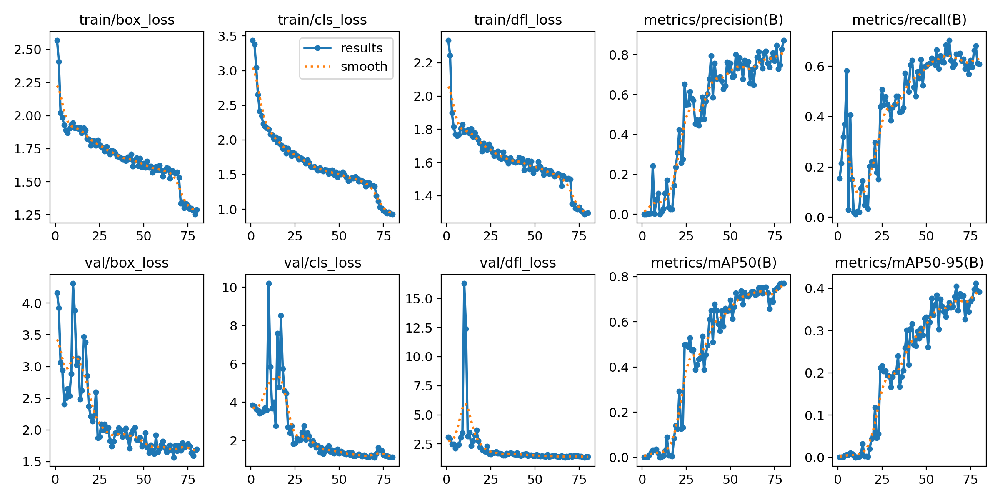

In [ ]:
Image(filename=f'/content/runs/detect/yolov11n_aug_ft2/results.png', width=600)

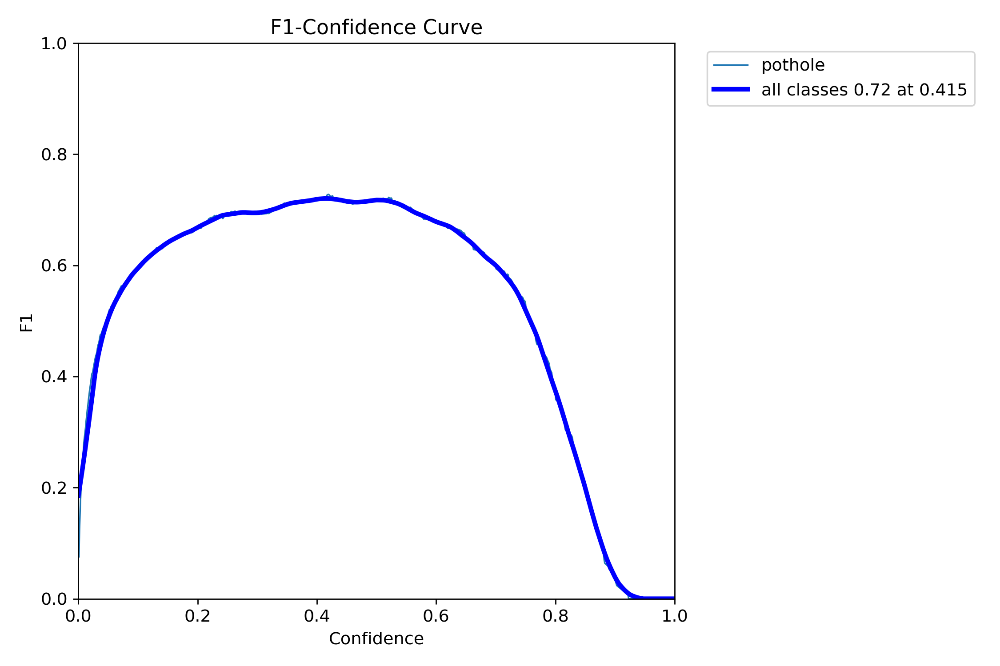

In [ ]:
Image(filename=f'/content/runs/detect/yolov11n_aug_ft2/F1_curve.png', width=600)

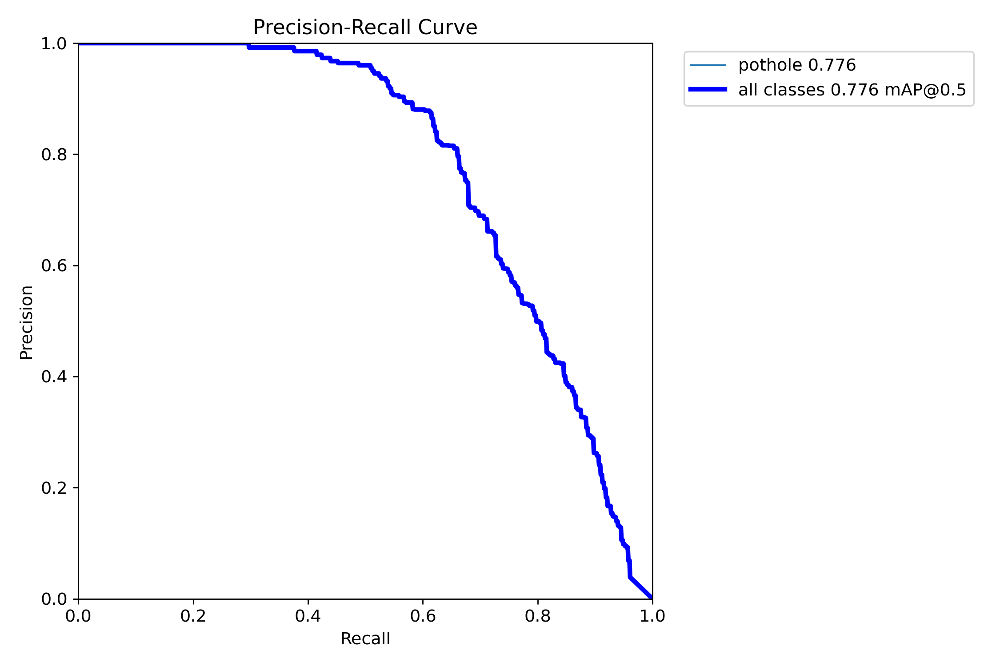

In [ ]:
Image(filename=f'/content/runs/detect/yolov11n_aug_ft2/PR_curve.png', width=600)

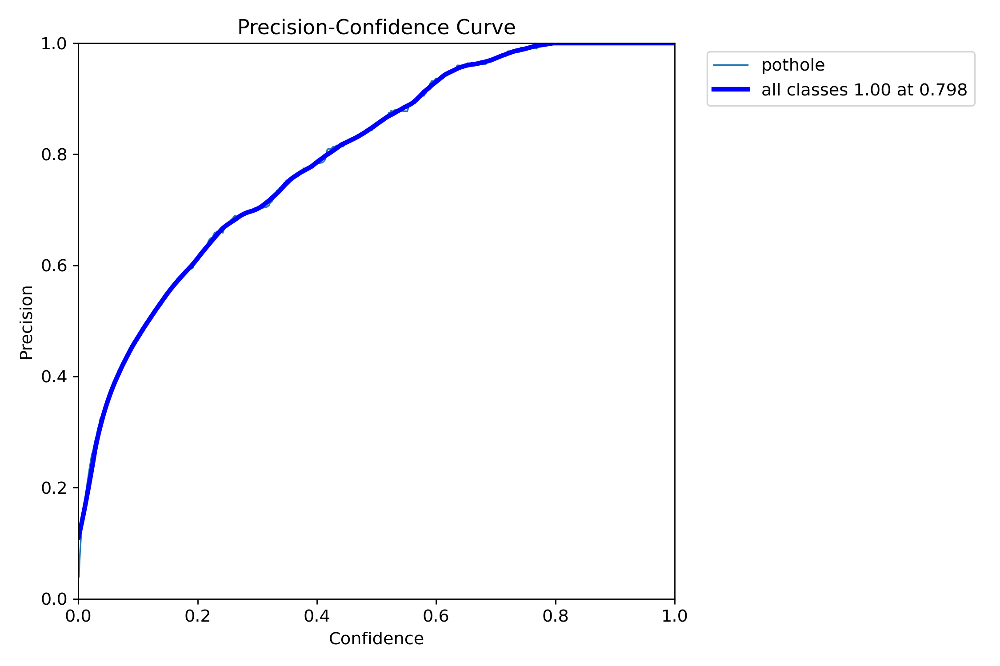

In [ ]:
Image(filename=f'/content/runs/detect/yolov11n_aug_ft2/P_curve.png', width=600)

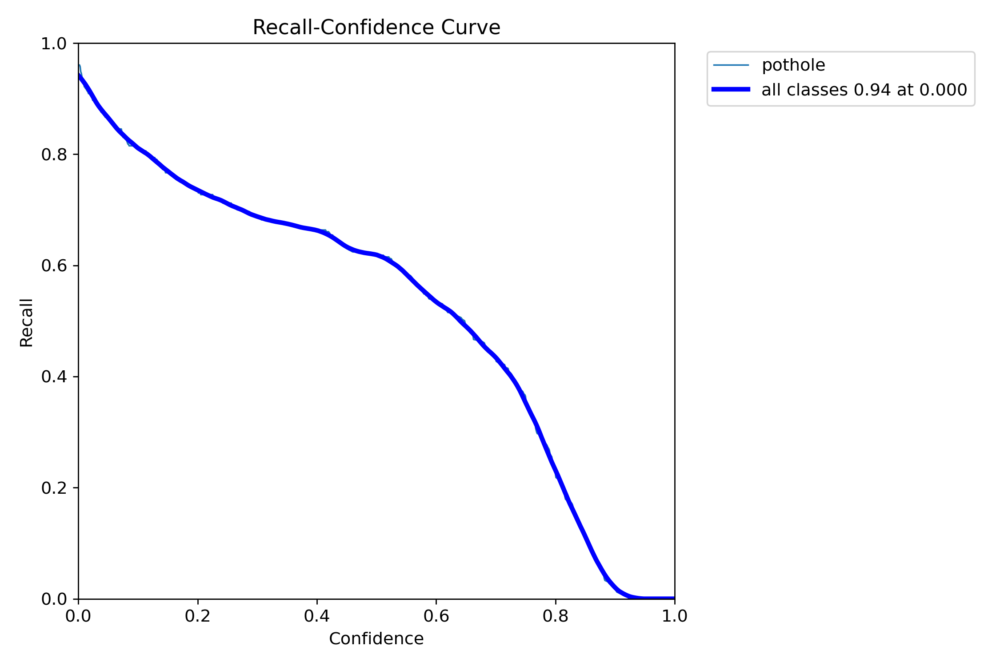

In [ ]:
Image(filename=f'/content/runs/detect/yolov11n_aug_ft2/R_curve.png', width=600)

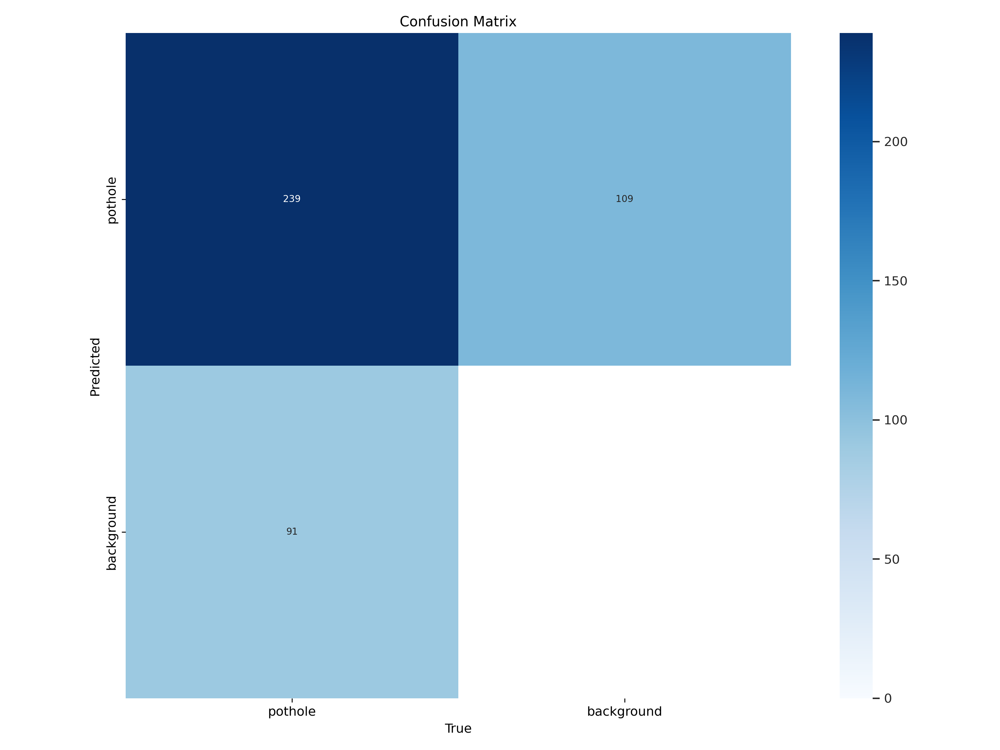

In [ ]:
Image(filename=f'/content/runs/detect/yolov11n_aug_ft2/confusion_matrix.png', width=600)

In [ ]:
metrics_v11_v2 = '/content/runs/detect/yolov11n_aug_ft2/results.csv'

In [ ]:
results_v11_v2 = model_aug_v11_v2.val(name='test_yolov11n_aug_ft2',split='test')

Ultralytics 8.3.61 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11n summary (fused): 238 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/yolov11-dataset/test/labels... 67 images, 0 backgrounds, 0 corrupt: 100%|██████████| 67/67 [00:00<00:00, 750.89it/s]

val: New cache created: /content/yolov11-dataset/test/labels.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.21s/it]


                   all         67        154      0.765       0.74       0.79      0.434
Speed: 1.1ms preprocess, 19.3ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/test_yolov11n_aug_ft2


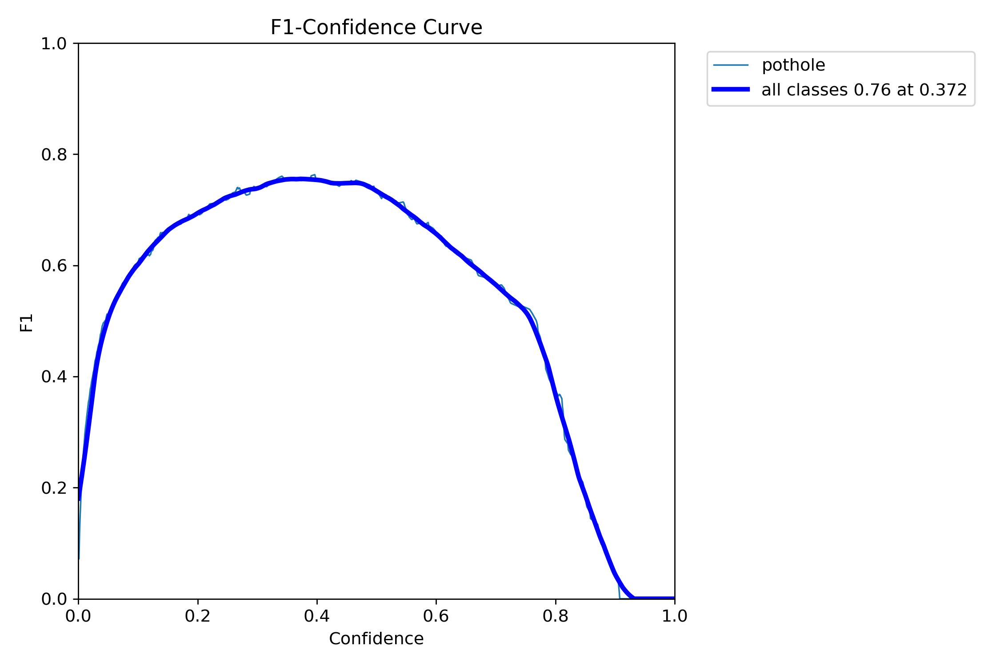

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov11n_aug_ft2/F1_curve.png', width=600)

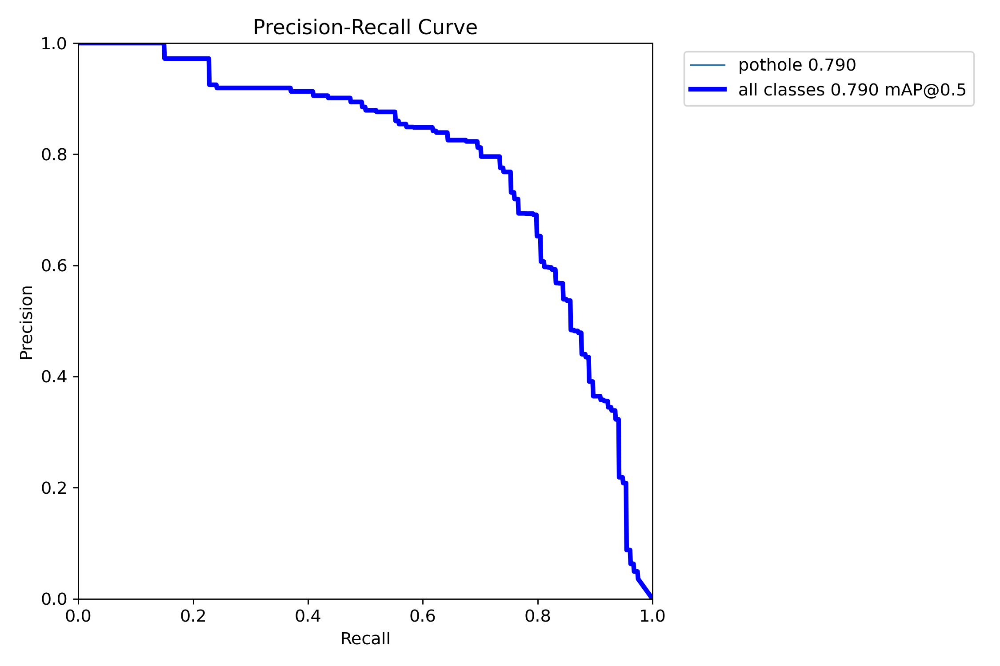

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov11n_aug_ft2/PR_curve.png', width=600)

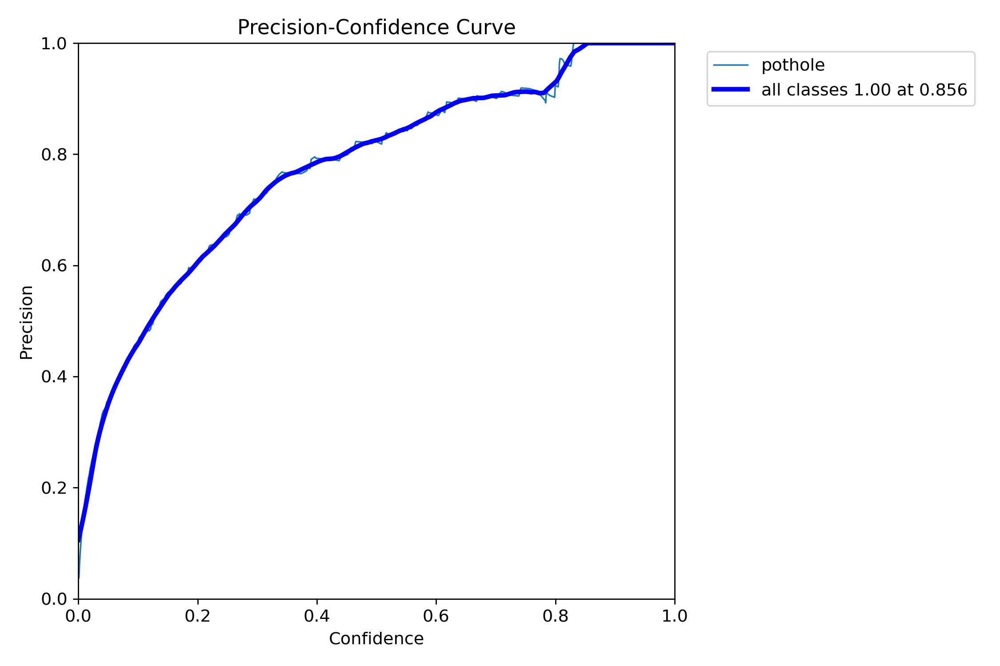

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov11n_aug_ft2/P_curve.png', width=600)

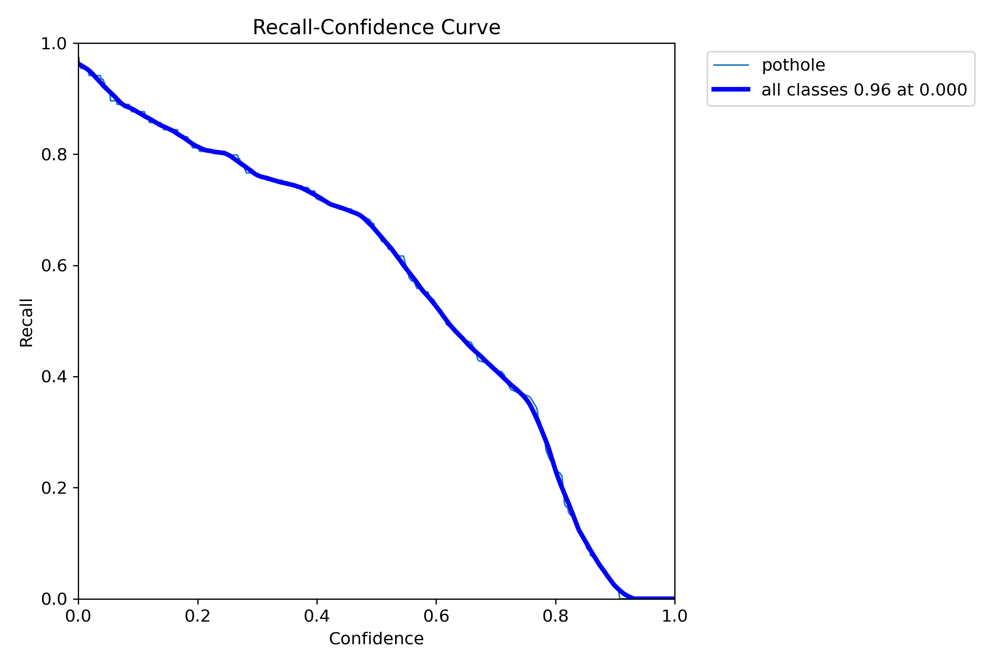

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov11n_aug_ft2/R_curve.png', width=600)

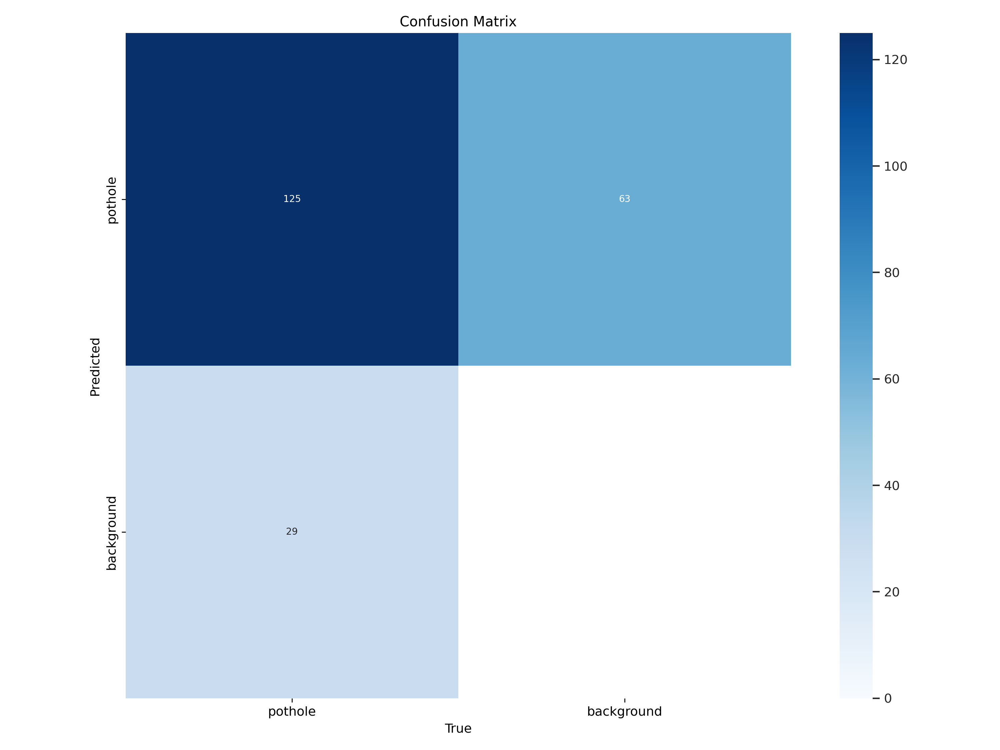

In [ ]:
Image(filename=f'/content/runs/detect/test_yolov11n_aug_ft2/confusion_matrix.png', width=600)

In [ ]:
model_aug_v11_v2.export(format='tflite')

Ultralytics 8.3.61 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.30GHz)

PyTorch: starting from 'runs/detect/yolov11n_aug_ft2/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (5.2 MB)

TensorFlow SavedModel: starting export with tensorflow 2.17.1...

ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.47...
ONNX: export success ✅ 1.6s, saved as 'runs/detect/yolov11n_aug_ft2/weights/best.onnx' (10.2 MB)
TensorFlow SavedModel: starting TFLite export with onnx2tf 1.26.3...
TensorFlow SavedModel: export success ✅ 30.8s, saved as 'runs/detect/yolov11n_aug_ft2/weights/best_saved_model' (26.5 MB)

TensorFlow Lite: starting export with tensorflow 2.17.1...
TensorFlow Lite: export success ✅ 0.0s, saved as 'runs/detect/yolov11n_aug_ft2/weights/best_saved_model/best_float32.tflite' (10.1 MB)

Export complete (31.3s)
Results saved to /content/runs/detect/yolov11n_aug_ft2/weights
Predict:         yolo predict task=detect

'runs/detect/yolov11n_aug_ft2/weights/best_saved_model/best_float32.tflite'

#### Comparing the results

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

In [ ]:
df_aug_5_v2 = pd.read_csv("/content/metrics_aug/results_5_v2.csv")
df_aug_6_v2 = pd.read_csv("/content/metrics_aug/results_6_v2.csv")
df_aug_8_v2 = pd.read_csv("/content/metrics_aug/results_8_v2.csv")
df_aug_10_v2 = pd.read_csv("/content/metrics_aug/results_10_v2.csv")
df_aug_11_v2 = pd.read_csv("/content/metrics_aug/results_11_v2.csv")

In [ ]:
df_aug_5 = pd.read_csv("/content/metrics_aug/results_5.csv")
df_aug_6 = pd.read_csv("/content/metrics_aug/results_6.csv")
df_aug_8 = pd.read_csv("/content/metrics_aug/results_8.csv")
df_aug_10 = pd.read_csv("/content/metrics_aug/results_10.csv")
df_aug_11 = pd.read_csv("/content/metrics_aug/results_11.csv")

In [ ]:
df_5 = pd.read_csv("/content/metrics/results_5.csv")
df_6 = pd.read_csv("/content/metrics/results_6.csv")
df_8 = pd.read_csv("/content/metrics/results_8.csv")
df_10 = pd.read_csv("/content/metrics/results_10.csv")
df_11 = pd.read_csv("/content/metrics/results_11.csv")

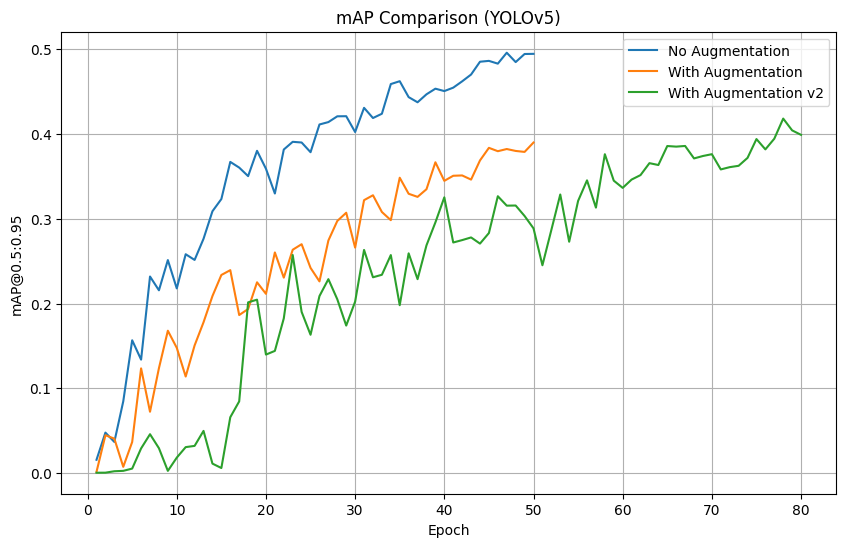

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_5['epoch'], df_5['metrics/mAP50-95(B)'], label='No Augmentation')
plt.plot(df_aug_5['epoch'], df_aug_5['metrics/mAP50-95(B)'], label='With Augmentation')
plt.plot(df_aug_5_v2['epoch'], df_aug_5_v2['metrics/mAP50-95(B)'], label='With Augmentation v2')
plt.xlabel('Epoch')
plt.ylabel('mAP@0.5:0.95')
plt.title('mAP Comparison (YOLOv5)')
plt.legend()
plt.grid(True)
plt.show()

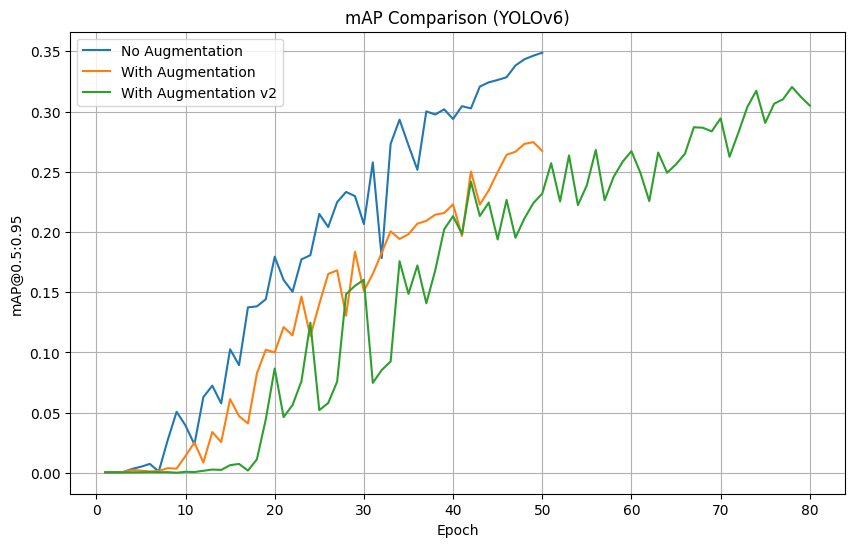

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_6['epoch'], df_6['metrics/mAP50-95(B)'], label='No Augmentation')
plt.plot(df_aug_6['epoch'], df_aug_6['metrics/mAP50-95(B)'], label='With Augmentation')
plt.plot(df_aug_6_v2['epoch'], df_aug_6_v2['metrics/mAP50-95(B)'], label='With Augmentation v2')
plt.xlabel('Epoch')
plt.ylabel('mAP@0.5:0.95')
plt.title('mAP Comparison (YOLOv6)')
plt.legend()
plt.grid(True)
plt.show()

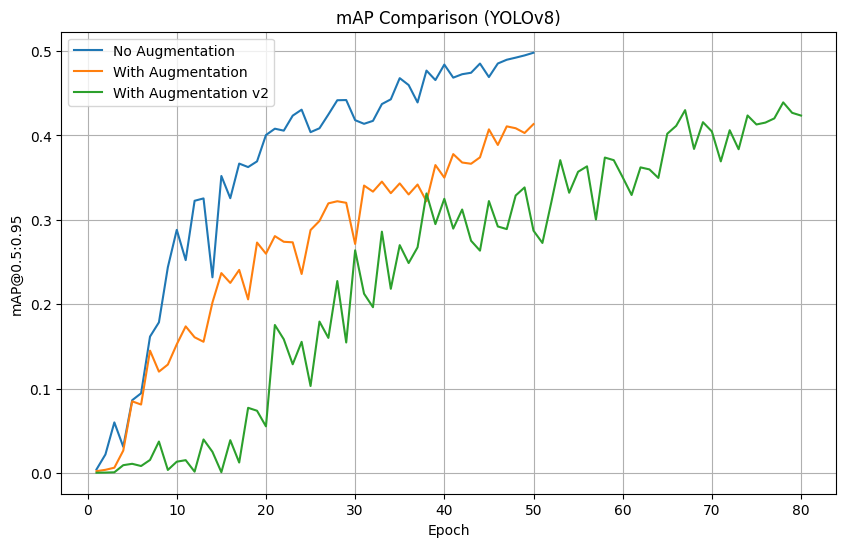

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_8['epoch'], df_8['metrics/mAP50-95(B)'], label='No Augmentation')
plt.plot(df_aug_8['epoch'], df_aug_8['metrics/mAP50-95(B)'], label='With Augmentation')
plt.plot(df_aug_8_v2['epoch'], df_aug_8_v2['metrics/mAP50-95(B)'], label='With Augmentation v2')
plt.xlabel('Epoch')
plt.ylabel('mAP@0.5:0.95')
plt.title('mAP Comparison (YOLOv8)')
plt.legend()
plt.grid(True)
plt.show()

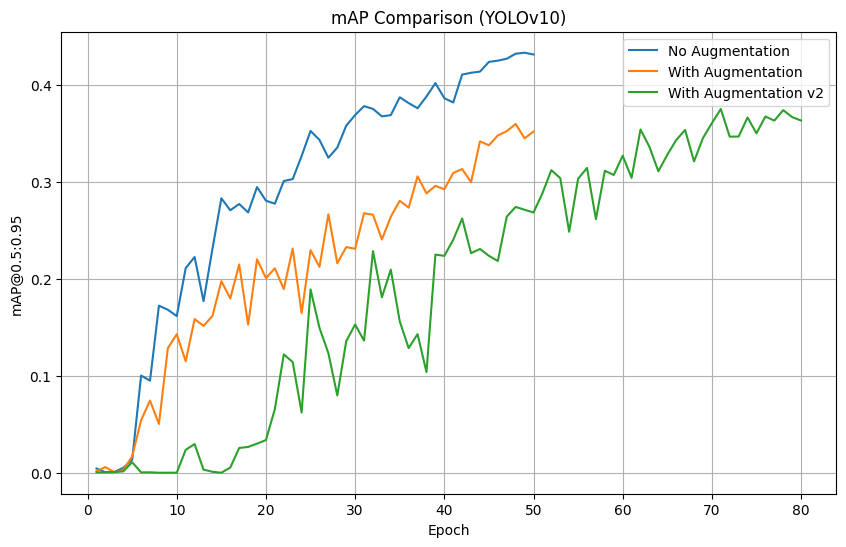

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_10['epoch'], df_10['metrics/mAP50-95(B)'], label='No Augmentation')
plt.plot(df_aug_10['epoch'], df_aug_10['metrics/mAP50-95(B)'], label='With Augmentation')
plt.plot(df_aug_10_v2['epoch'], df_aug_10_v2['metrics/mAP50-95(B)'], label='With Augmentation v2')
plt.xlabel('Epoch')
plt.ylabel('mAP@0.5:0.95')
plt.title('mAP Comparison (YOLOv10)')
plt.legend()
plt.grid(True)
plt.show()

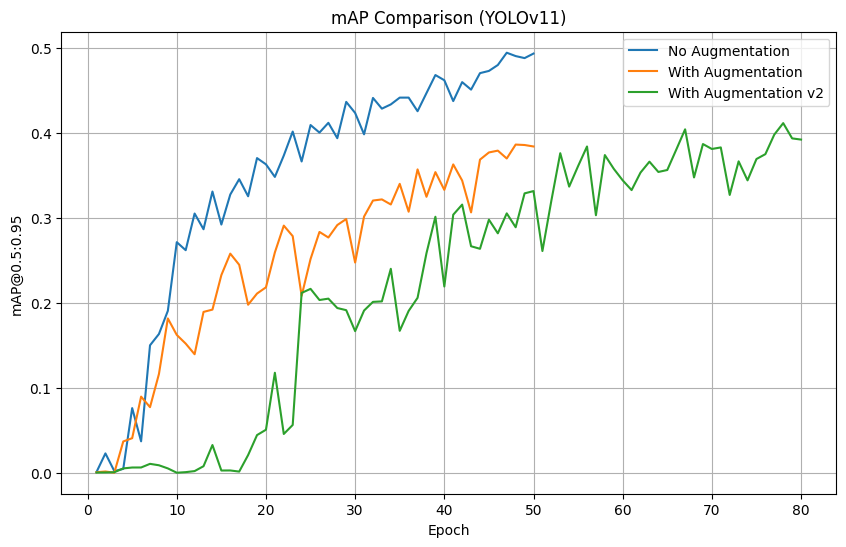

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_11['epoch'], df_11['metrics/mAP50-95(B)'], label='No Augmentation')
plt.plot(df_aug_11['epoch'], df_aug_11['metrics/mAP50-95(B)'], label='With Augmentation')
plt.plot(df_aug_11_v2['epoch'], df_aug_11_v2['metrics/mAP50-95(B)'], label='With Augmentation v2')
plt.xlabel('Epoch')
plt.ylabel('mAP@0.5:0.95')
plt.title('mAP Comparison (YOLOv11)')
plt.legend()
plt.grid(True)
plt.show()

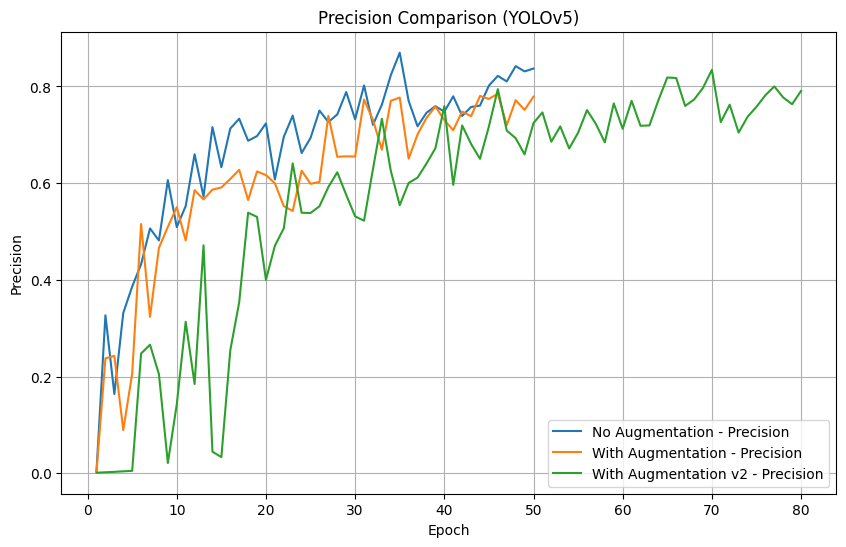

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_5['epoch'], df_5['metrics/precision(B)'], label='No Augmentation - Precision')
plt.plot(df_aug_5['epoch'], df_aug_5['metrics/precision(B)'], label='With Augmentation - Precision')
plt.plot(df_aug_5_v2['epoch'], df_aug_5_v2['metrics/precision(B)'], label='With Augmentation v2 - Precision')
plt.xlabel('Epoch')
plt.ylabel('Precision')
plt.title('Precision Comparison (YOLOv5)')
plt.legend()
plt.grid(True)
plt.show()

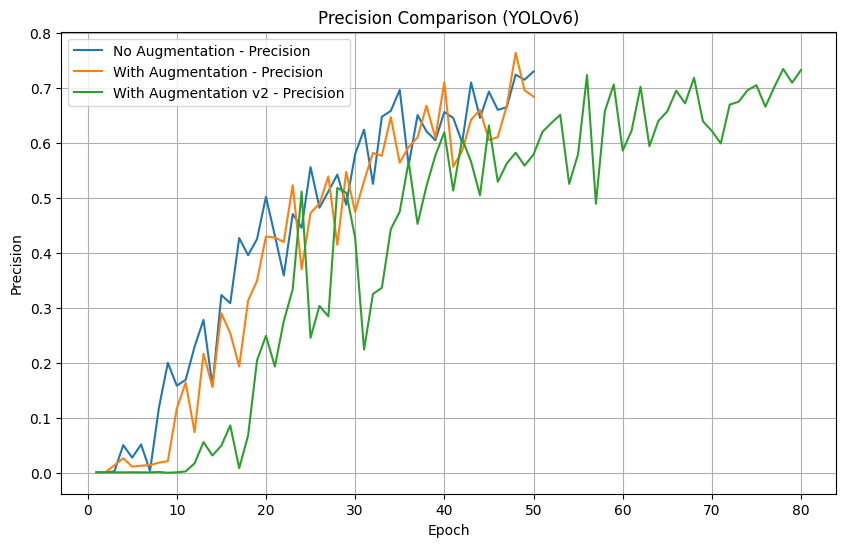

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_6['epoch'], df_6['metrics/precision(B)'], label='No Augmentation - Precision')
plt.plot(df_aug_6['epoch'], df_aug_6['metrics/precision(B)'], label='With Augmentation - Precision')
plt.plot(df_aug_6_v2['epoch'], df_aug_6_v2['metrics/precision(B)'], label='With Augmentation v2 - Precision')
plt.xlabel('Epoch')
plt.ylabel('Precision')
plt.title('Precision Comparison (YOLOv6)')
plt.legend()
plt.grid(True)
plt.show()

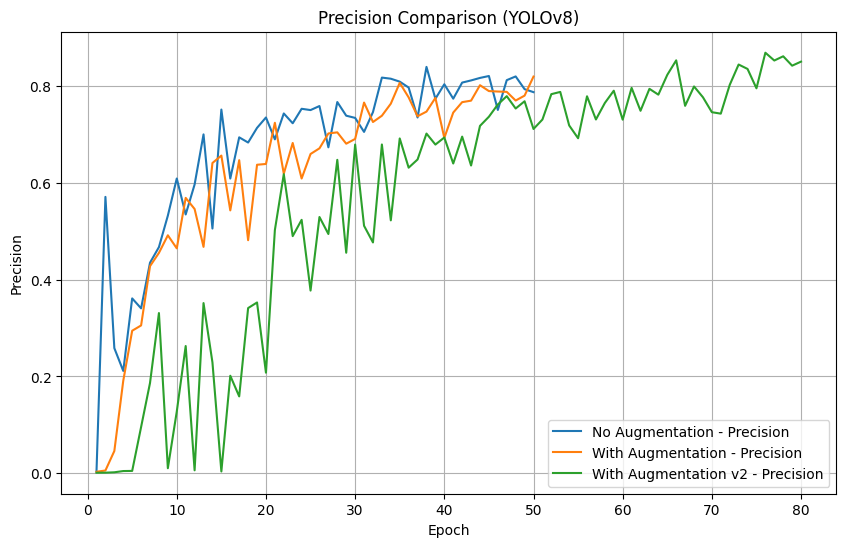

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_8['epoch'], df_8['metrics/precision(B)'], label='No Augmentation - Precision')
plt.plot(df_aug_8['epoch'], df_aug_8['metrics/precision(B)'], label='With Augmentation - Precision')
plt.plot(df_aug_8_v2['epoch'], df_aug_8_v2['metrics/precision(B)'], label='With Augmentation v2 - Precision')
plt.xlabel('Epoch')
plt.ylabel('Precision')
plt.title('Precision Comparison (YOLOv8)')
plt.legend()
plt.grid(True)
plt.show()

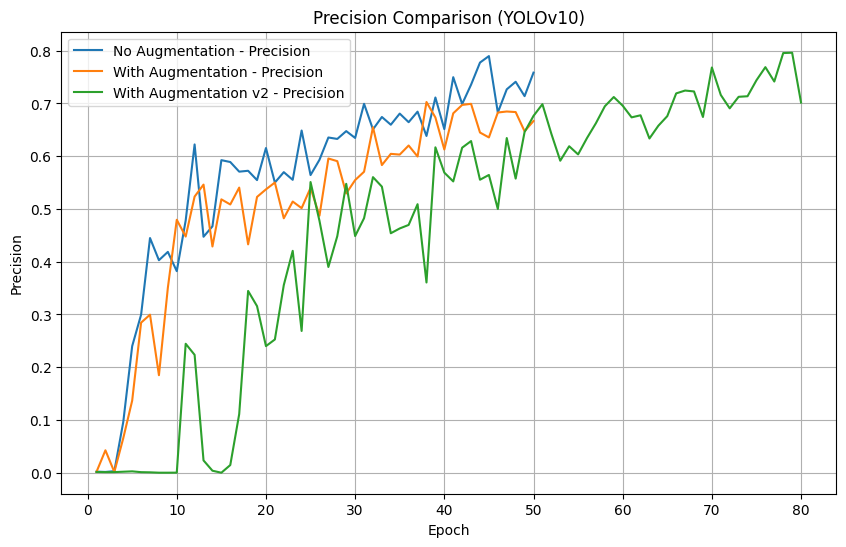

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_10['epoch'], df_10['metrics/precision(B)'], label='No Augmentation - Precision')
plt.plot(df_aug_10['epoch'], df_aug_10['metrics/precision(B)'], label='With Augmentation - Precision')
plt.plot(df_aug_10_v2['epoch'], df_aug_10_v2['metrics/precision(B)'], label='With Augmentation v2 - Precision')
plt.xlabel('Epoch')
plt.ylabel('Precision')
plt.title('Precision Comparison (YOLOv10)')
plt.legend()
plt.grid(True)
plt.show()

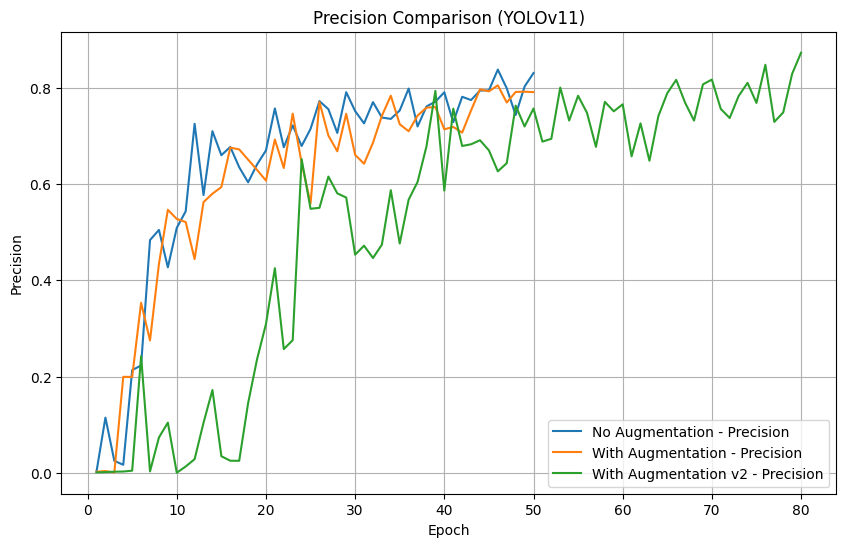

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_11['epoch'], df_11['metrics/precision(B)'], label='No Augmentation - Precision')
plt.plot(df_aug_11['epoch'], df_aug_11['metrics/precision(B)'], label='With Augmentation - Precision')
plt.plot(df_aug_11_v2['epoch'], df_aug_11_v2['metrics/precision(B)'], label='With Augmentation v2 - Precision')
plt.xlabel('Epoch')
plt.ylabel('Precision')
plt.title('Precision Comparison (YOLOv11)')
plt.legend()
plt.grid(True)
plt.show()

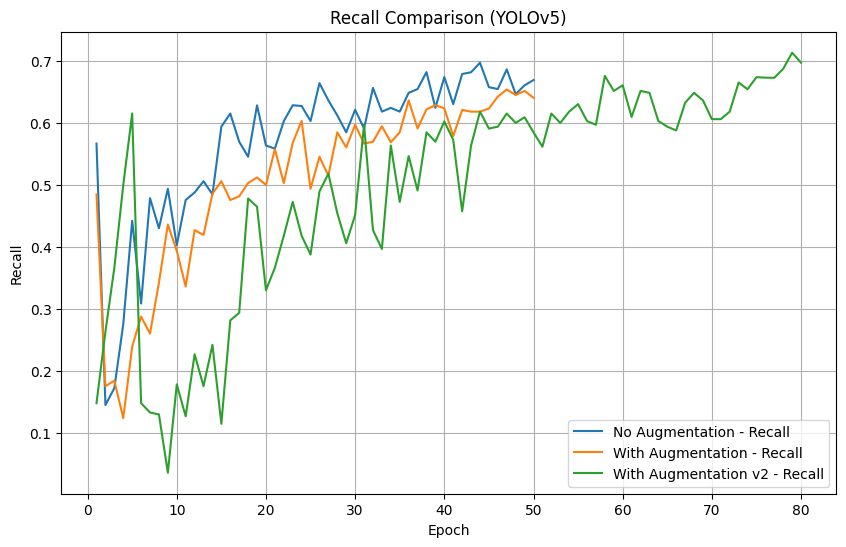

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_5['epoch'], df_5['metrics/recall(B)'], label='No Augmentation - Recall')
plt.plot(df_aug_5['epoch'], df_aug_5['metrics/recall(B)'], label='With Augmentation - Recall')
plt.plot(df_aug_5_v2['epoch'], df_aug_5_v2['metrics/recall(B)'], label='With Augmentation v2 - Recall')
plt.xlabel('Epoch')
plt.ylabel('Recall')
plt.title('Recall Comparison (YOLOv5)')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_6['epoch'], df_6['metrics/recall(B)'], label='No Augmentation - Recall')
plt.plot(df_aug_6['epoch'], df_aug_6['metrics/recall(B)'], label='With Augmentation - Recall')
plt.plot(df_aug_6_v2['epoch'], df_aug_6_v2['metrics/recall(B)'], label='With Augmentation v2 - Recall')
plt.xlabel('Epoch')
plt.ylabel('Recall')
plt.title('Recall Comparison (YOLOv6)')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_8['epoch'], df_8['metrics/recall(B)'], label='No Augmentation - Recall')
plt.plot(df_aug_8['epoch'], df_aug_8['metrics/recall(B)'], label='With Augmentation - Recall')
plt.plot(df_aug_8_v2['epoch'], df_aug_8_v2['metrics/recall(B)'], label='With Augmentation v2 - Recall')
plt.xlabel('Epoch')
plt.ylabel('Recall')
plt.title('Recall Comparison (YOLOv8)')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_10['epoch'], df_10['metrics/recall(B)'], label='No Augmentation - Recall')
plt.plot(df_aug_10['epoch'], df_aug_10['metrics/recall(B)'], label='With Augmentation - Recall')
plt.plot(df_aug_10_v2['epoch'], df_aug_10_v2['metrics/recall(B)'], label='With Augmentation v2 - Recall')
plt.xlabel('Epoch')
plt.ylabel('Recall')
plt.title('Recall Comparison (YOLOv10)')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(df_11['epoch'], df_11['metrics/recall(B)'], label='No Augmentation - Recall')
plt.plot(df_aug_11['epoch'], df_aug_11['metrics/recall(B)'], label='With Augmentation - Recall')
plt.plot(df_aug_11_v2['epoch'], df_aug_11_v2['metrics/recall(B)'], label='With Augmentation v2 - Recall')
plt.xlabel('Epoch')
plt.ylabel('Recall')
plt.title('Recall Comparison (YOLOv11)')
plt.legend()
plt.grid(True)
plt.show()